In [ ]:
# !pip install numpy
# !pip install --upgrade numpy
!pip install pandas==1.3.5
# !pip install --upgrade pandas
!pip install networkx==2.6
#!pip install --upgrade networkx
!pip install torch-geometric
!pip install torch
!pip install karateclub
!pip install gensim networkx

In [ ]:
!pip install --upgrade pandas

  Using cached pandas-2.2.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.0 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires numpy<2.0a0,>=1.23, but you have numpy 1.22.4 which is incompatible.
cudf-cu12 24.4.1 requires pandas<2.2.2dev0,>=2.0, but you have pandas 2.2.2 which is incompatible.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 2.2.2 which is incompatible.
karateclub 1.3.3 requires pandas<=1.3.5, but you have pandas 2.2.2 which is incompatible.
plotnine 0.12.4 requires numpy>=1.23.0, but you have numpy 1.22.4 which is incompatible.


In [ ]:
import pandas
print(pandas.__version__)

RuntimeError: module was compiled against NumPy C-API version 0x10 (NumPy 1.23) but the running NumPy has C-API version 0xf. Check the section C-API incompatibility at the Troubleshooting ImportError section at https://numpy.org/devdocs/user/troubleshooting-importerror.html#c-api-incompatibility for indications on how to solve this problem.

1.3.5


In [ ]:
import os.path as osp
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch_geometric.transforms as T
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import torch_geometric
import torch.nn.utils.rnn as rnn
import pandas as pd
from torch_geometric.data import Dataset, Data
import pandas as pd
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from torch_geometric.datasets import Planetoid
from torch_geometric.nn import GCNConv
from torch_geometric.utils import negative_sampling
from torch_geometric.transforms import RandomLinkSplit
from torch_geometric.loader import DataLoader
from gensim.models import Word2Vec
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from karateclub import Node2Vec
from google.colab import drive
from tqdm import tqdm
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from networkx.algorithms import graph_hashing
import re

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def netlist_parser(dir_path):
  #crea los directorios data/raw para los nuevos csv
  output_folder = "data/raw"
  if not os.path.exists(output_folder):
    os.makedirs(output_folder)
  if file.endswith(".v"):
    file_modified = file[:-2]
  #creamos un nuevo csv para cada verilog
  output_csv = os.path.join(output_folder, file_modified + '.csv')
  df = pd.DataFrame(columns=['source_node', 'target_node', 'source_node_type', 'target_node_type'])

  G = nx.DiGraph()
  node_id_map = {}
  next_id = 0
  with open(dir_path, 'r') as f:
    netlist_lines = f.readlines()
    i = 0
    elements = []
    while i < len(netlist_lines):
      line = netlist_lines[i].strip()
      node_input = []
      node_output = []
      node_type = None
      node_name = None

      if "GND" in line:
        x = i
        #iteramos sobre las lineas de cada nodo para obtener sus entradas y salidas
        while x < len(netlist_lines)-1 and not "IBUF \\" in netlist_lines[x+1] and not "OBUF \\" in netlist_lines[x+1] and not re.search(r"LUT\d", netlist_lines[x+1]):
          if re.search(r'\.G\(', netlist_lines[x+1].strip()):
            node_output.append('\\<const0> ')
            node_input.append('GND')
            node_type = 'GND'
            node_name = 'GND' + str(i)
          x +=1
        element = {'node_type': node_type,
                   'node_name': node_name,
                   'node_input': node_input,
                   'node_output': node_output}
        elements.append(element)

      elif "VCC" in line:
        x = i
        while x < len(netlist_lines)-1 and not "IBUF \\" in netlist_lines[x+1] and not "OBUF \\" in netlist_lines[x+1] and not re.search(r"LUT\d", netlist_lines[x+1]):
          if re.search(r'\.P\(', netlist_lines[x+1].strip()):
            node_output.append('\\<const1> ')
            node_input.append('VCC')
            node_type = 'VCC'
            node_name = 'VCC' + str(i)
          x +=1
        element = {'node_type': node_type,
                   'node_name': node_name,
                   'node_input': node_input,
                   'node_output': node_output}
        elements.append(element)

      elif "IBUF \\" in line or "OBUF \\" in line:
        parts = line.split(" ")
        node_type = parts[0]
        node_name = parts[1].lstrip().strip("\\")
        x = i
        while x < len(netlist_lines)-1 and not "IBUF \\" in netlist_lines[x+1] and not "OBUF \\" in netlist_lines[x+1] and not re.search(r"LUT\d", netlist_lines[x+1]):
          if re.search(r'\.I\(', netlist_lines[x+1]):
            node_input.append(re.search(r'\.I\(([^)]+)\)', netlist_lines[x+1].strip()).group(1) if re.search(r'\.I\(([^)]+)\)', netlist_lines[x+1].strip()) else None)
          elif re.search(r'\.O\(', netlist_lines[x+1]):
            node_output.append(re.search(r'\((.*?)\)', netlist_lines[x+1].strip()).group(1) if re.search(r'\((.*?)\)', netlist_lines[x+1].strip()) else None)
          x += 1
        element = {'node_type': node_type ,
                   'node_name': node_name,
                   'node_input': node_input,
                   'node_output': node_output}
        elements.append(element)

      elif re.search(r"LUT\d", line):
        node_type = 'LUT'
        node_name = netlist_lines[i+2].strip().strip('\\')
        x = i
        while x < len(netlist_lines)-1 and not "IBUF \\" in netlist_lines[x+1] and not "OBUF \\" in netlist_lines[x+1] and not re.search(r"LUT\d", netlist_lines[x+1]):
          if re.search(r'\.I\d\(([^)]+)\)', netlist_lines[x+1].strip()):
            node_input.append(re.search(r'\.I\d\(([^)]+)\)', netlist_lines[x+1].strip()).group(1))
          elif re.search(r'\.O\(', netlist_lines[x+1]):
            node_output.append(re.search(r'\((.*?)\)', netlist_lines[x+1].strip()).group(1) if re.search(r'\((.*?)\)', netlist_lines[x+1].strip()) else None)
          x +=1
        element = {'node_type': node_type,
                   'node_name': node_name,
                   'node_input': node_input,
                   'node_output': node_output}
        elements.append(element)

      i +=1

    for element in elements:
      if element['node_name'] not in node_id_map:
        node_id_map[element['node_name']] = next_id
        next_id += 1

    for element in elements:
      G.add_node(element['node_name'], node_type=element['node_type'])
      for output in element['node_output']:
        for target_element in elements:
          if output in target_element['node_input']:
            G.add_edge(element['node_name'], target_element['node_name'])
            df = df.append({'source_node': node_id_map[element['node_name']],
                            'target_node': node_id_map[target_element['node_name']],
                            'source_node_type': element['node_type'],
                            'target_node_type': target_element['node_type']}, ignore_index = True)
    df.to_csv(output_csv, index=False)
    print(f"Archivo CSV generado: {output_csv}")

  color_map = {
      'IBUF': 'green',
      'OBUF': 'red',
      'LUT': 'blue',
      'VCC': 'yellow',
      'GND': 'black'}

  for element in elements:
    print(element)
  node_colors = [color_map[G.nodes[node]['node_type']] for node in G.nodes()]

  plt.figure(figsize=(12, 8))
  nx.draw_networkx(G, with_labels=True, node_size=300, node_color=node_colors)
  plt.show()
  return G

Archivo CSV generado: data/raw/add16u_0EM_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4

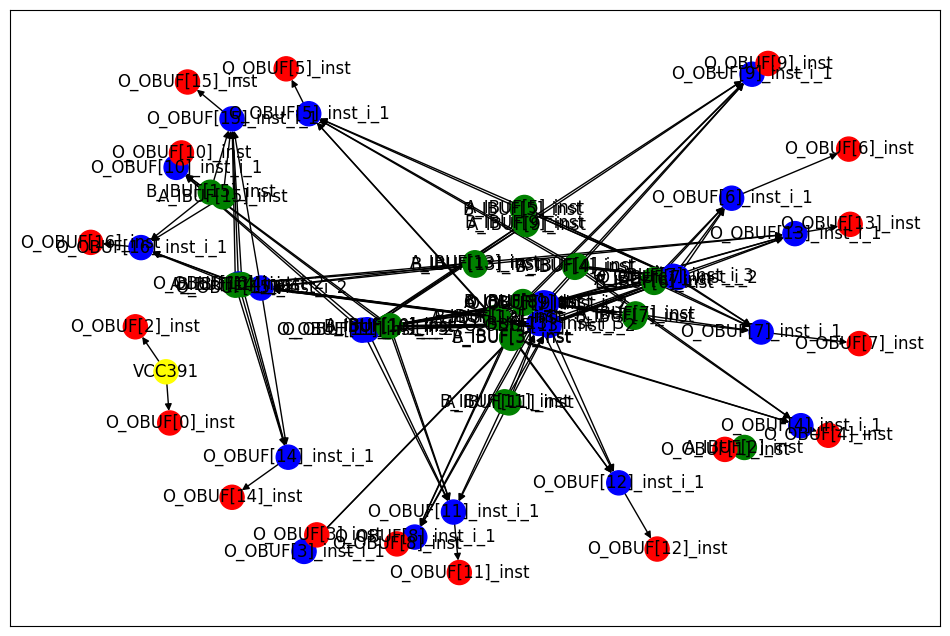

Archivo CSV generado: data/raw/add12u_13K_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_o

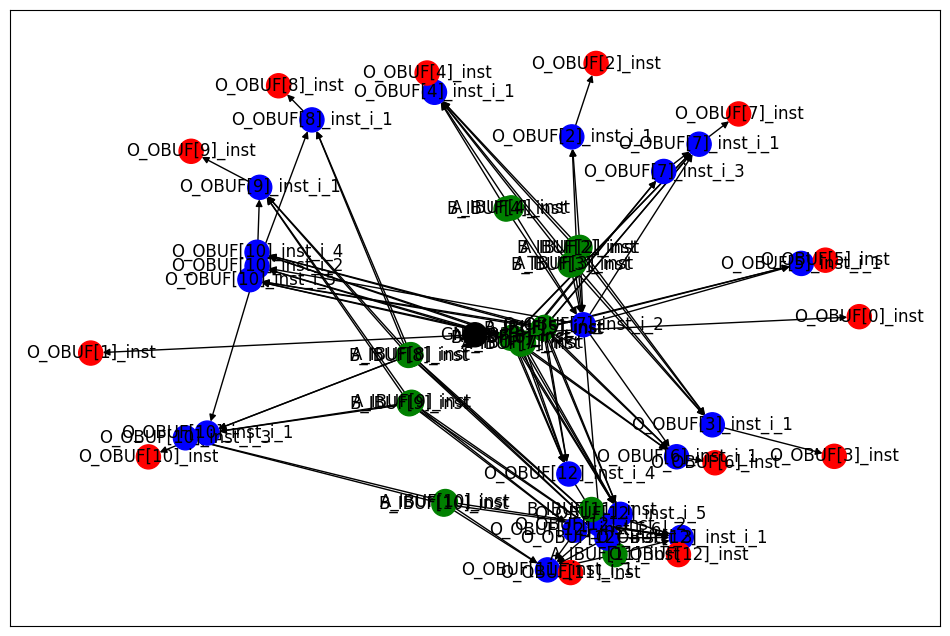

Archivo CSV generado: data/raw/add8se_91X_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

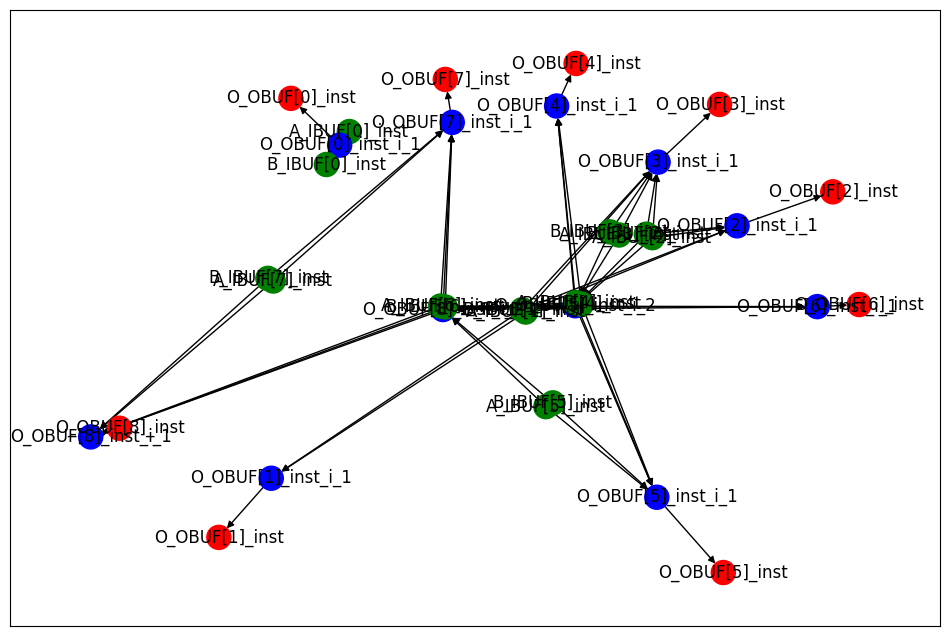

Archivo CSV generado: data/raw/add8s_6TR_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

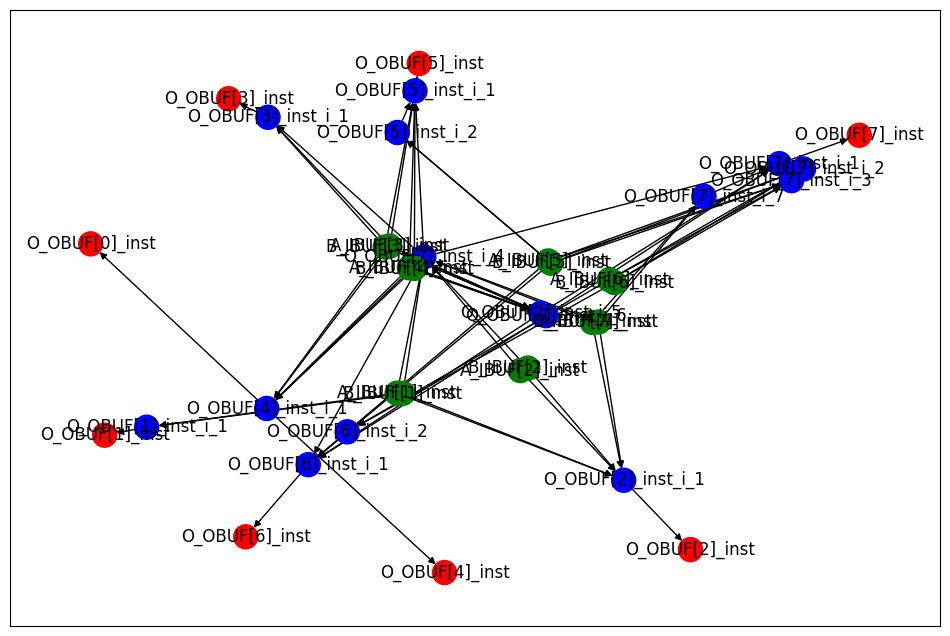

Archivo CSV generado: data/raw/add12u_0FY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'n

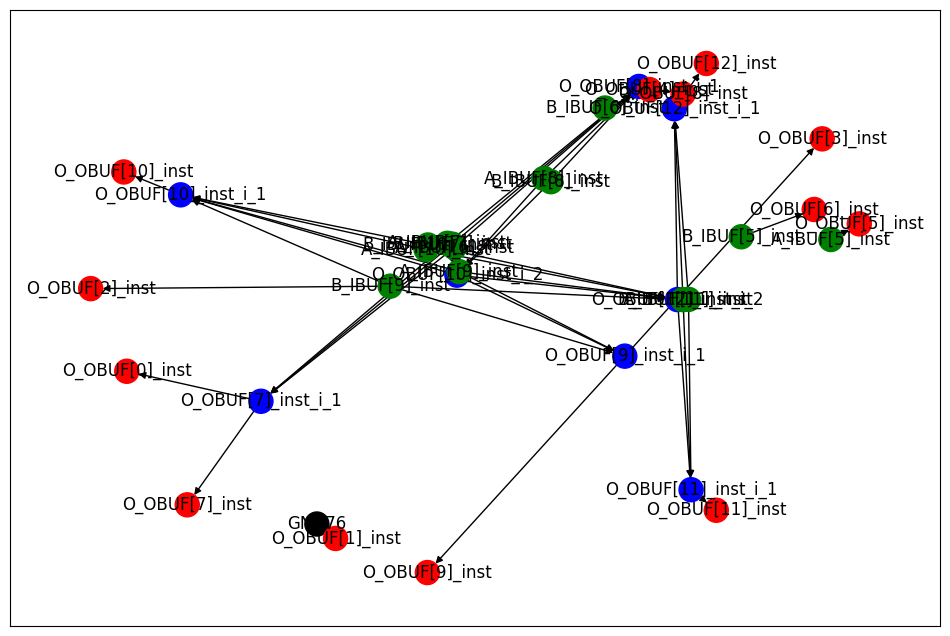

Archivo CSV generado: data/raw/add12u_4FZ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

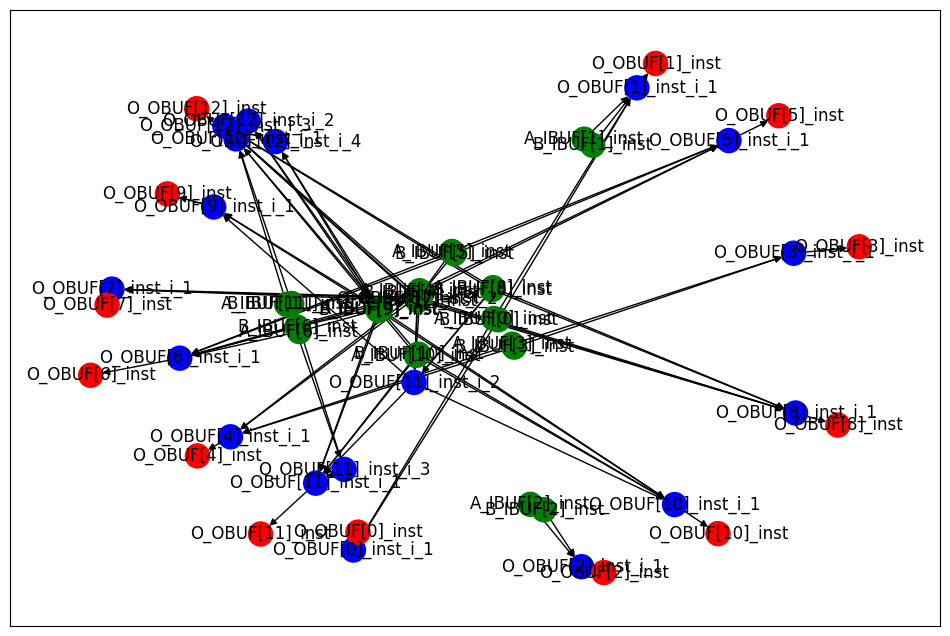

Archivo CSV generado: data/raw/add16u_1MB_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

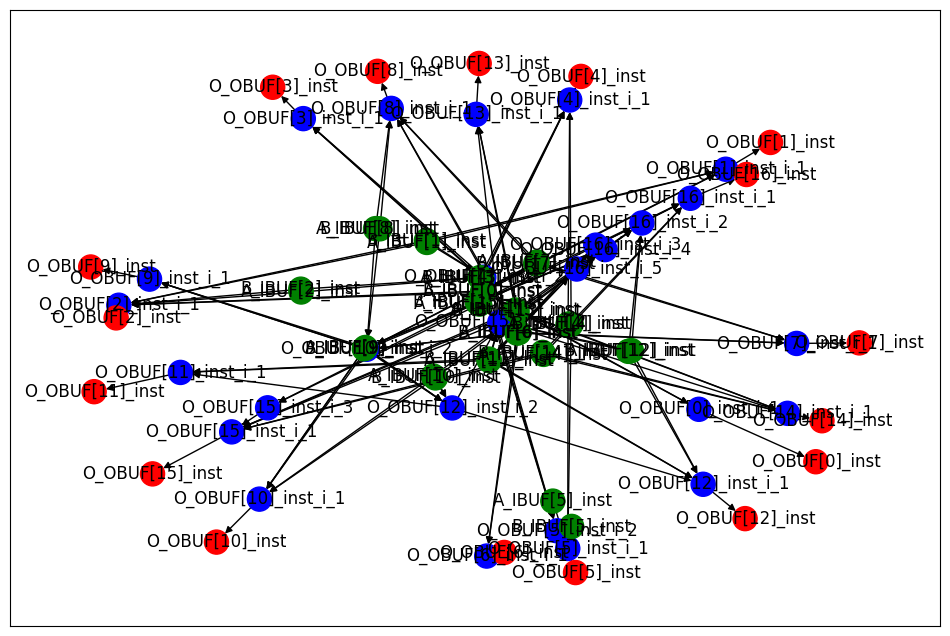

Archivo CSV generado: data/raw/add16se_1Y7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[

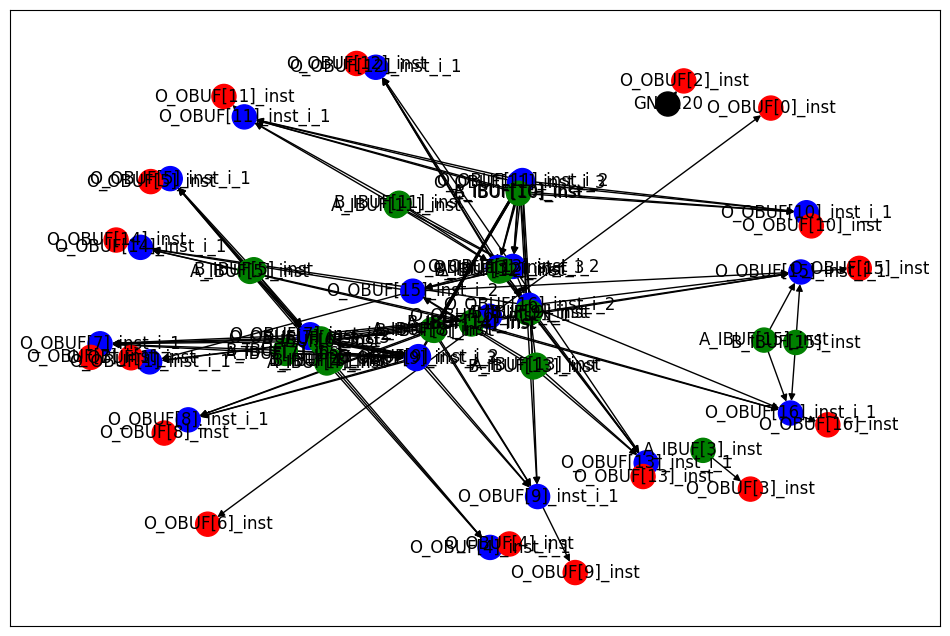

Archivo CSV generado: data/raw/add8s_70Z_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

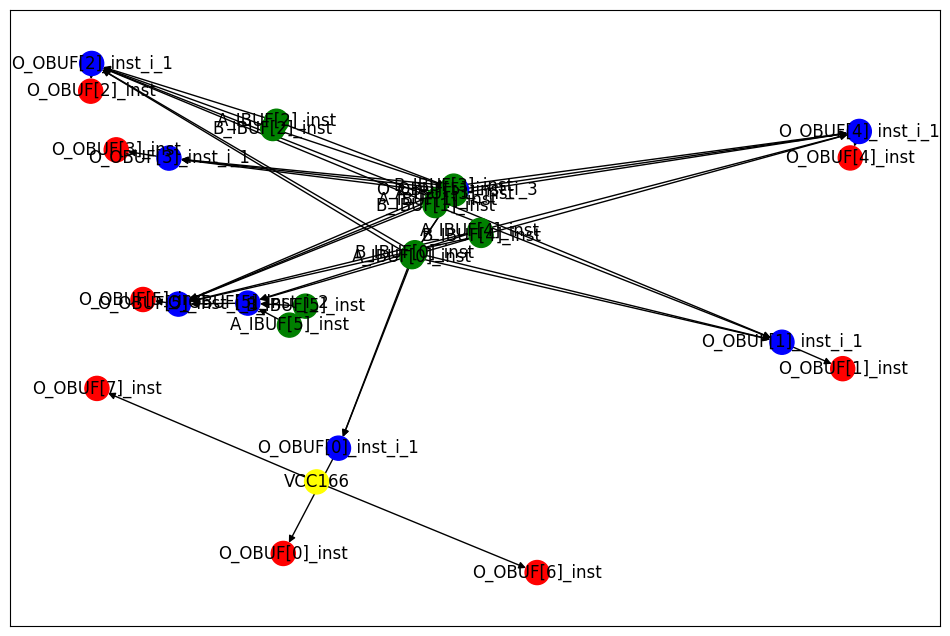

Archivo CSV generado: data/raw/add12se_585_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], '

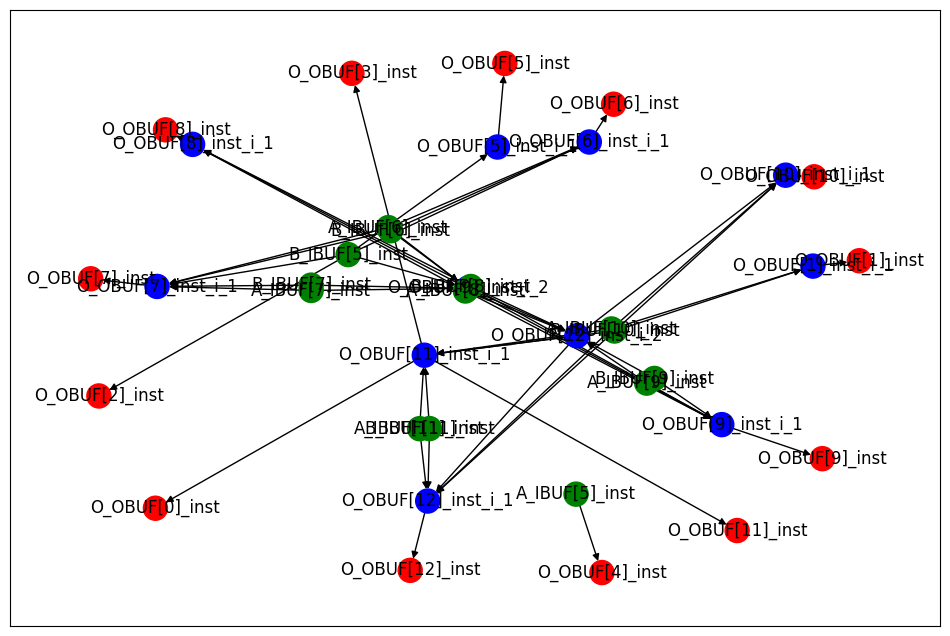

Archivo CSV generado: data/raw/add8se_78P_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

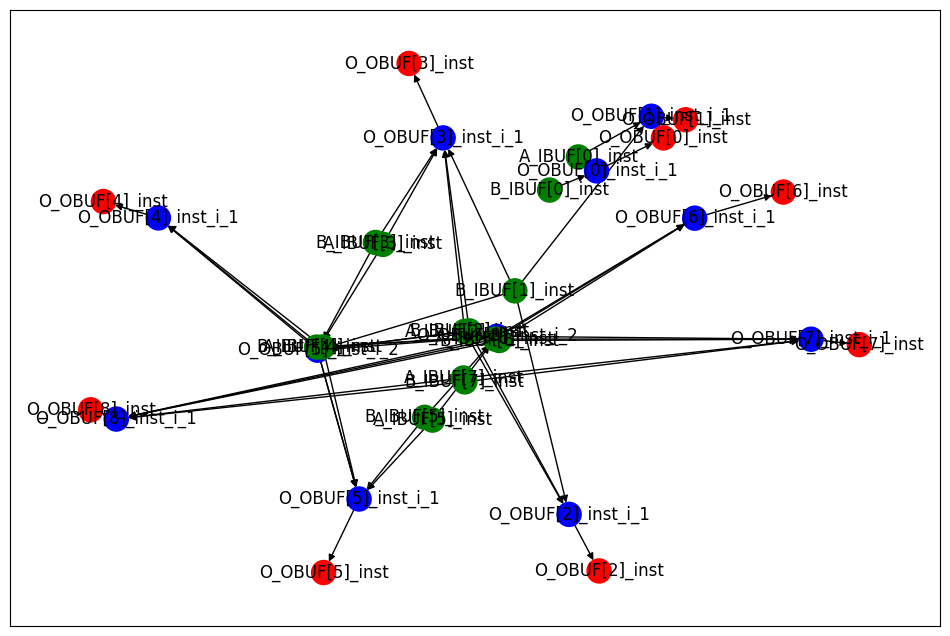

Archivo CSV generado: data/raw/add9se_048_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output'

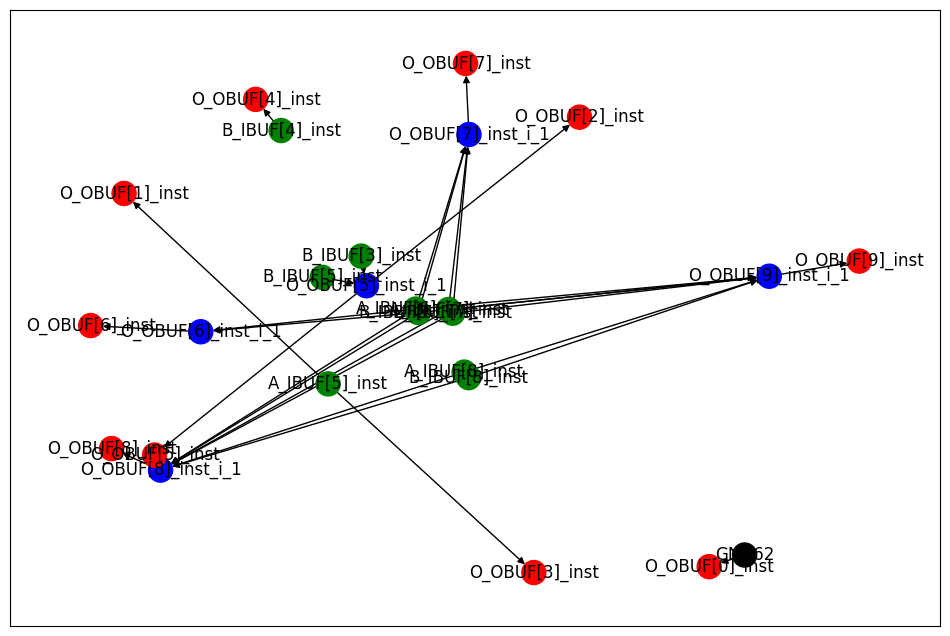

Archivo CSV generado: data/raw/add16se_29A_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[

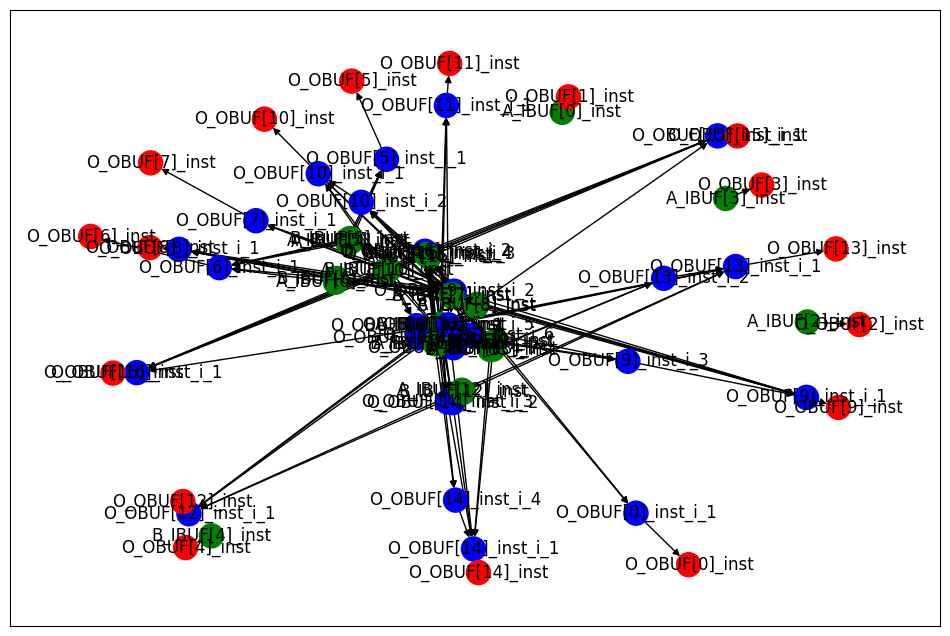

Archivo CSV generado: data/raw/add8s_6TN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

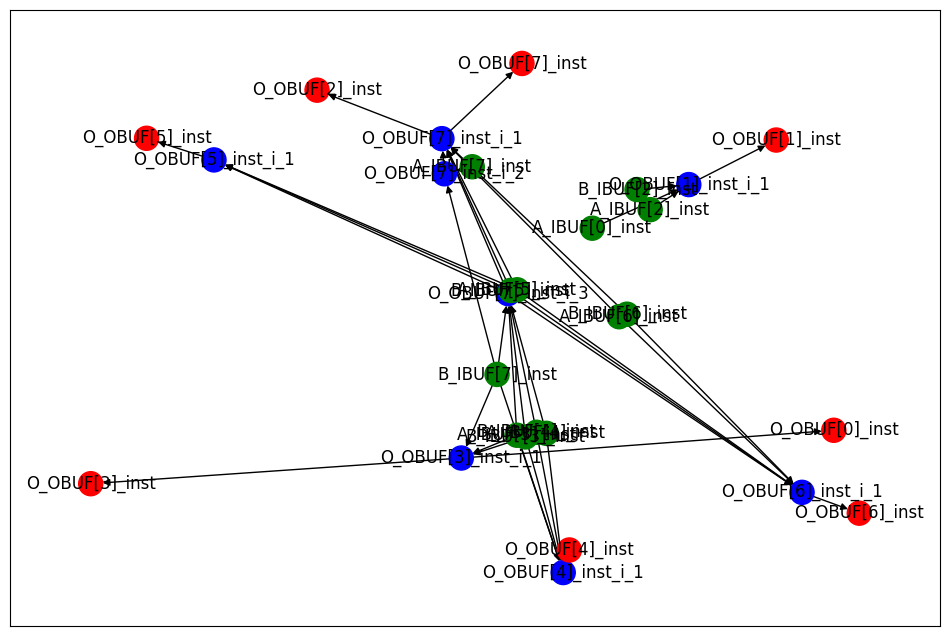

Archivo CSV generado: data/raw/add12u_4YK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

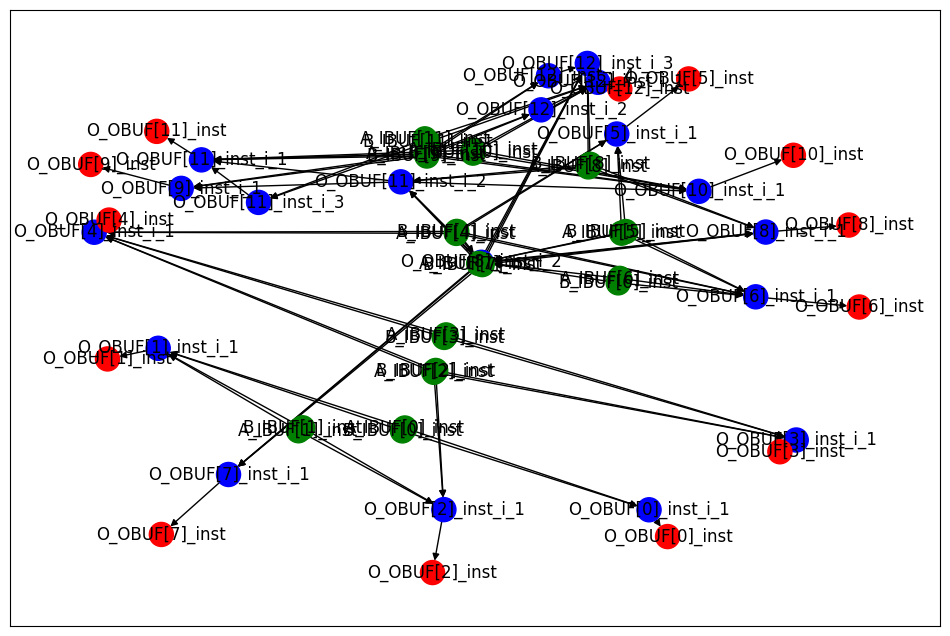

Archivo CSV generado: data/raw/add8u_5NH_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

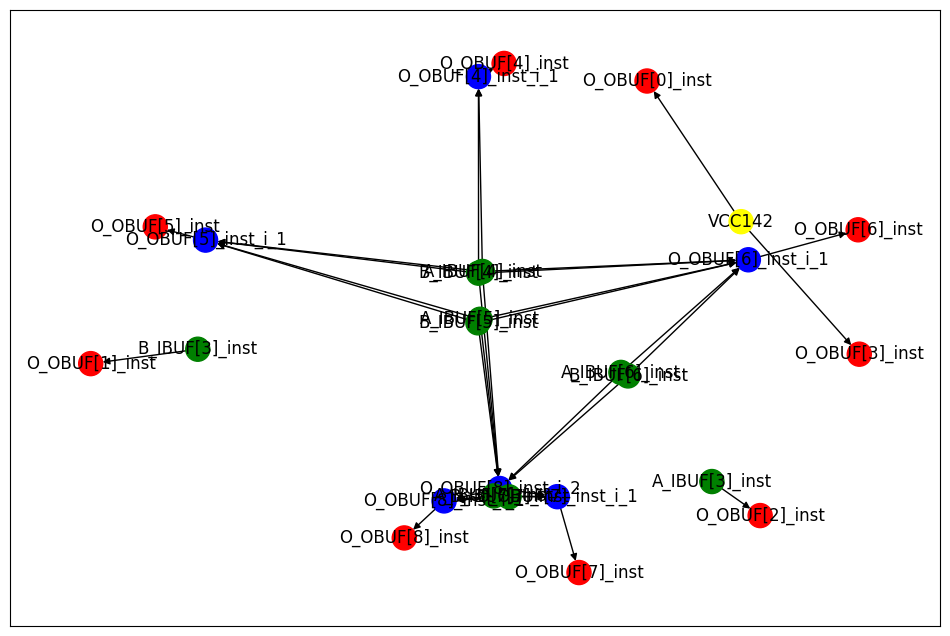

Archivo CSV generado: data/raw/add12se_5AN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

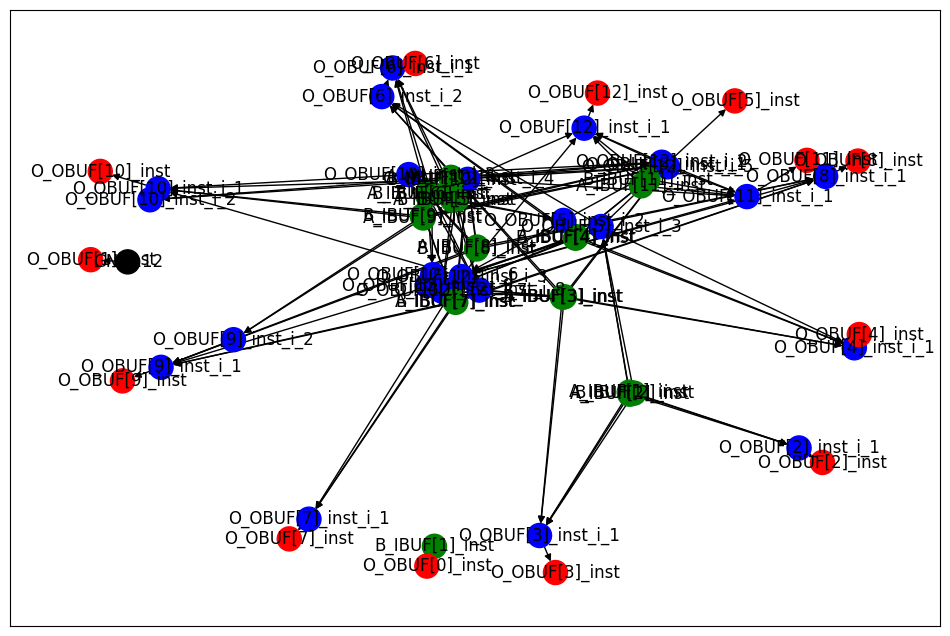

Archivo CSV generado: data/raw/add12se_5AL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_

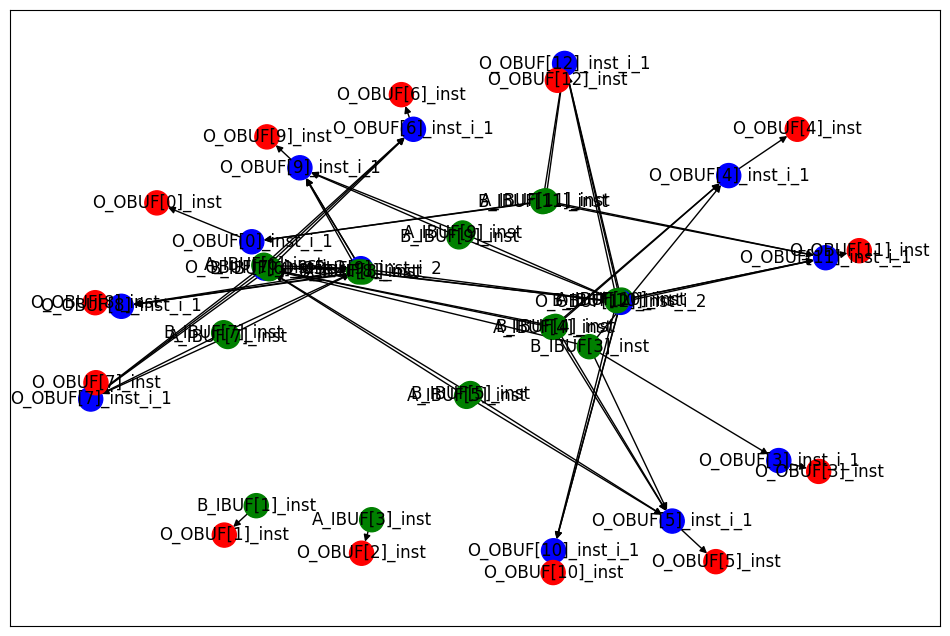

Archivo CSV generado: data/raw/add16u_0DL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9

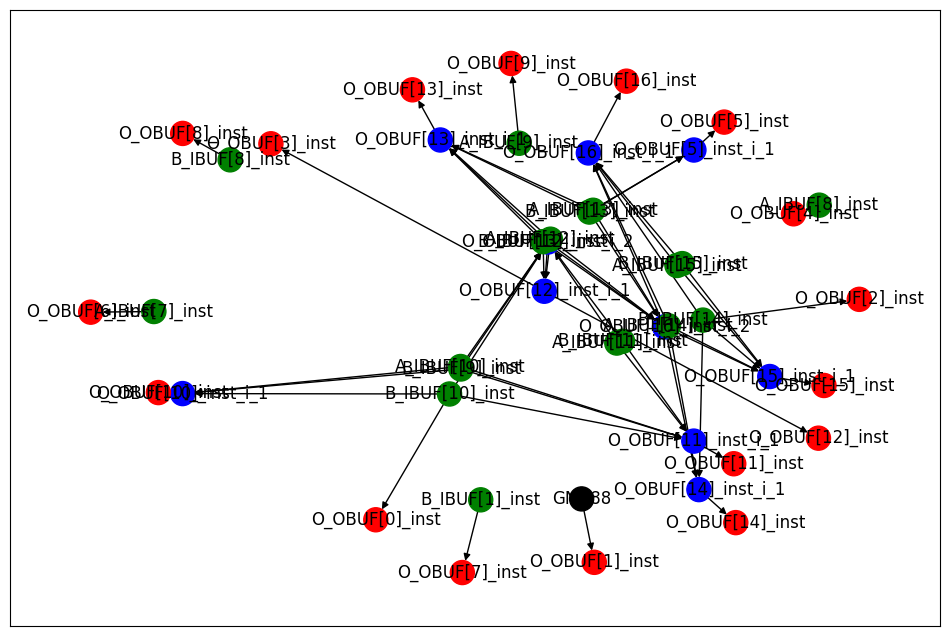

Archivo CSV generado: data/raw/add8u_5R3_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

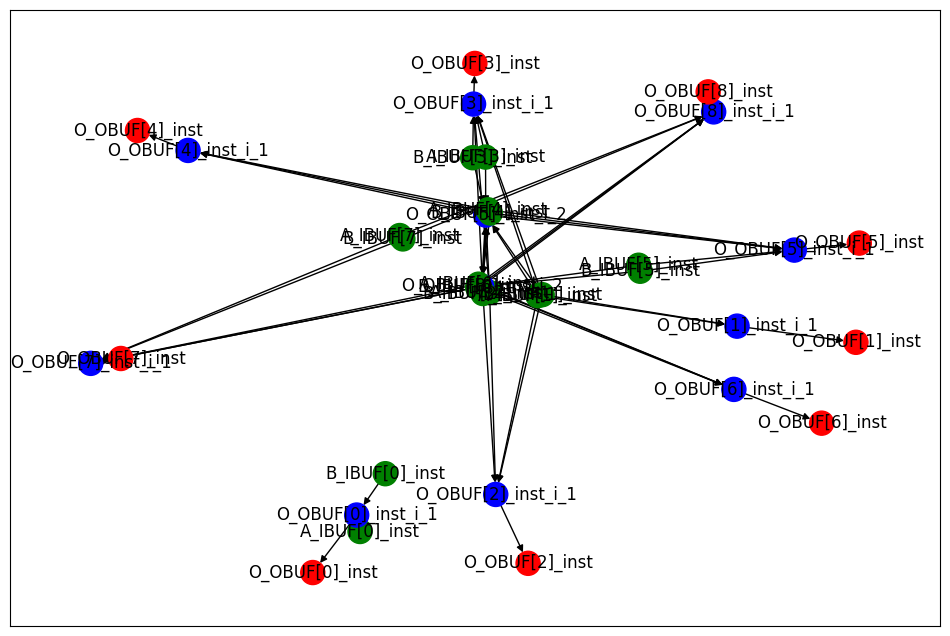

Archivo CSV generado: data/raw/add8s_701_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND50', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O

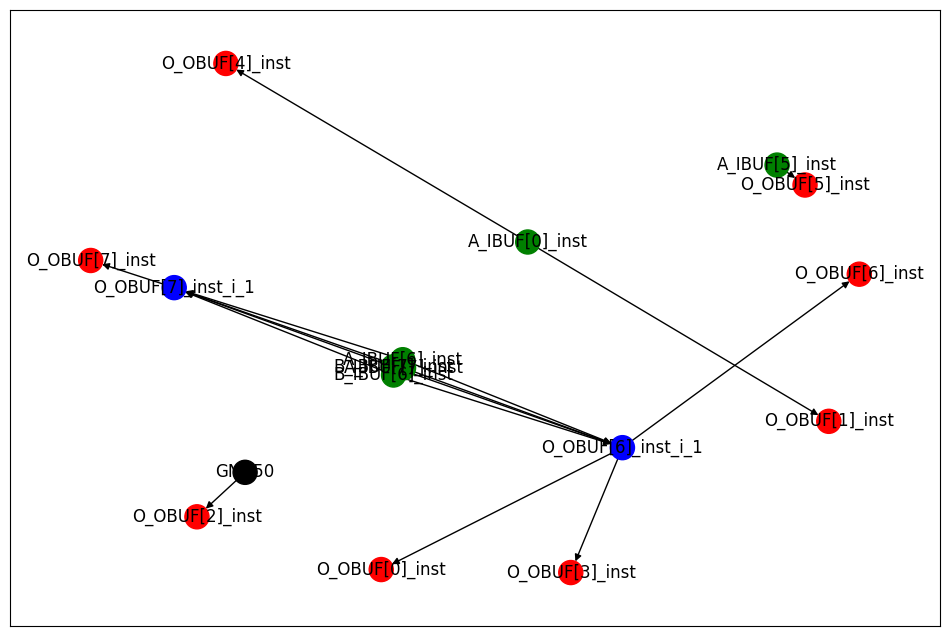

Archivo CSV generado: data/raw/add9se_0A3_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output': ['B_IBUF[8]']}
{'node_type': 'GND', 'node_name': 'GND58', 'node_input': ['GND'], 'node_output': ['\\<cons

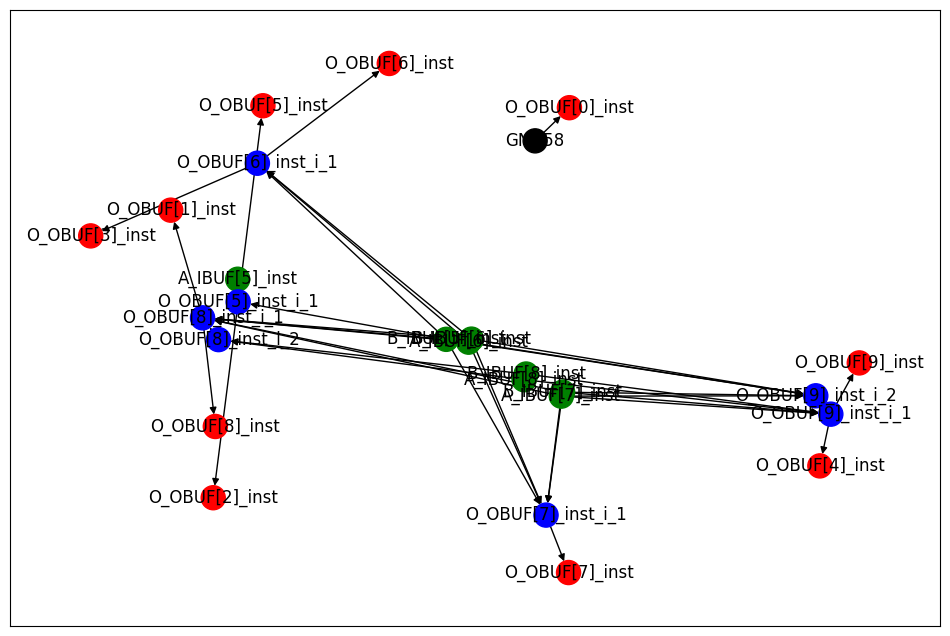

Archivo CSV generado: data/raw/add12u_2L7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node

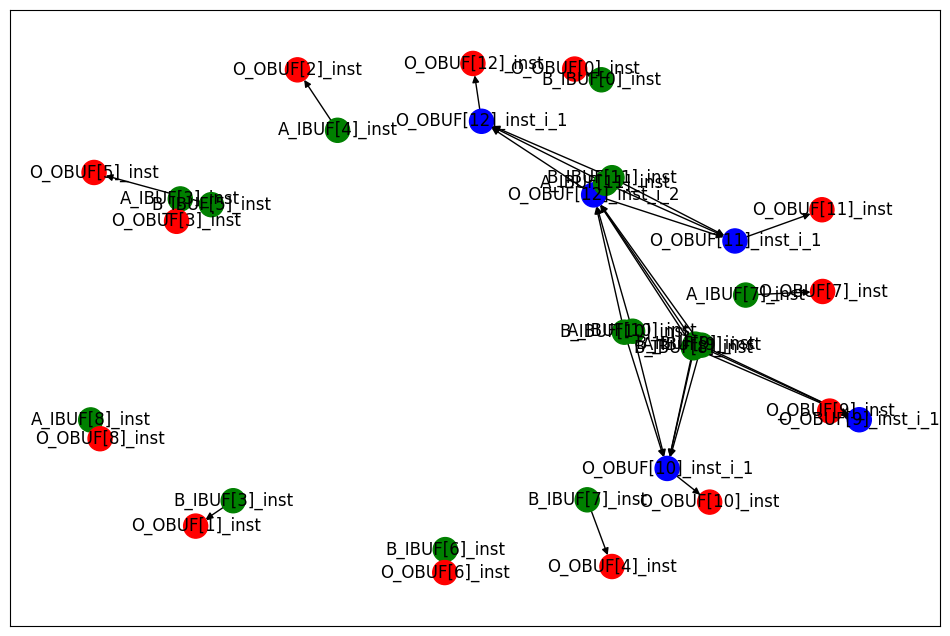

Archivo CSV generado: data/raw/add16se_2DN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[

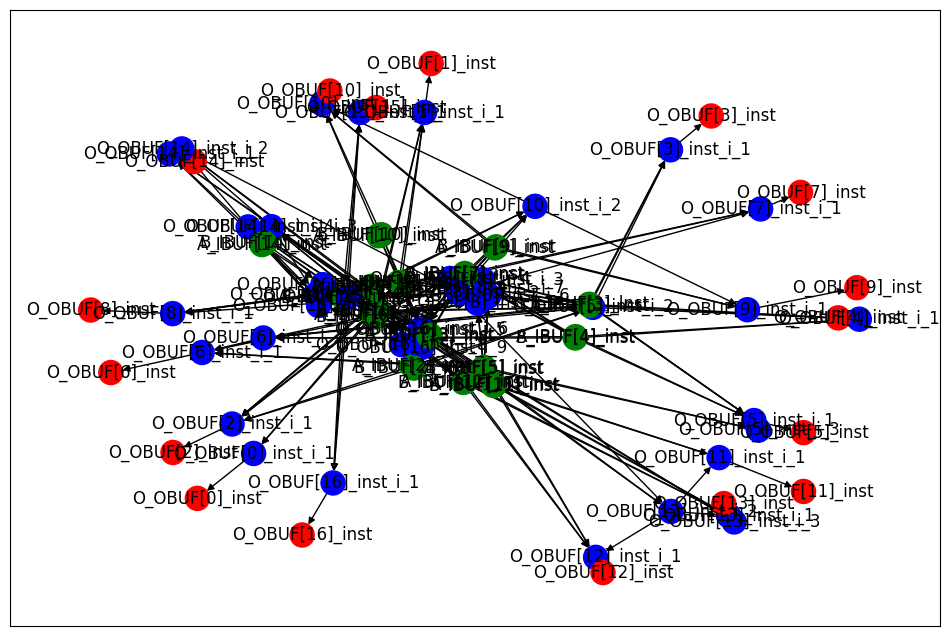

Archivo CSV generado: data/raw/add8u_8GM_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF']}
{'node_type': 'GND', 'node_name': 'GND48', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[2]'], 'node_output': ['O[2]'

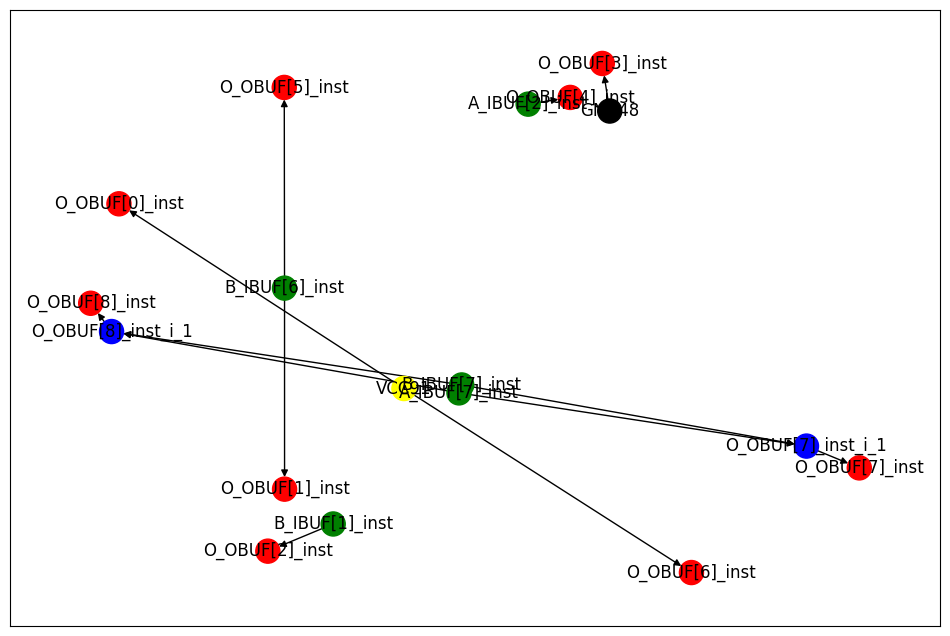

Archivo CSV generado: data/raw/add16u_08F_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5

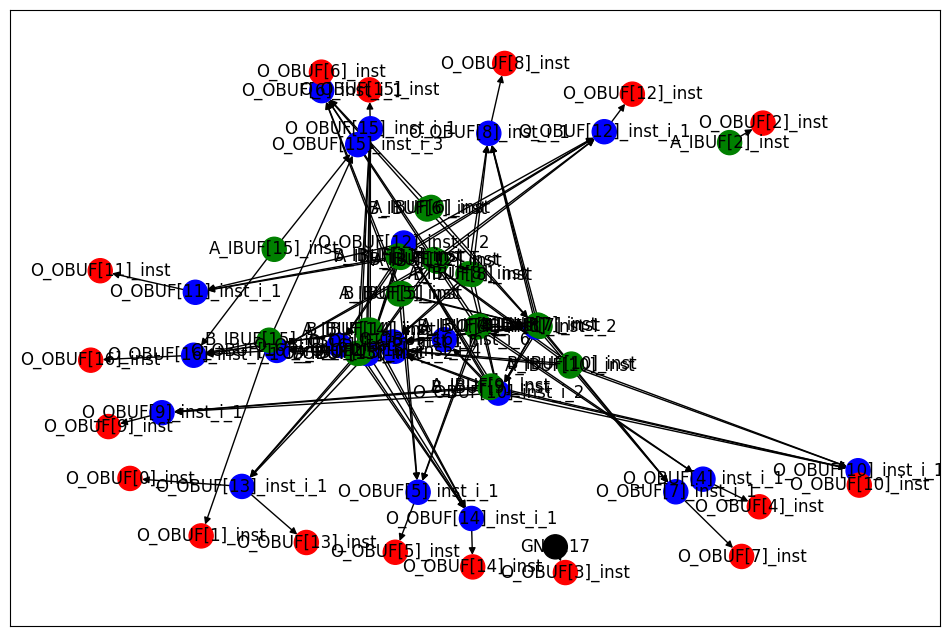

Archivo CSV generado: data/raw/add12u_0XE_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_

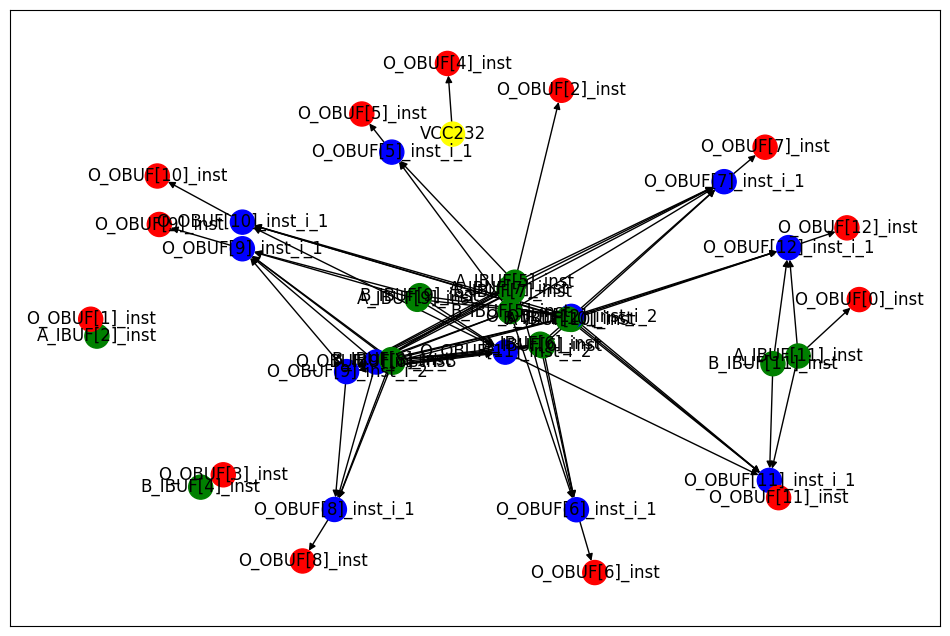

Archivo CSV generado: data/raw/add9se_07Y_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

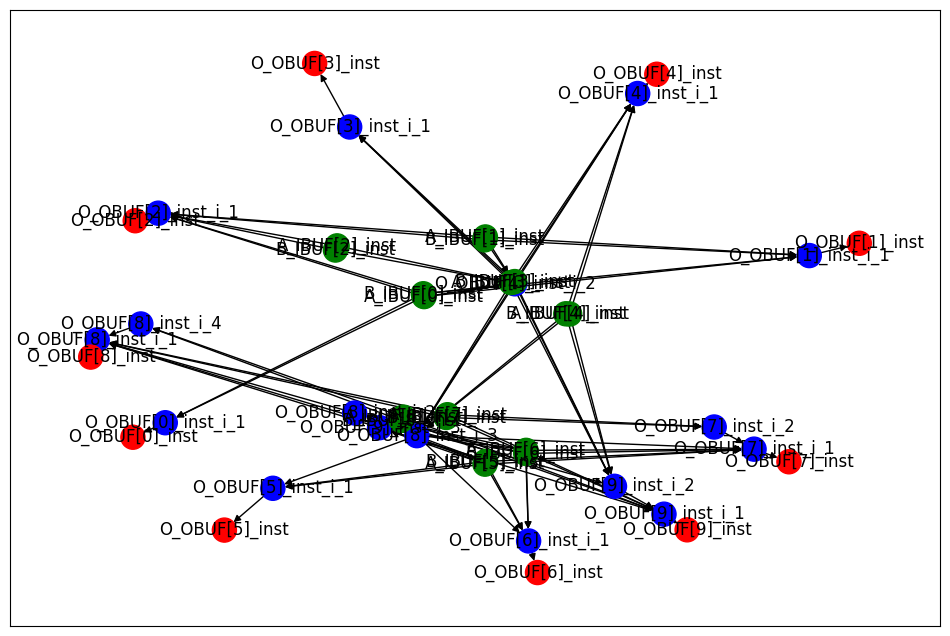

Archivo CSV generado: data/raw/add16u_1NN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

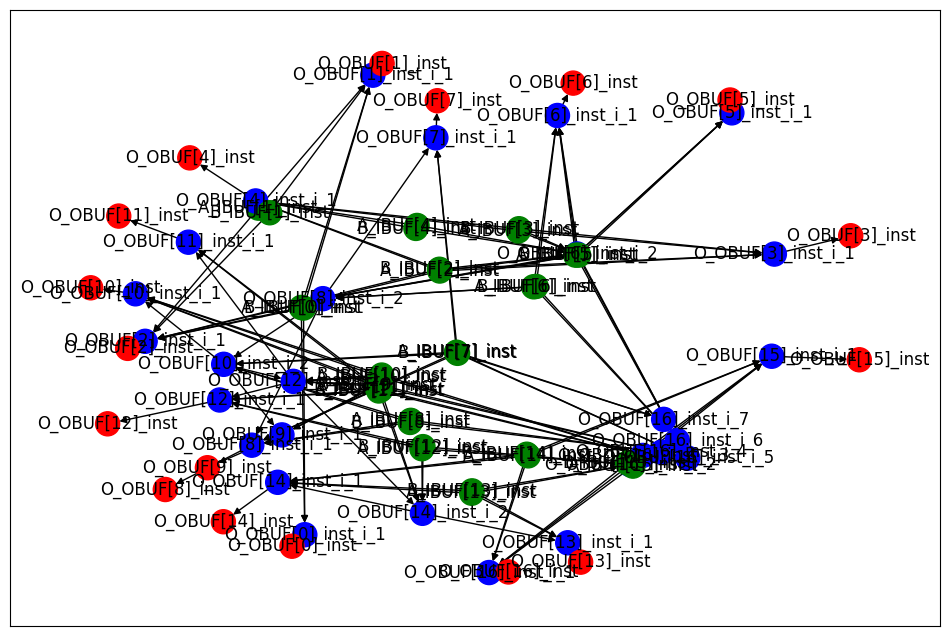

Archivo CSV generado: data/raw/add16u_1B4_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3

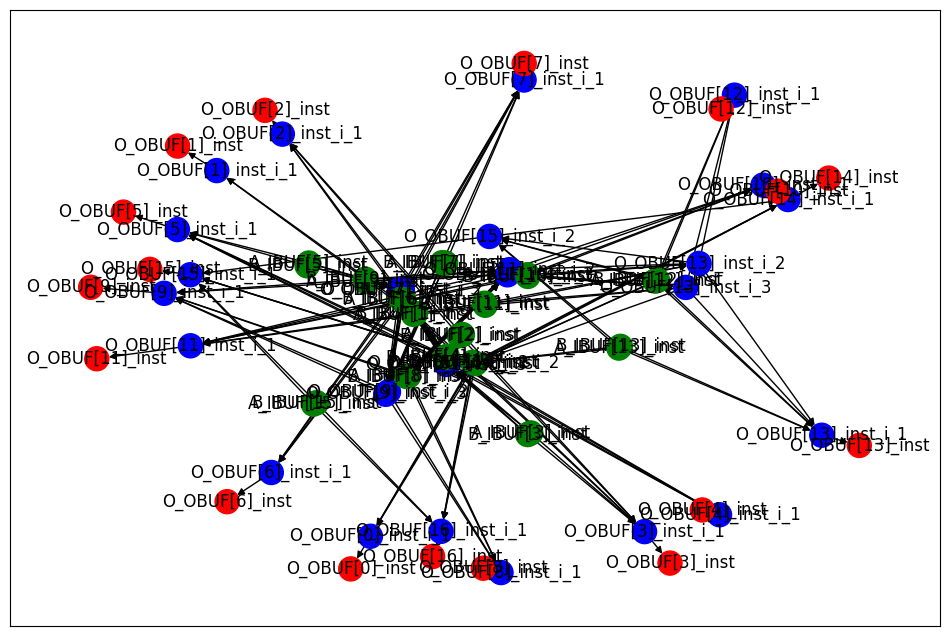

Archivo CSV generado: data/raw/add8s_6SN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

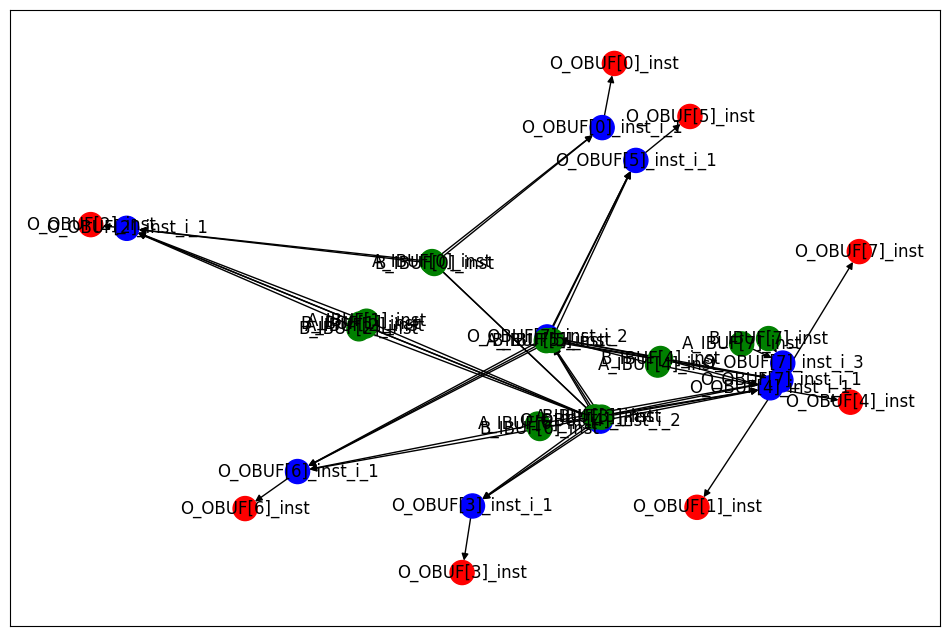

Archivo CSV generado: data/raw/add9se_09M_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output'

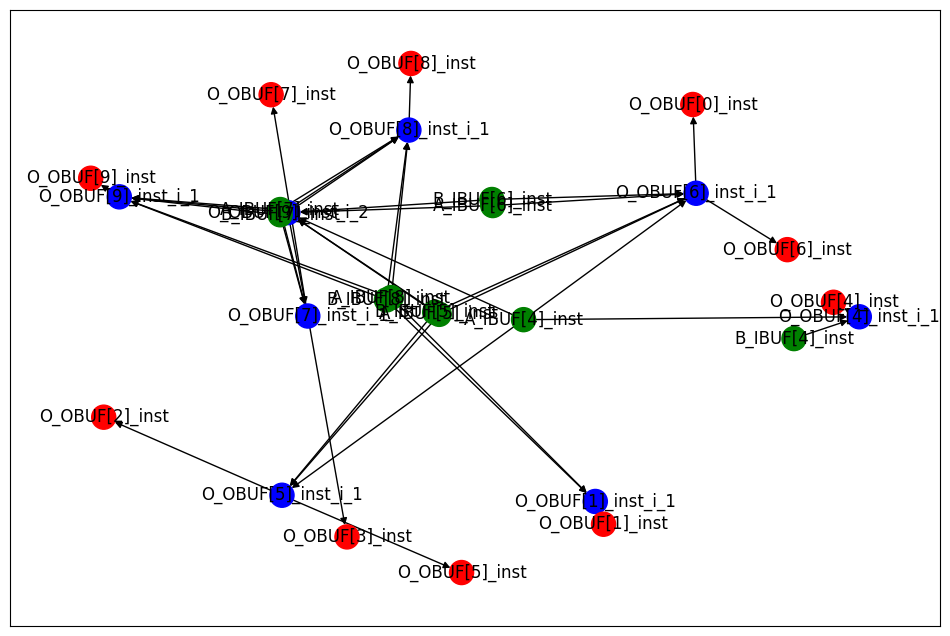

Archivo CSV generado: data/raw/add9se_056_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

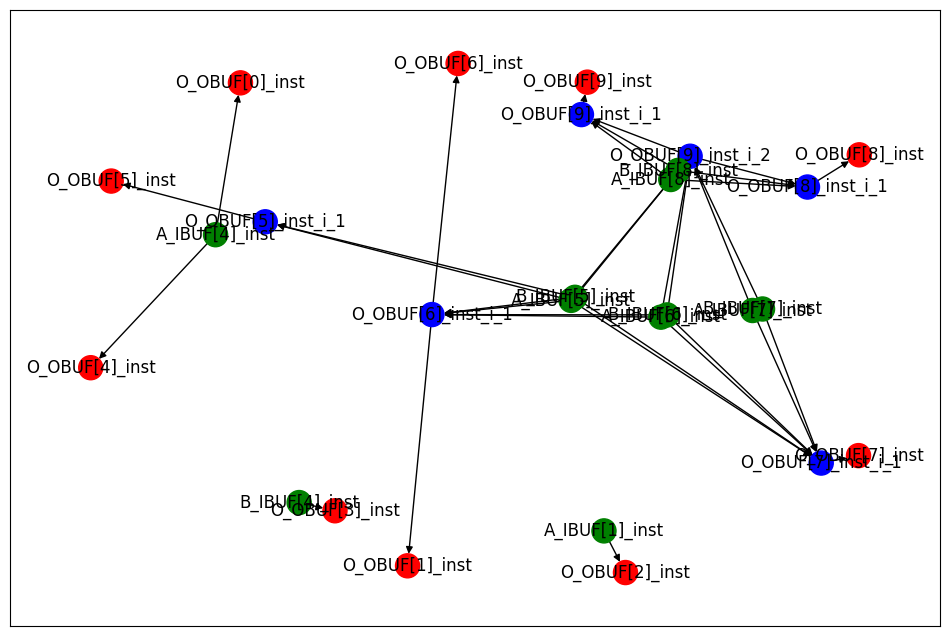

Archivo CSV generado: data/raw/add9se_05G_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

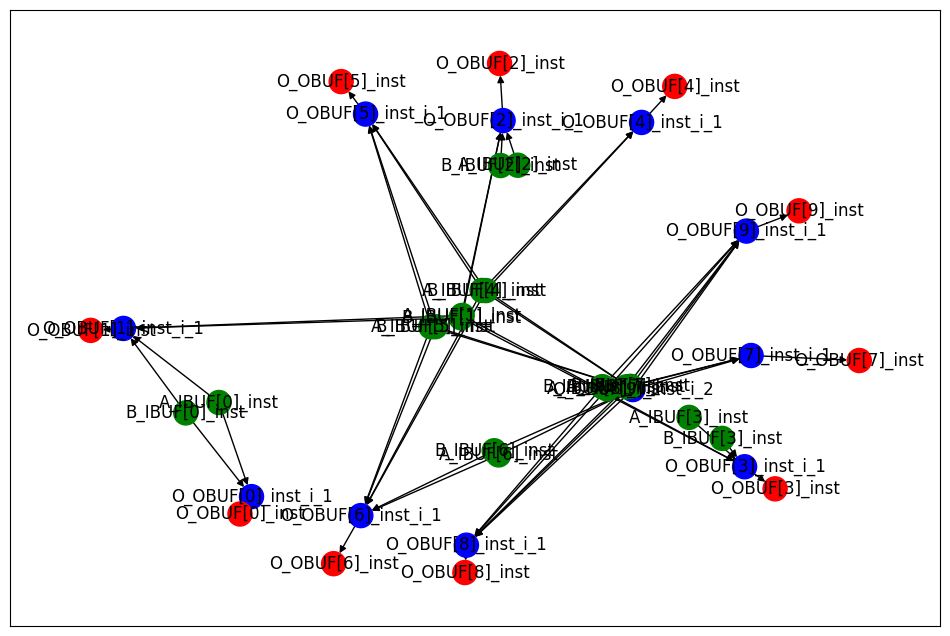

Archivo CSV generado: data/raw/add12u_4YR_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

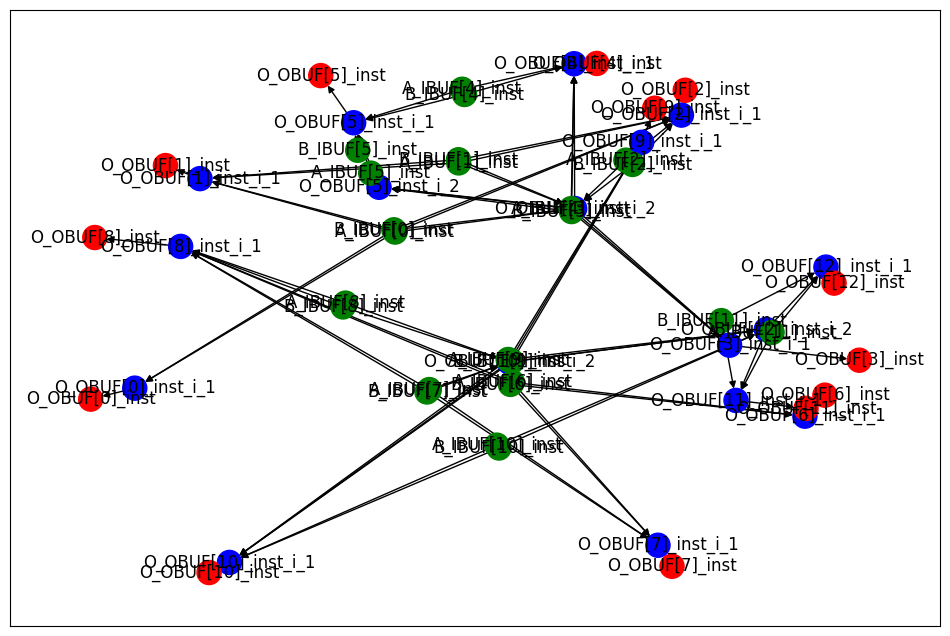

Archivo CSV generado: data/raw/add12u_054_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

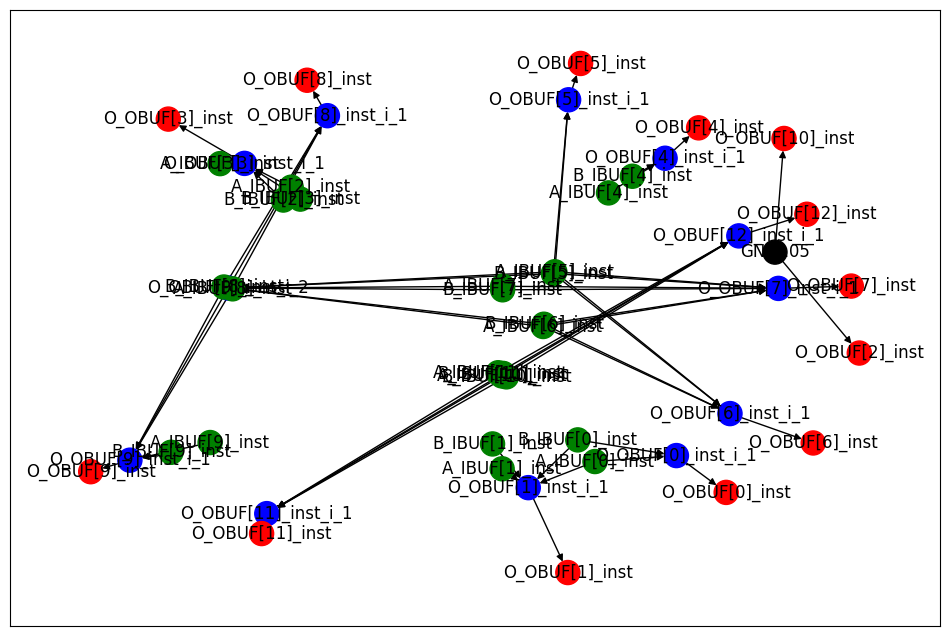

Archivo CSV generado: data/raw/add12u_2X6_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

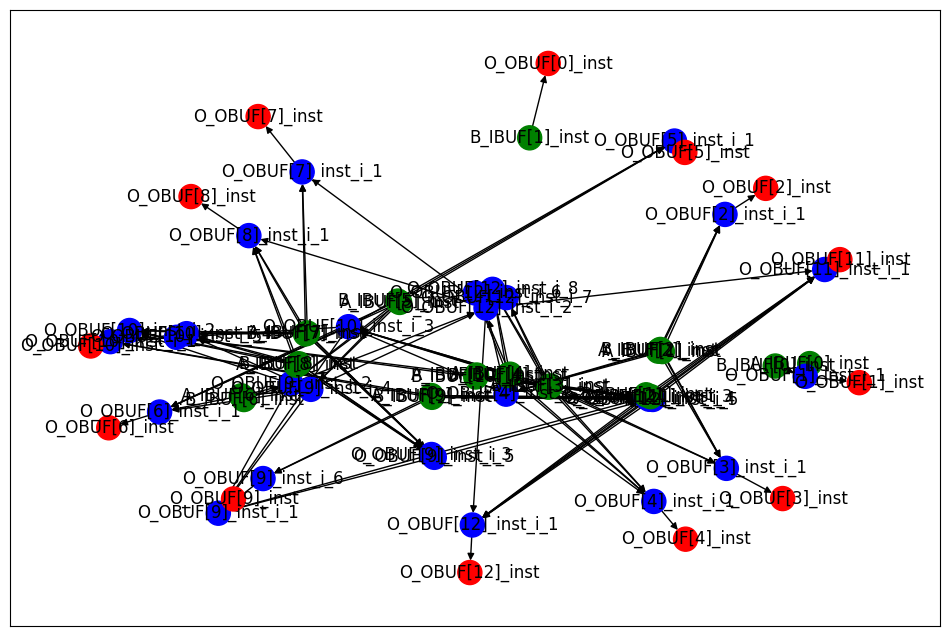

Archivo CSV generado: data/raw/add8se_8ZU_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output'

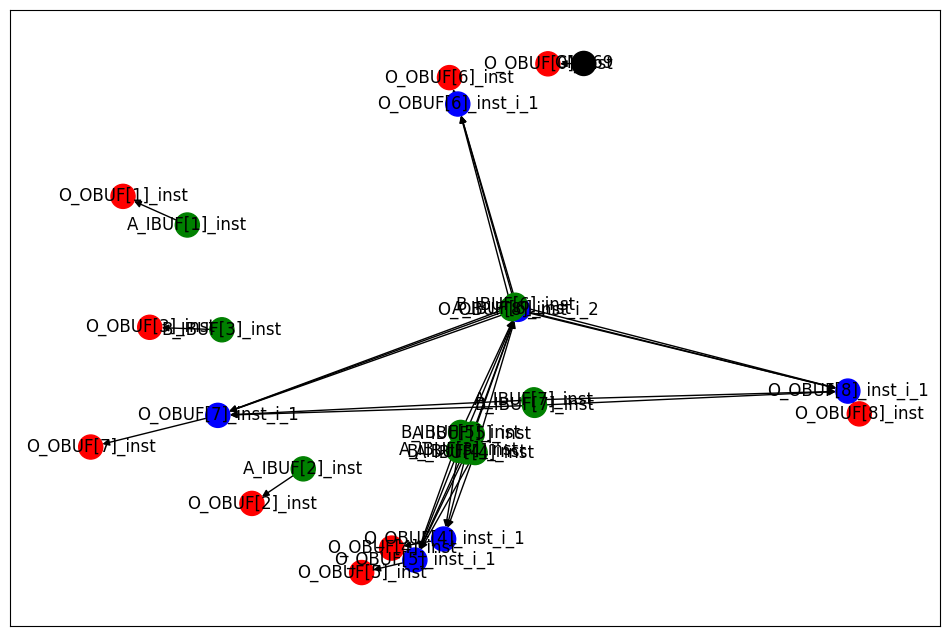

Archivo CSV generado: data/raw/add8u_88L_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'GND', 'node_name': 'GND49', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O

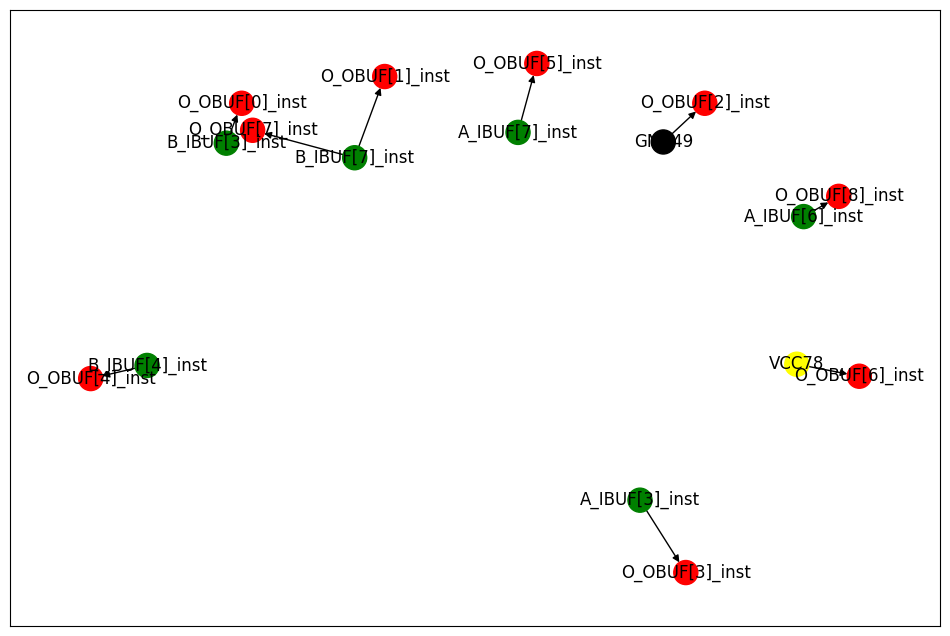

Archivo CSV generado: data/raw/add16u_0FJ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6

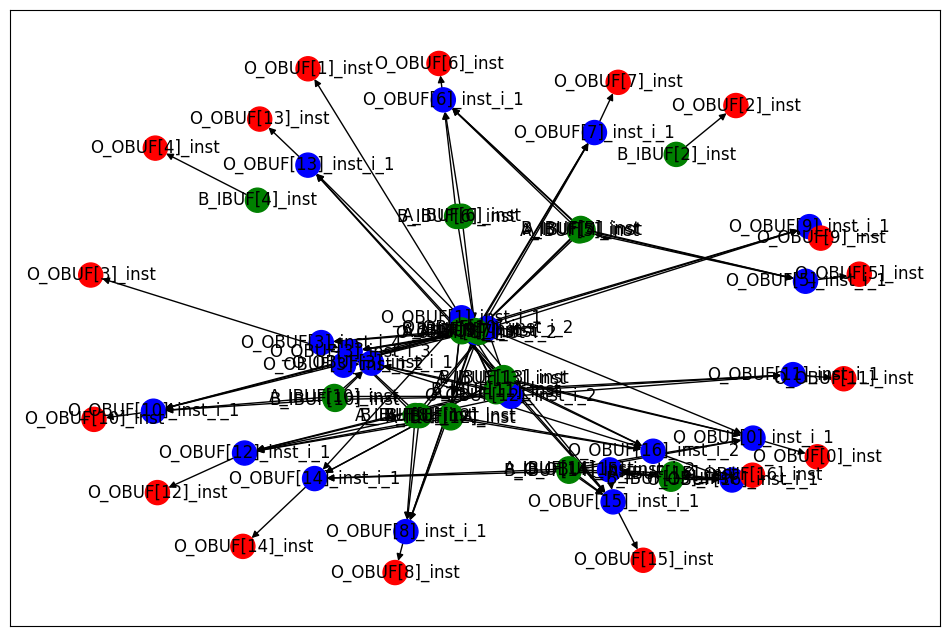

Archivo CSV generado: data/raw/add16se_2JY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[

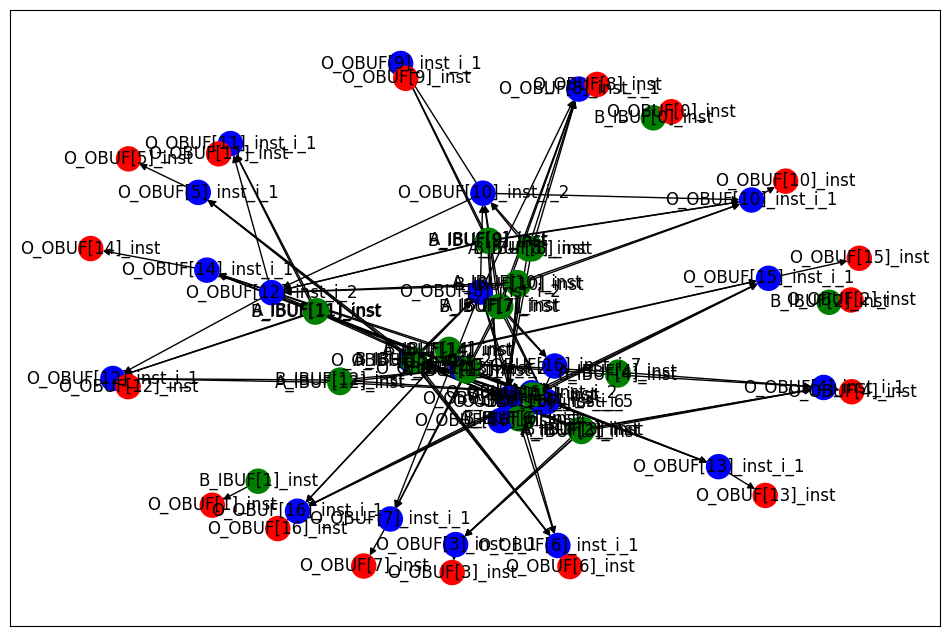

Archivo CSV generado: data/raw/add8se_7C9_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

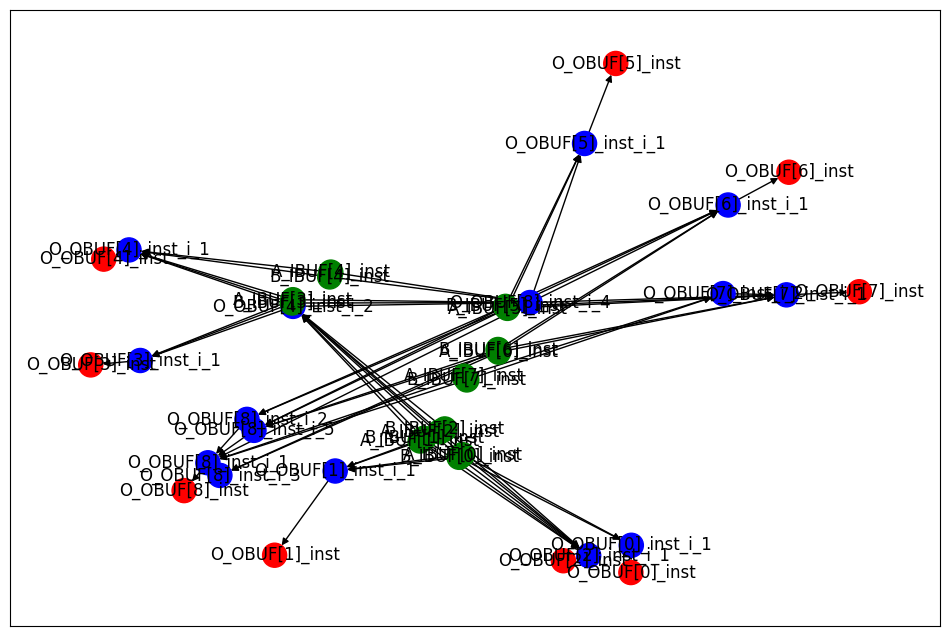

Archivo CSV generado: data/raw/add12se_54H_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

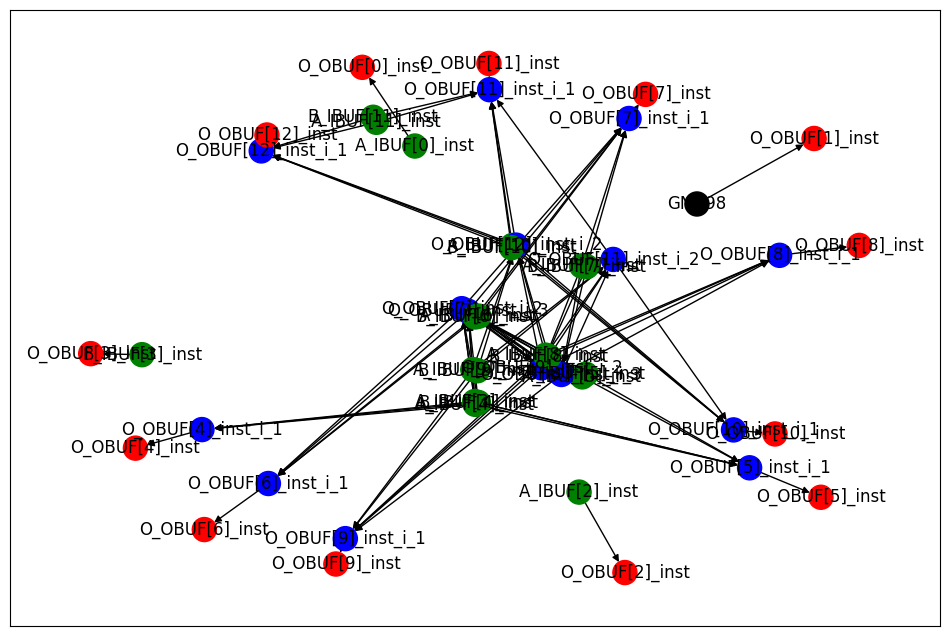

Archivo CSV generado: data/raw/add8se_90Z_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

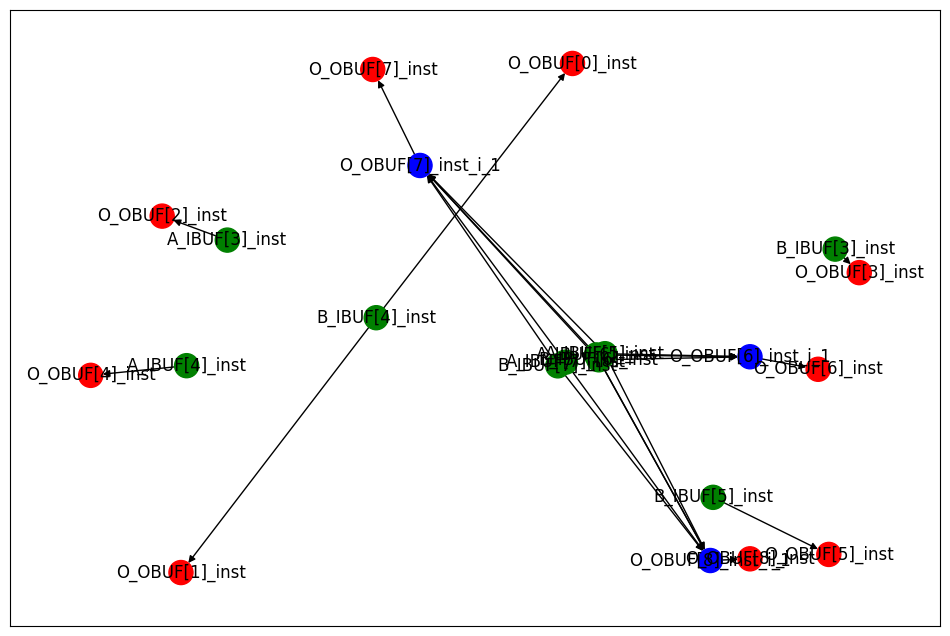

Archivo CSV generado: data/raw/add16u_1US_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

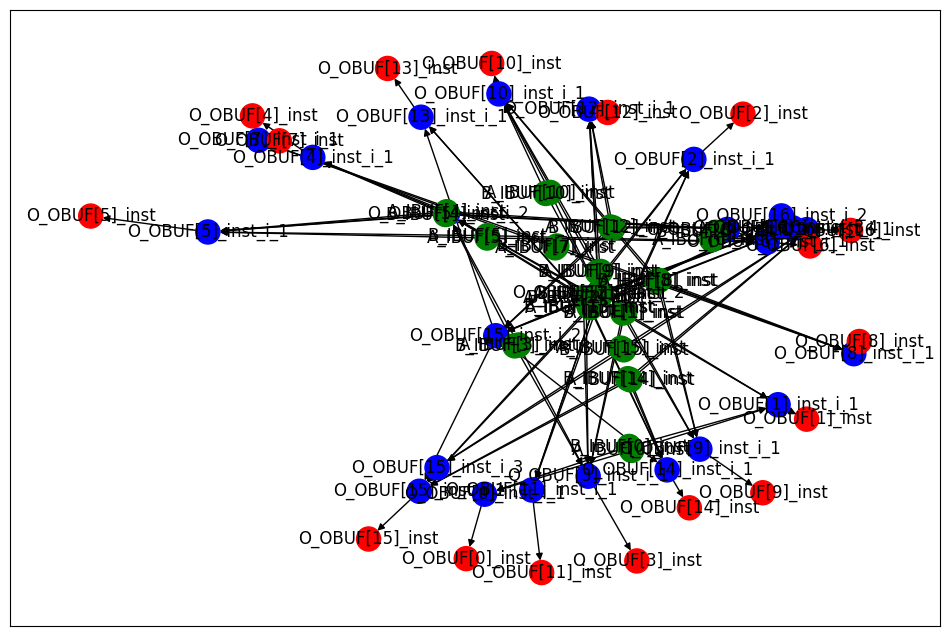

Archivo CSV generado: data/raw/add8s_704_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

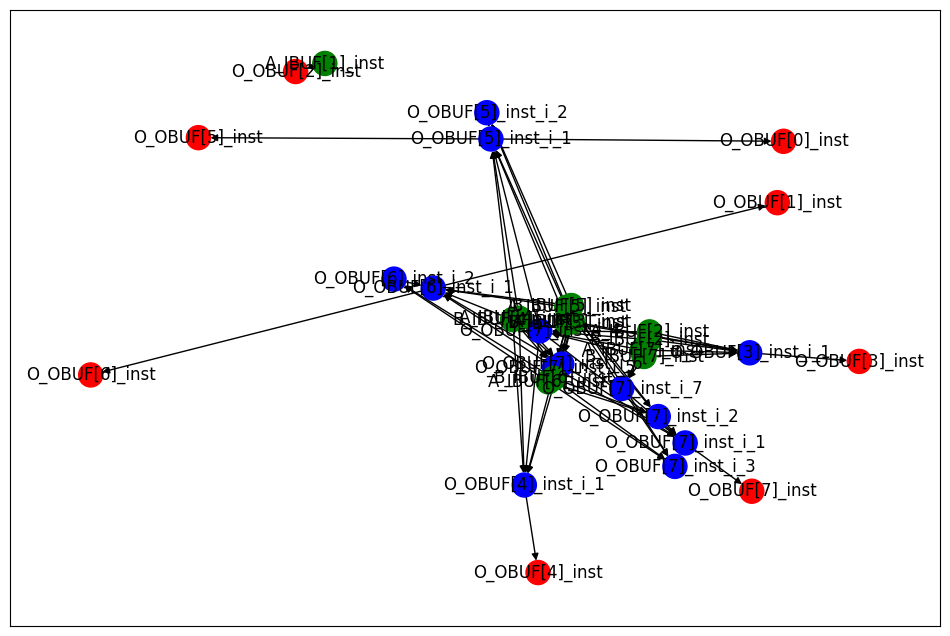

Archivo CSV generado: data/raw/add8s_6UN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

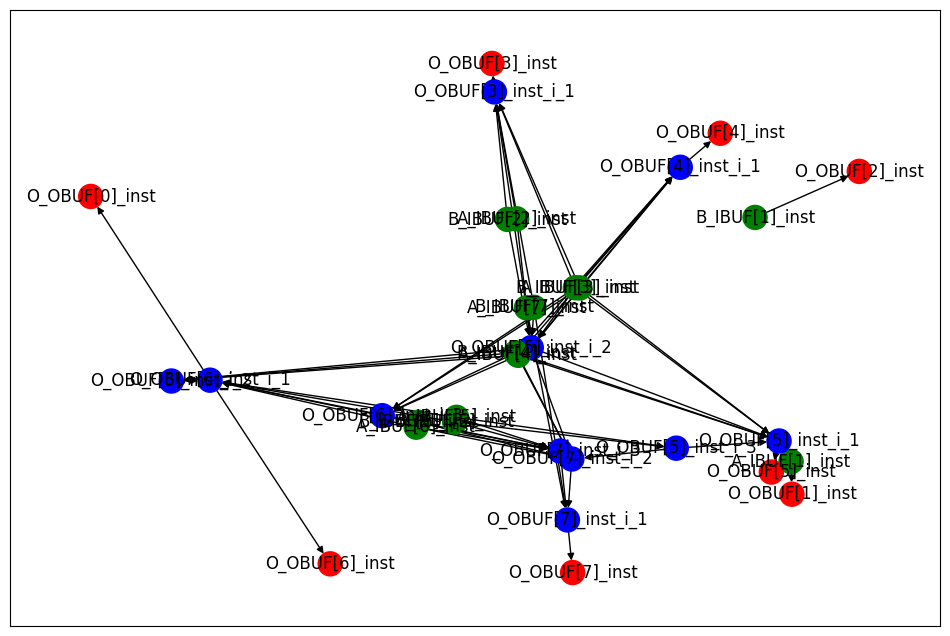

Archivo CSV generado: data/raw/add12u_04U_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['B_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], '

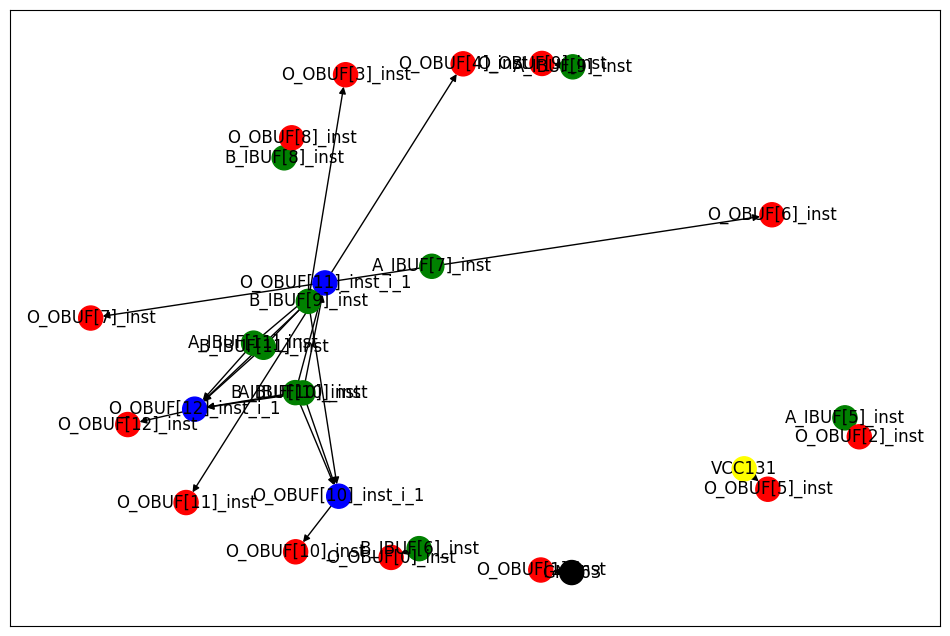

Archivo CSV generado: data/raw/add9se_09H_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

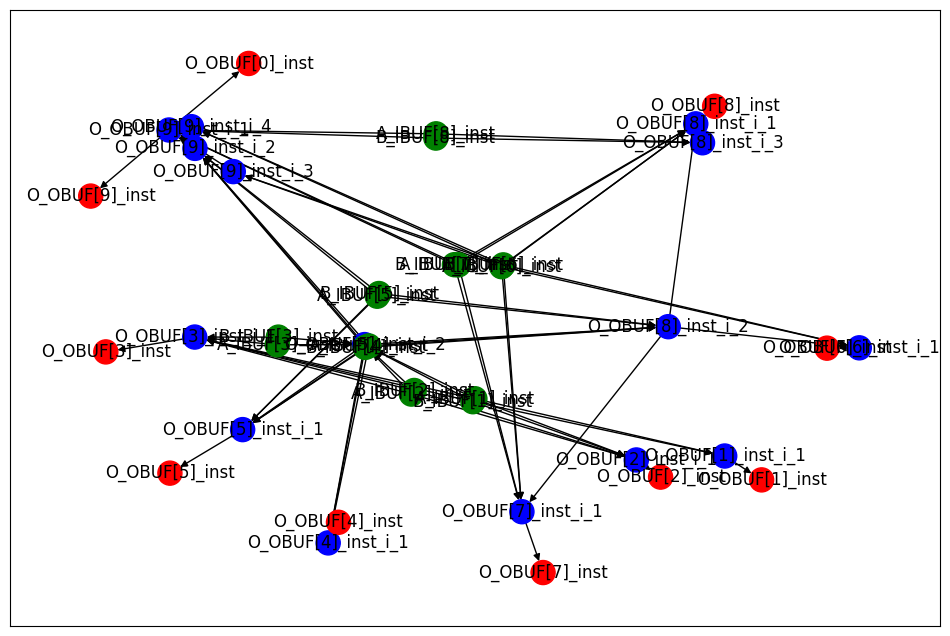

Archivo CSV generado: data/raw/add16u_1HK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

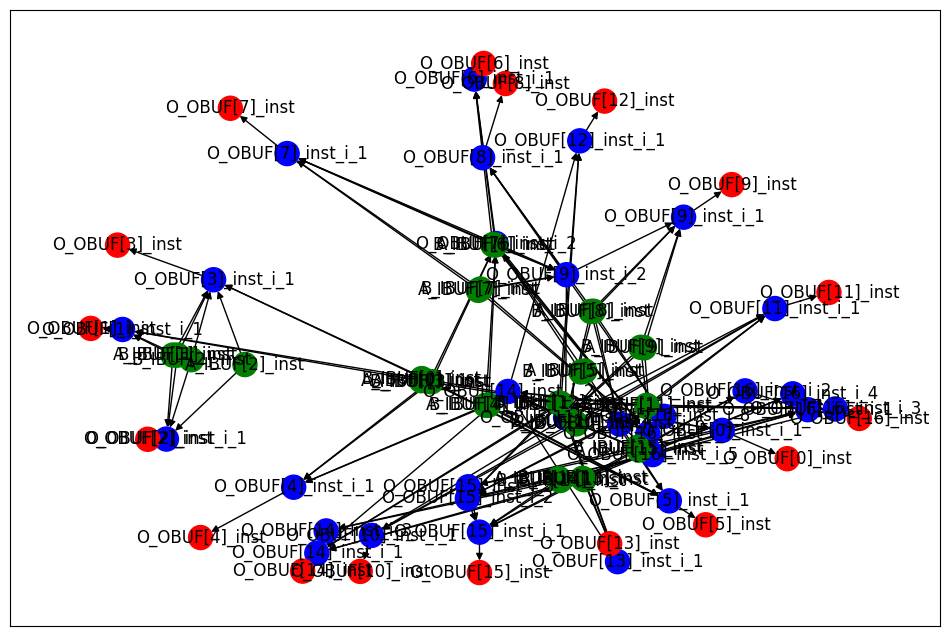

Archivo CSV generado: data/raw/add12se_54K_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_

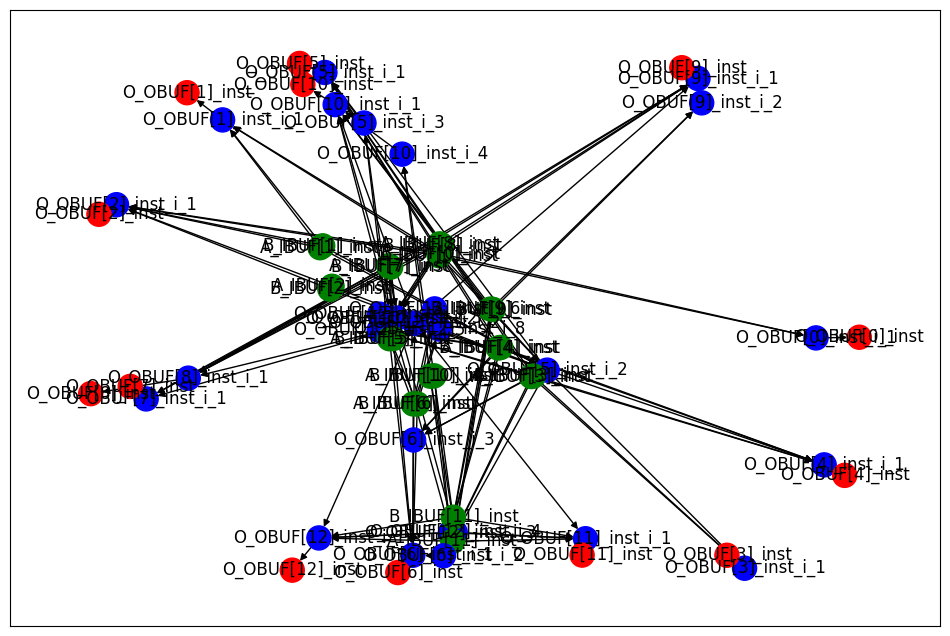

Archivo CSV generado: data/raw/add12se_529_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], '

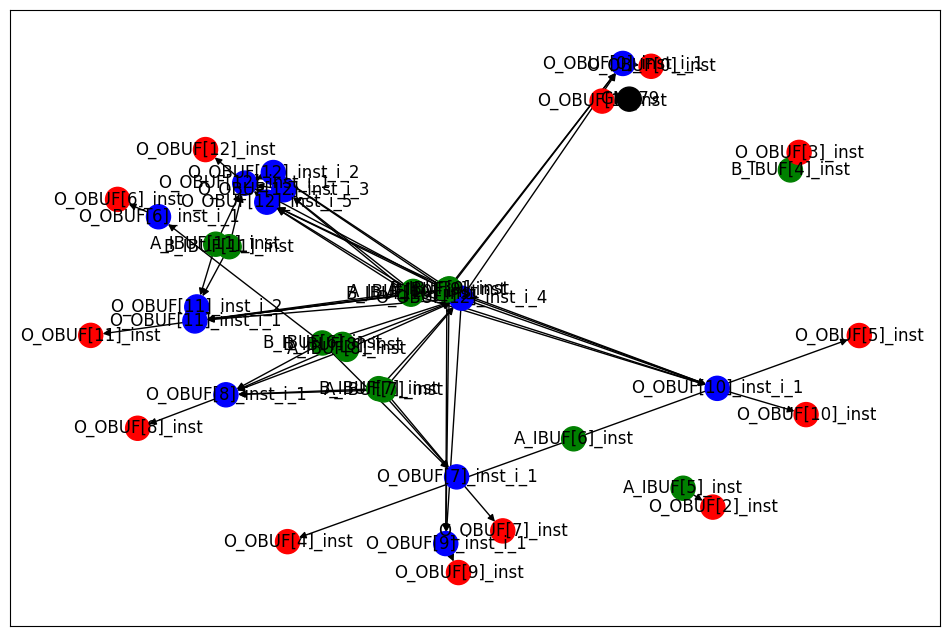

Archivo CSV generado: data/raw/add16u_0MH_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['O_OBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[13]_inst', 'node_input': ['B[13]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[14]_inst', 'node_input': ['B[14]'], 'node_output': ['O_OBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[15]_inst', 'node_input': ['B[15

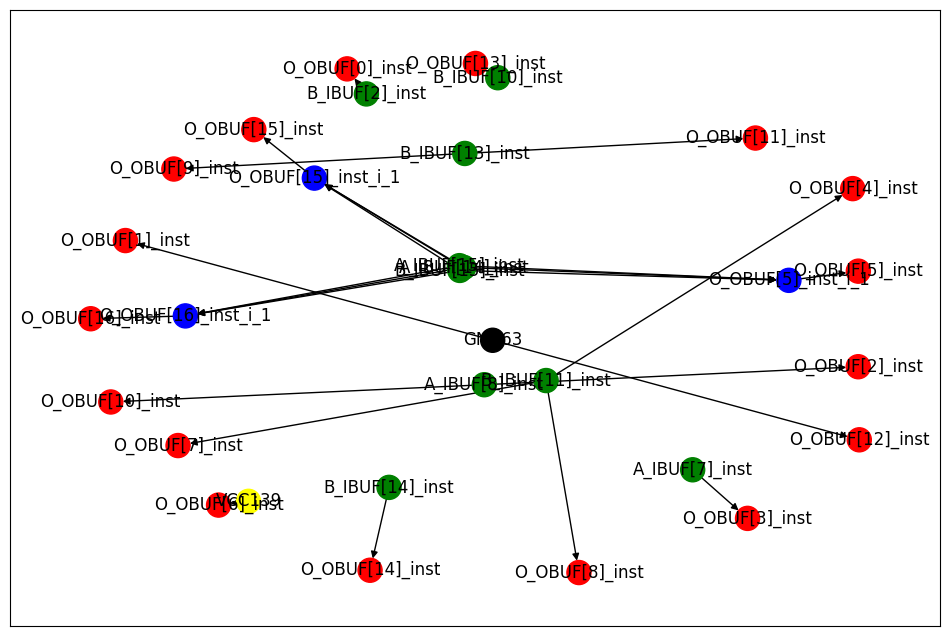

Archivo CSV generado: data/raw/add16u_0RN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3

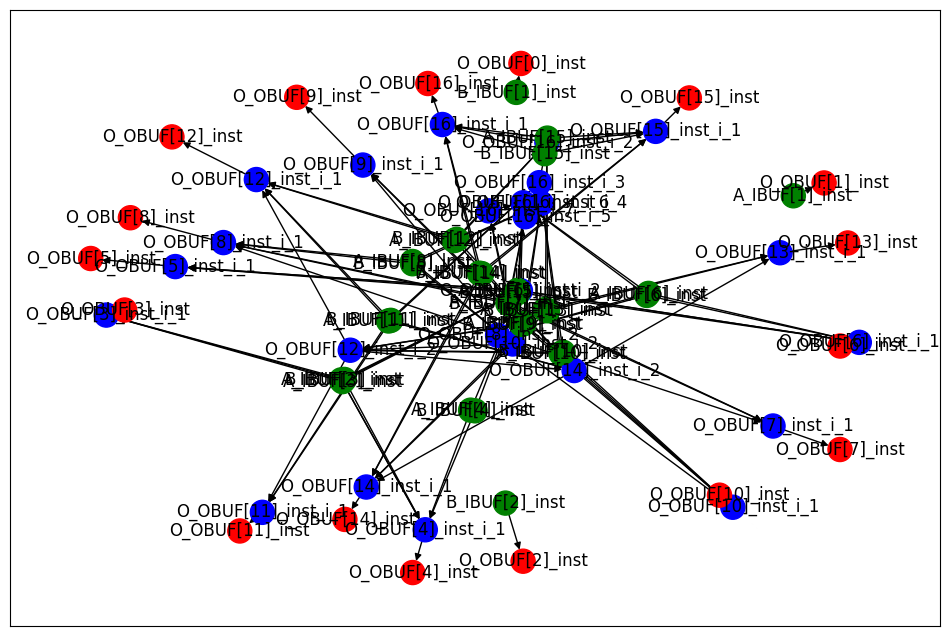

Archivo CSV generado: data/raw/add8s_6HF_netlist.csv
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[3]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[4]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[4]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[5]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[5]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[6]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[6]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[7]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[7]']}
{'node_type': 'VCC', 'node_name': 'VCC51', 'node_input': ['VCC'], 'node_out

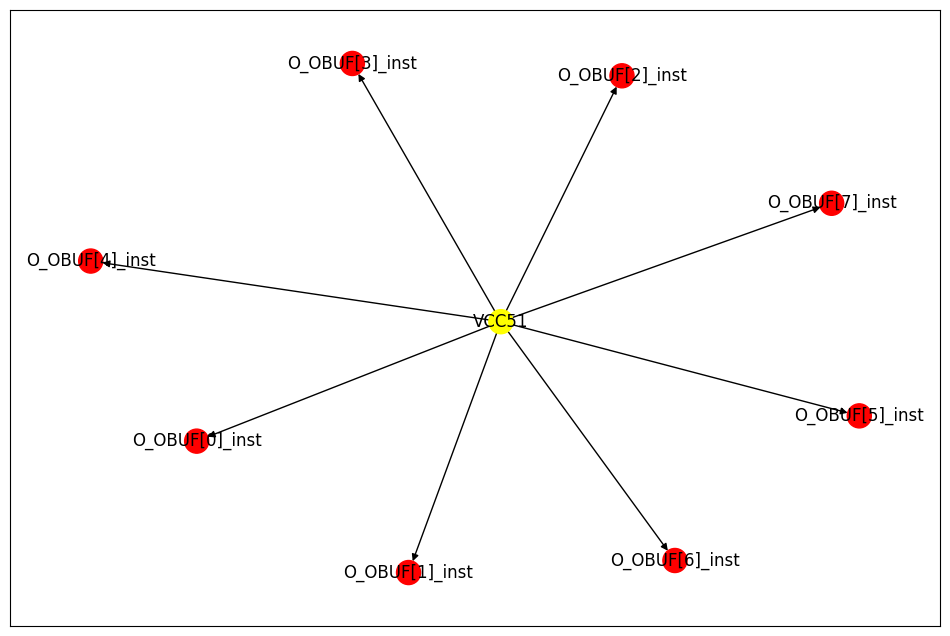

Archivo CSV generado: data/raw/add16se_20J_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[

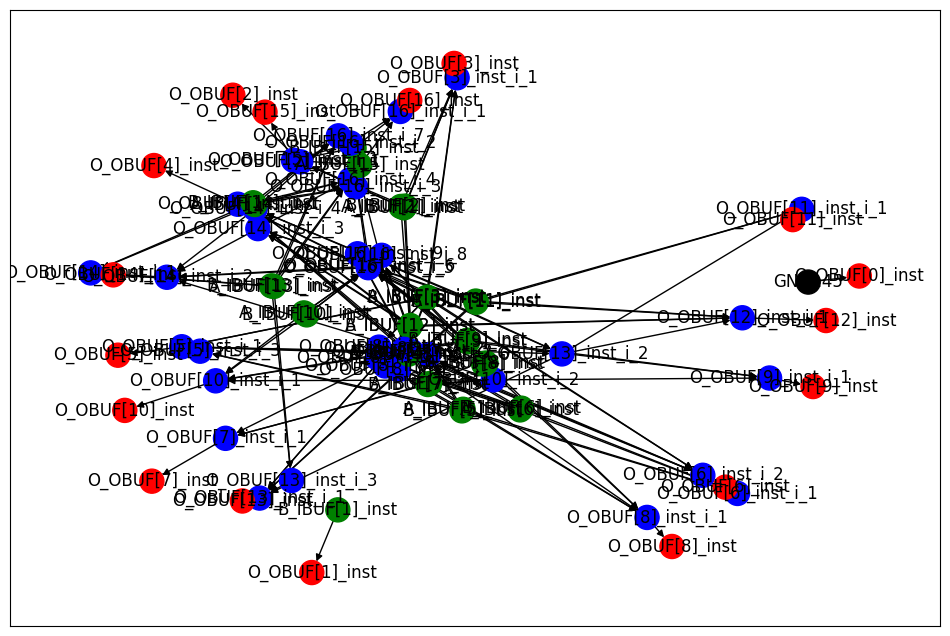

Archivo CSV generado: data/raw/add8u_8KZ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

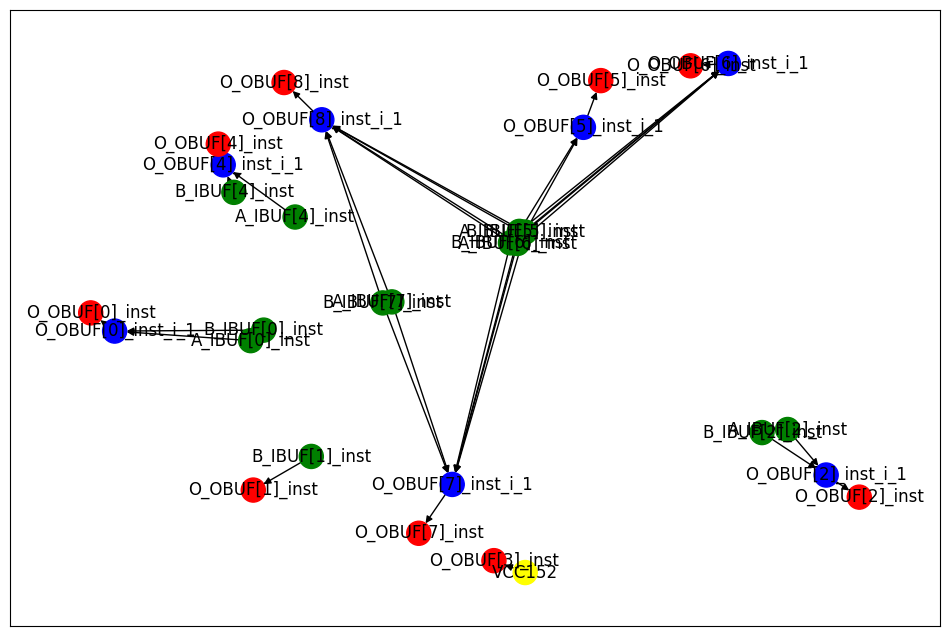

Archivo CSV generado: data/raw/add16se_26Q_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[

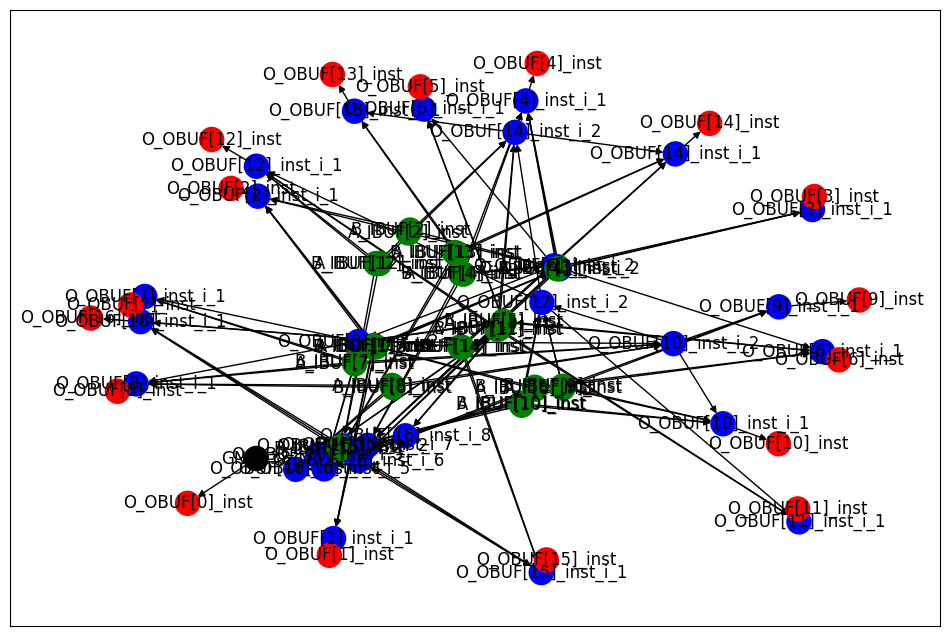

Archivo CSV generado: data/raw/add8s_6PA_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_out

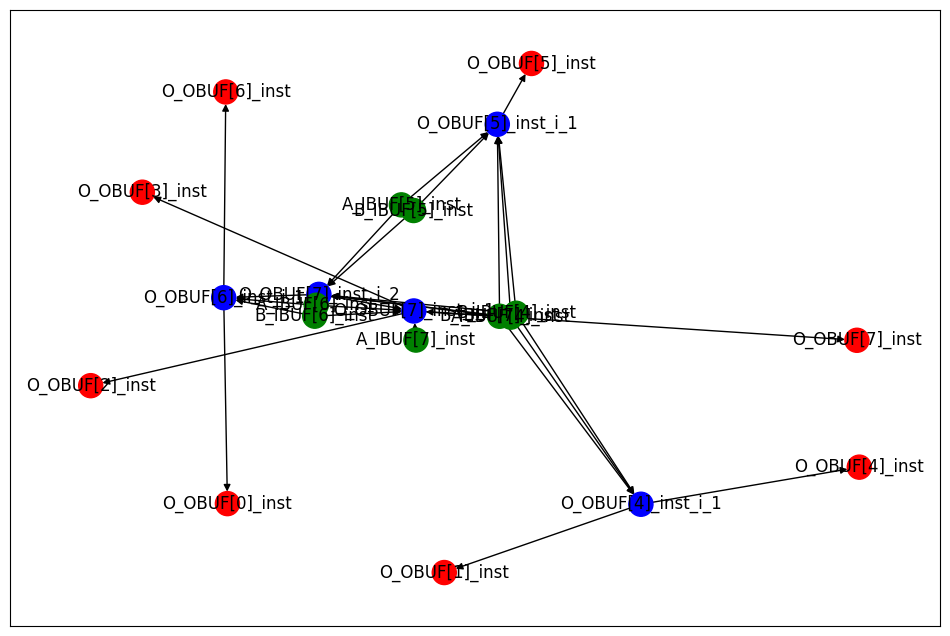

Archivo CSV generado: data/raw/add9se_080_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output': ['B_IBUF[8]']}
{'node_type': 'GND', 'node_name': 'GND50', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const0> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': 

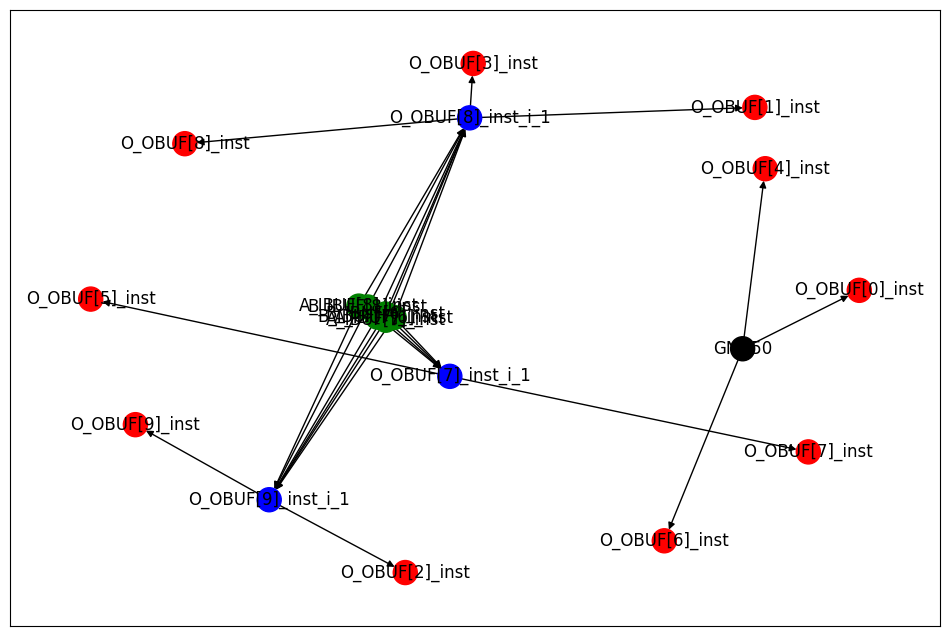

Archivo CSV generado: data/raw/add16u_0QC_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]

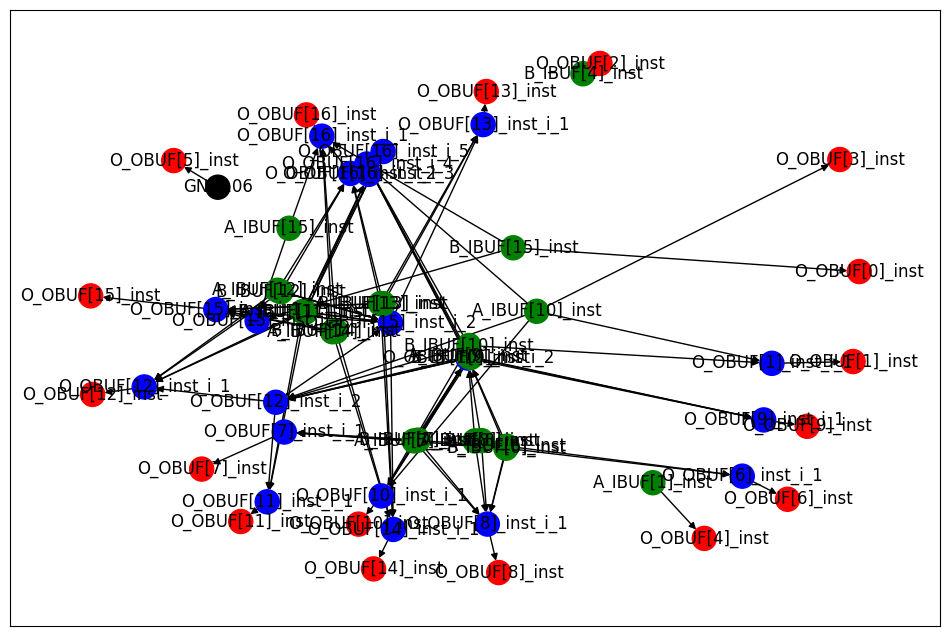

Archivo CSV generado: data/raw/add12se_54E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], '

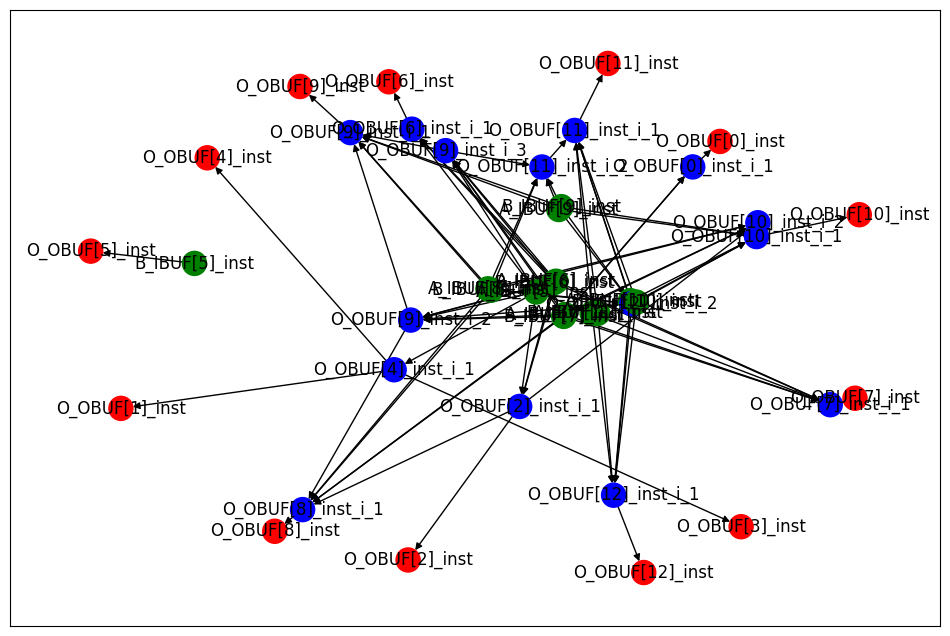

Archivo CSV generado: data/raw/add16u_0M0_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]

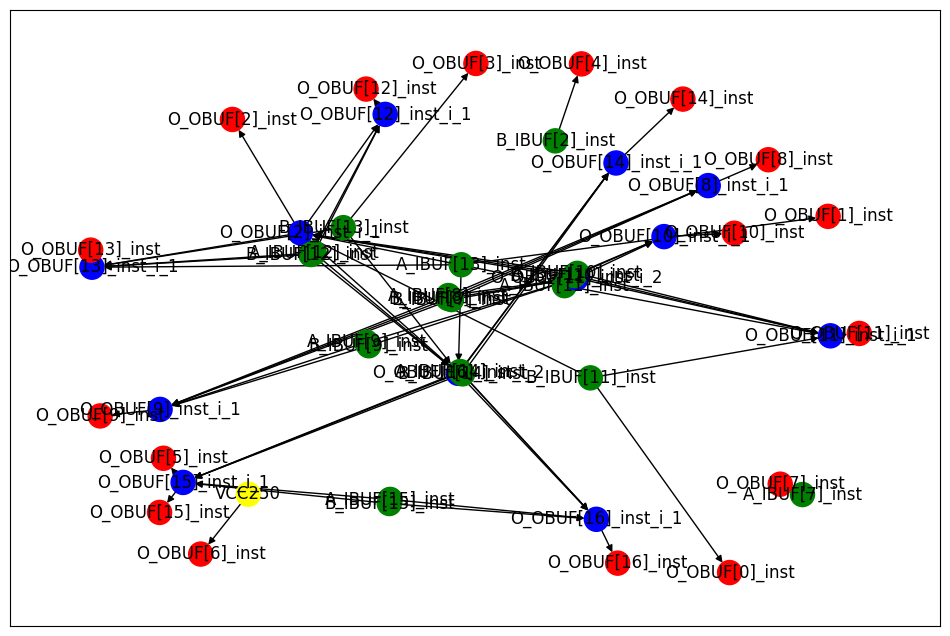

Archivo CSV generado: data/raw/add12u_0XY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_ou

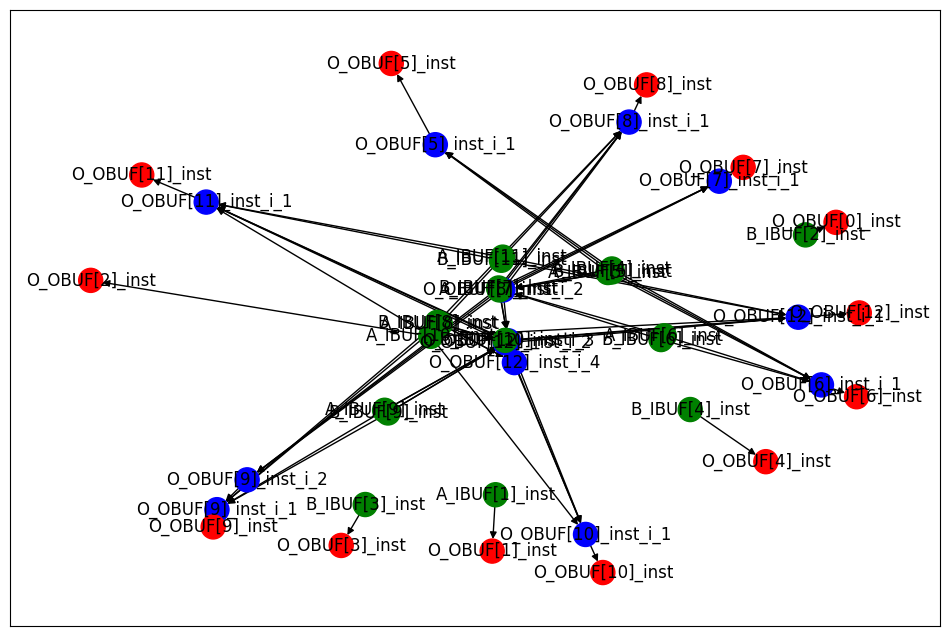

Archivo CSV generado: data/raw/add8se_90J_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output'

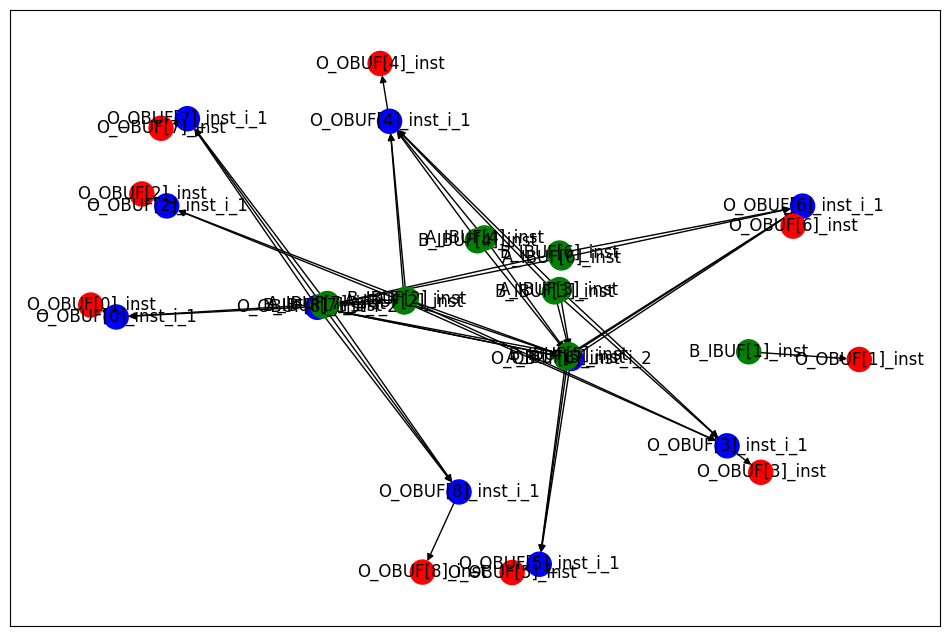

Archivo CSV generado: data/raw/add9se_0DG_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

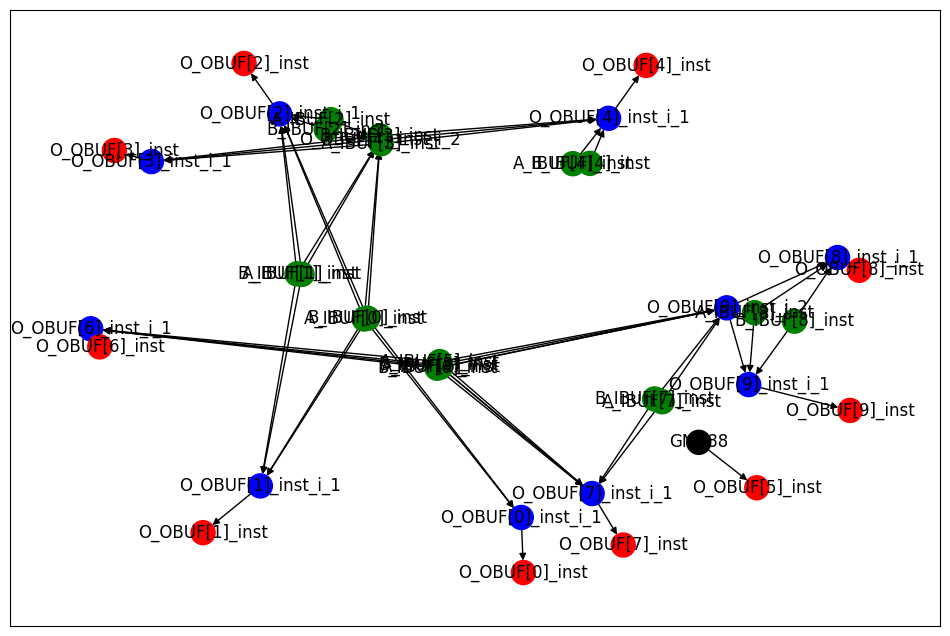

Archivo CSV generado: data/raw/add16u_00G_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9

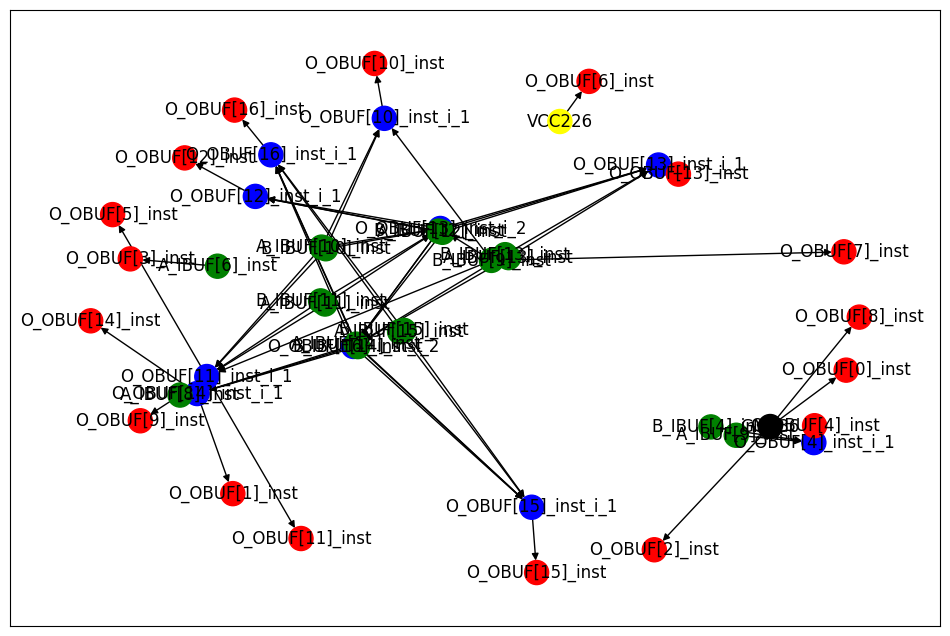

Archivo CSV generado: data/raw/add8se_8YC_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

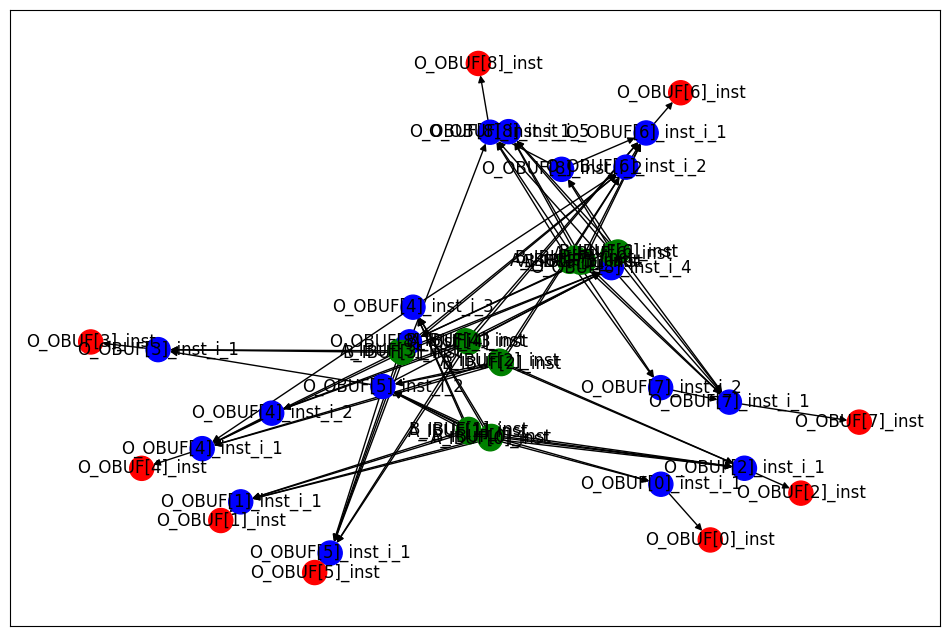

Archivo CSV generado: data/raw/add8s_6X7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

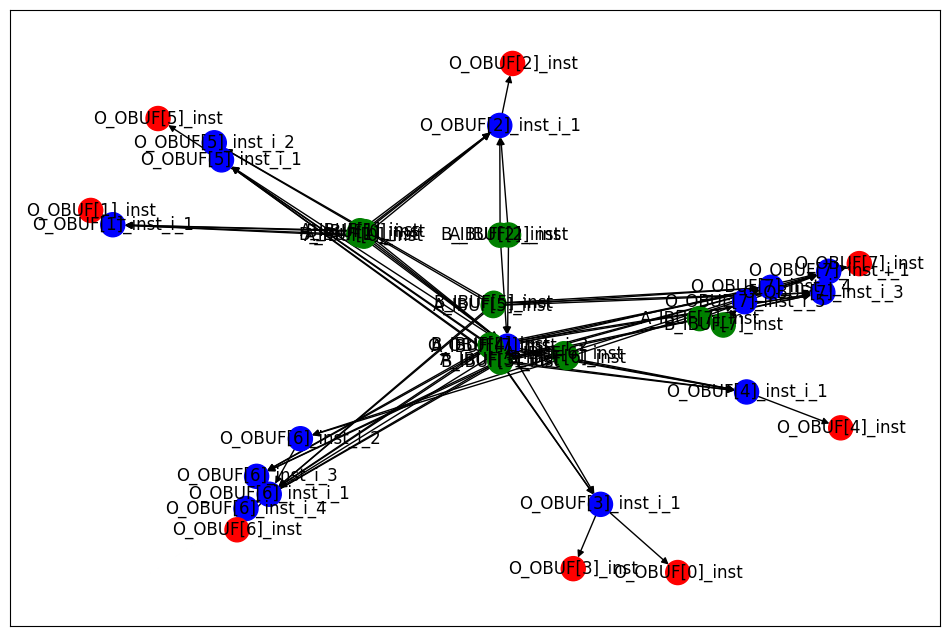

Archivo CSV generado: data/raw/add12u_2MB_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['O_OBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'n

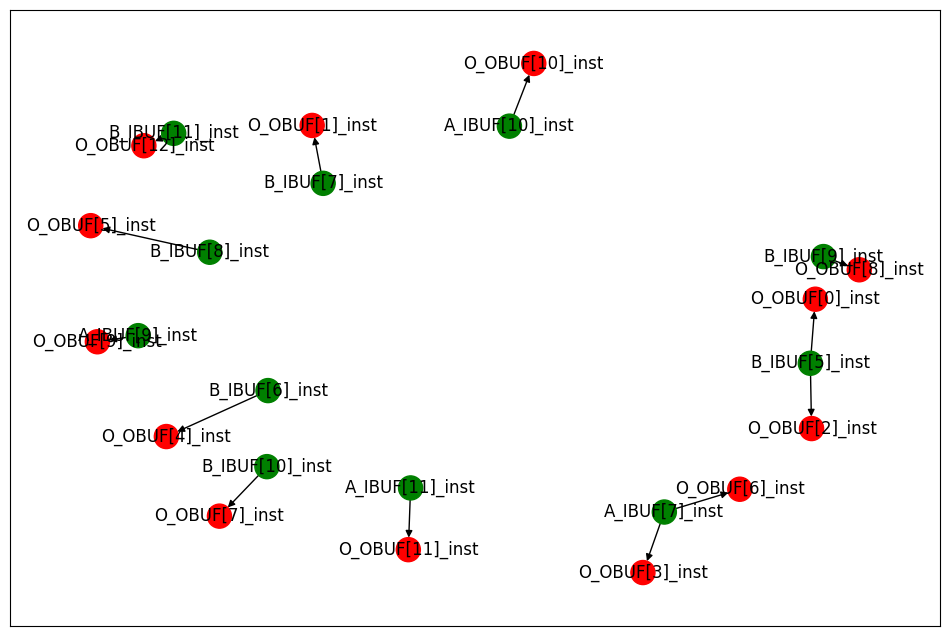

Archivo CSV generado: data/raw/add8u_8AS_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND54', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]

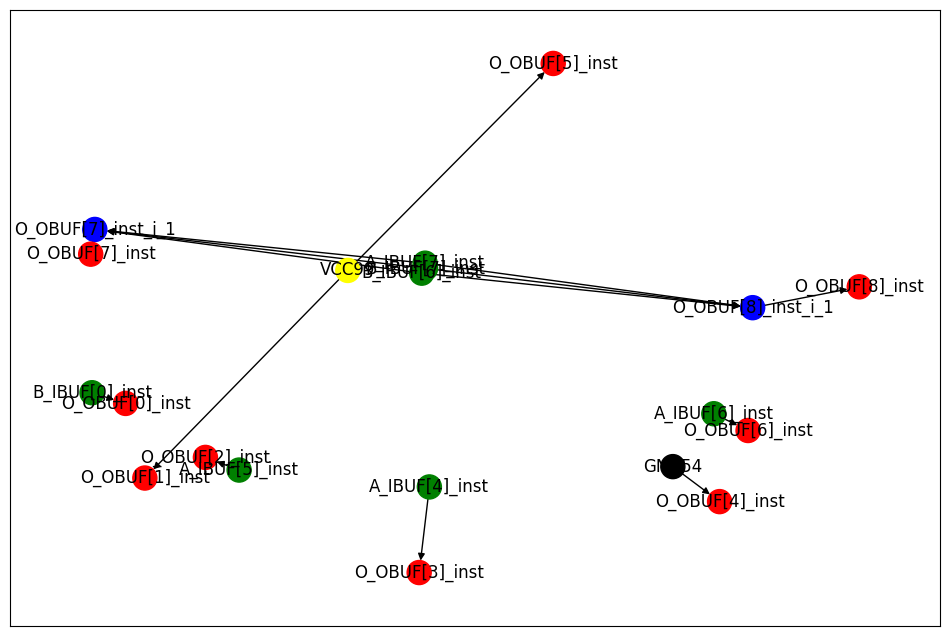

Archivo CSV generado: data/raw/add8se_7LN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

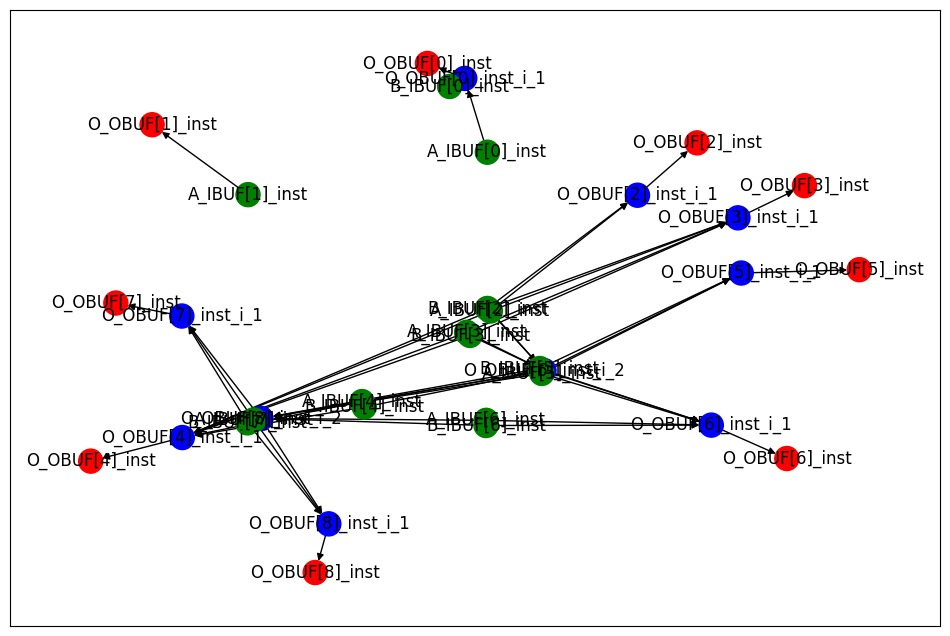

Archivo CSV generado: data/raw/add12se_4ZY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_

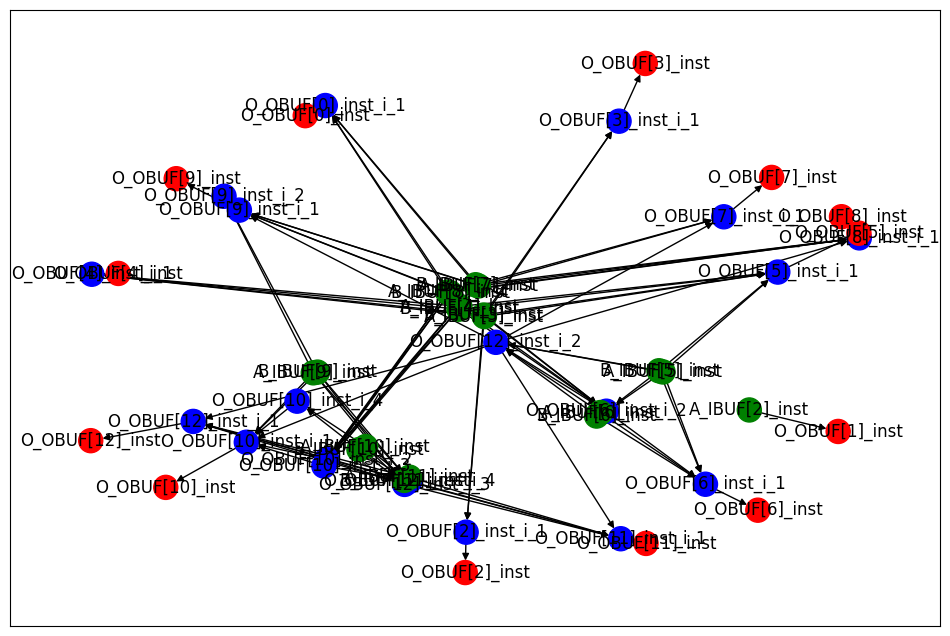

Archivo CSV generado: data/raw/add9se_0AD_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

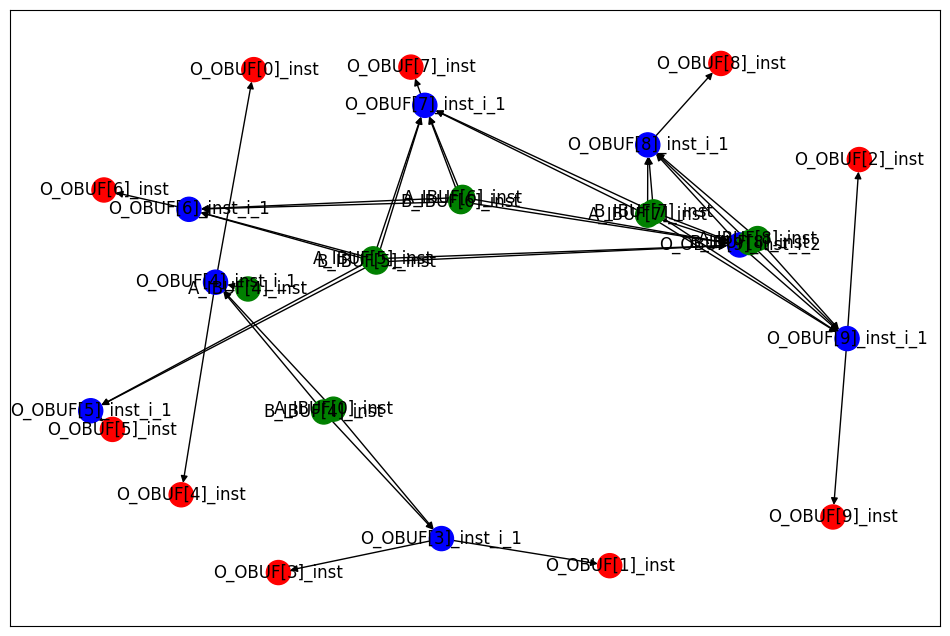

Archivo CSV generado: data/raw/add8se_7J7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output'

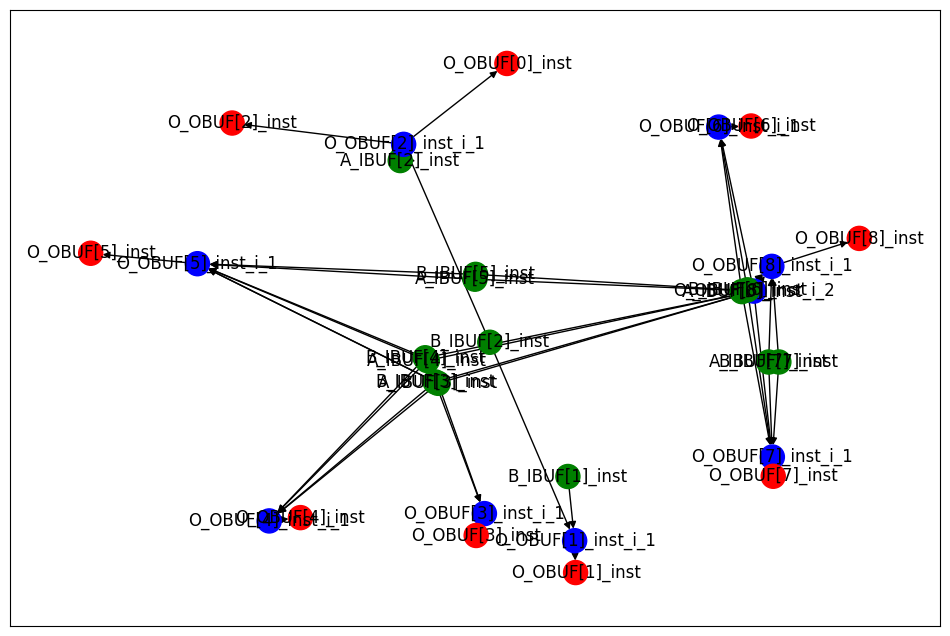

Archivo CSV generado: data/raw/add8se_72D_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output'

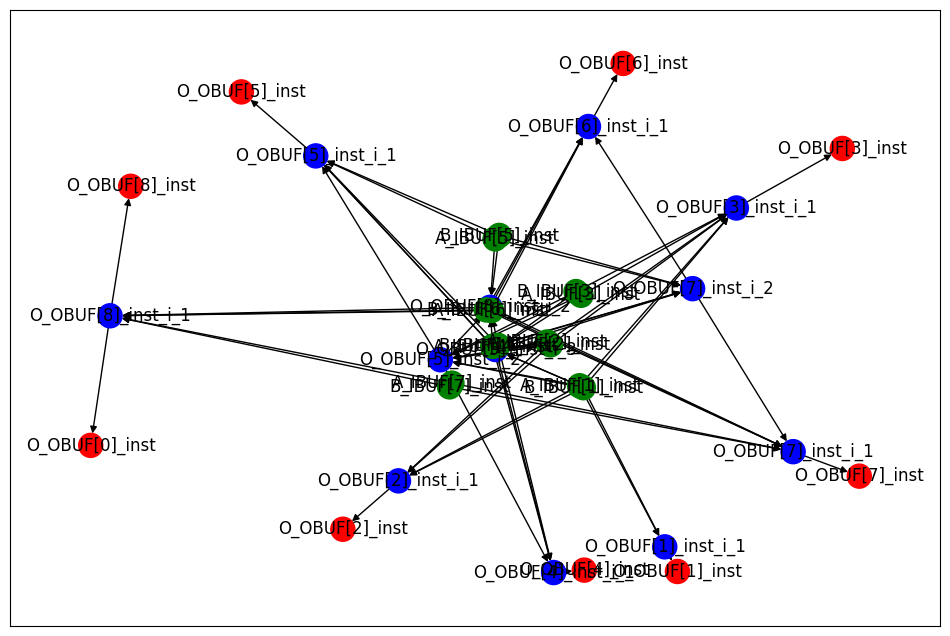

Archivo CSV generado: data/raw/add8se_91V_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[2]'], 'node_outpu

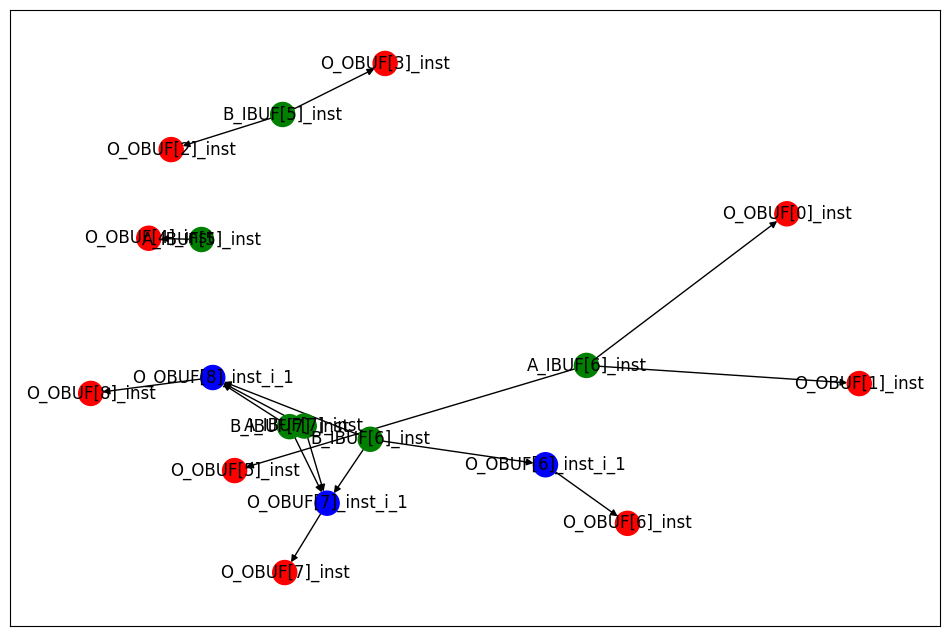

Archivo CSV generado: data/raw/add8u_8MK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

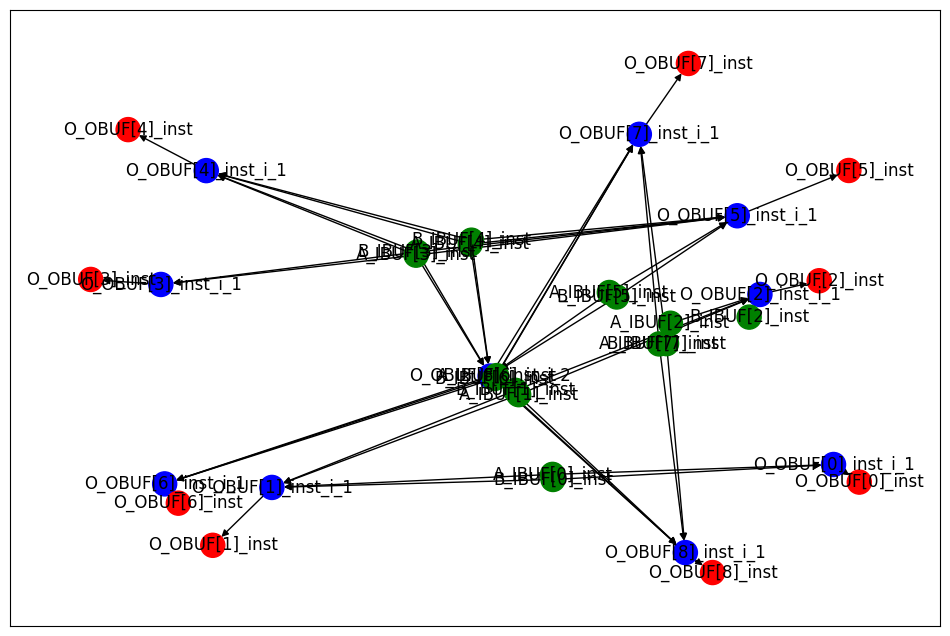

Archivo CSV generado: data/raw/add16u_0GK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['B_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[12]_inst', 'node_input': ['

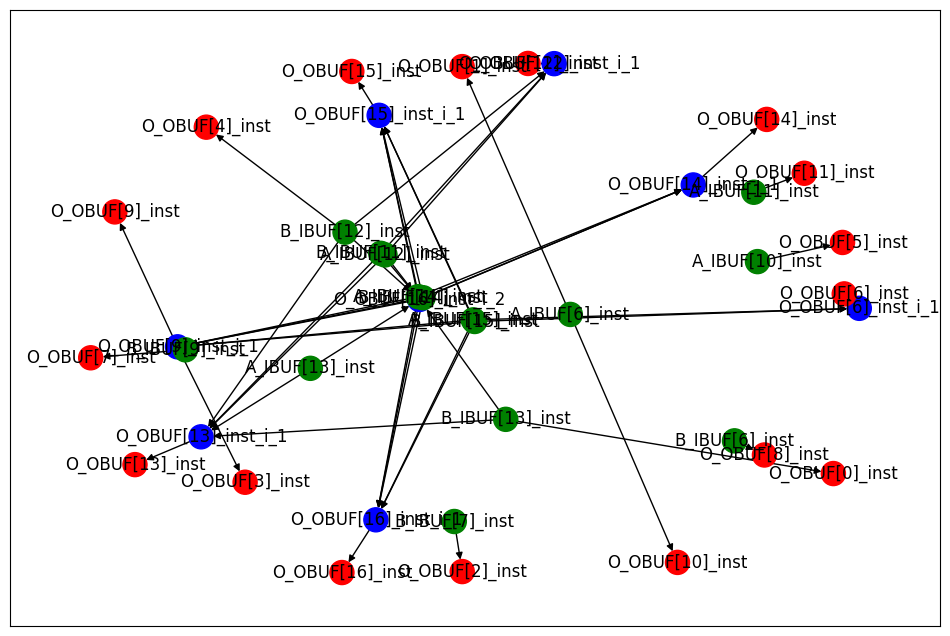

Archivo CSV generado: data/raw/add8se_8V4_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

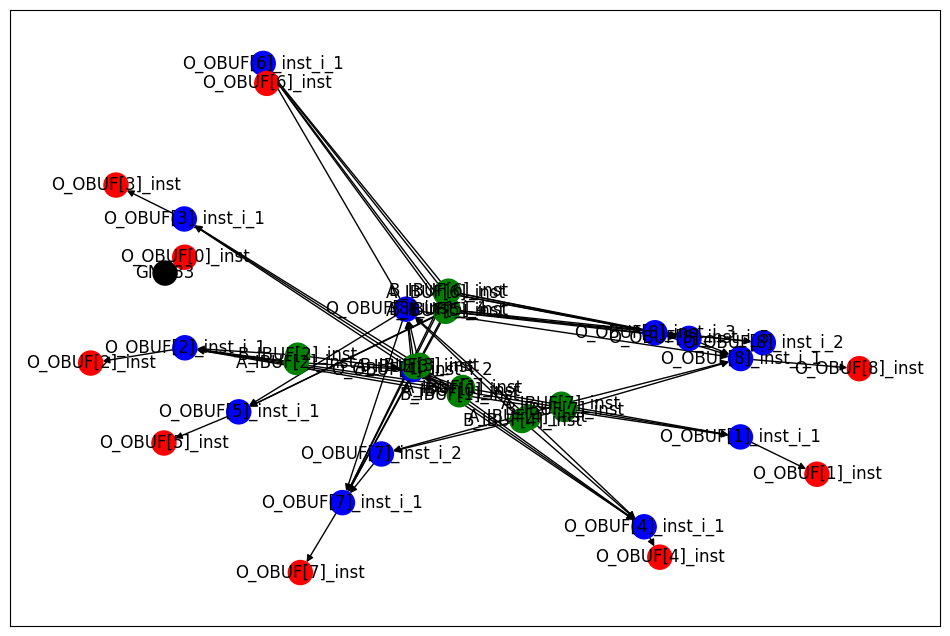

Archivo CSV generado: data/raw/add16u_02U_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]

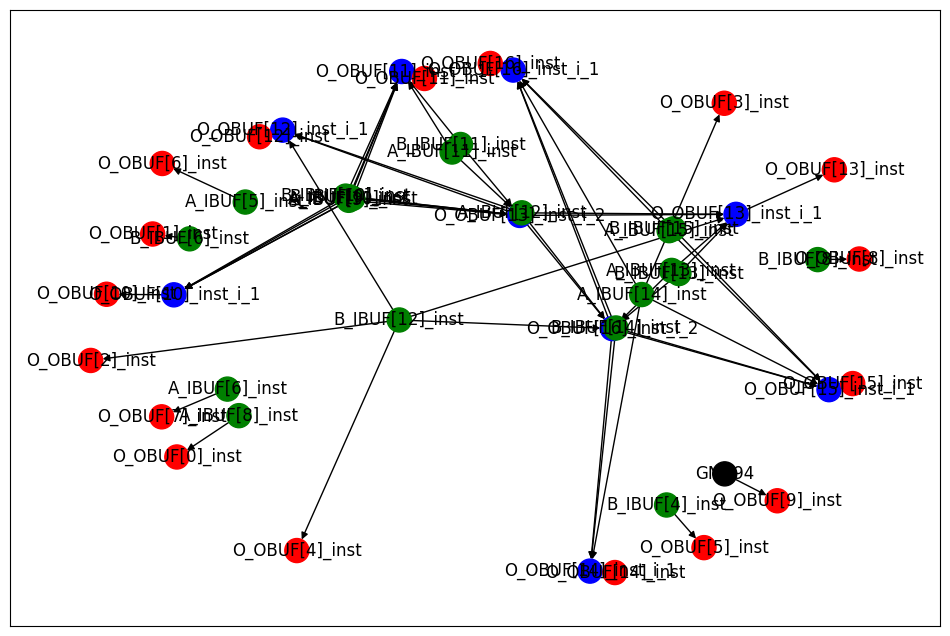

Archivo CSV generado: data/raw/add8s_6FC_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

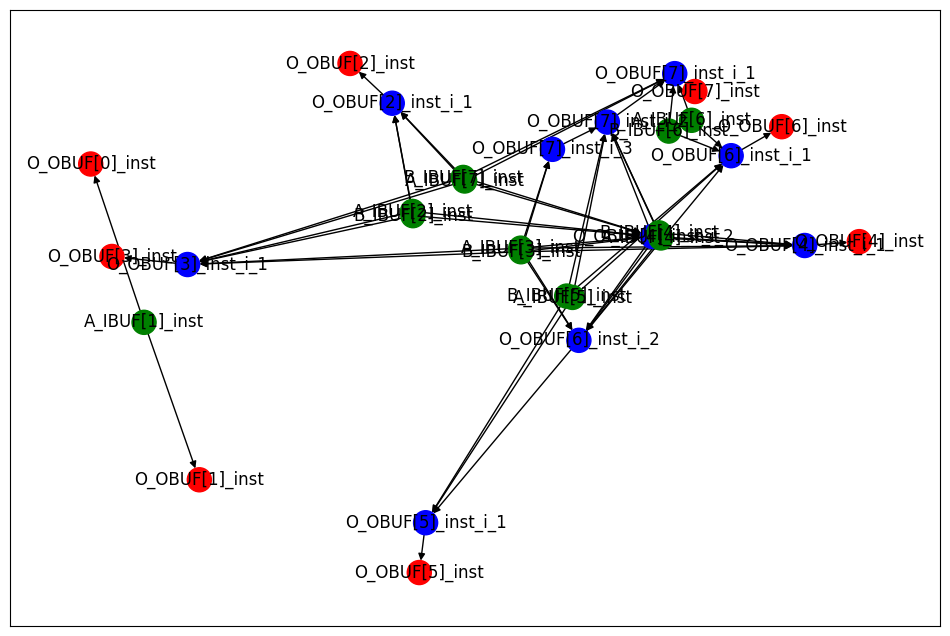

Archivo CSV generado: data/raw/add12u_0T9_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_o

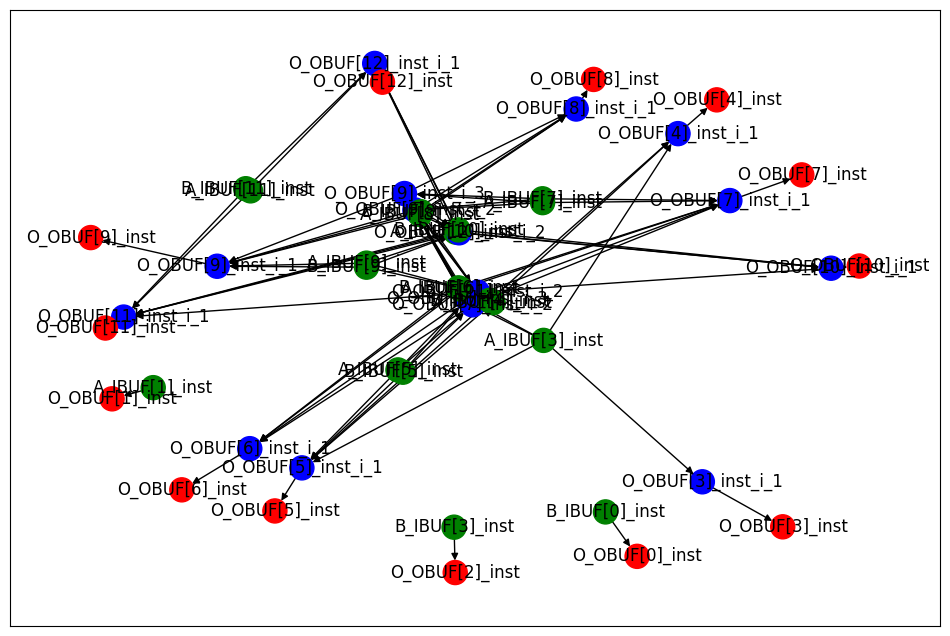

Archivo CSV generado: data/raw/add8u_8FD_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

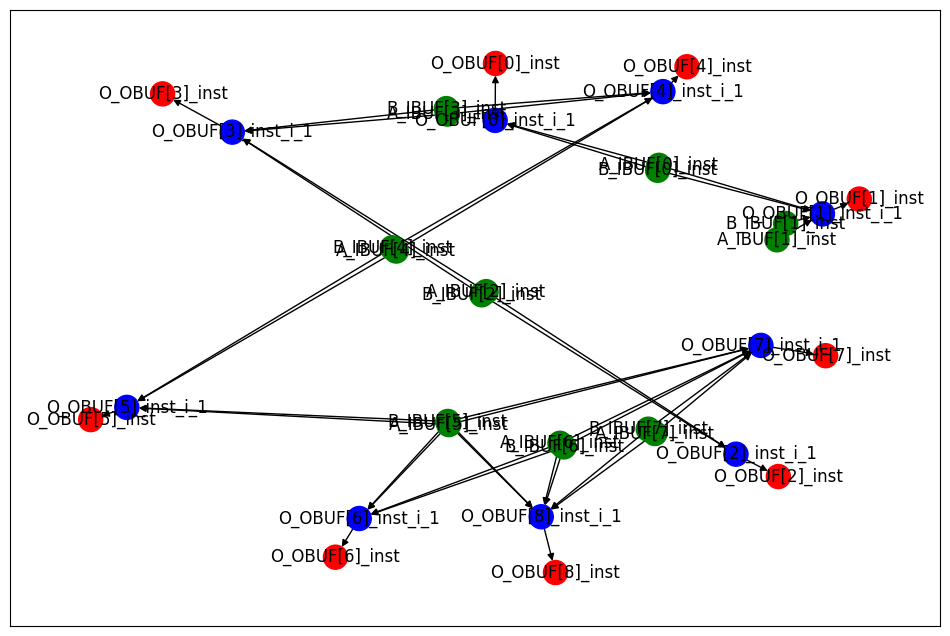

Archivo CSV generado: data/raw/add8se_7N1_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND44', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['

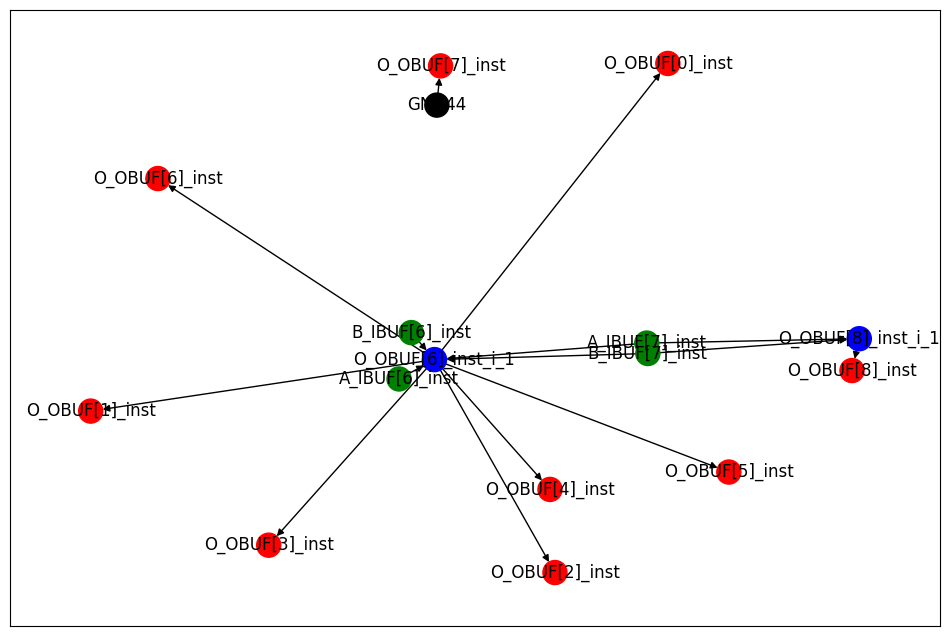

Archivo CSV generado: data/raw/add8u_5EZ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output':

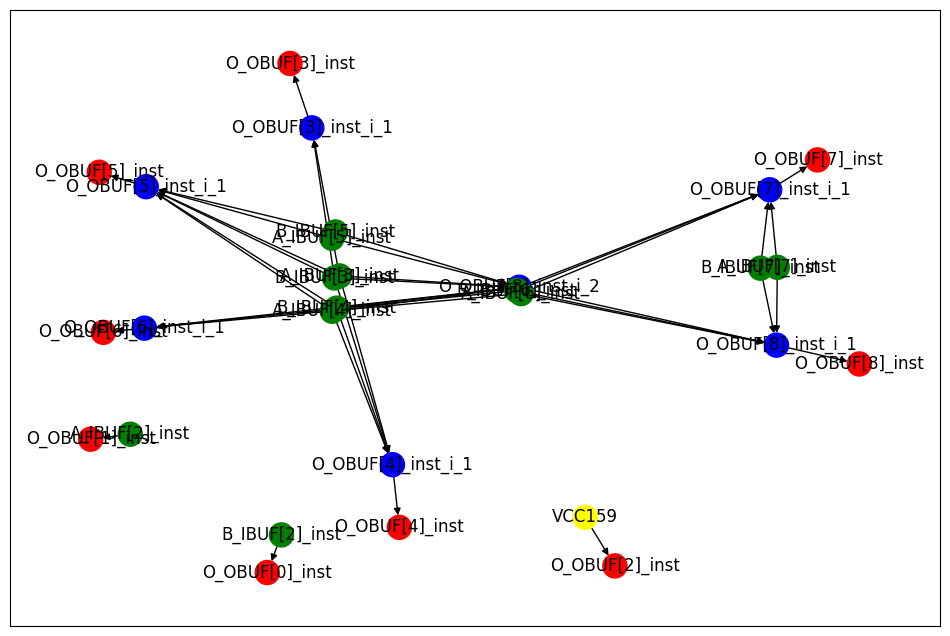

Archivo CSV generado: data/raw/add16se_2BY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[

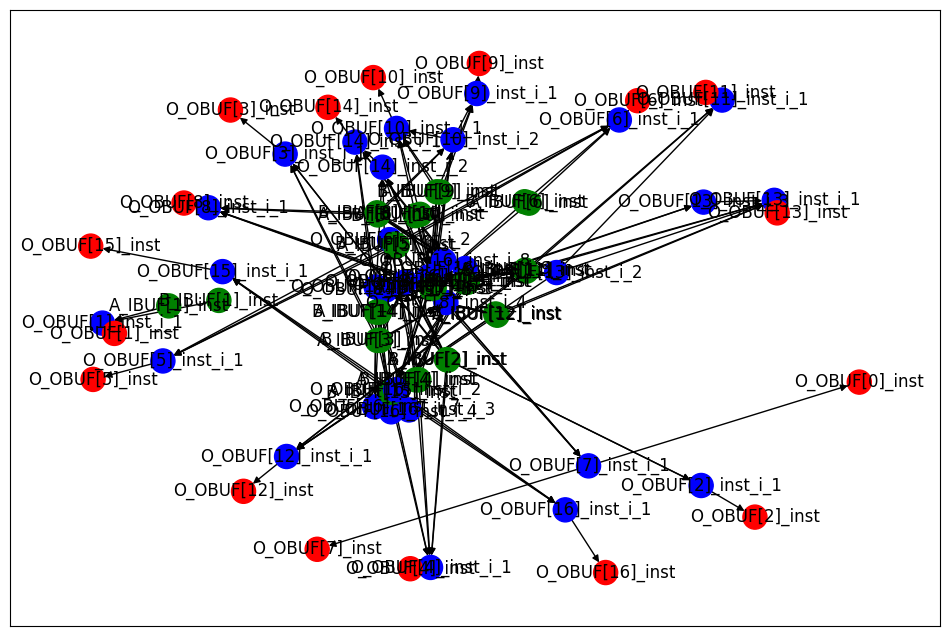

Archivo CSV generado: data/raw/add9se_077_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

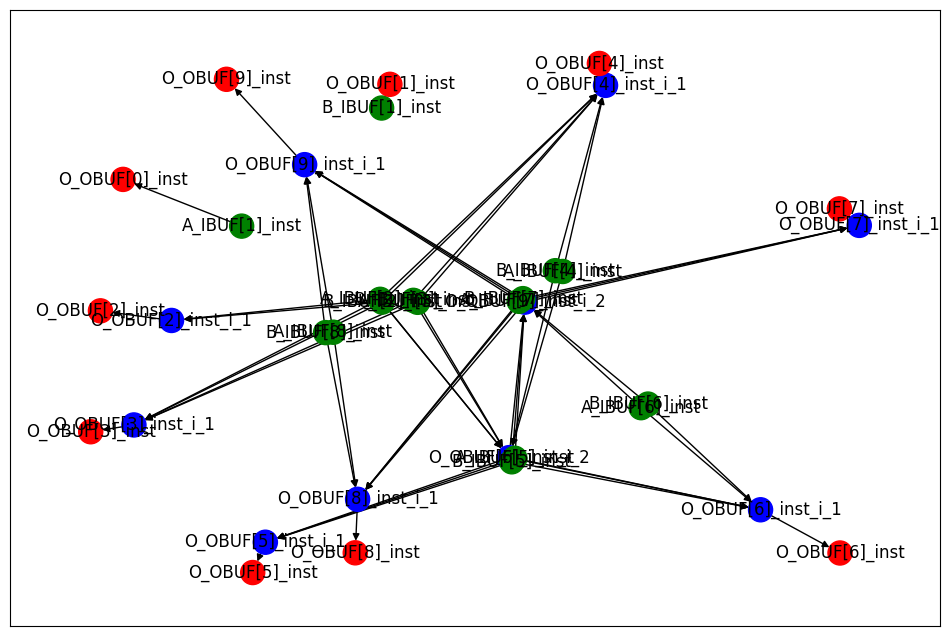

Archivo CSV generado: data/raw/add12u_1KC_netlist.csv
{'node_type': 'LUT', 'node_name': 'YC', 'node_input': ['B_IBUF[1]', 'B_IBUF[0]', 'A_IBUF'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'LUT', 'node_name': 'YS', 'node_input': ['B_IBUF[1]', 'A_IBUF', 'B_IBUF[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node

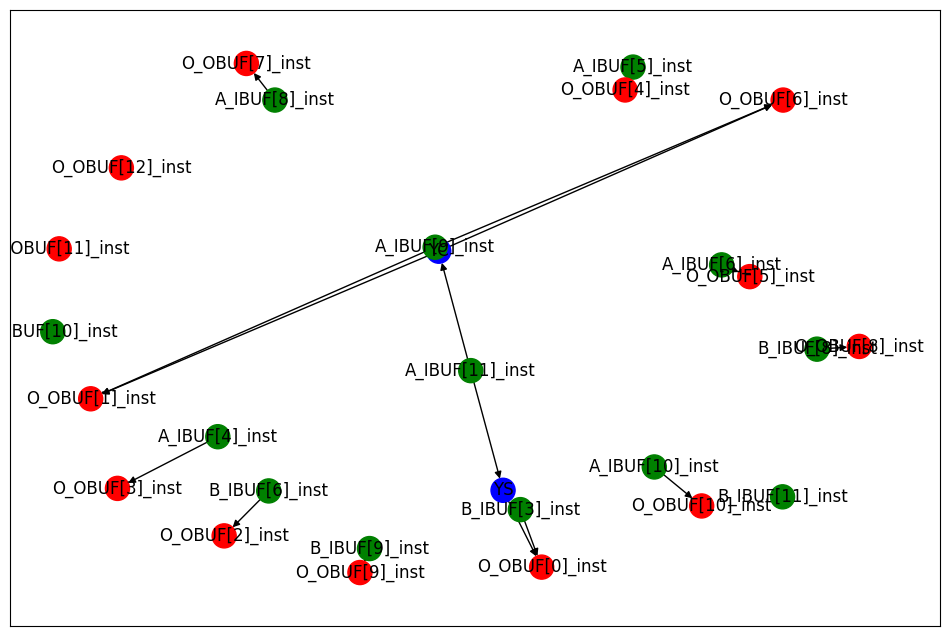

Archivo CSV generado: data/raw/add16se_28H_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[

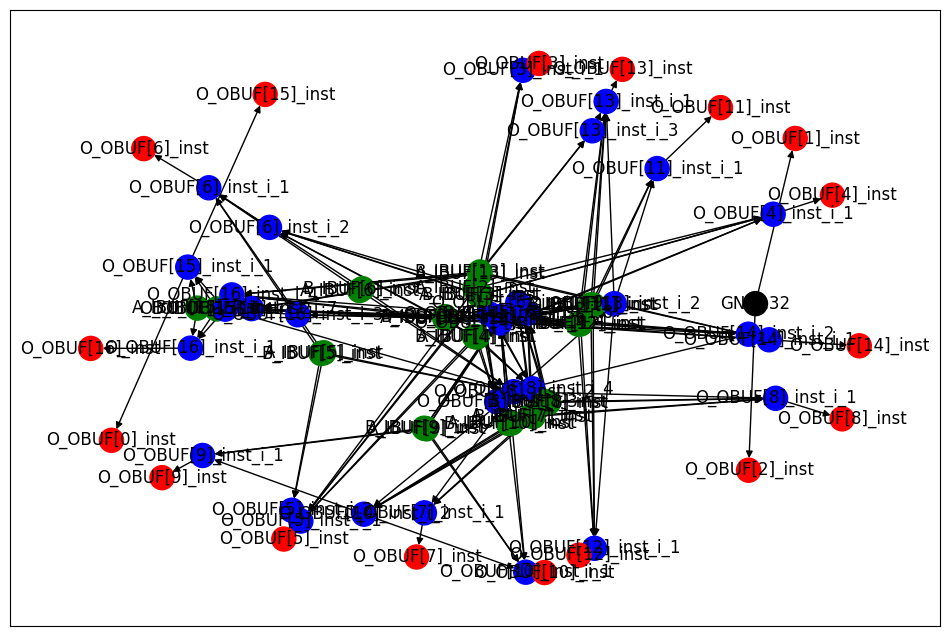

Archivo CSV generado: data/raw/add12se_58Y_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_

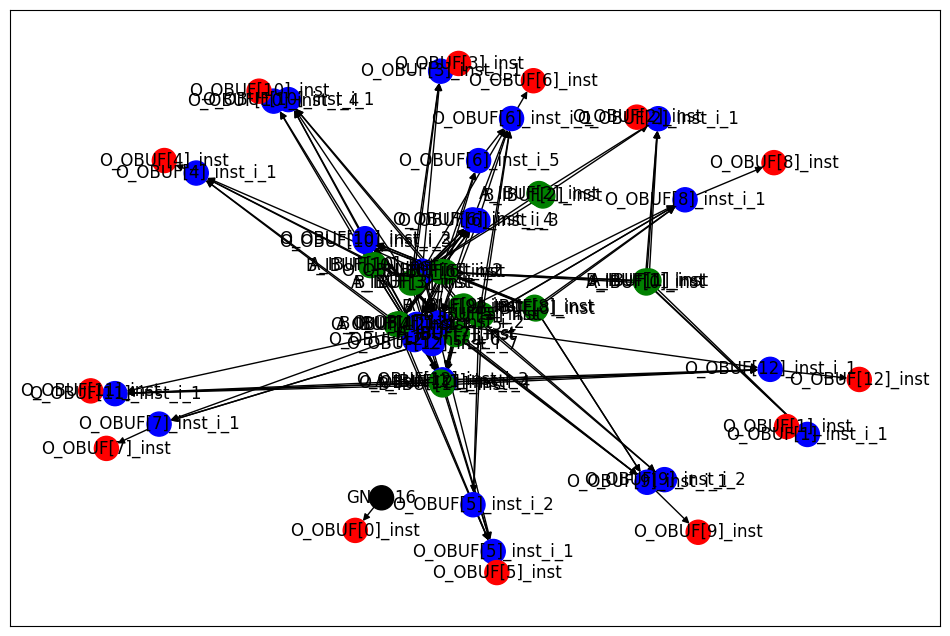

Archivo CSV generado: data/raw/add8u_0H4_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output':

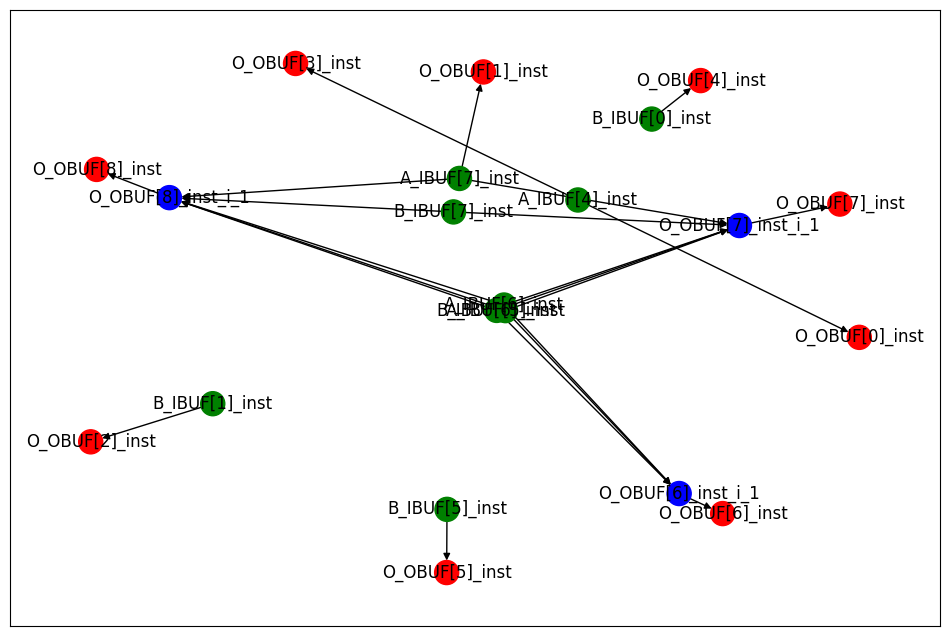

Archivo CSV generado: data/raw/add12u_20A_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_o

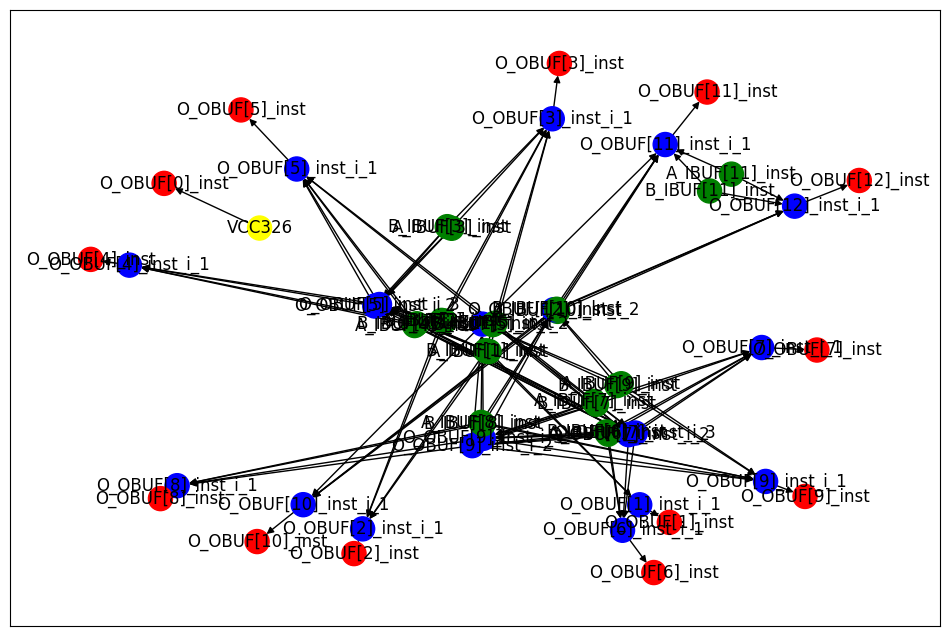

Archivo CSV generado: data/raw/add8s_70F_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND50', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['\\<const0> '], 'node_output': [

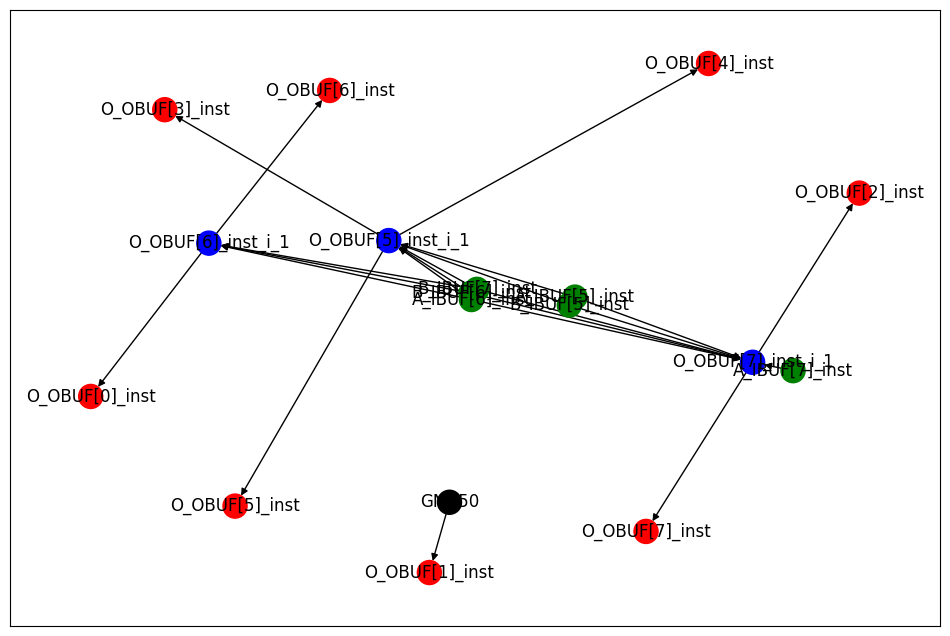

Archivo CSV generado: data/raw/add16se_25S_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[

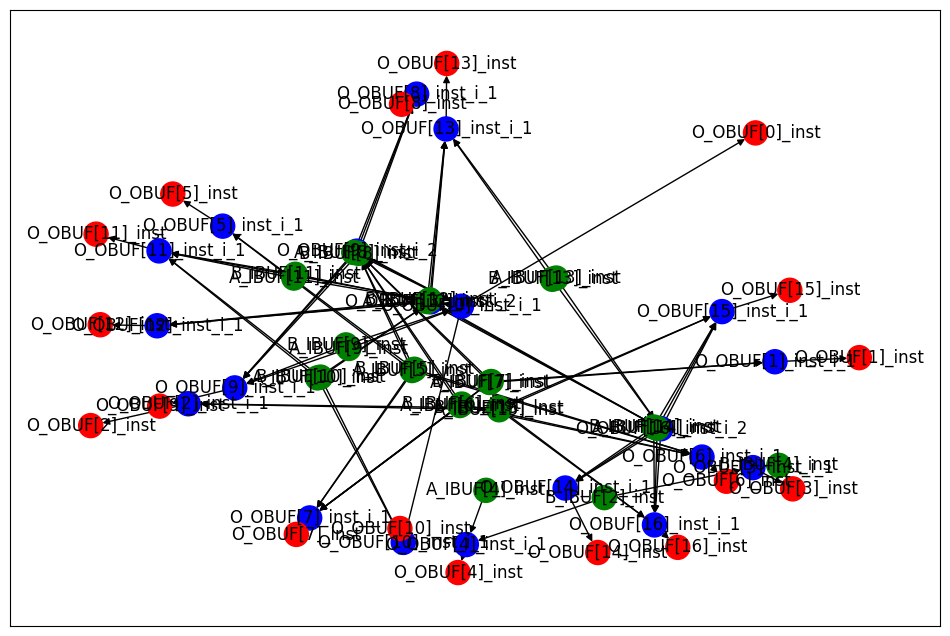

Archivo CSV generado: data/raw/add12se_5CX_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'nod

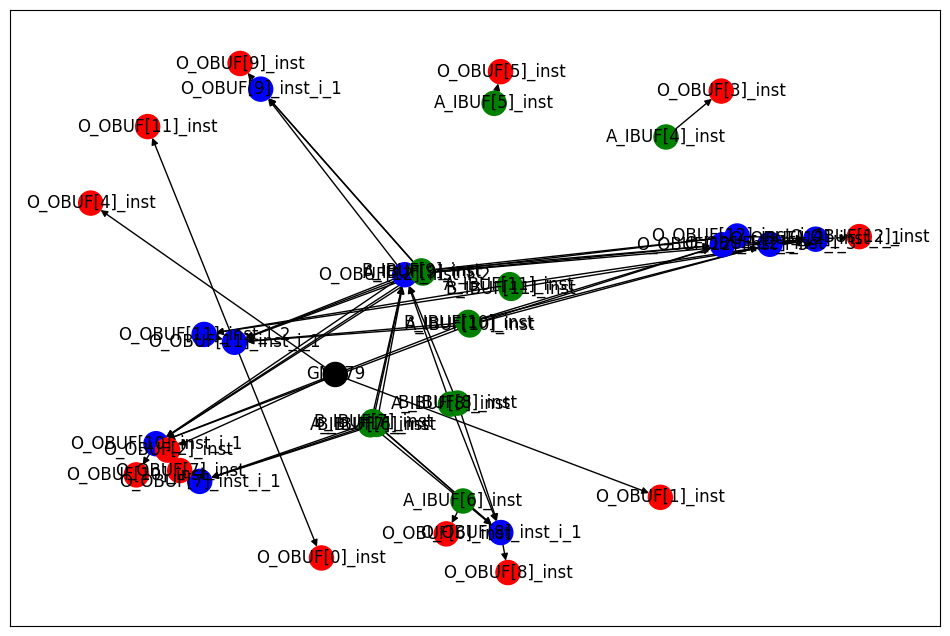

Archivo CSV generado: data/raw/add8se_8XS_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'GND', 'node_name': 'GND48', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const0> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': 

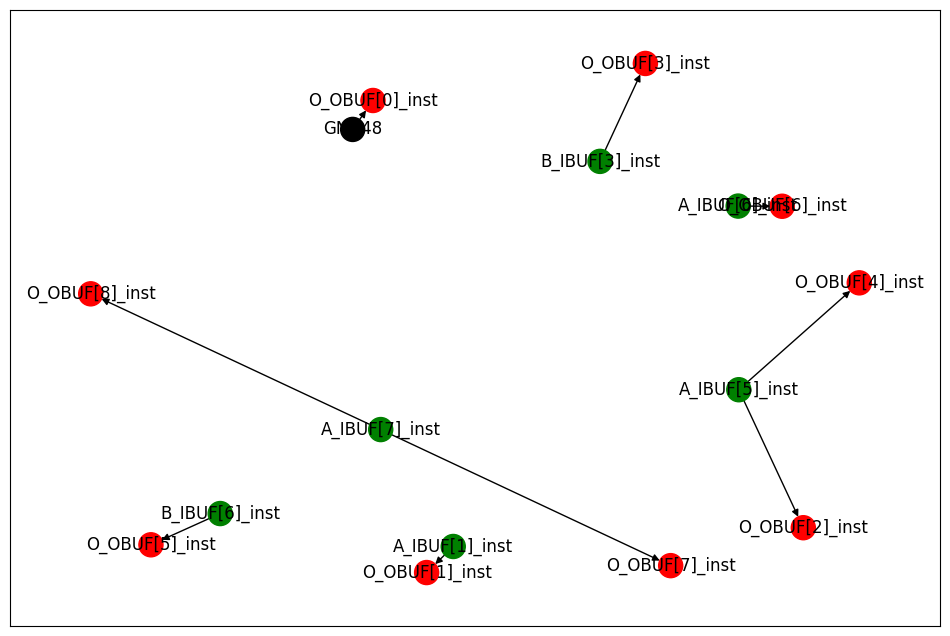

Archivo CSV generado: data/raw/add9se_0A8_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

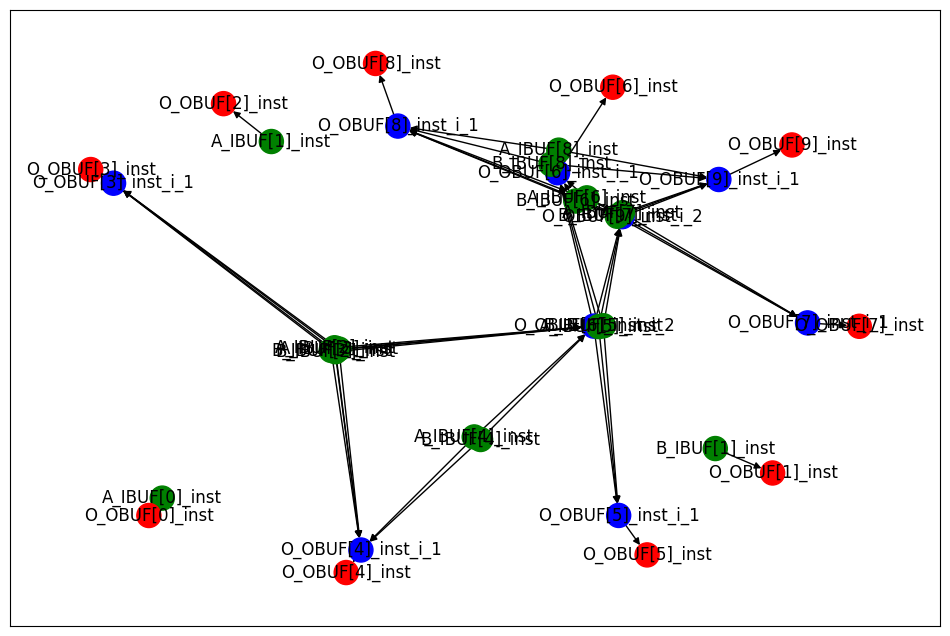

Archivo CSV generado: data/raw/add16u_1DM_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

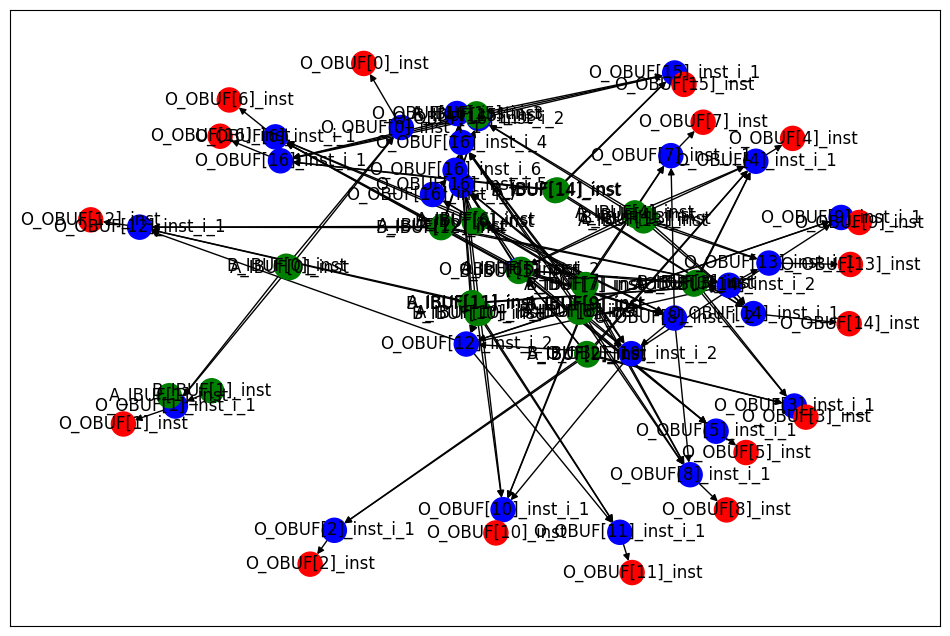

Archivo CSV generado: data/raw/add9se_063_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

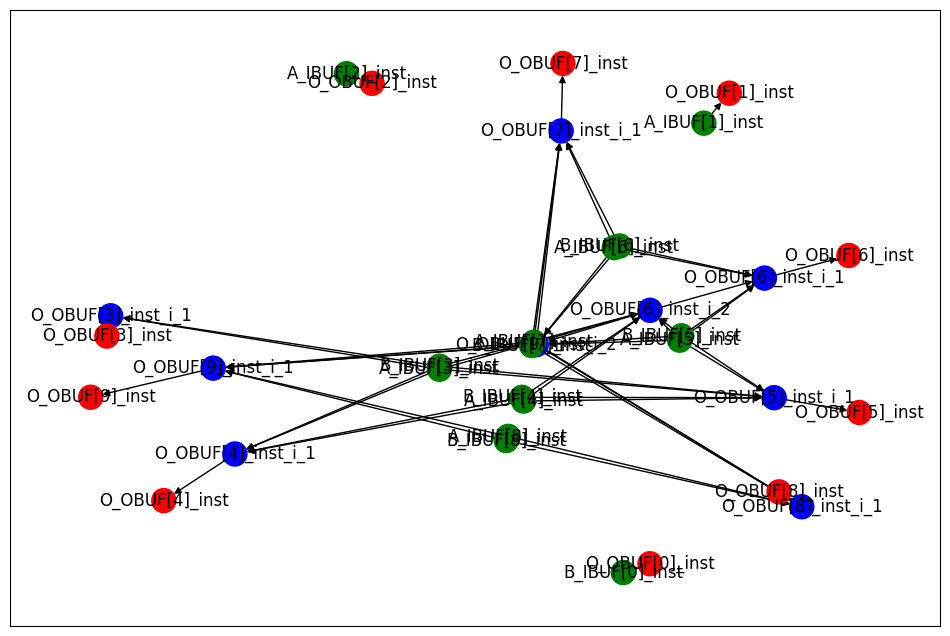

Archivo CSV generado: data/raw/add12se_59E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

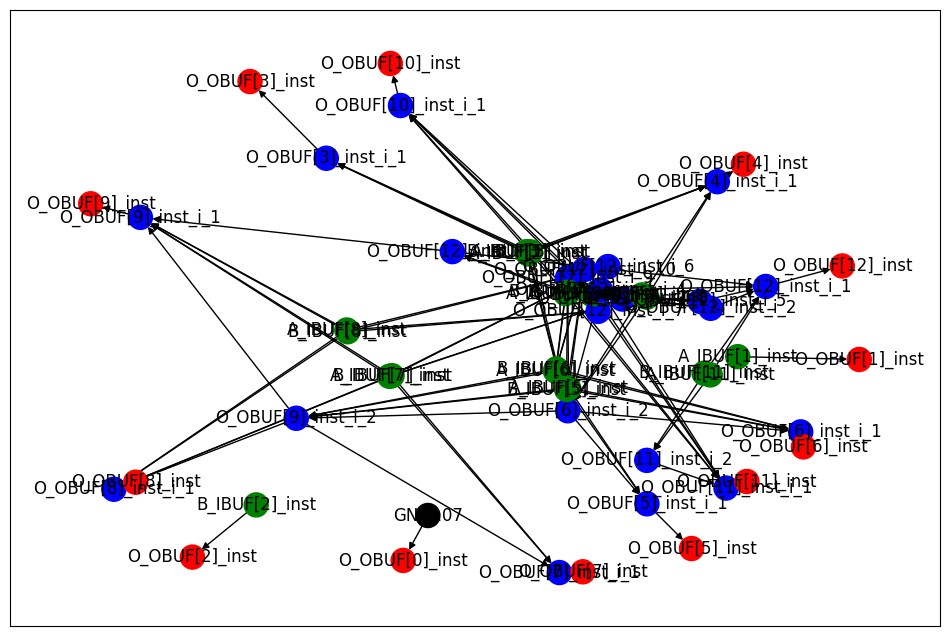

Archivo CSV generado: data/raw/add12u_1SA_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_o

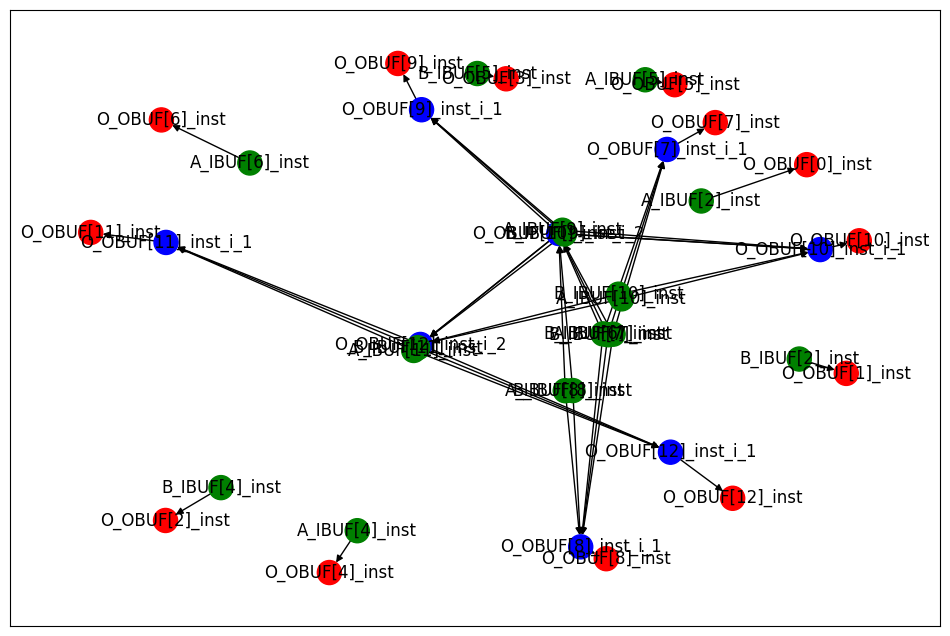

Archivo CSV generado: data/raw/add16u_1X9_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2

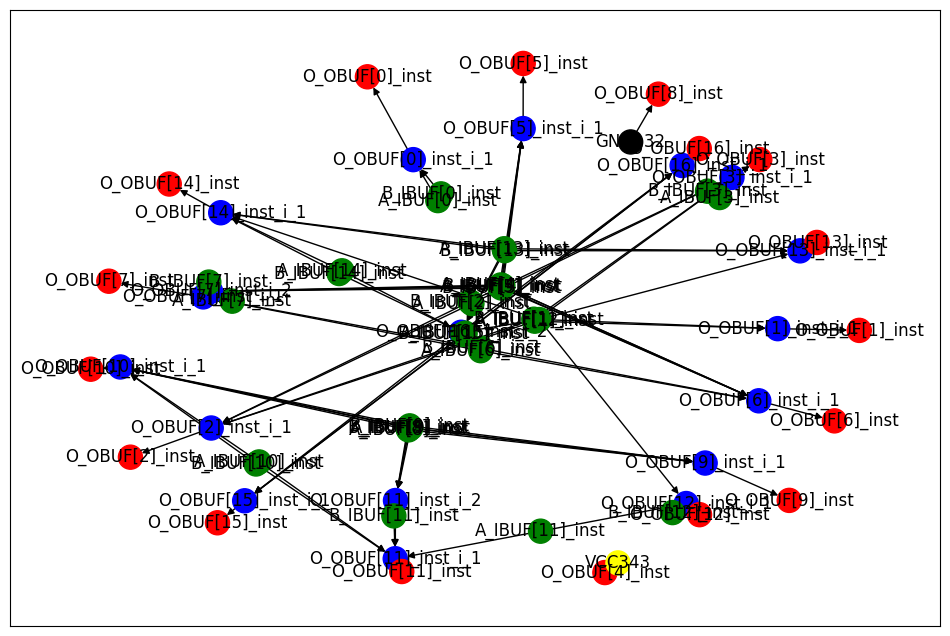

Archivo CSV generado: data/raw/add12se_5BQ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_

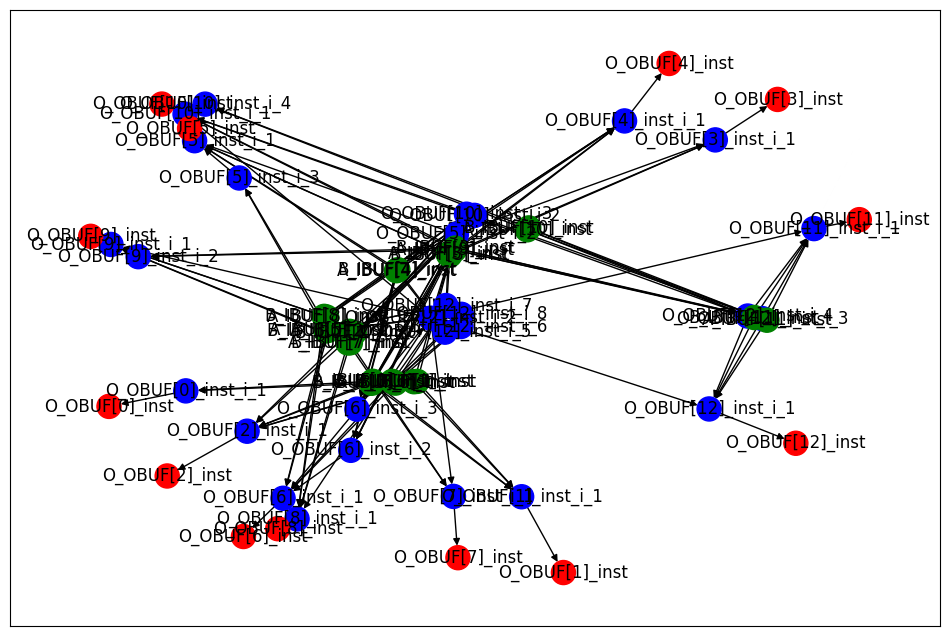

Archivo CSV generado: data/raw/add16u_0QG_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[12]_inst', 'node_input': ['B[12]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[13]_inst', 'node_input': ['B[1

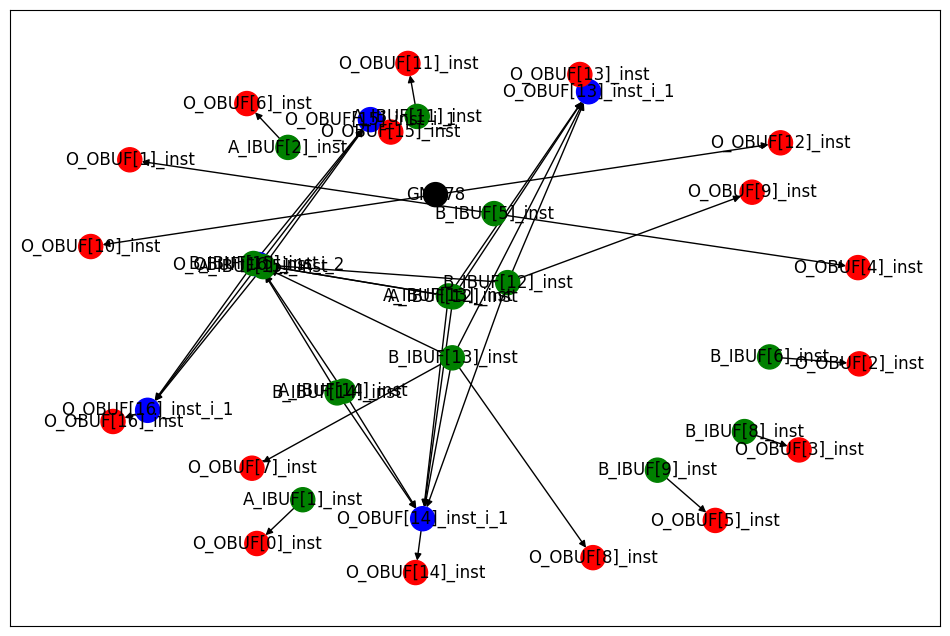

Archivo CSV generado: data/raw/add8se_91Y_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output'

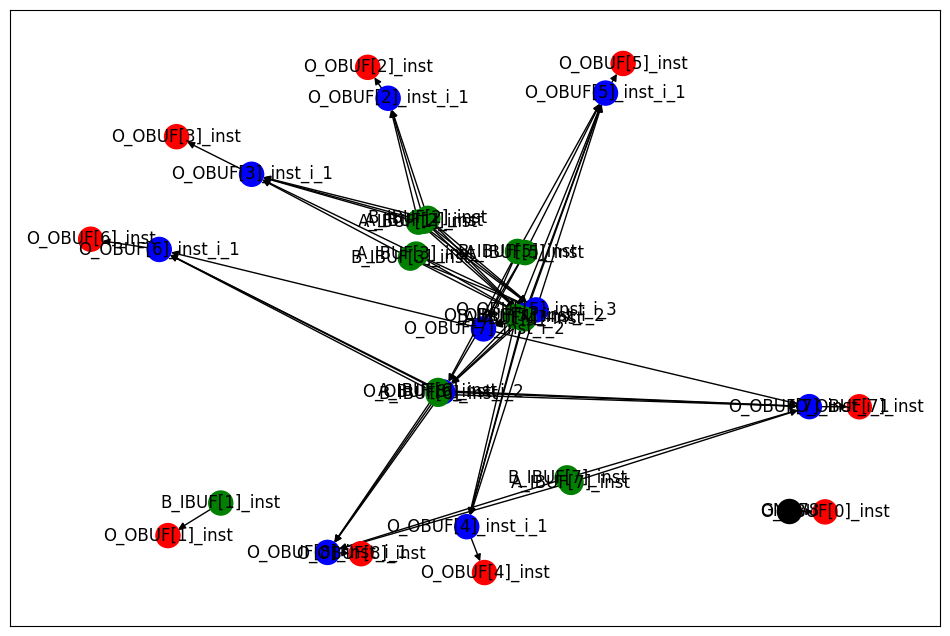

Archivo CSV generado: data/raw/add16u_0M6_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[

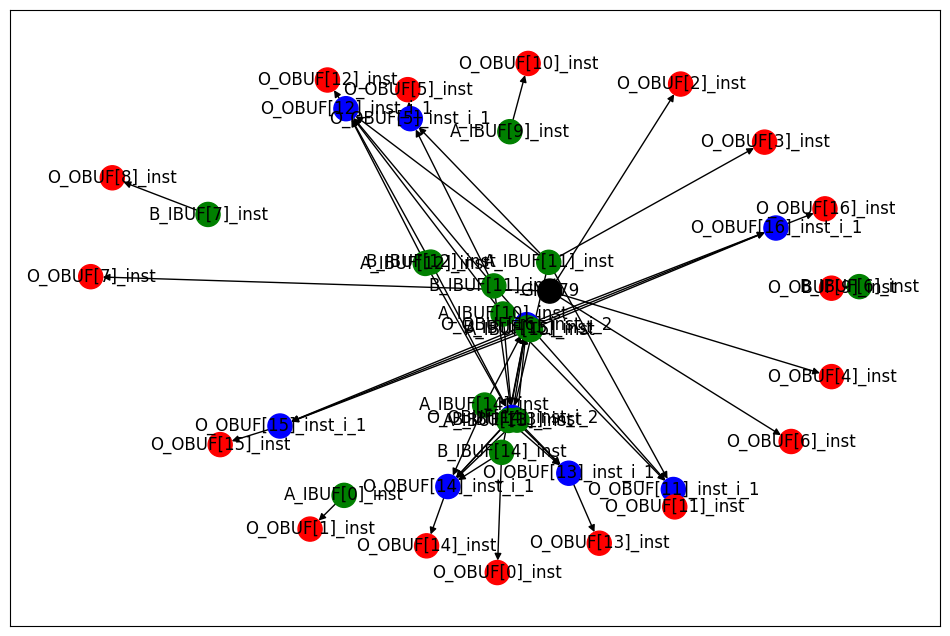

Archivo CSV generado: data/raw/add9se_07J_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output'

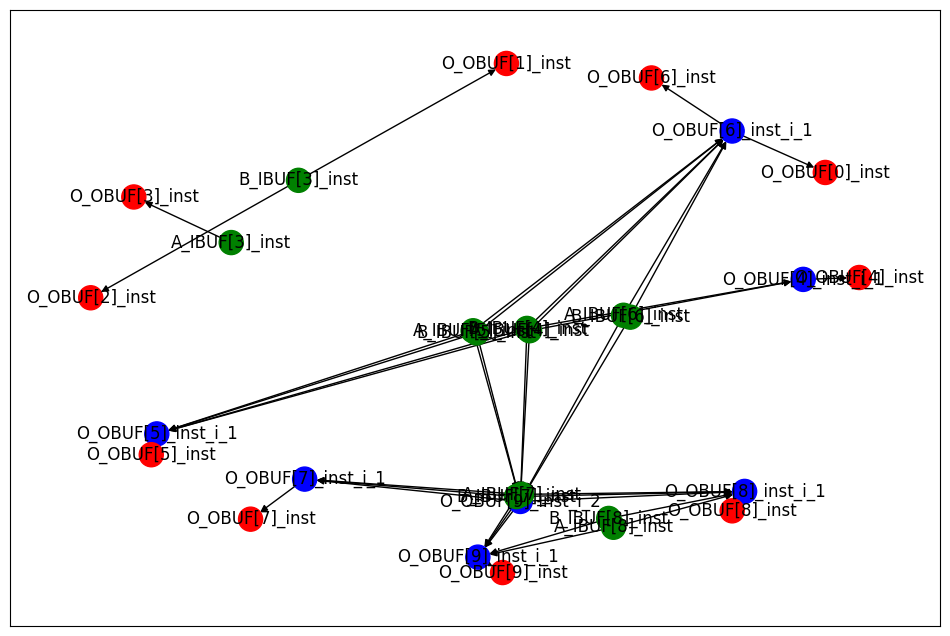

Archivo CSV generado: data/raw/add12u_32E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_o

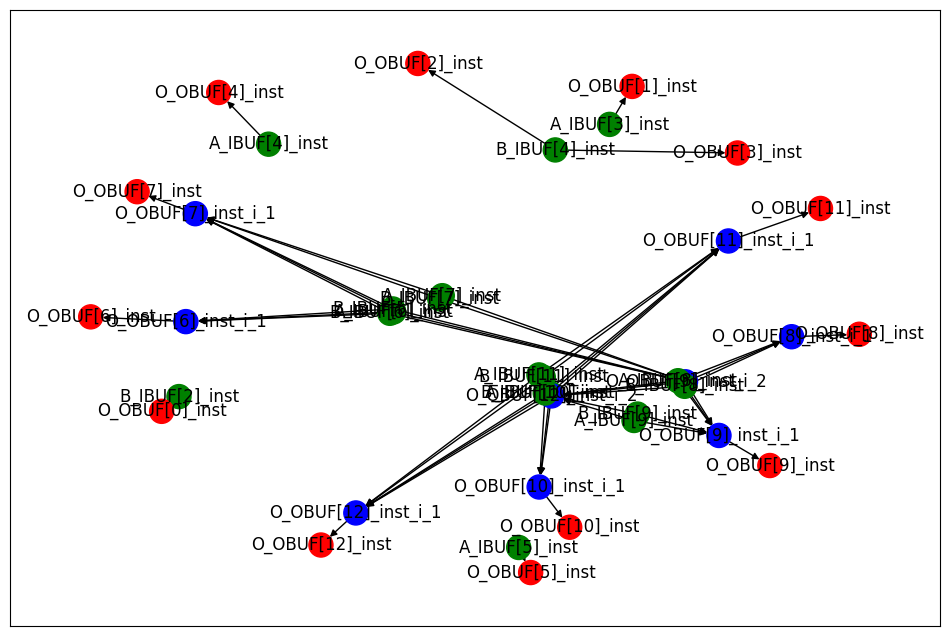

Archivo CSV generado: data/raw/add8u_5QL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

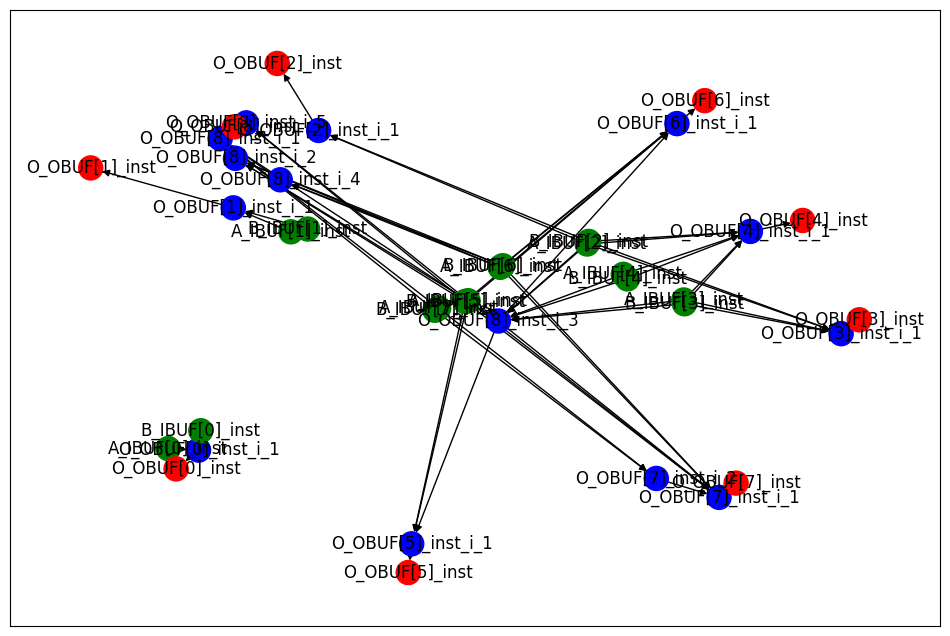

Archivo CSV generado: data/raw/add16se_2JB_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[

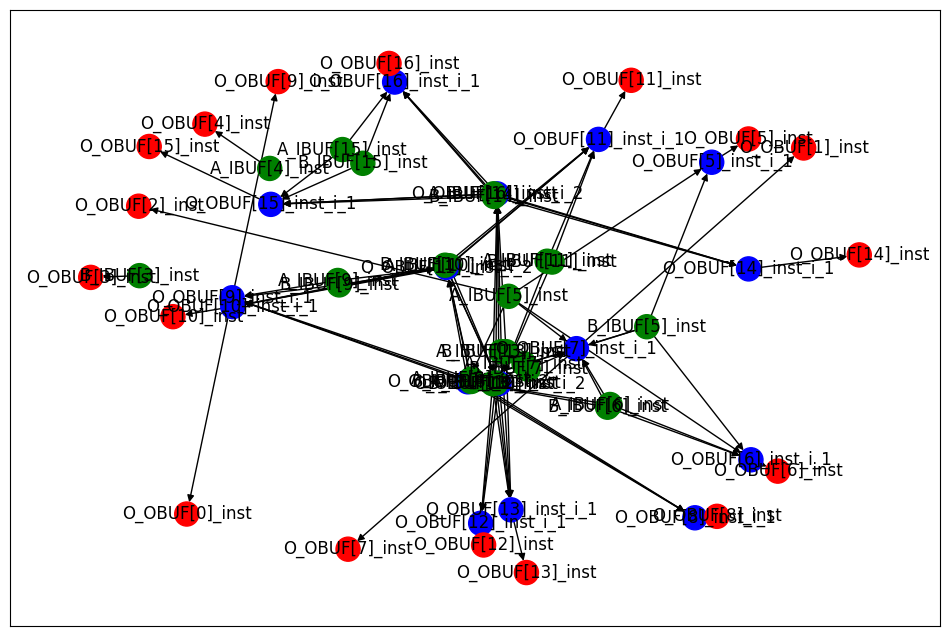

Archivo CSV generado: data/raw/add8u_5SY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output':

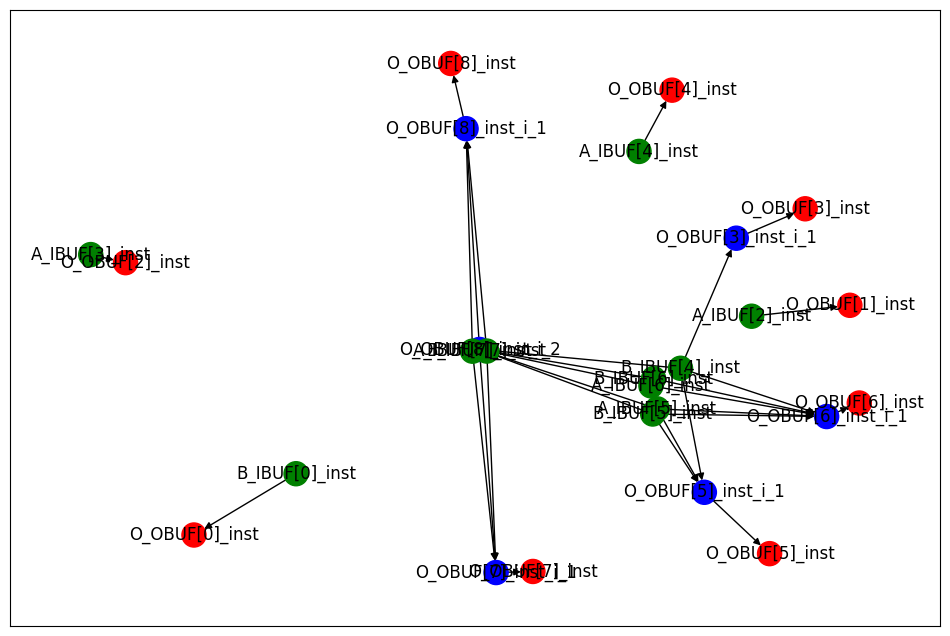

Archivo CSV generado: data/raw/add8u_4T8_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output':

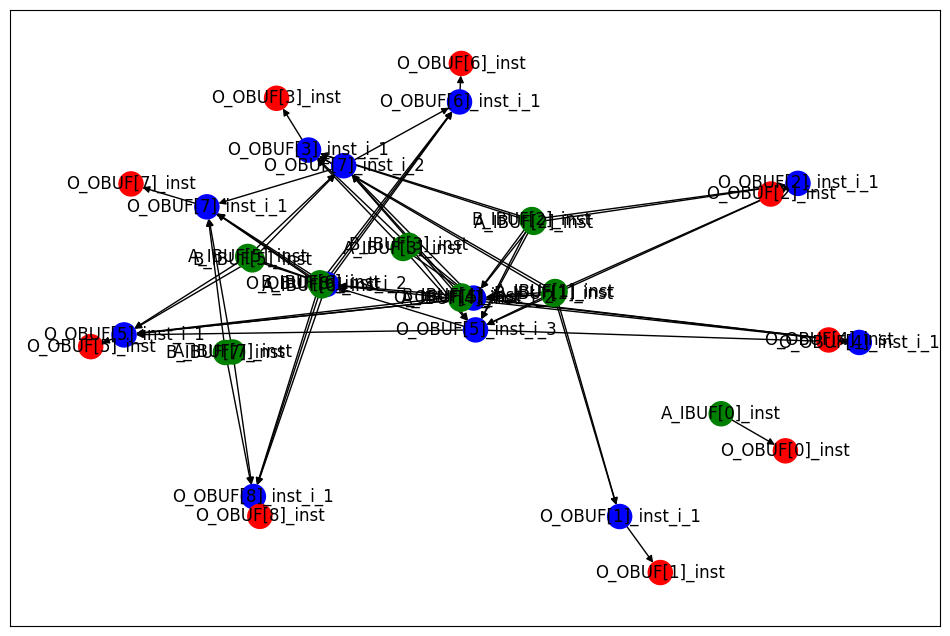

Archivo CSV generado: data/raw/add16u_0Q7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5

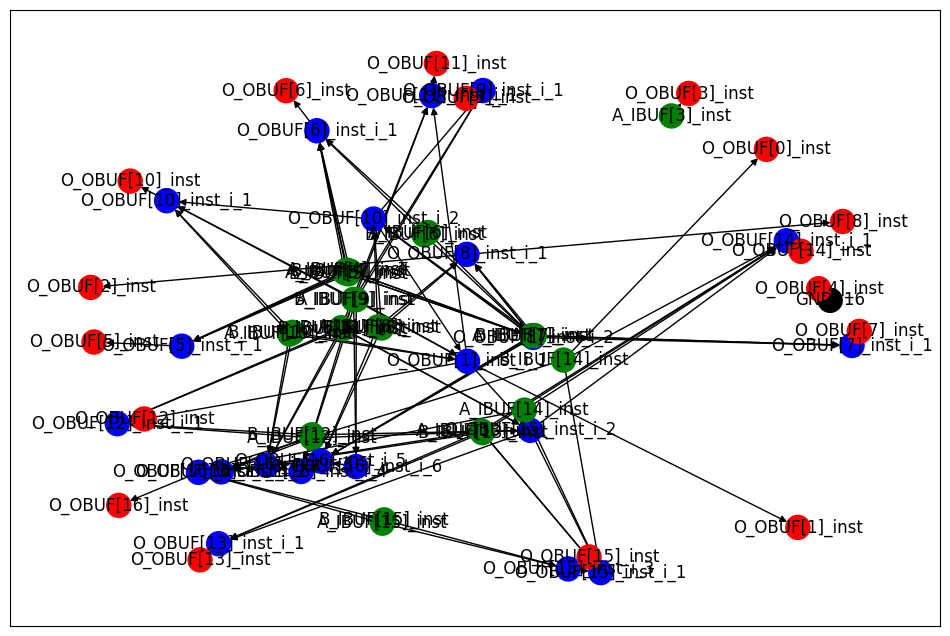

Archivo CSV generado: data/raw/add12u_08A_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_o

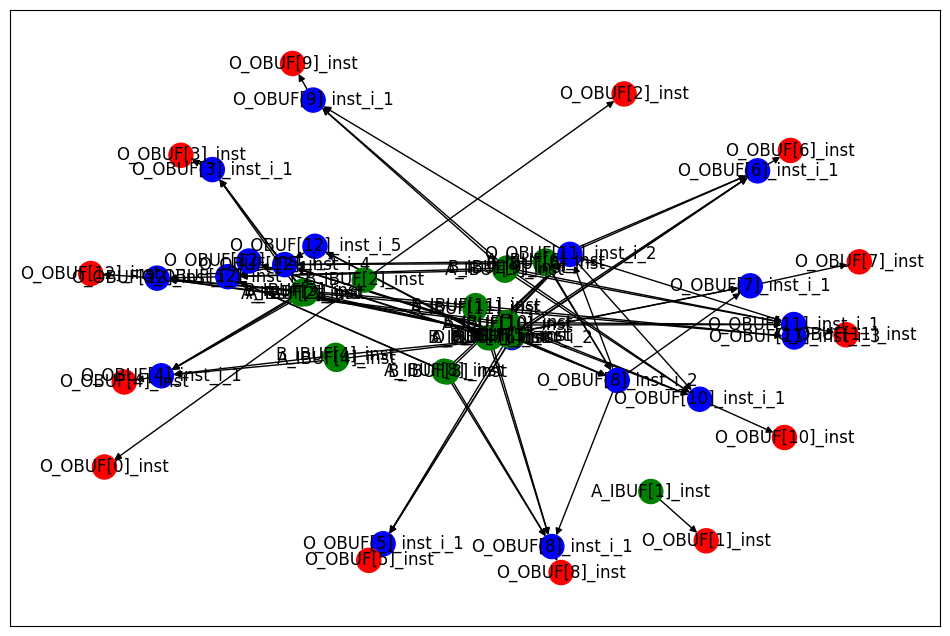

Archivo CSV generado: data/raw/add8s_6S5_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

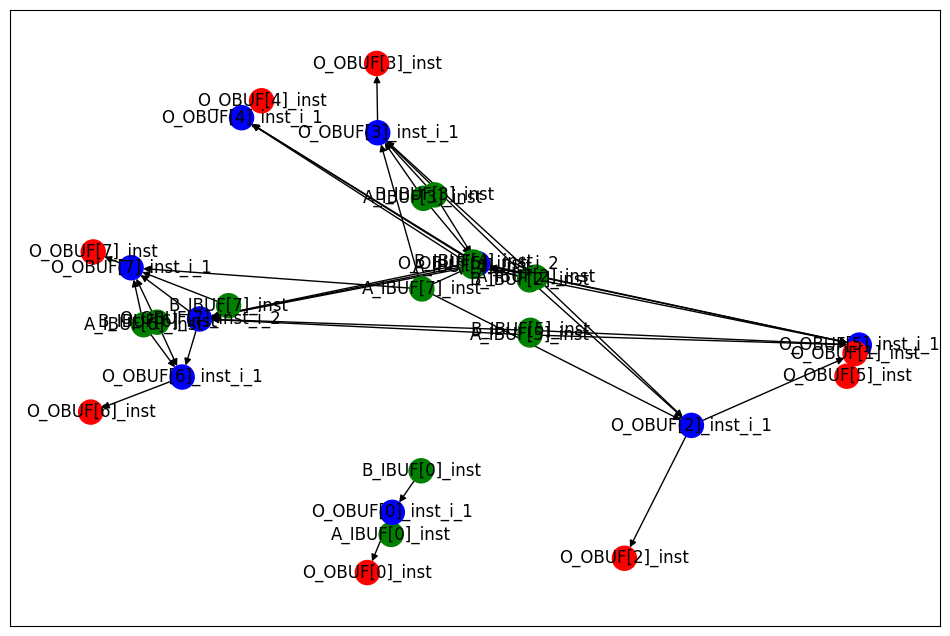

Archivo CSV generado: data/raw/add8s_6X9_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output':

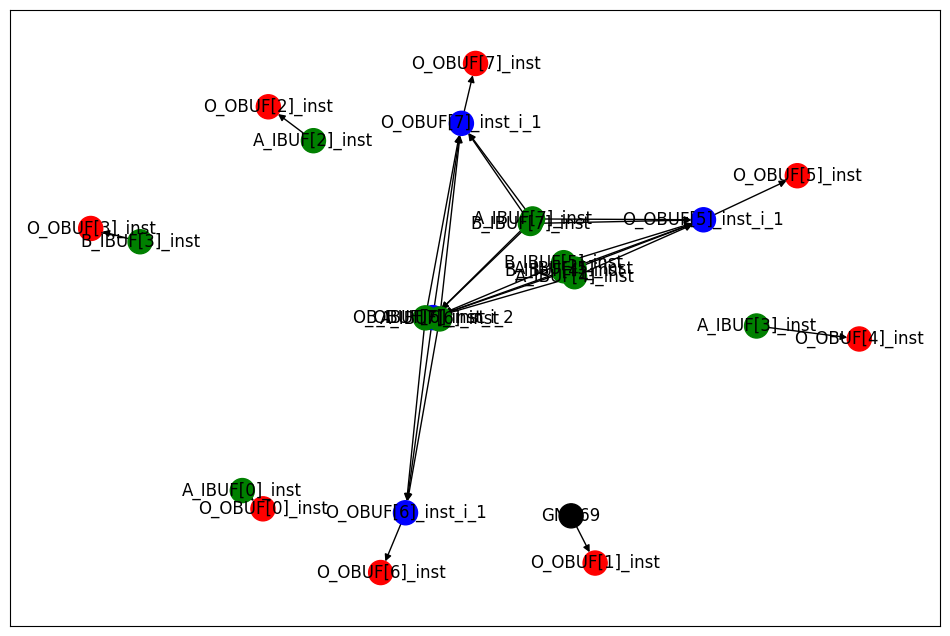

Archivo CSV generado: data/raw/add16u_09P_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8

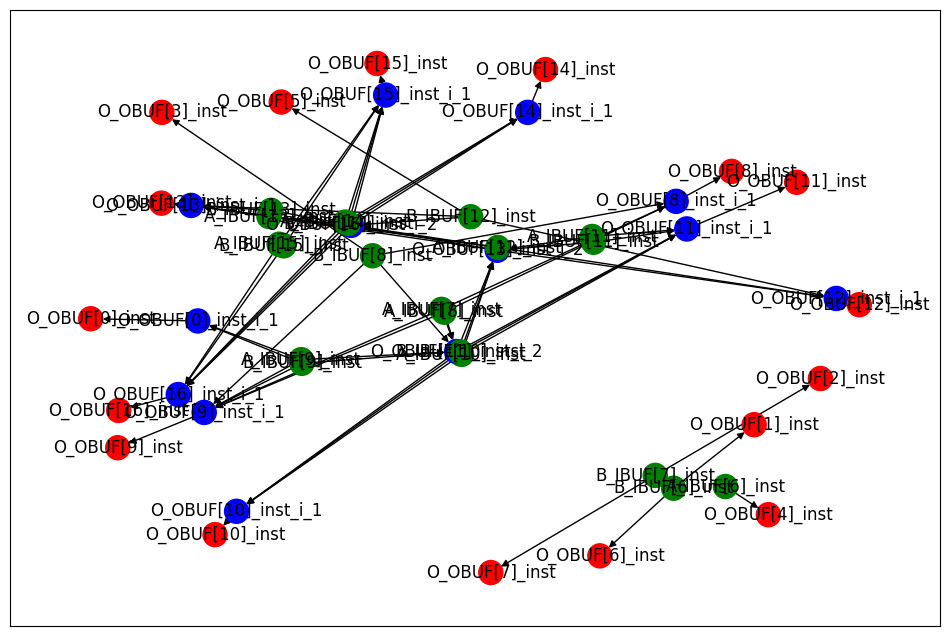

Archivo CSV generado: data/raw/add8u_5G5_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output':

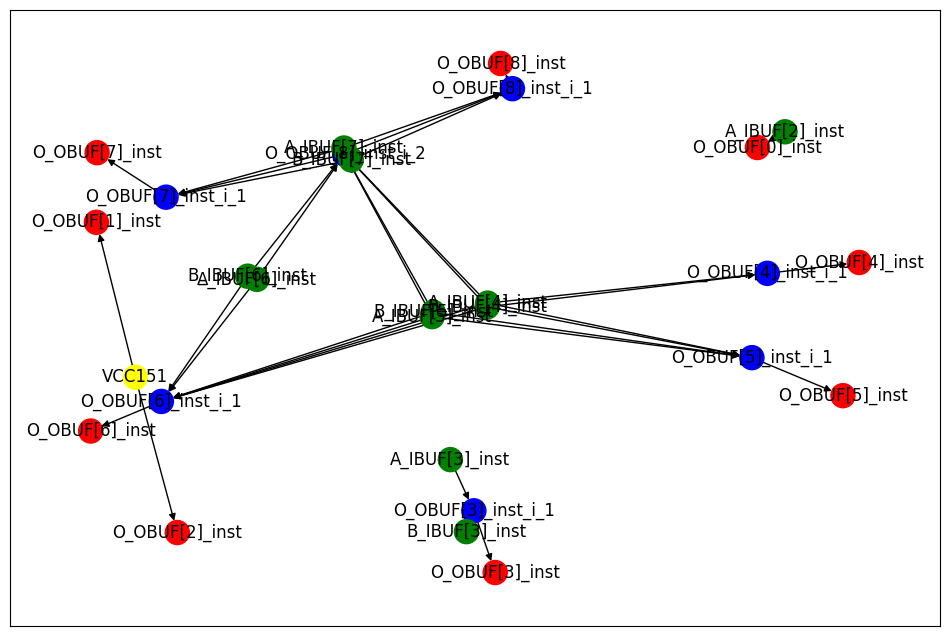

Archivo CSV generado: data/raw/add8se_8TX_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_ou

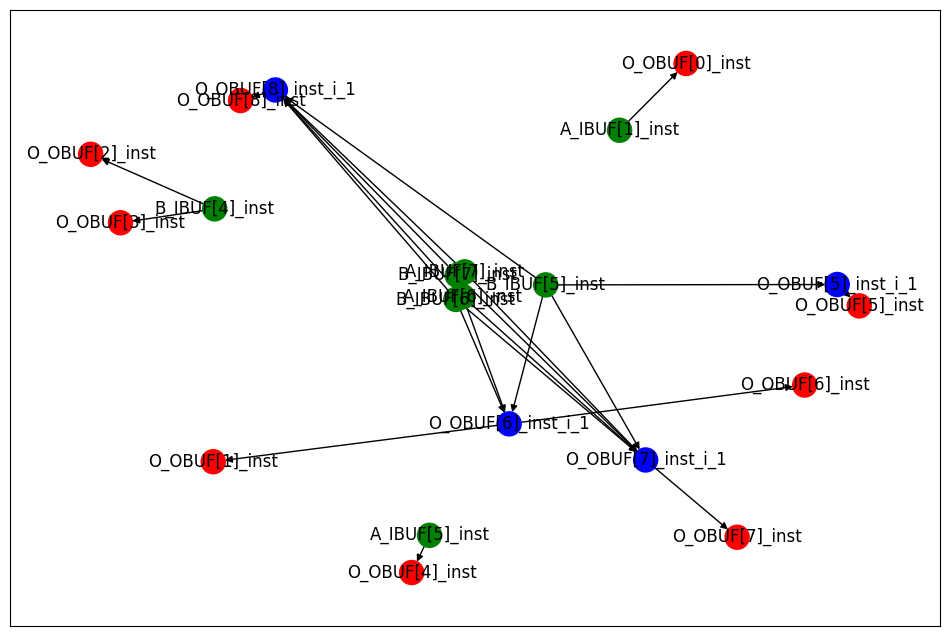

Archivo CSV generado: data/raw/add9se_0C1_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output'

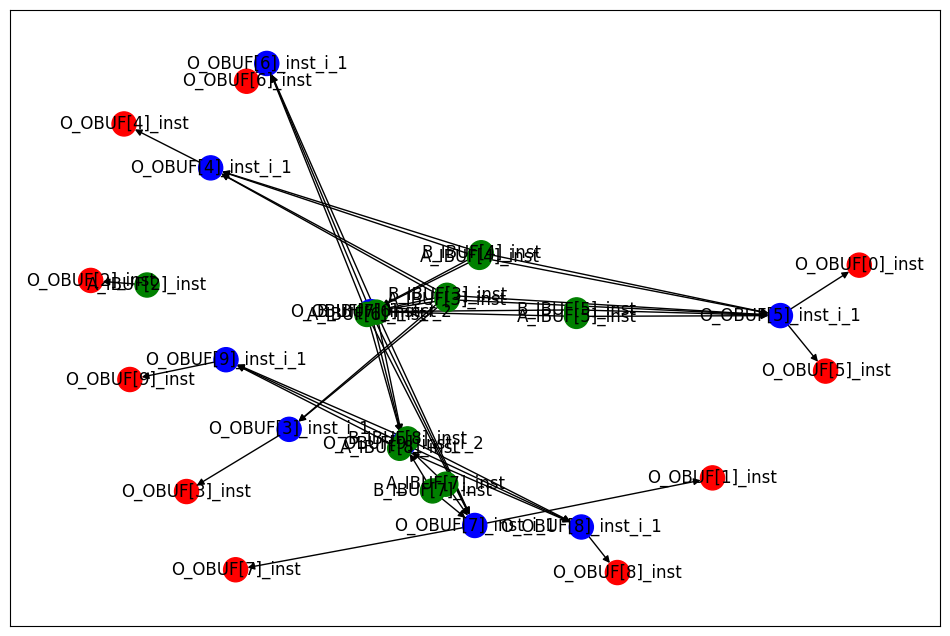

Archivo CSV generado: data/raw/add8s_70S_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND56', 'node_input': ['GND'], 'node_output': ['\\<const

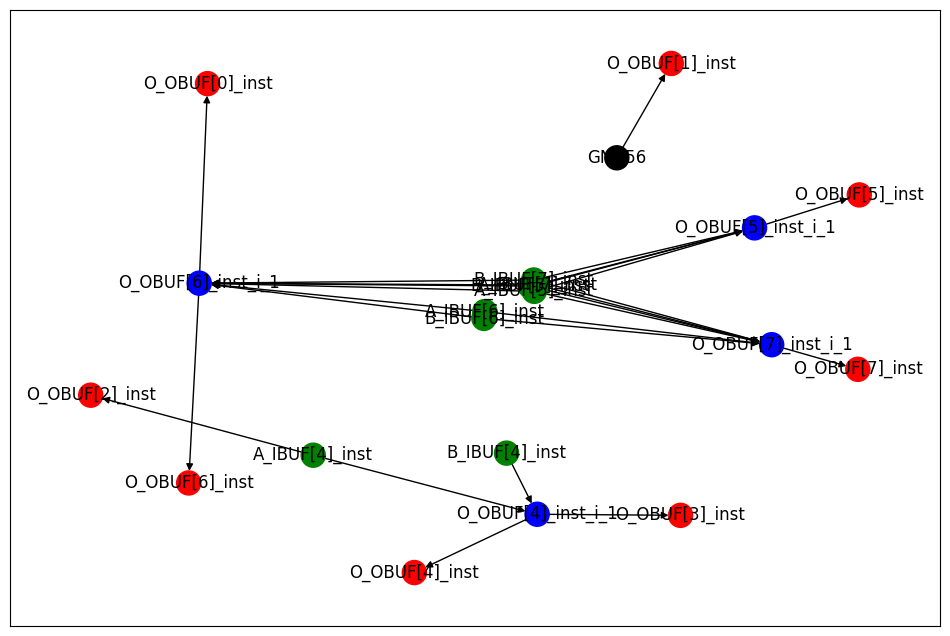

Archivo CSV generado: data/raw/add8s_6FR_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

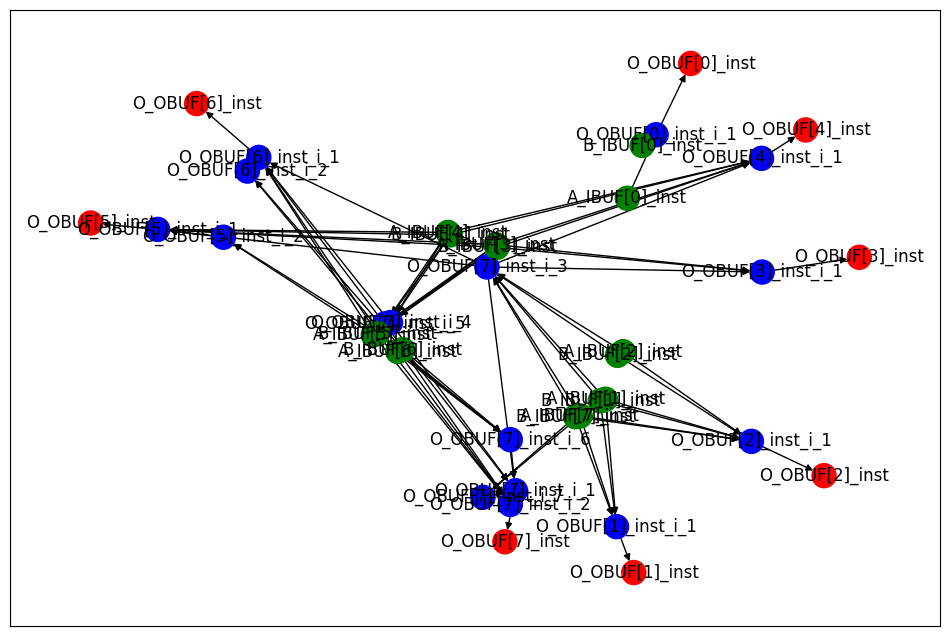

Archivo CSV generado: data/raw/add9se_014_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

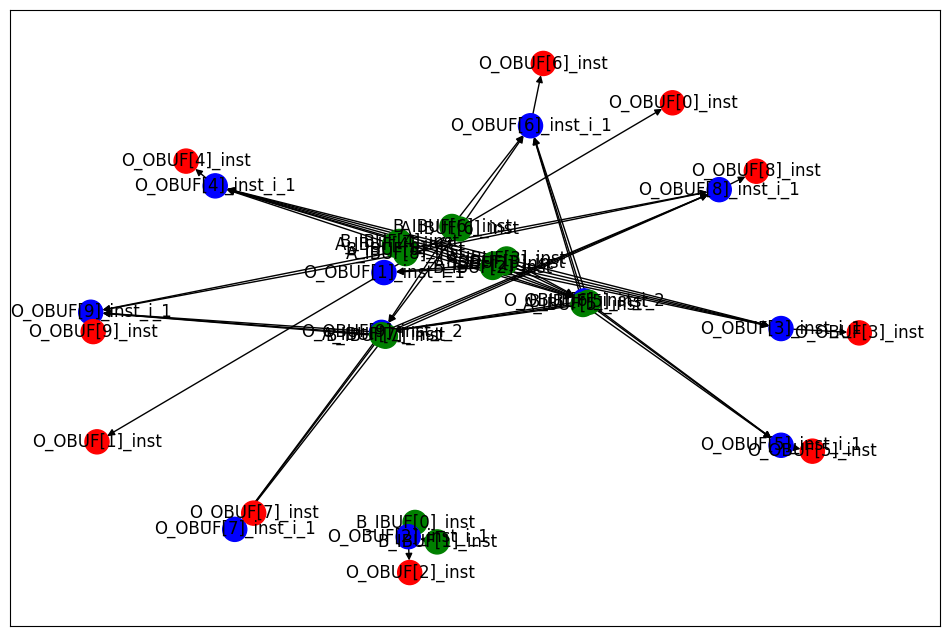

Archivo CSV generado: data/raw/add16u_0NK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4

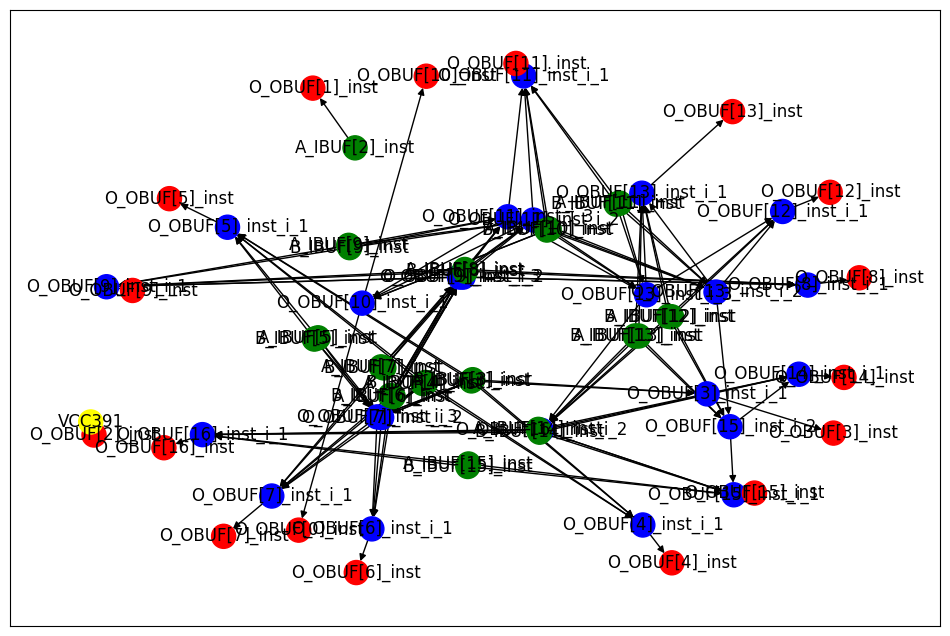

Archivo CSV generado: data/raw/add16se_294_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[

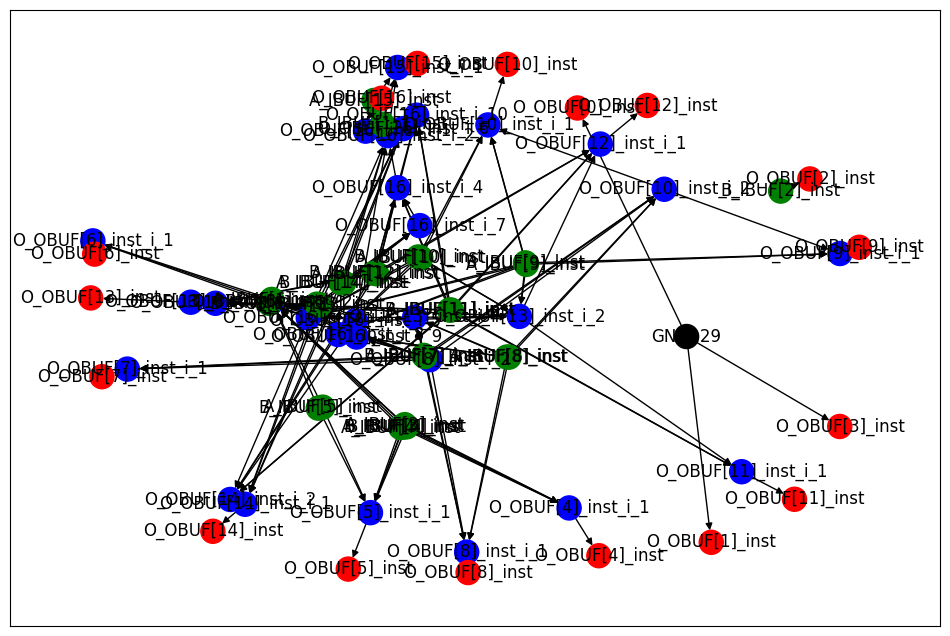

Archivo CSV generado: data/raw/add8s_6T8_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND50', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const0> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': [

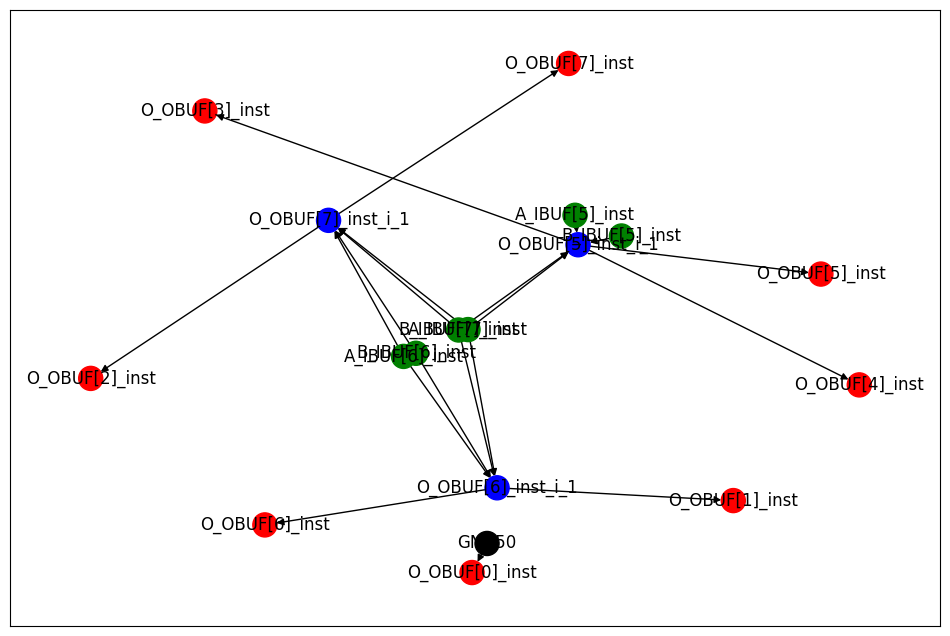

Archivo CSV generado: data/raw/add12u_0JF_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_o

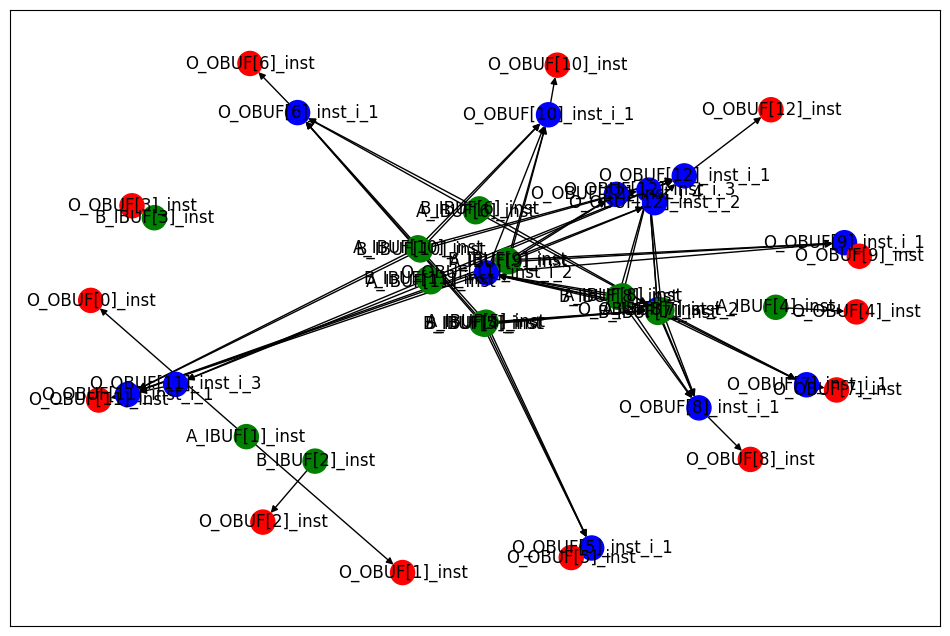

Archivo CSV generado: data/raw/add16se_2H0_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[

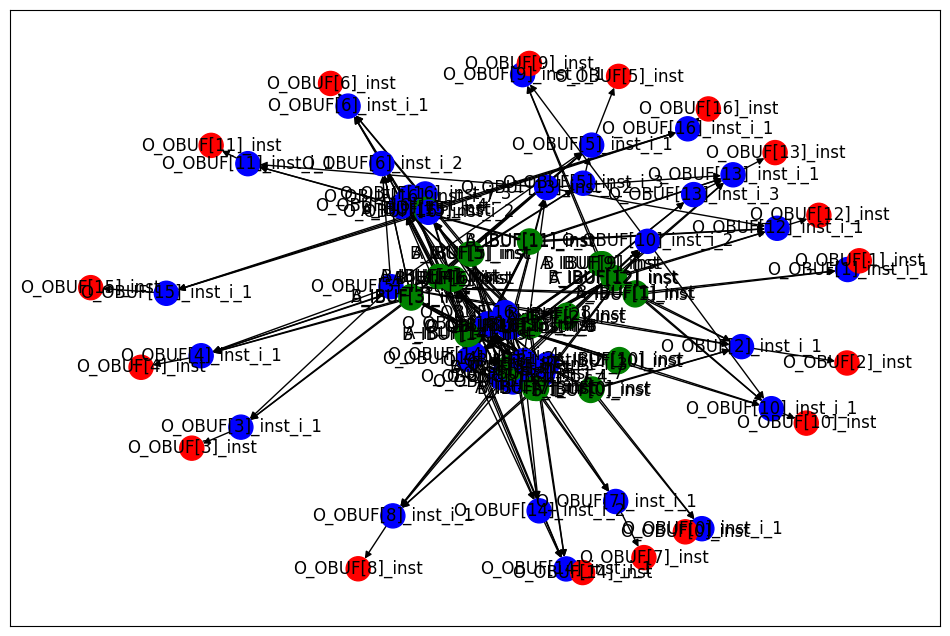

Archivo CSV generado: data/raw/add8se_91D_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output'

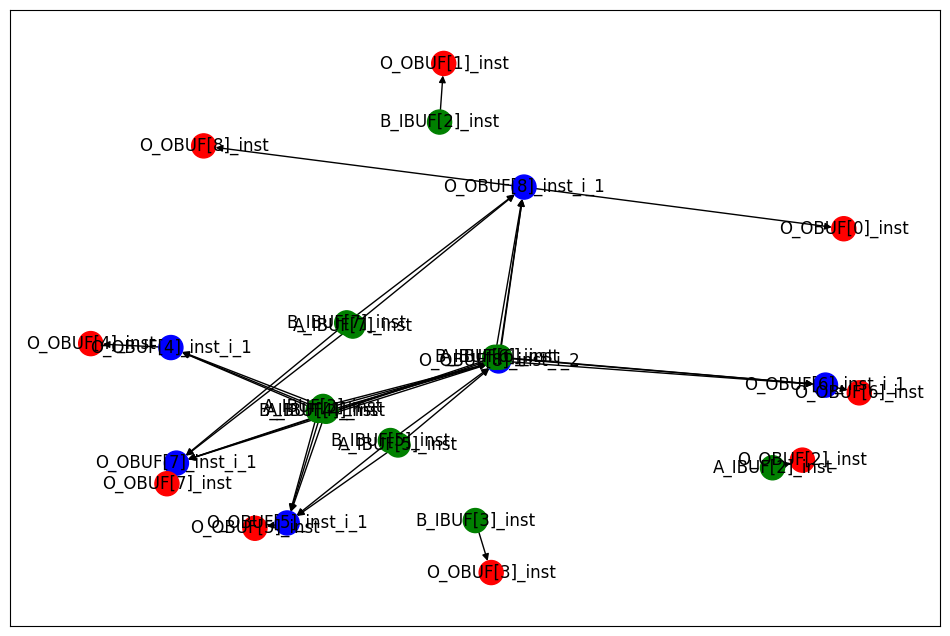

Archivo CSV generado: data/raw/add8se_76P_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output'

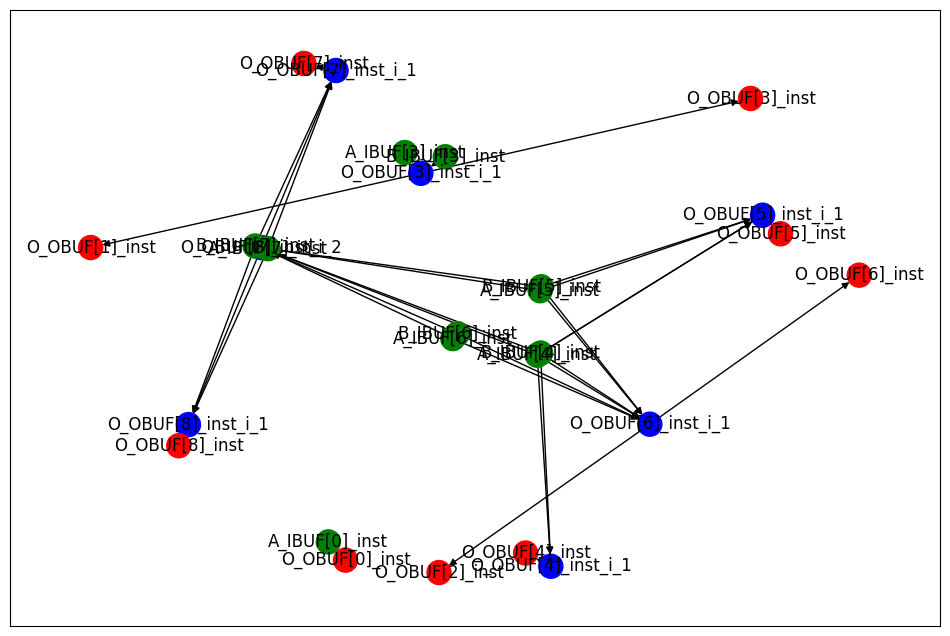

Archivo CSV generado: data/raw/add8u_0CA_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const1> '], 'node_outp

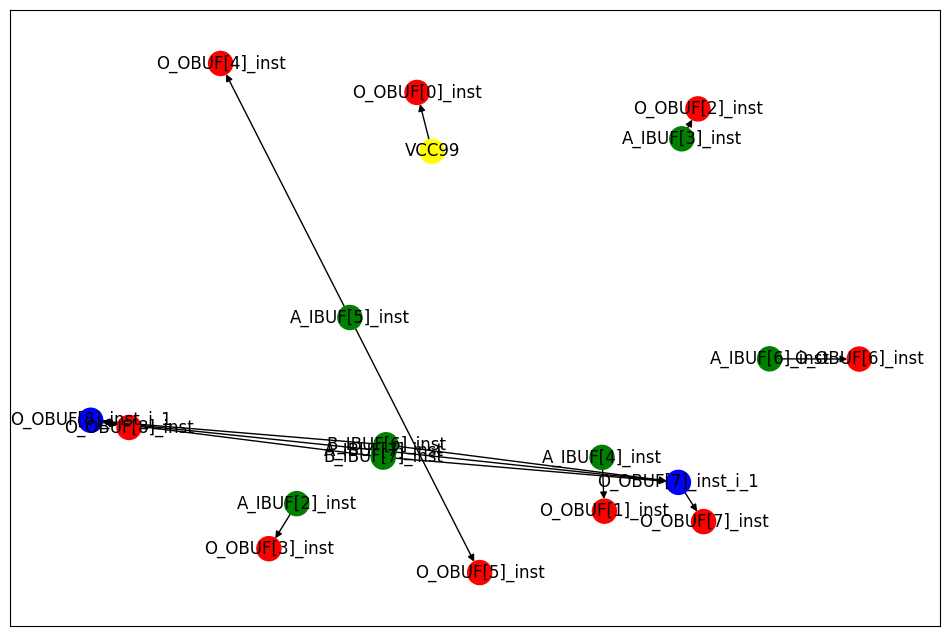

Archivo CSV generado: data/raw/add16u_1JH_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5

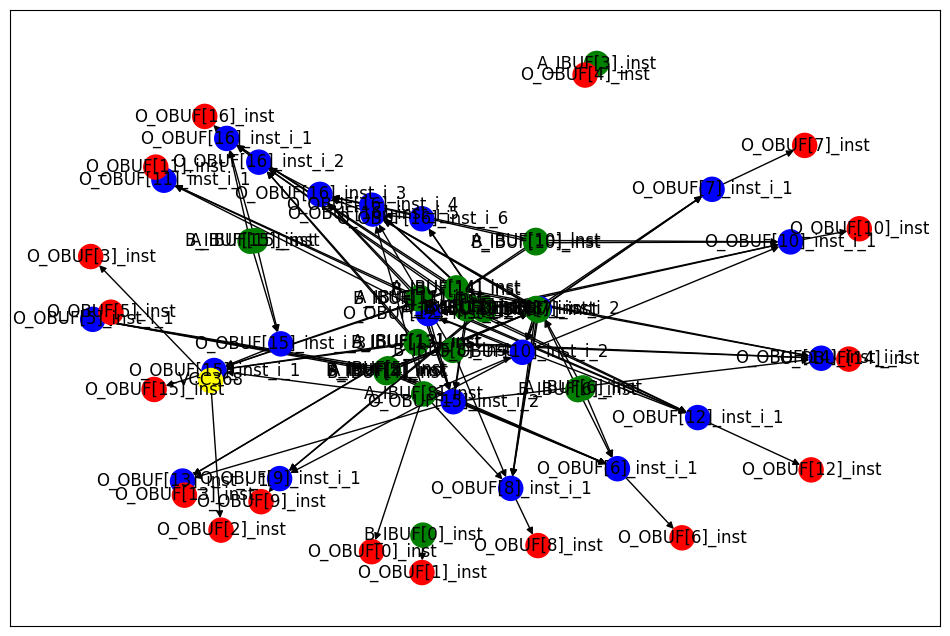

Archivo CSV generado: data/raw/add8u_5NQ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

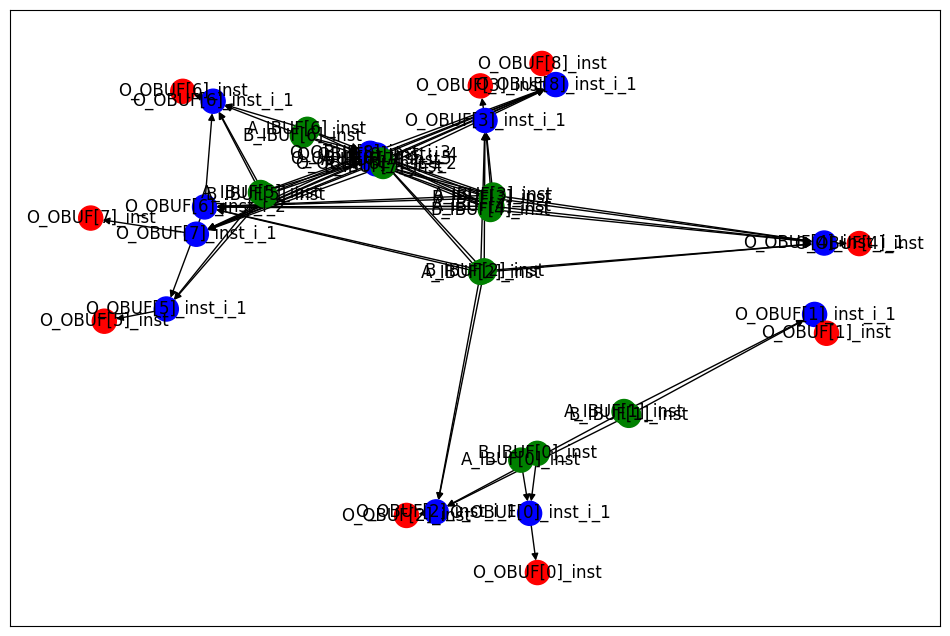

Archivo CSV generado: data/raw/add12se_570_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

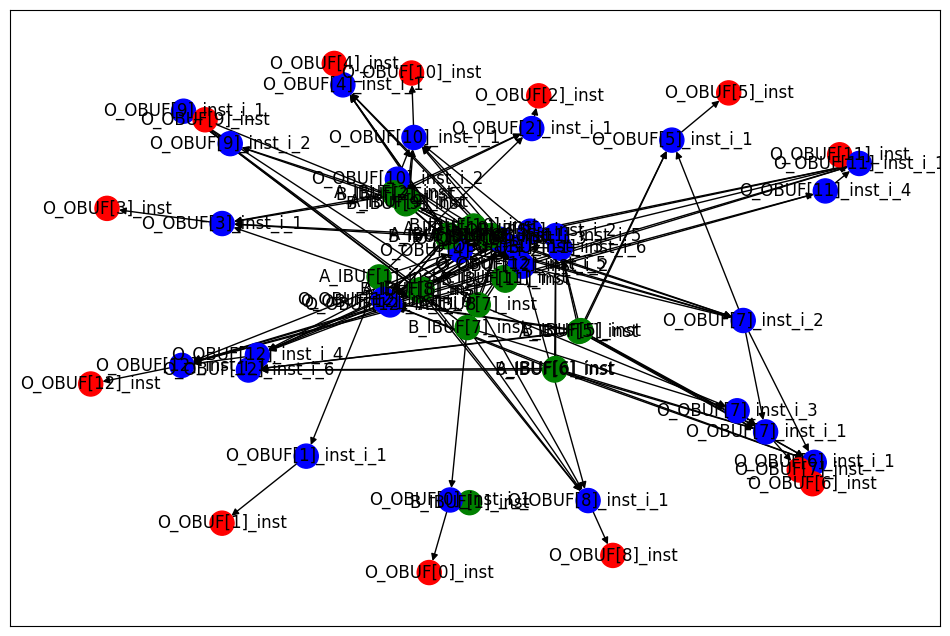

Archivo CSV generado: data/raw/add12u_4XD_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

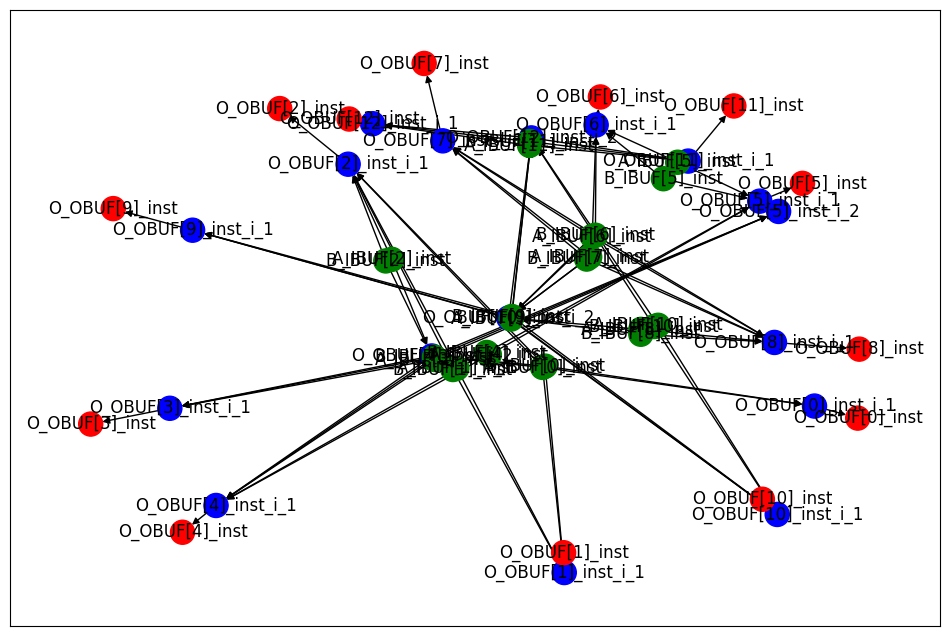

Archivo CSV generado: data/raw/add9se_0AL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output'

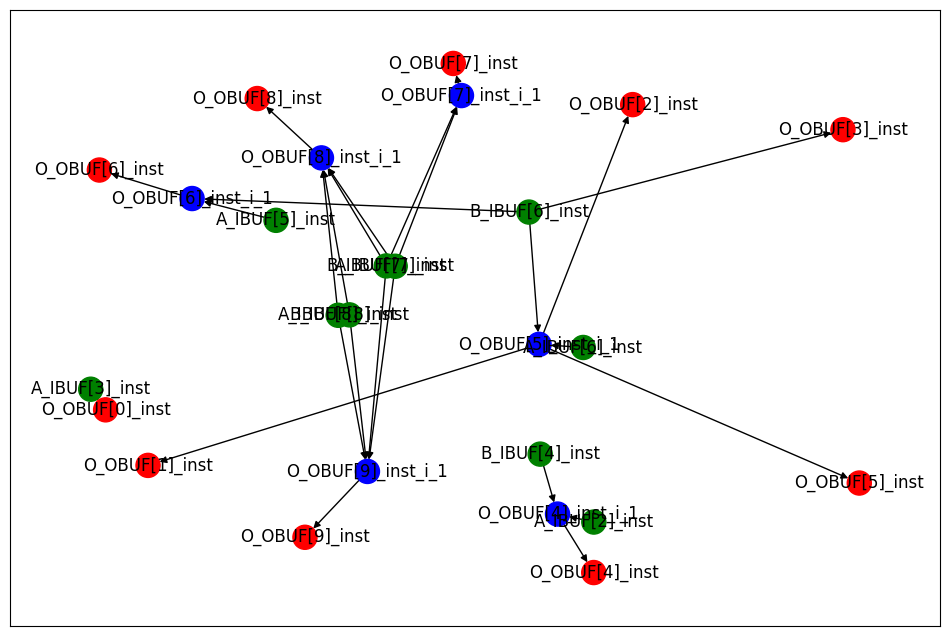

Archivo CSV generado: data/raw/add8s_6QJ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output':

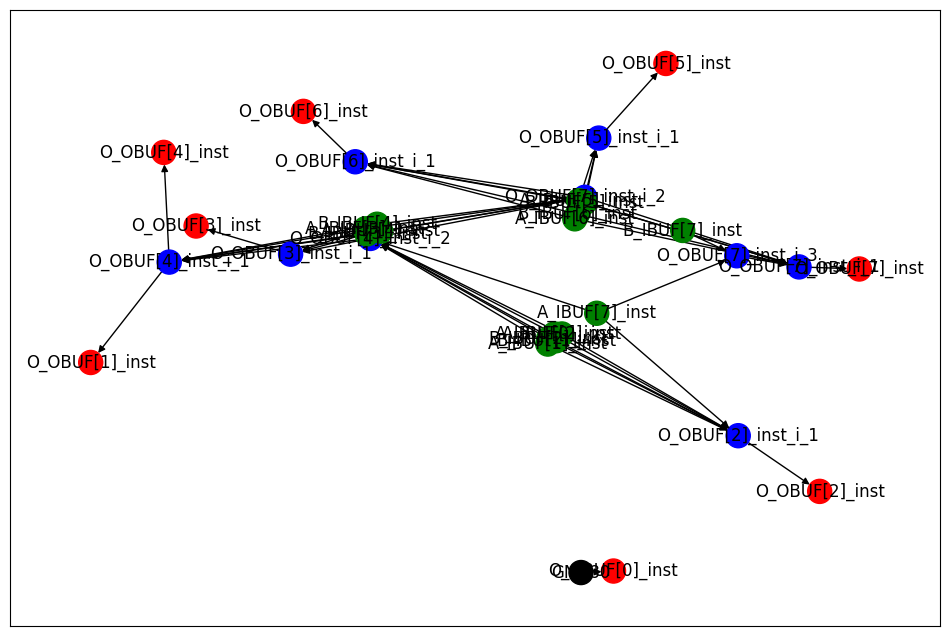

Archivo CSV generado: data/raw/add8se_8ZX_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

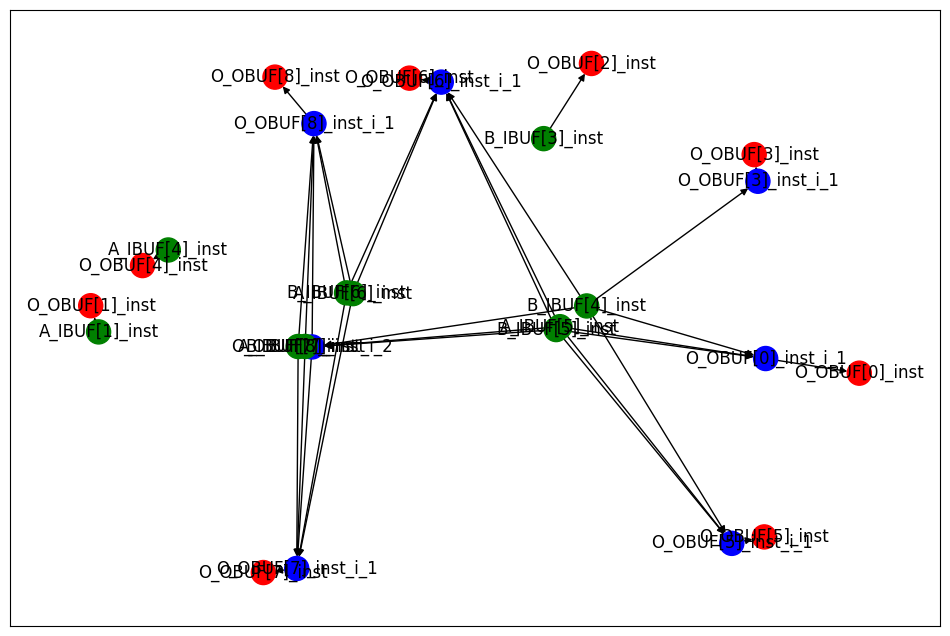

Archivo CSV generado: data/raw/add8s_83C_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

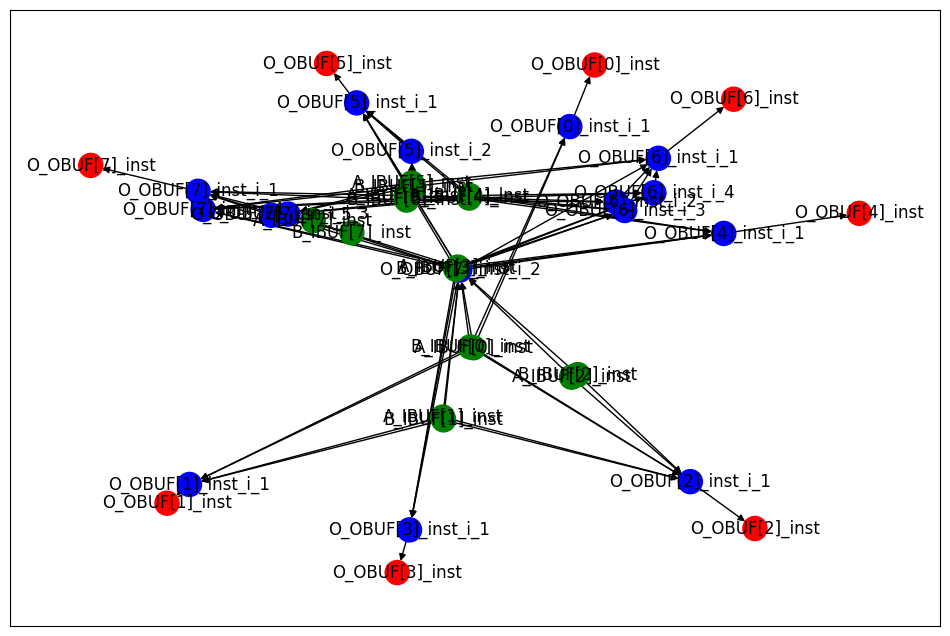

Archivo CSV generado: data/raw/add12u_4R6_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

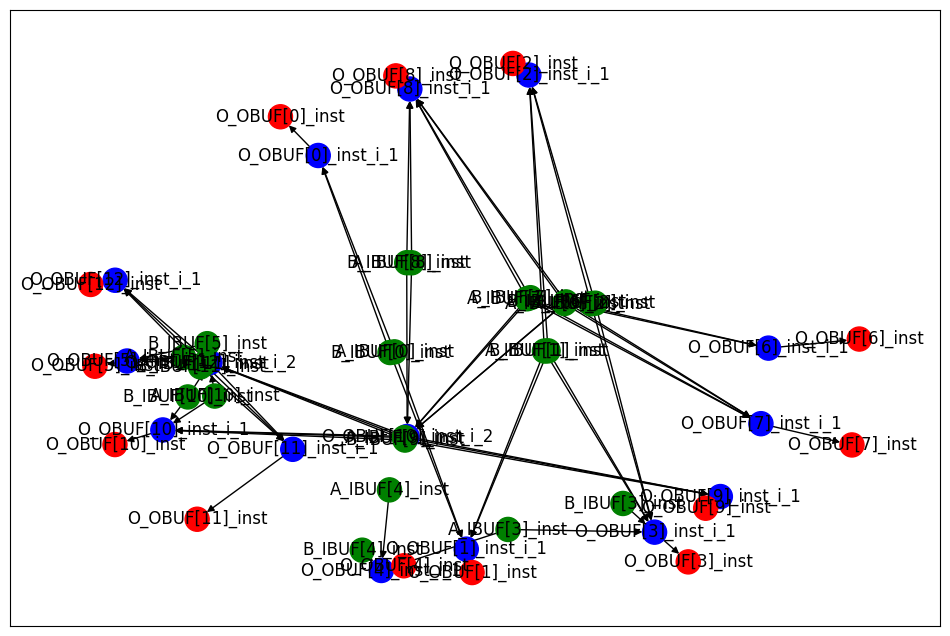

Archivo CSV generado: data/raw/add8u_1DK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

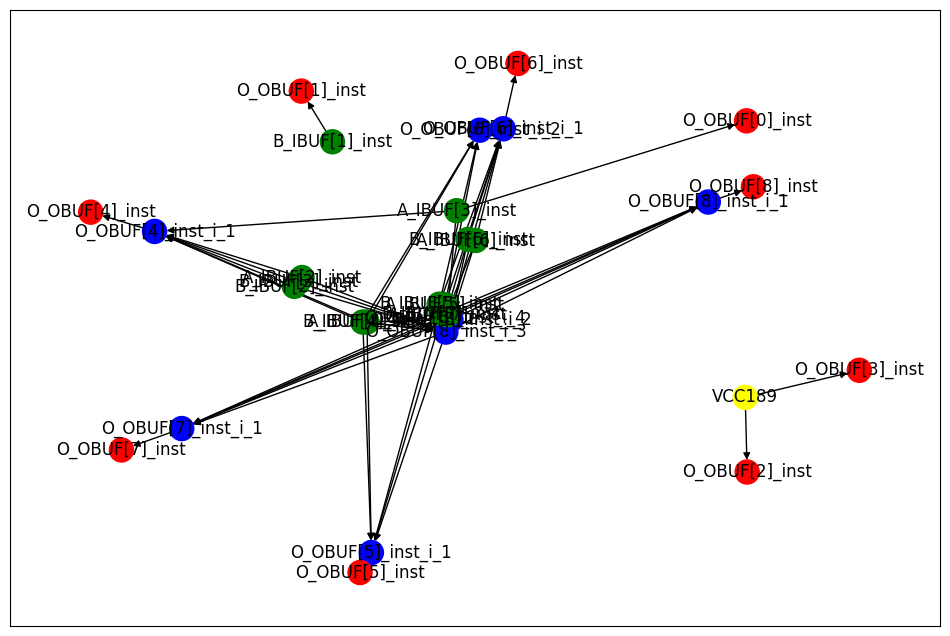

Archivo CSV generado: data/raw/add12u_4X2_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['B_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], '

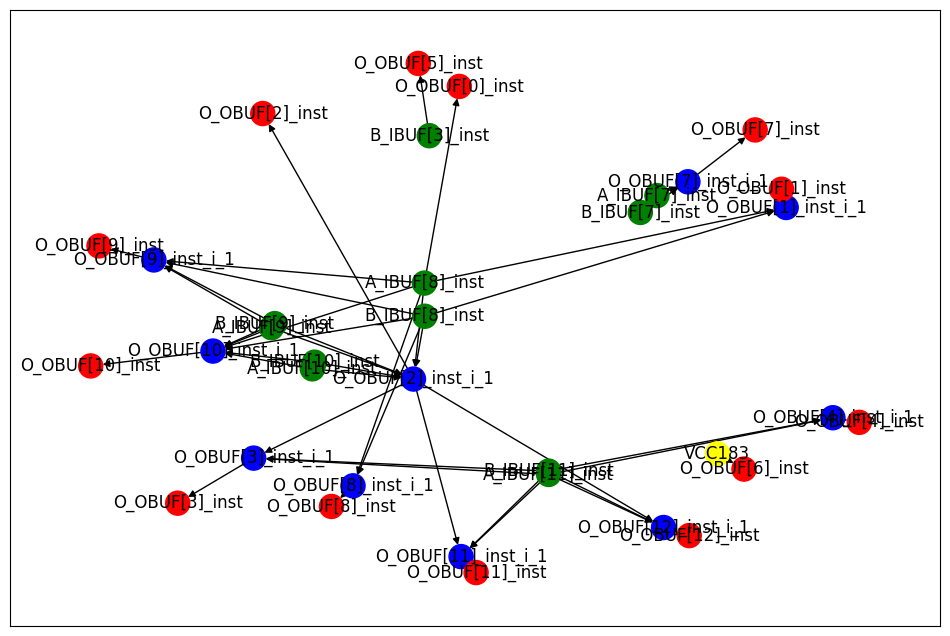

Archivo CSV generado: data/raw/add8u_2XT_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

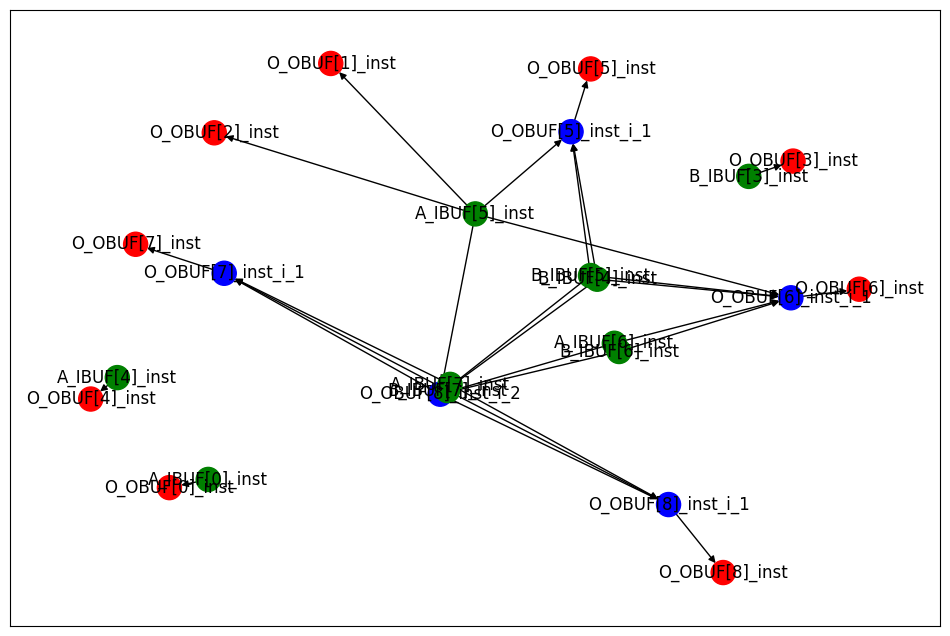

Archivo CSV generado: data/raw/add12u_17B_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_o

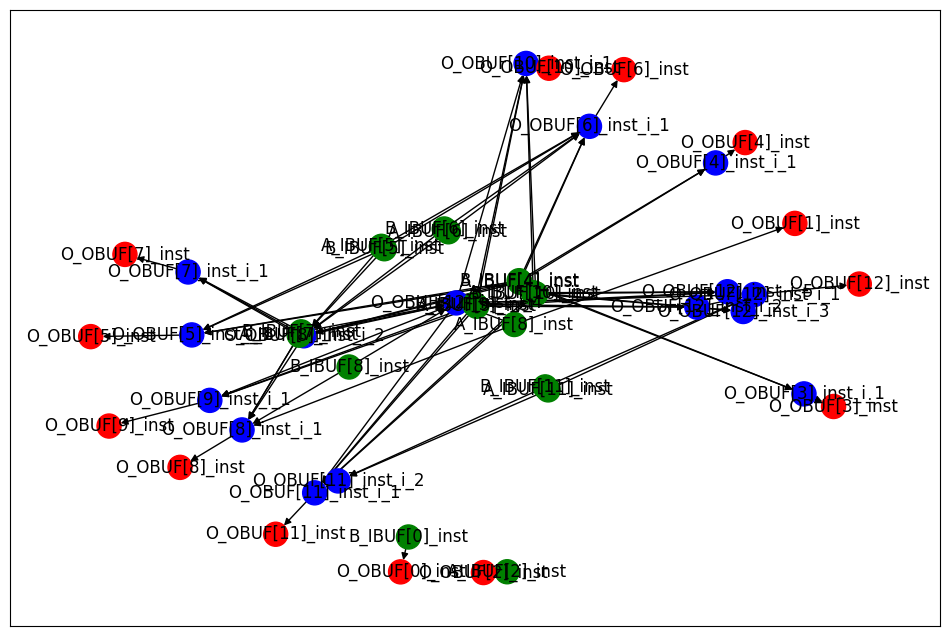

Archivo CSV generado: data/raw/add8u_8FF_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

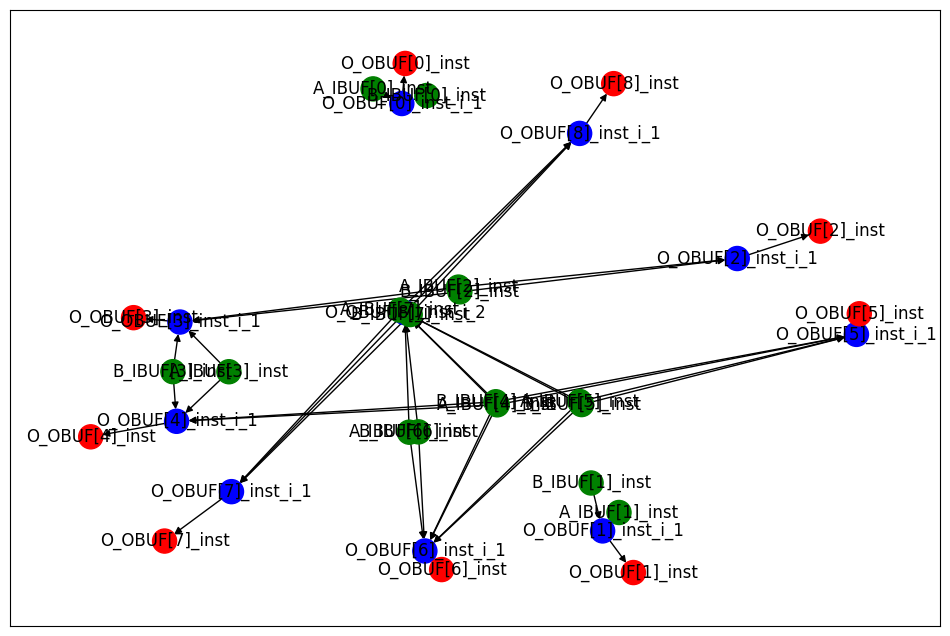

Archivo CSV generado: data/raw/add8s_6R6_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

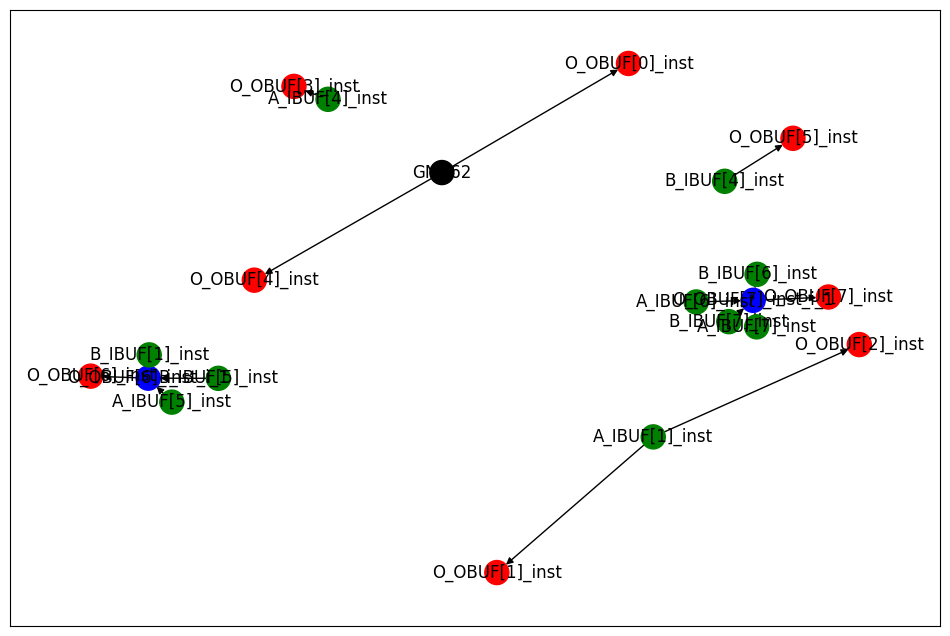

Archivo CSV generado: data/raw/add9se_0CG_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output'

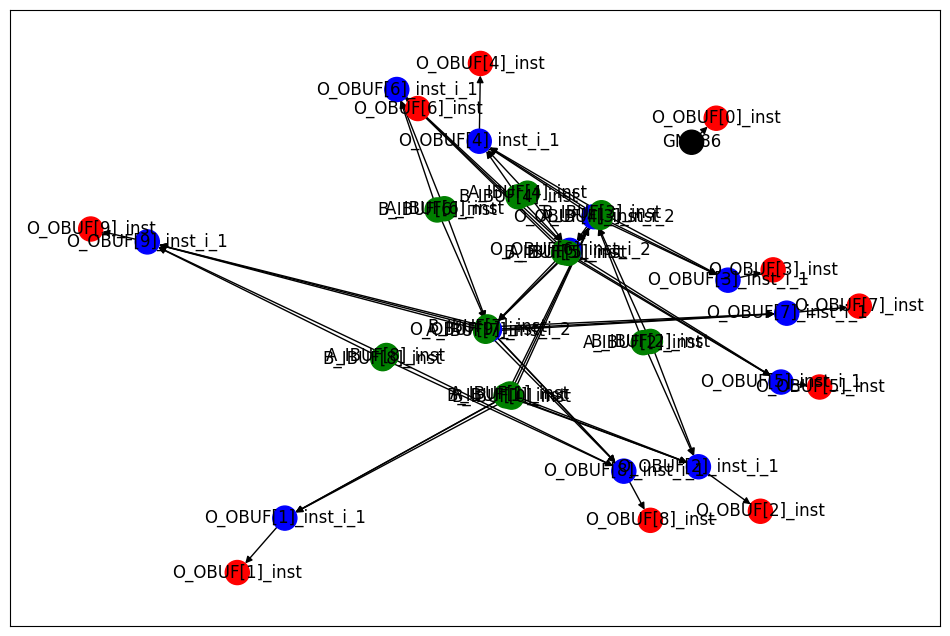

Archivo CSV generado: data/raw/add8u_8BB_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output':

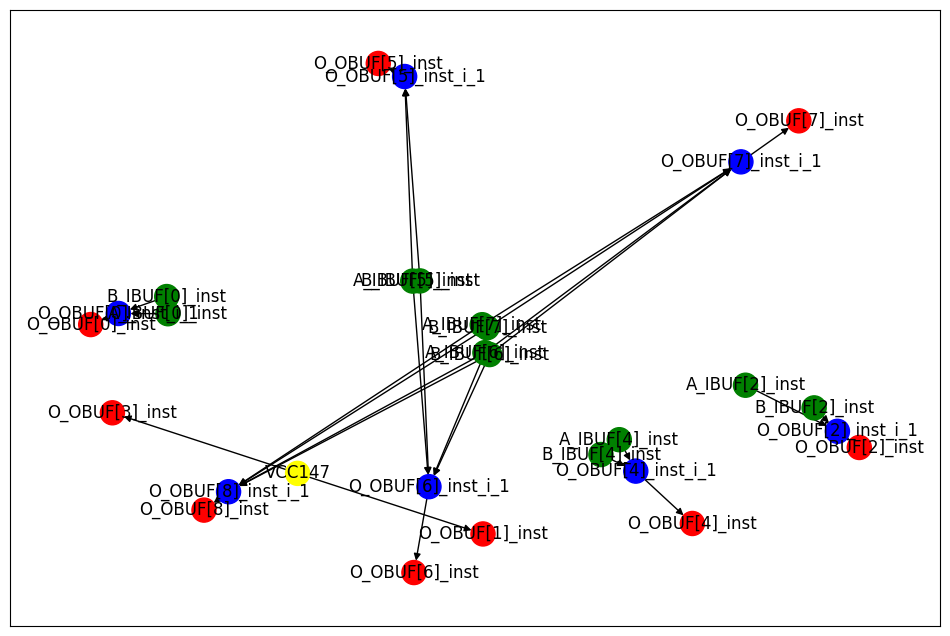

Archivo CSV generado: data/raw/add9se_0CU_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output'

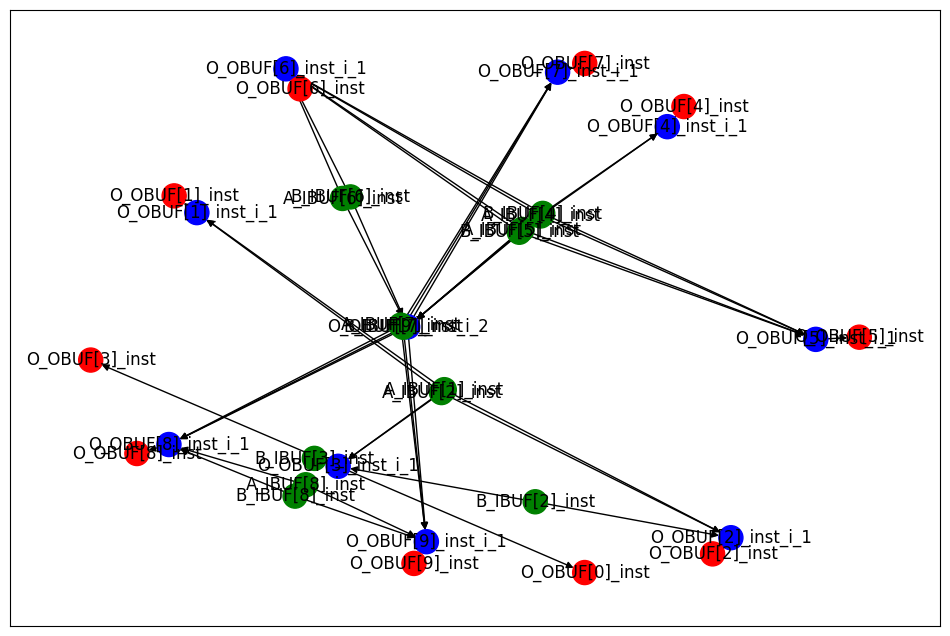

Archivo CSV generado: data/raw/add9se_087_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

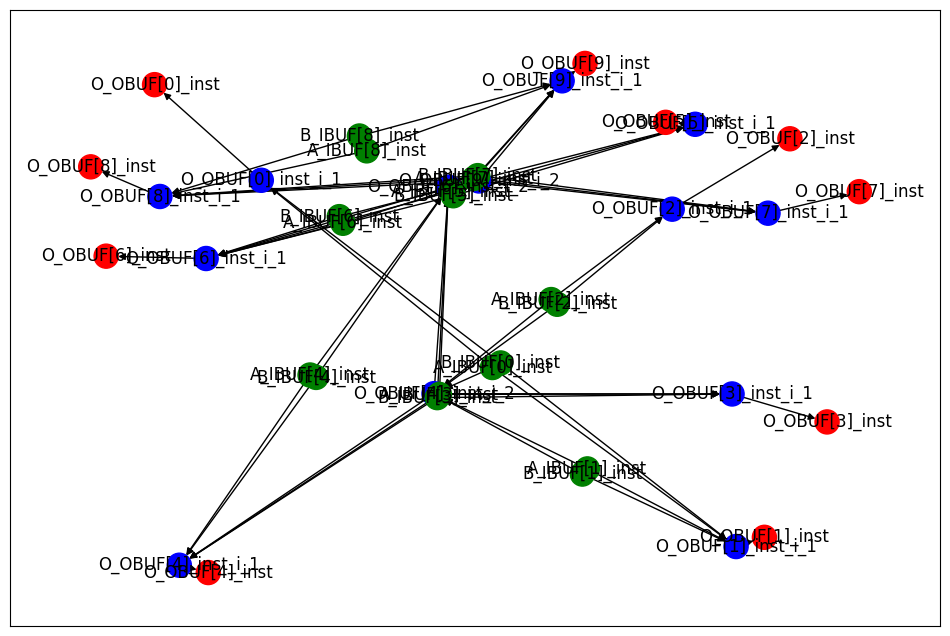

Archivo CSV generado: data/raw/add8se_92J_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output'

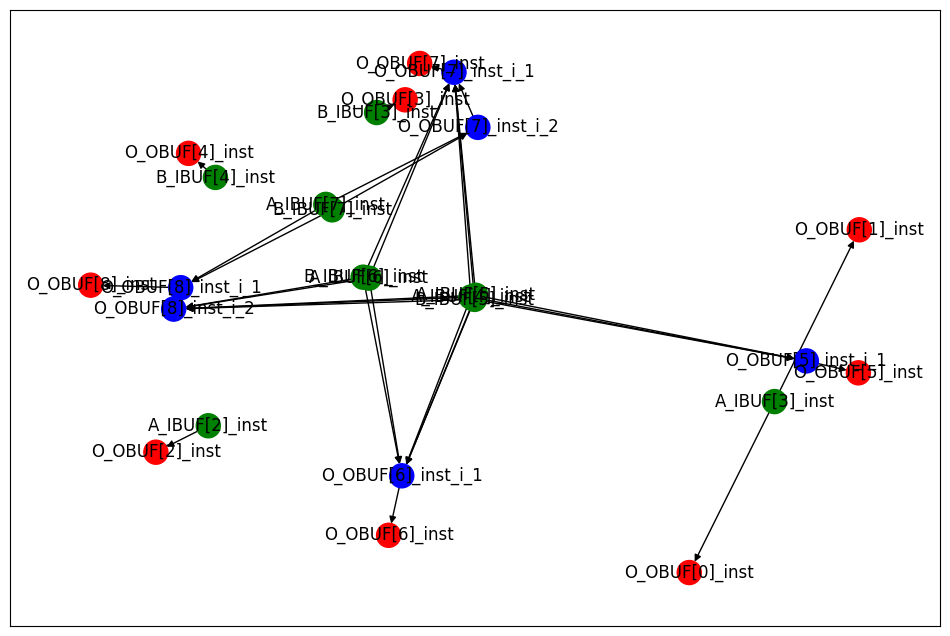

Archivo CSV generado: data/raw/add9se_0DV_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output': ['B_IBUF[8]']}
{'node_type': 'GND', 'node_name': 'GND44', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['\\<const0> '], 'node_output': 

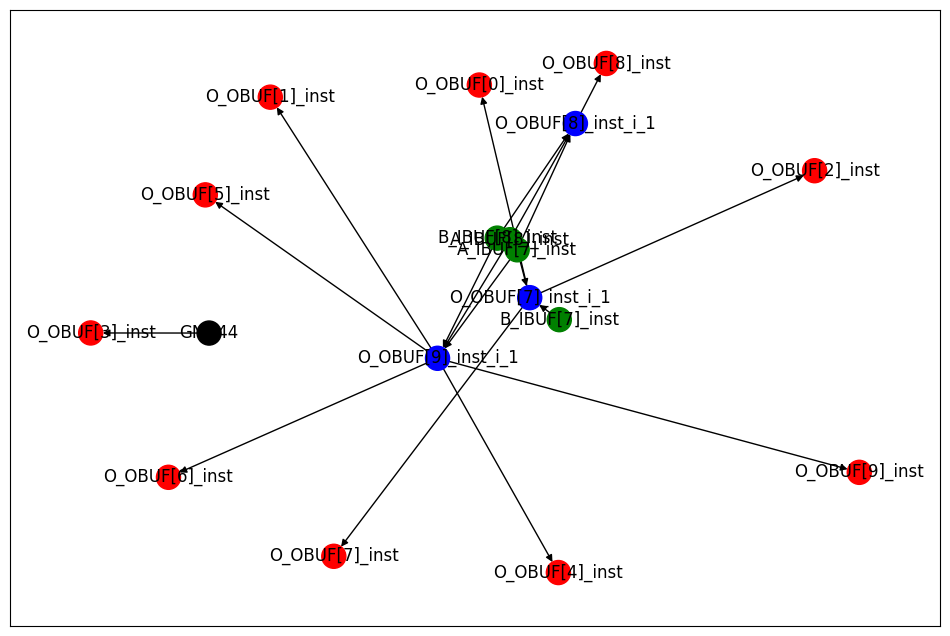

Archivo CSV generado: data/raw/add9se_0E4_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

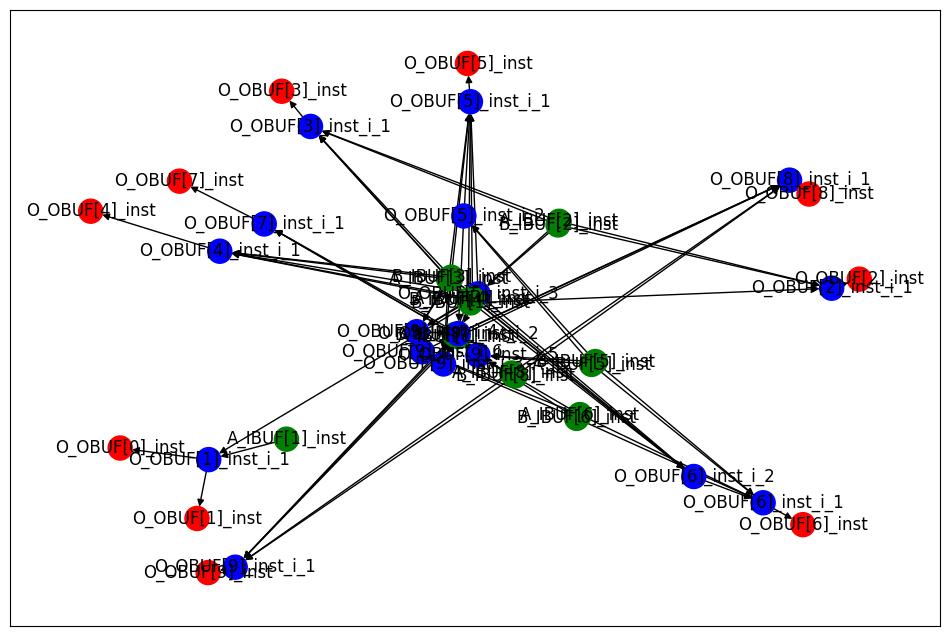

Archivo CSV generado: data/raw/add16u_0KC_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['O_OBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[12]_inst', 'node_input': ['B[12]'], 'node_output': ['B_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[13]_inst', 'node_input': ['B[13]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[14]_inst', 'node_input': ['B[14]'], 'node_output': ['B_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[15]_inst', 'node_input': 

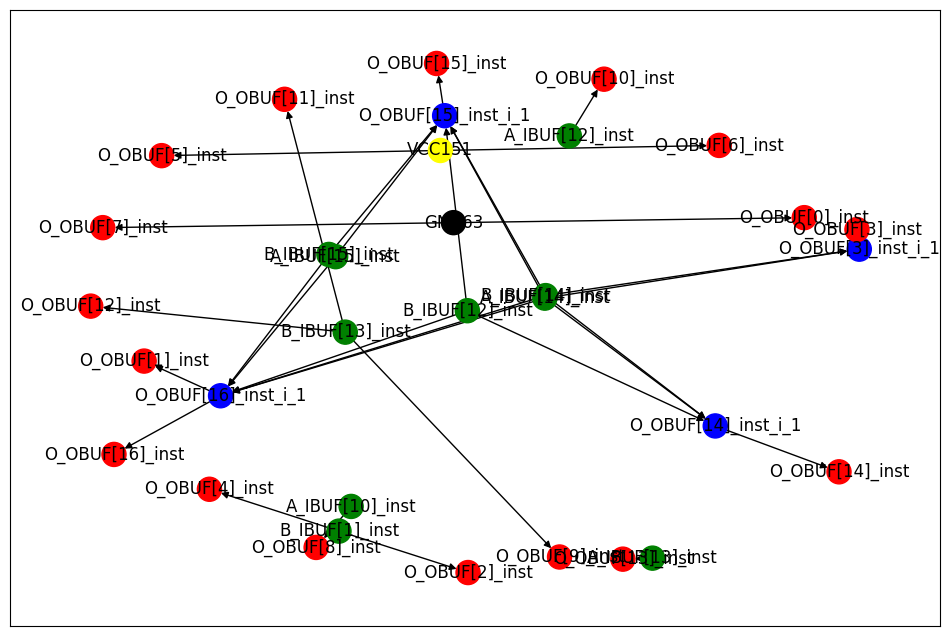

Archivo CSV generado: data/raw/add8s_6YG_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

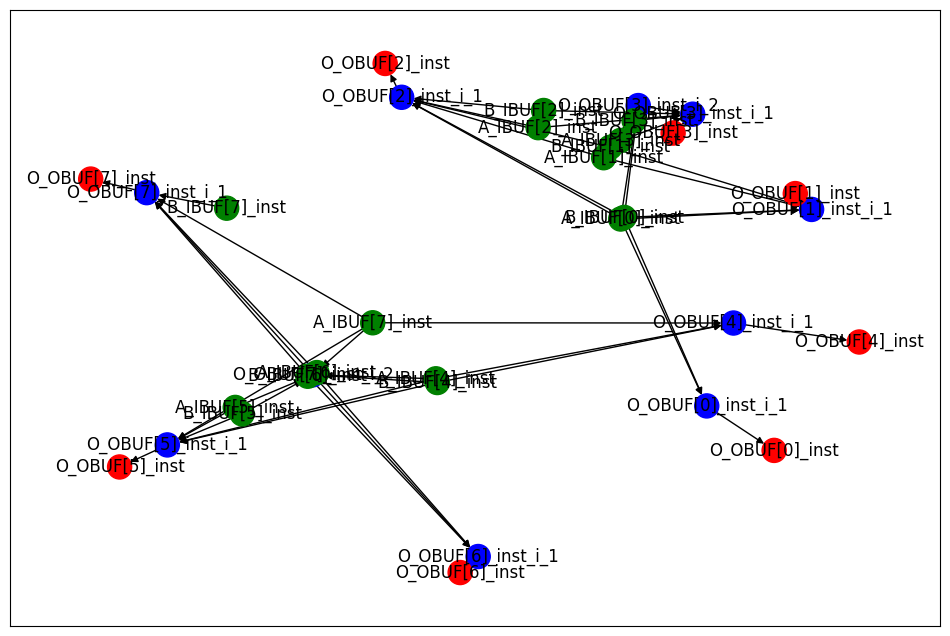

Archivo CSV generado: data/raw/add12u_013_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'n

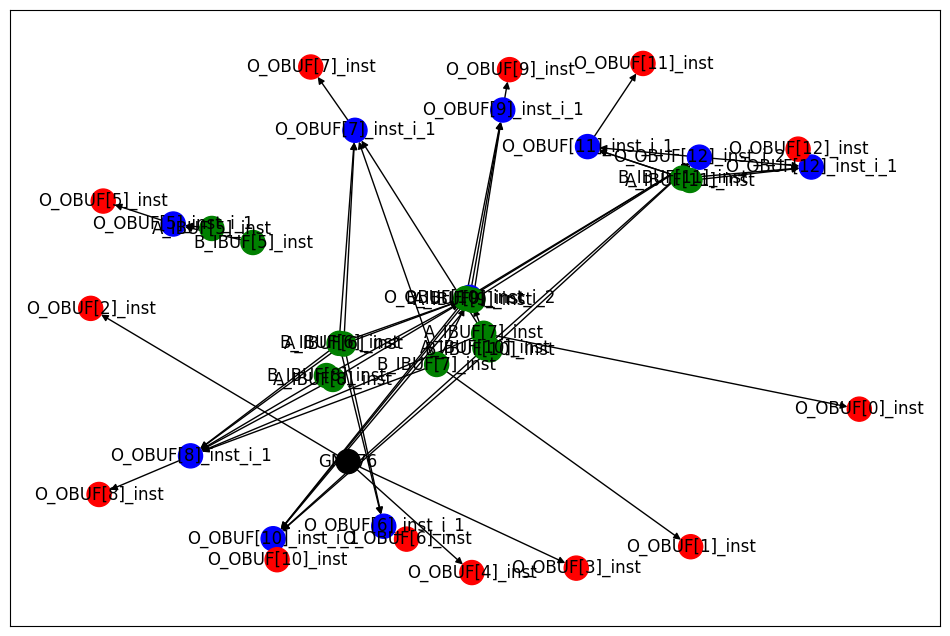

Archivo CSV generado: data/raw/add8se_8UN_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[2]'], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['O_OBUF[3]'], 'node_outpu

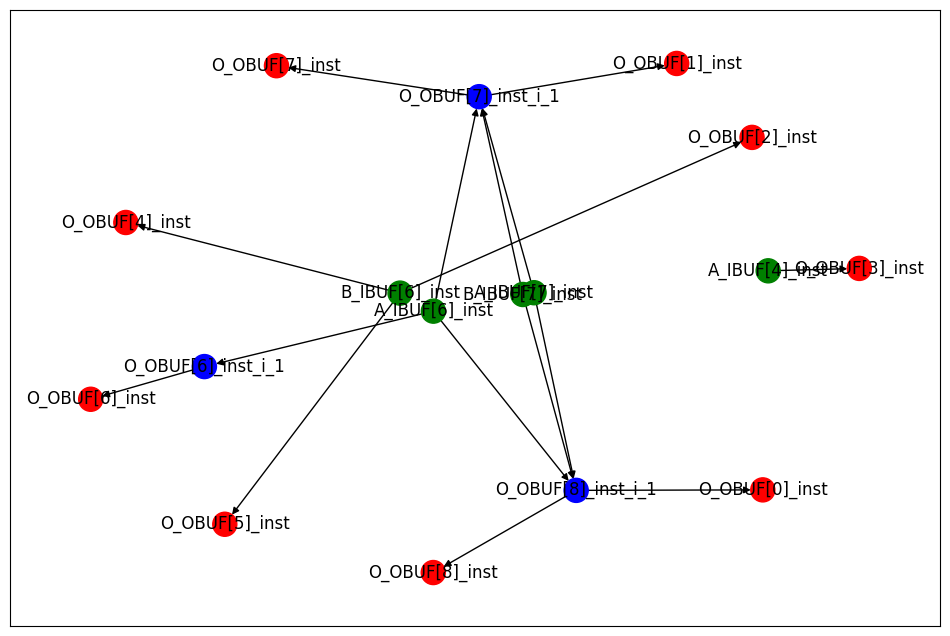

Archivo CSV generado: data/raw/add8u_8KJ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['B_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output':

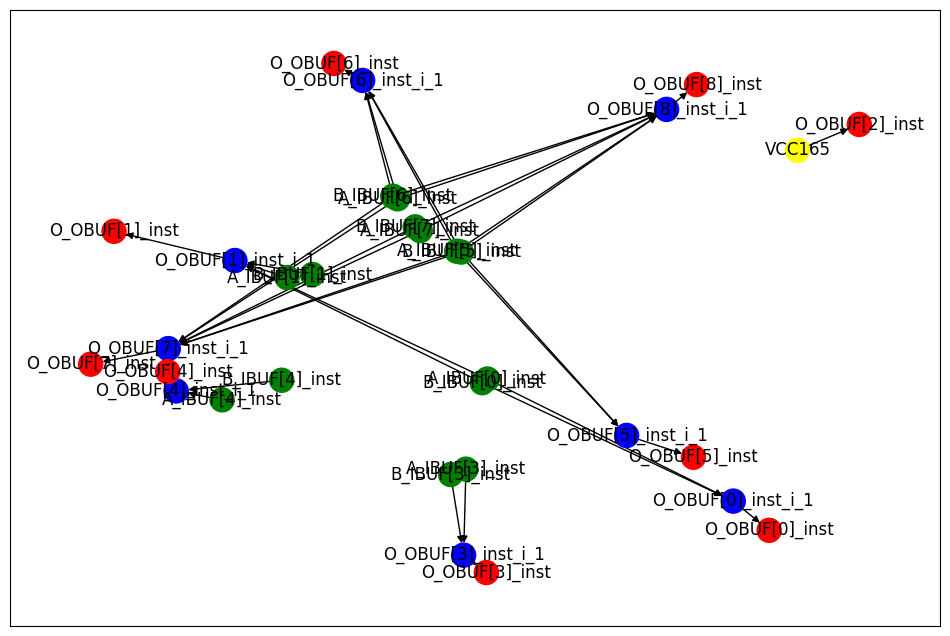

Archivo CSV generado: data/raw/add9se_0AY_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output'

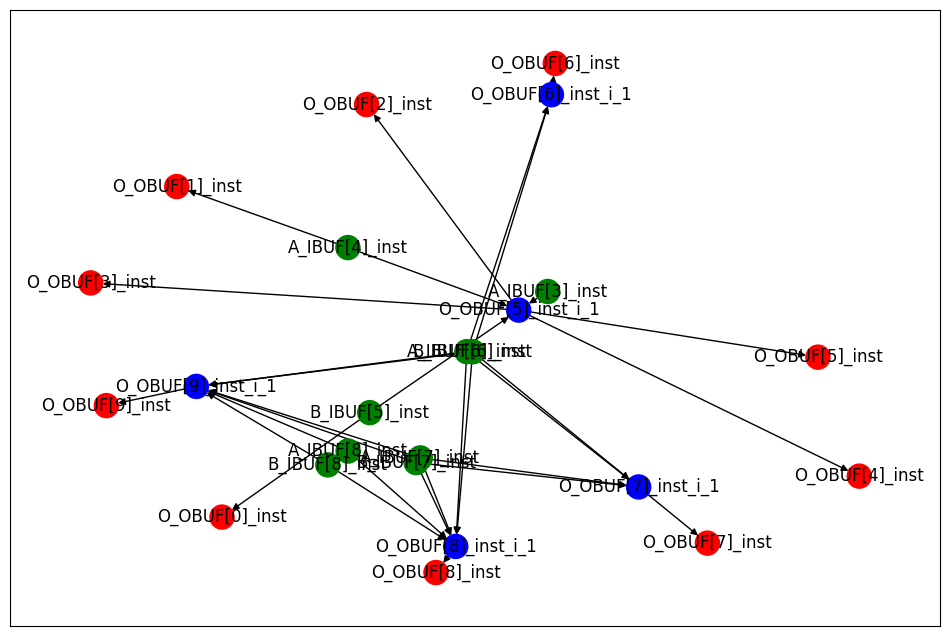

Archivo CSV generado: data/raw/add16se_2E1_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[

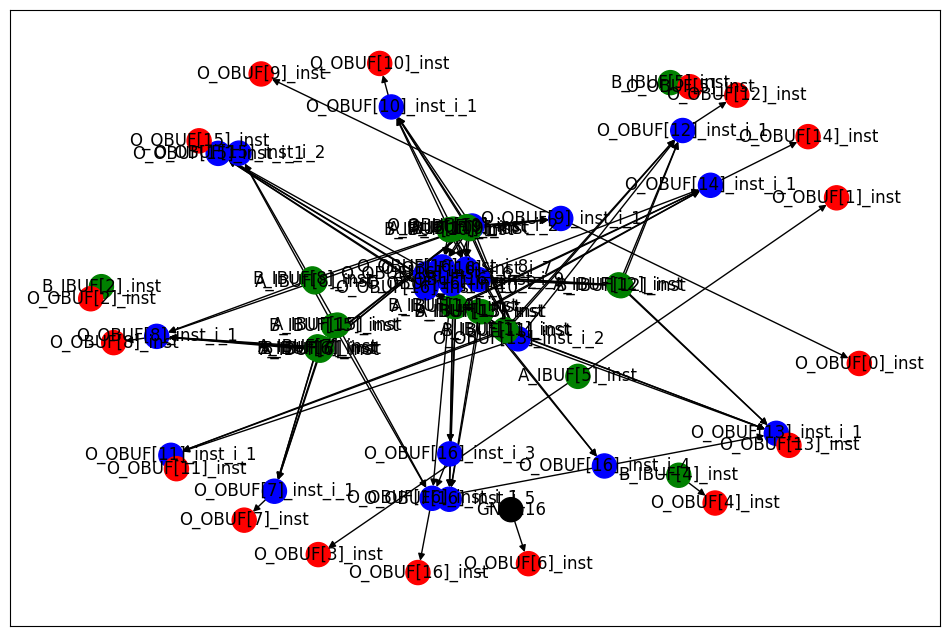

Archivo CSV generado: data/raw/add8u_04A_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND46', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['\\<const1> '], 'node_output': [

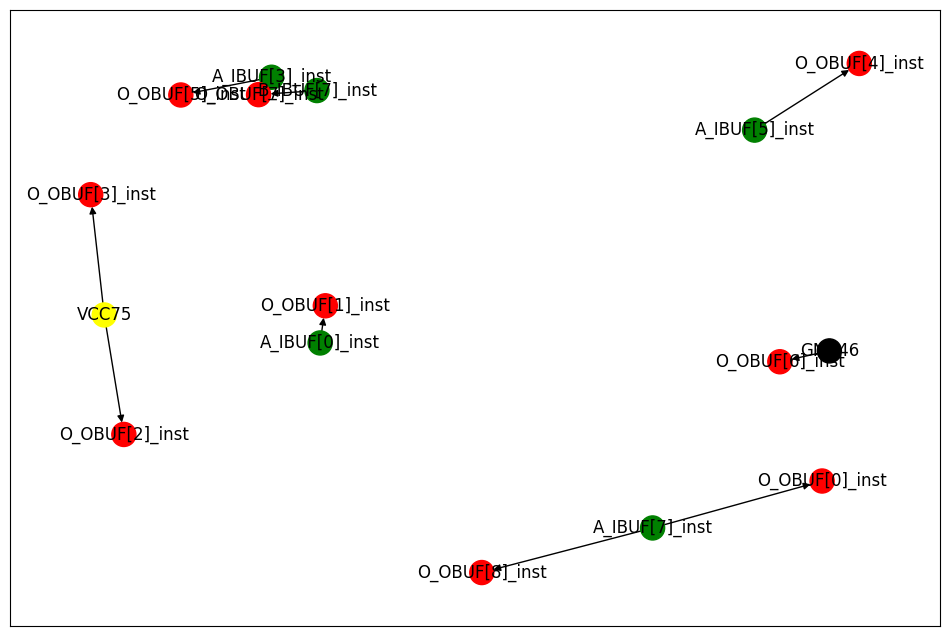

Archivo CSV generado: data/raw/add8s_6J2_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output':

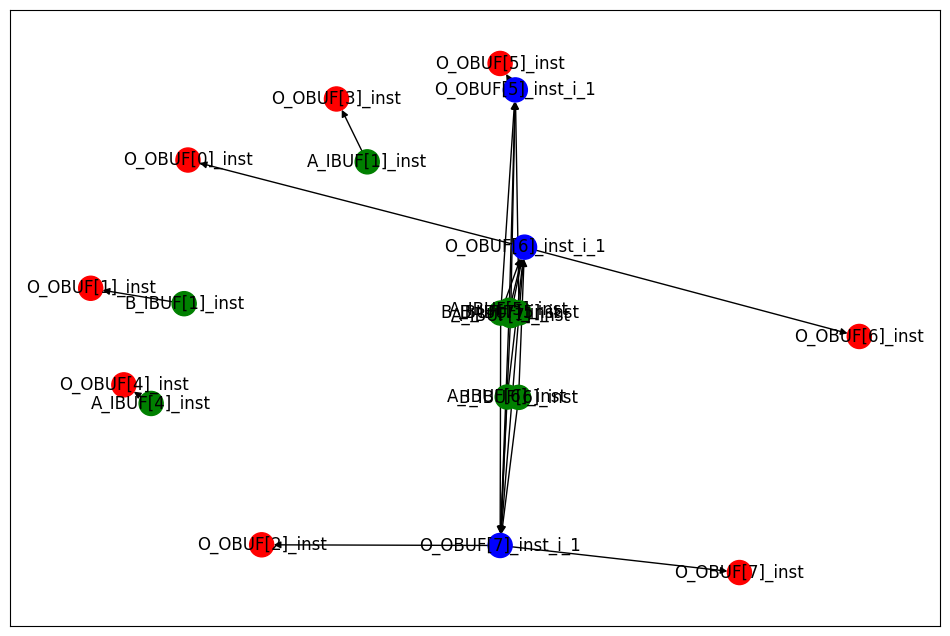

Archivo CSV generado: data/raw/add8s_6UC_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

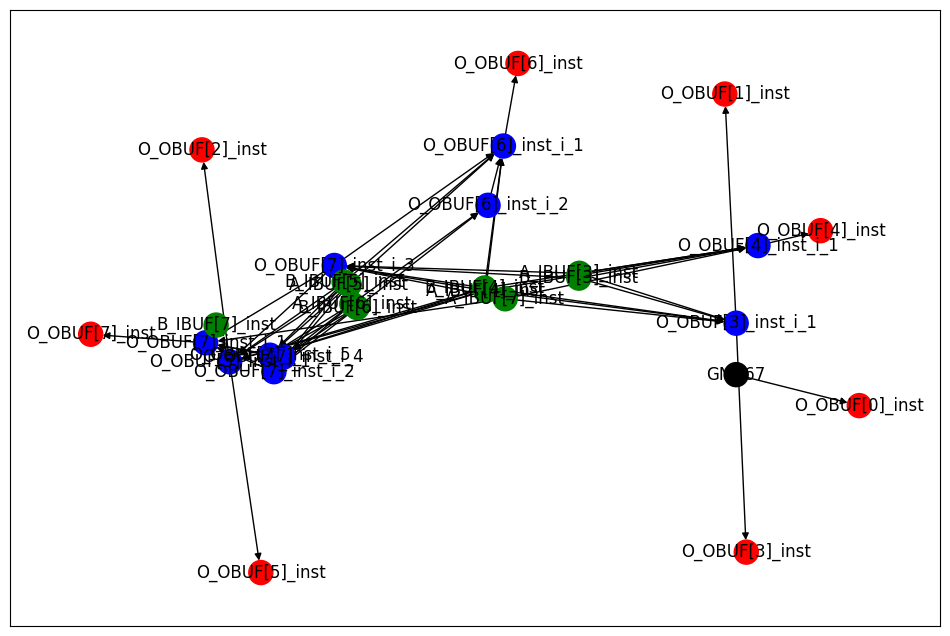

Archivo CSV generado: data/raw/add9se_00E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

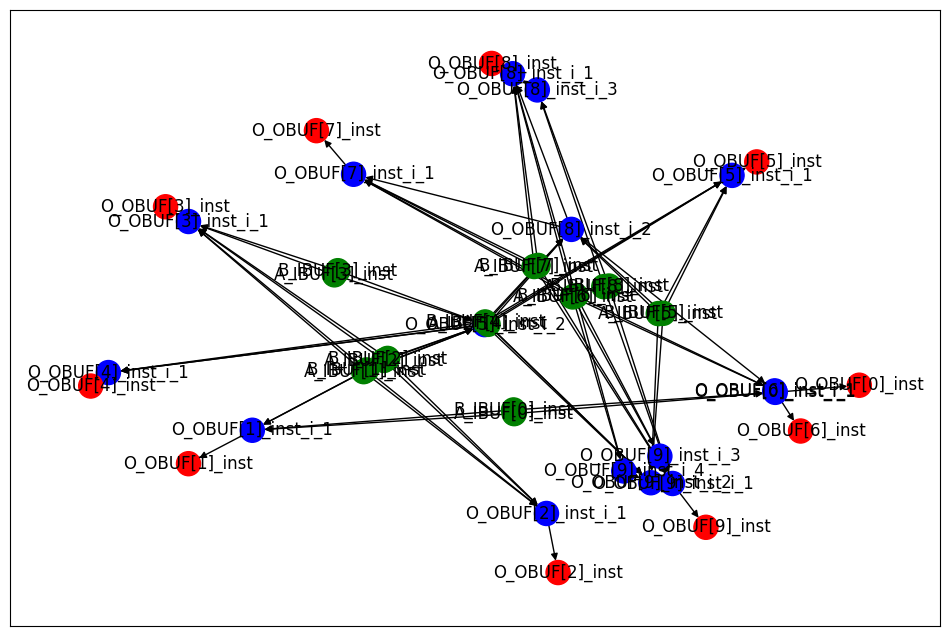

Archivo CSV generado: data/raw/add12se_54N_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

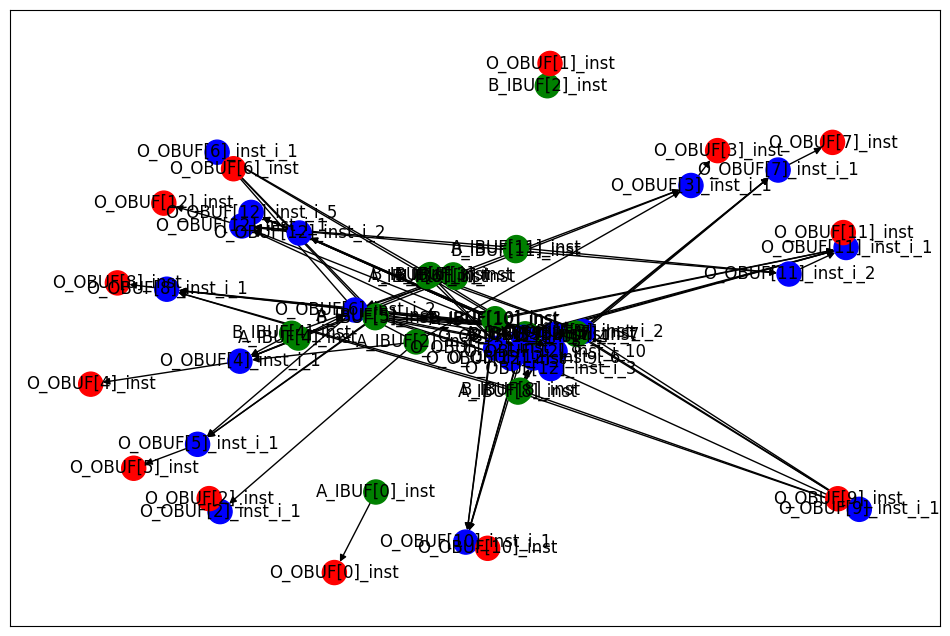

Archivo CSV generado: data/raw/add8s_6YE_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

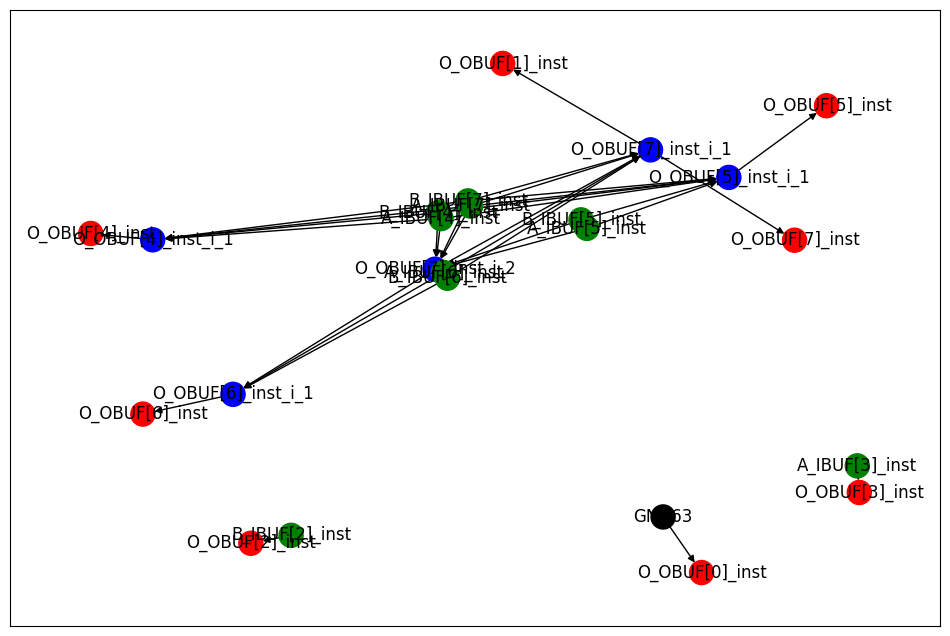

Archivo CSV generado: data/raw/add9se_036_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output'

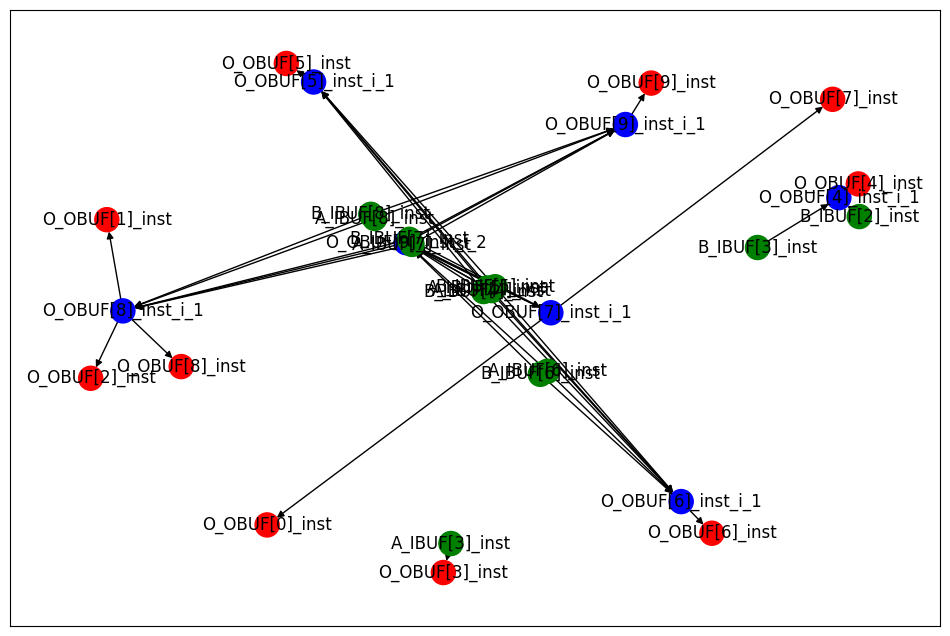

Archivo CSV generado: data/raw/add9se_028_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output'

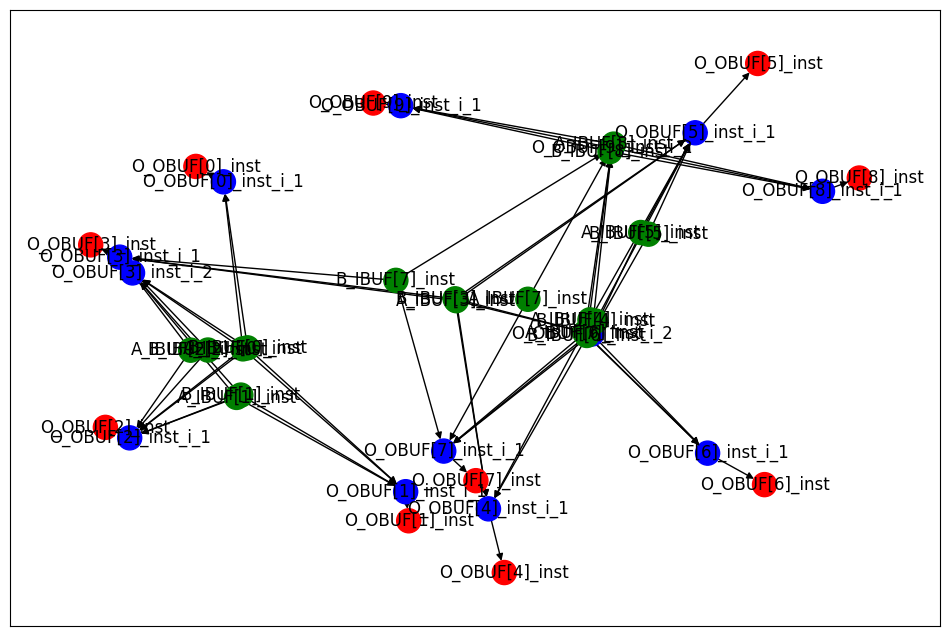

Archivo CSV generado: data/raw/add8se_8VV_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

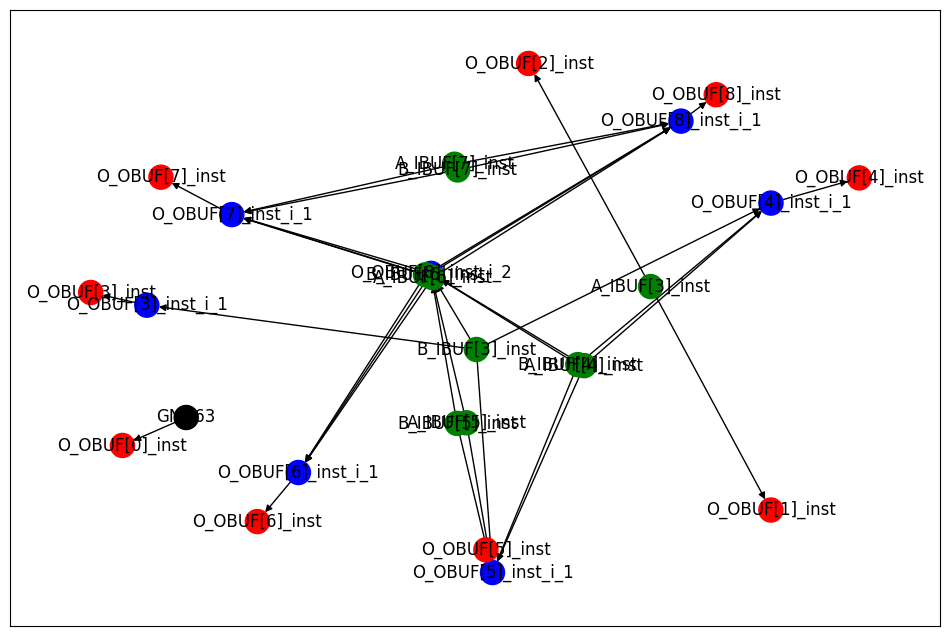

Archivo CSV generado: data/raw/add8u_5M7_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

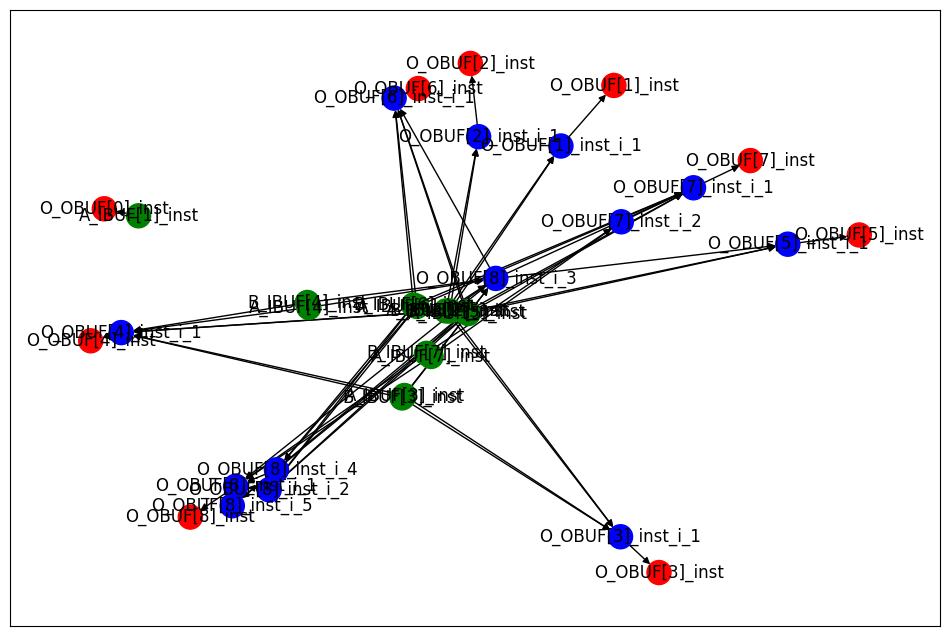

Archivo CSV generado: data/raw/add8se_90X_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[2]'], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[3]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[4]_inst', 'node_input': ['O_OBUF[2]'], 'node_outpu

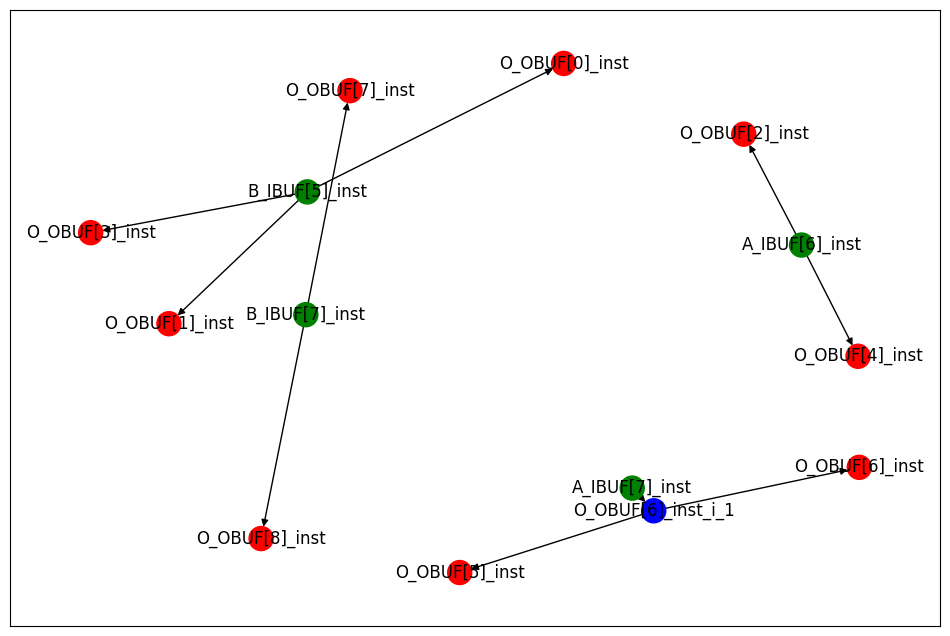

Archivo CSV generado: data/raw/add16u_02E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['O_OBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 

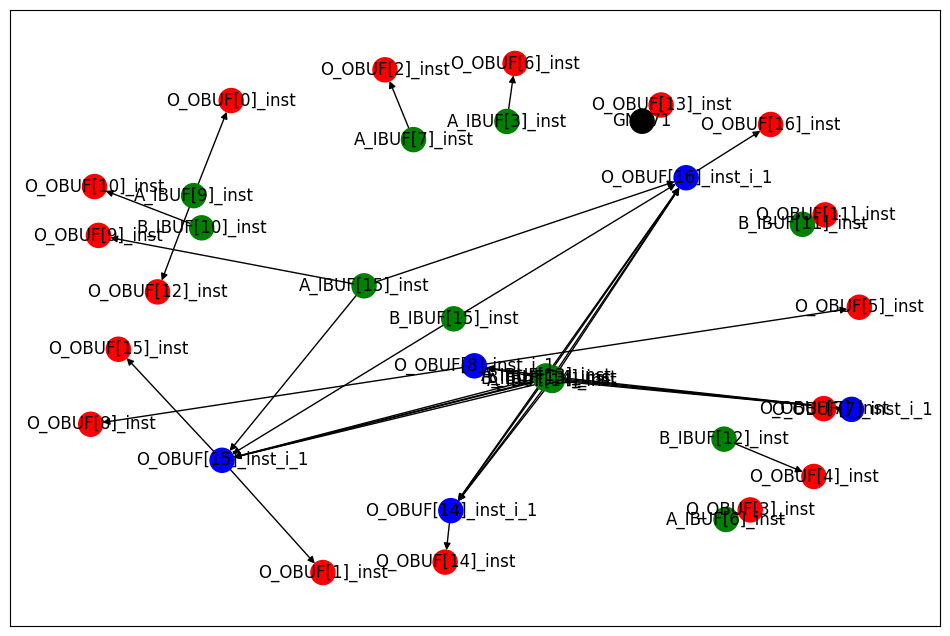

Archivo CSV generado: data/raw/add12u_2PX_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'nod

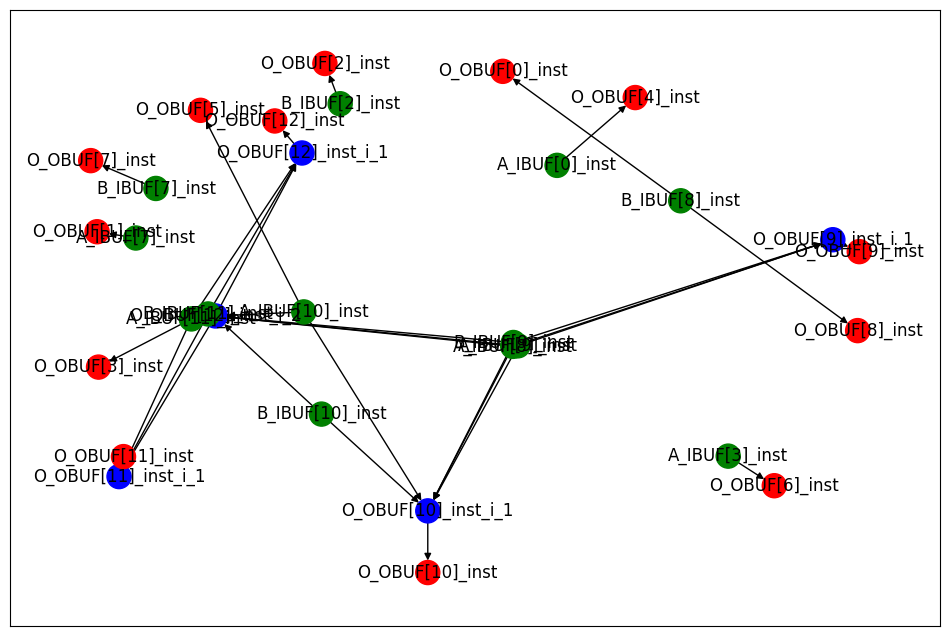

Archivo CSV generado: data/raw/add8u_006_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'GND', 'node_name': 'GND47', 'node_input': ['GND'], 'node_output': ['\\<const0> ']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['O_OBUF[2]'], 'node_output': ['O[2]']}

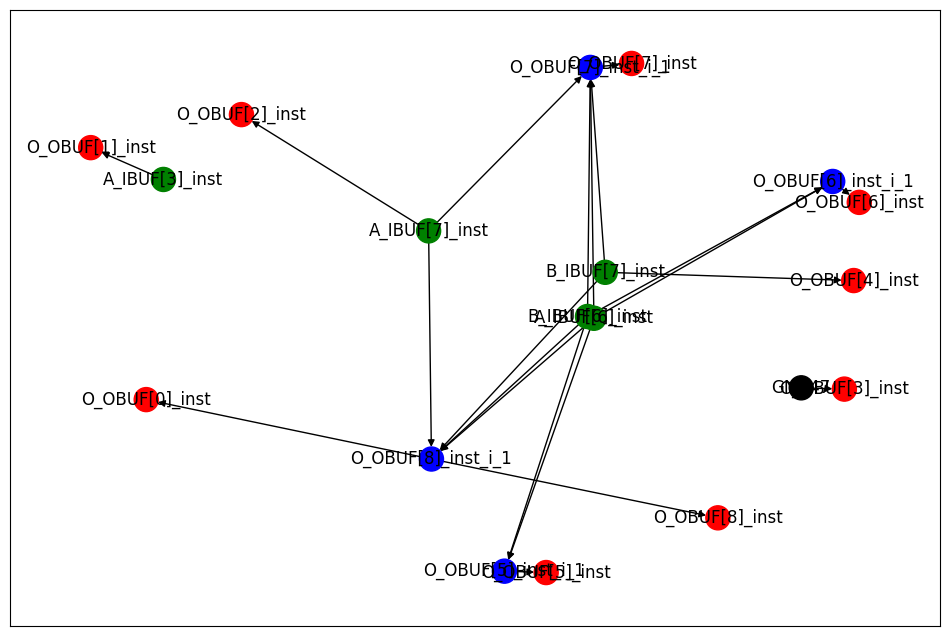

Archivo CSV generado: data/raw/add8s_6ZP_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

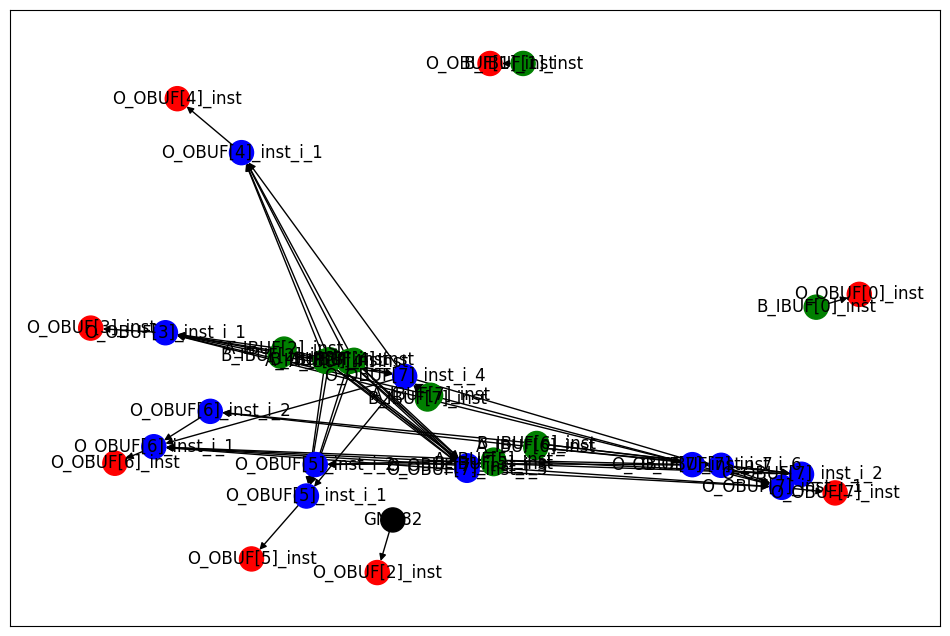

Archivo CSV generado: data/raw/add8s_6H2_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output':

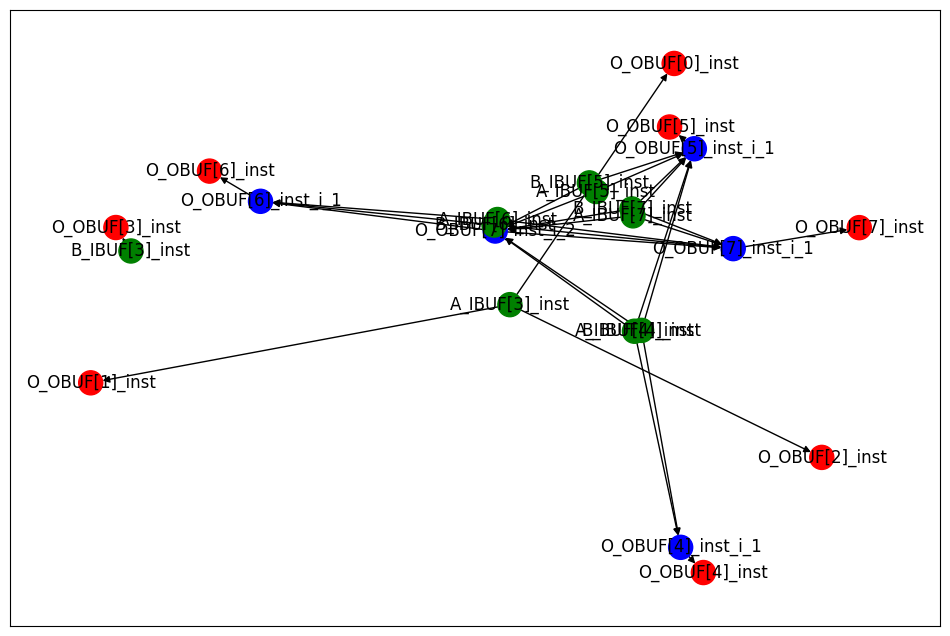

Archivo CSV generado: data/raw/add8se_8UF_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND56', 'node_input': ['GND'], 'node_output': ['\\<cons

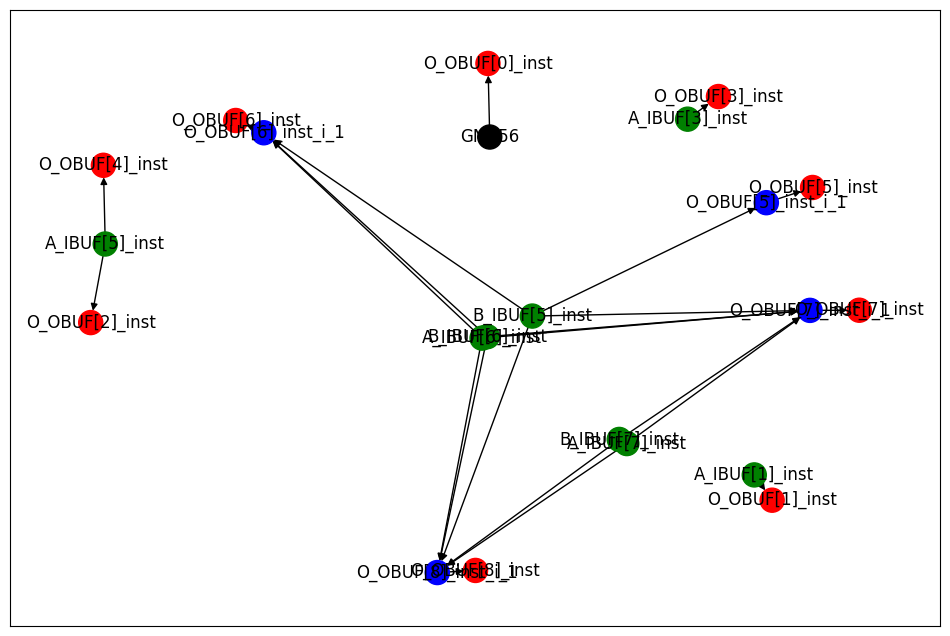

Archivo CSV generado: data/raw/add16se_2LJ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[

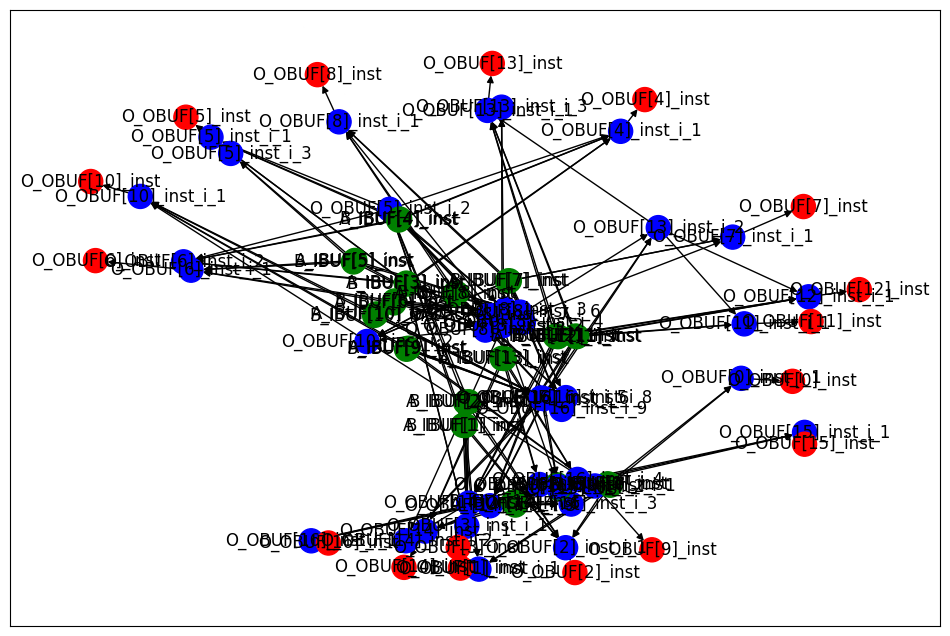

Archivo CSV generado: data/raw/add8se_90R_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output'

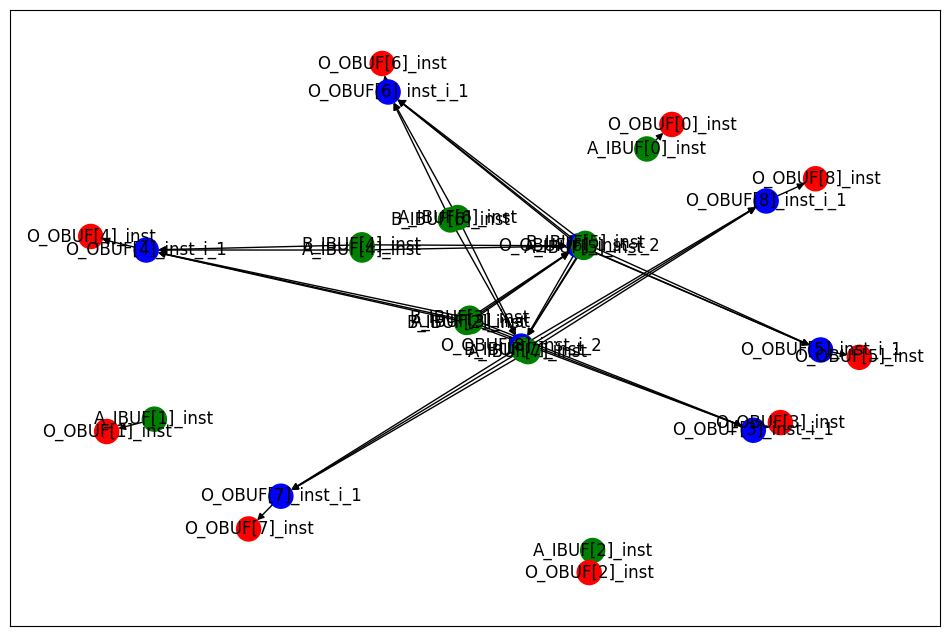

Archivo CSV generado: data/raw/add12se_59U_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_

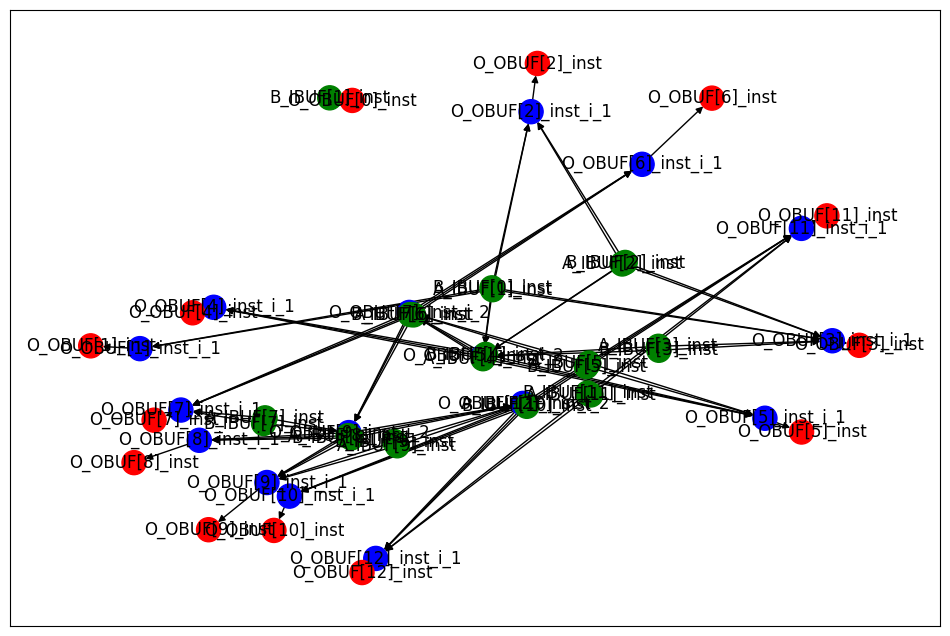

Archivo CSV generado: data/raw/add9se_07F_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output'

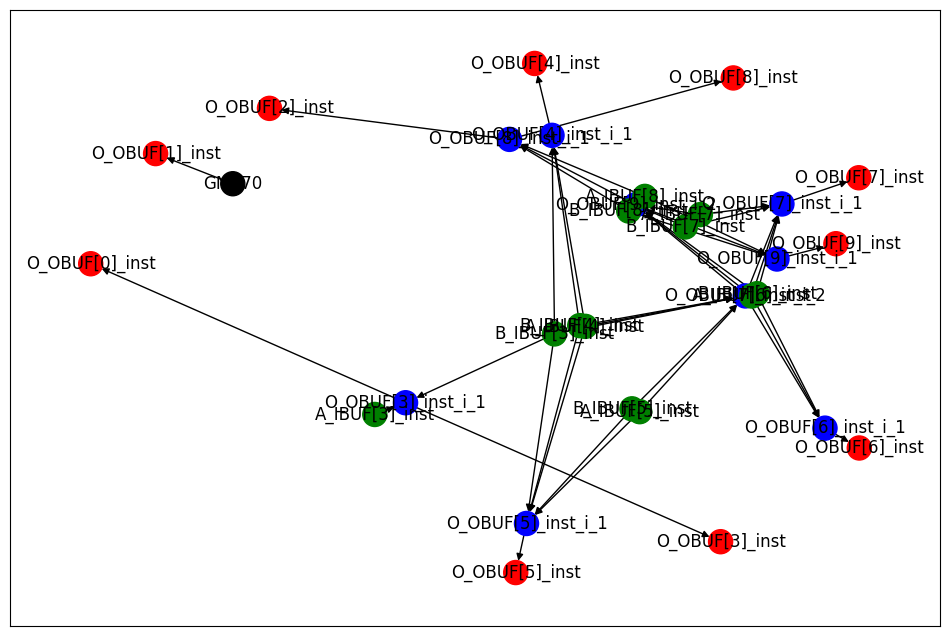

Archivo CSV generado: data/raw/add16u_0B4_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['O_OBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['O_OBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['

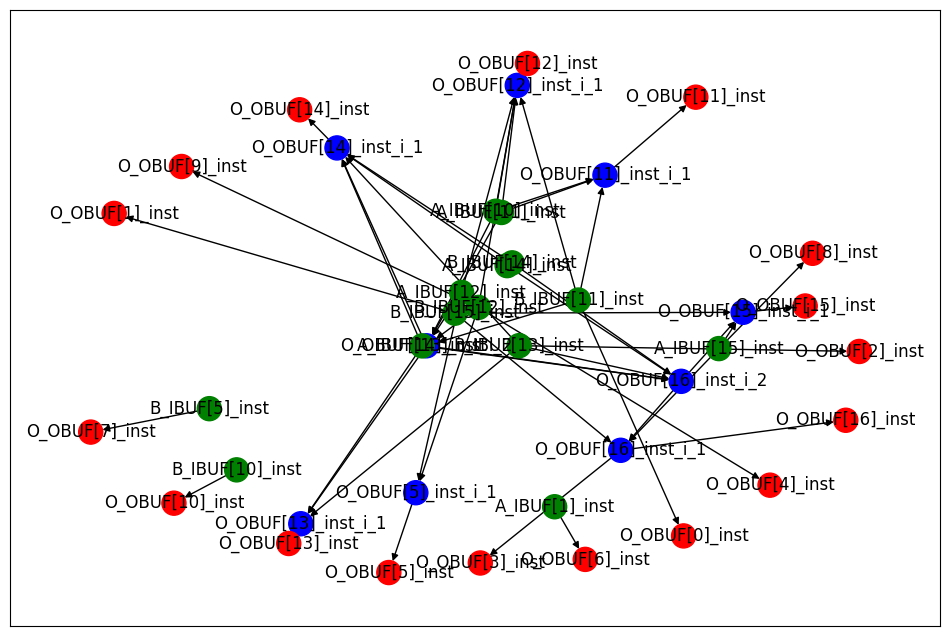

Archivo CSV generado: data/raw/add8u_8ES_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[1]'], 'node_output': ['O[1]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[2]_inst', 'node_input': ['\\<const1> '], 'node_output': ['O[2]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[3]_inst', 'node_input': ['O_OBUF[3]'], 'node_outpu

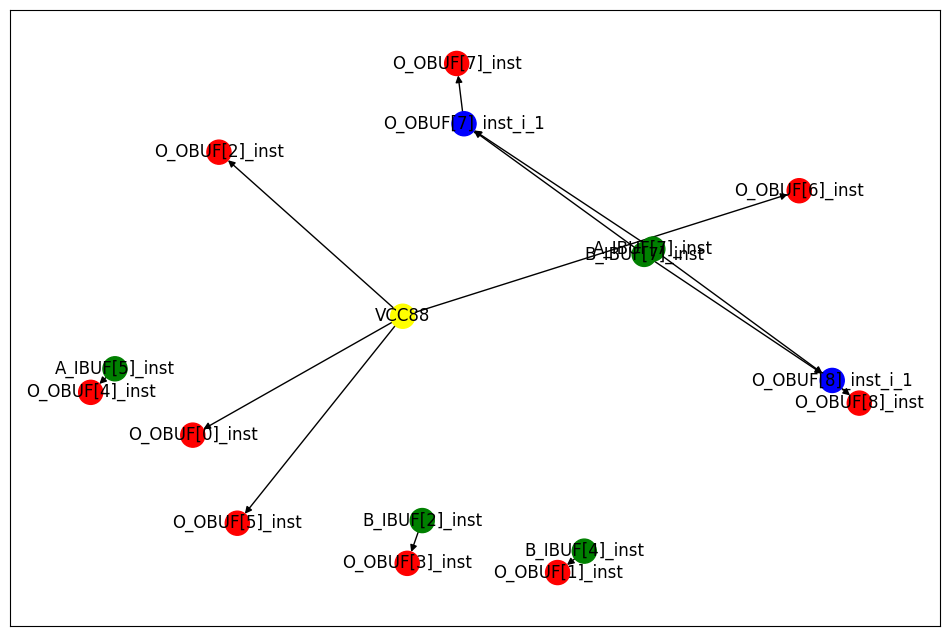

Archivo CSV generado: data/raw/add12u_0HR_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['B_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['B_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'n

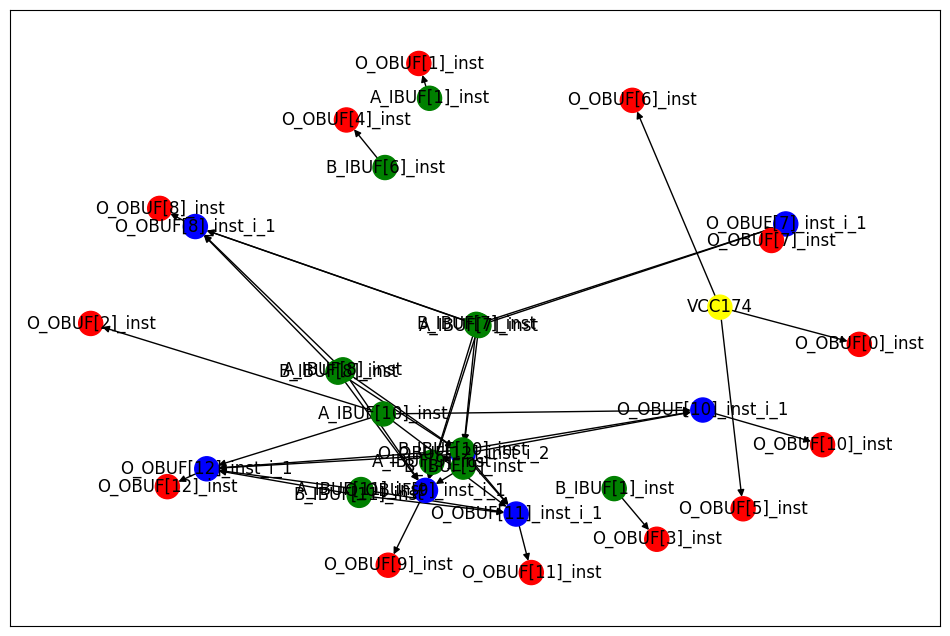

Archivo CSV generado: data/raw/add12se_57E_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_

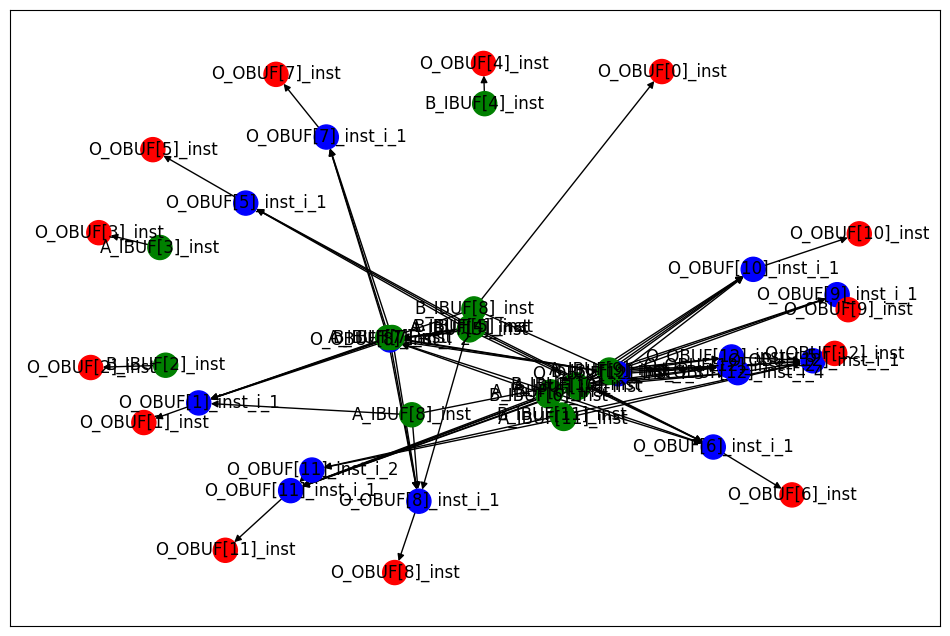

Archivo CSV generado: data/raw/add8u_5ME_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

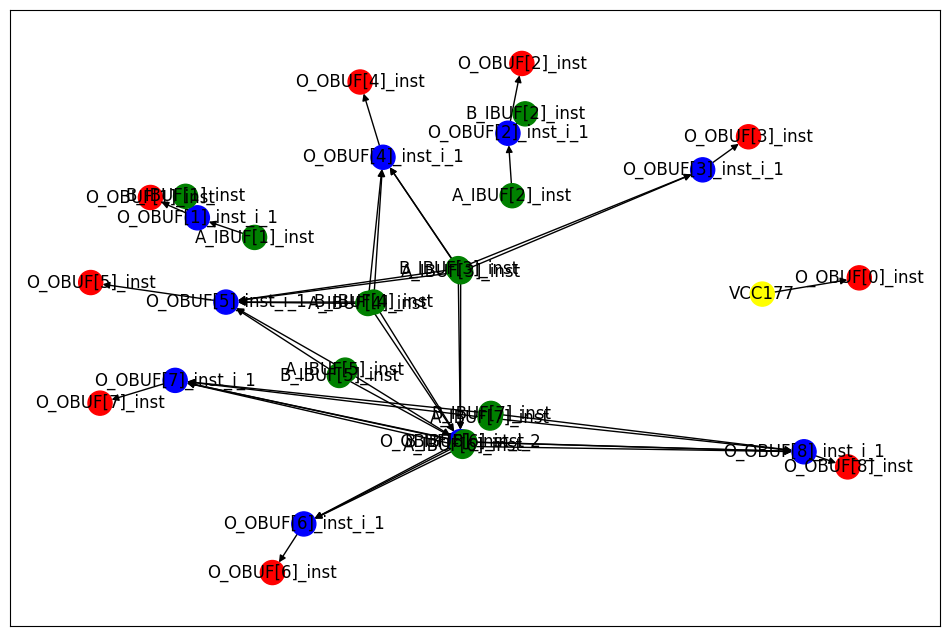

Archivo CSV generado: data/raw/add8u_8LL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'GND', 'node_name': 'GND56', 'node_input': ['GND'], 'node_output': ['\\<const

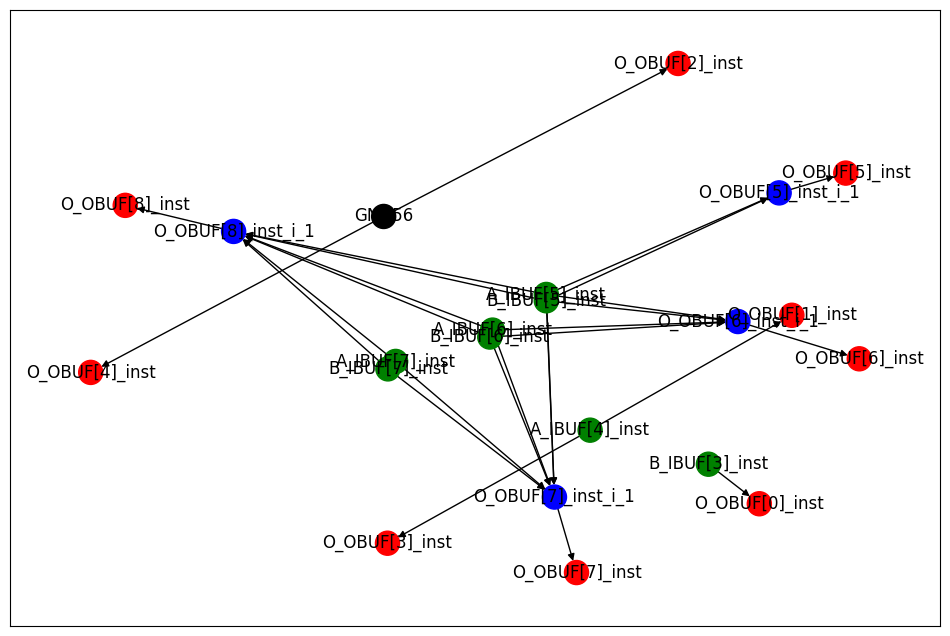

Archivo CSV generado: data/raw/add8s_7YK_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

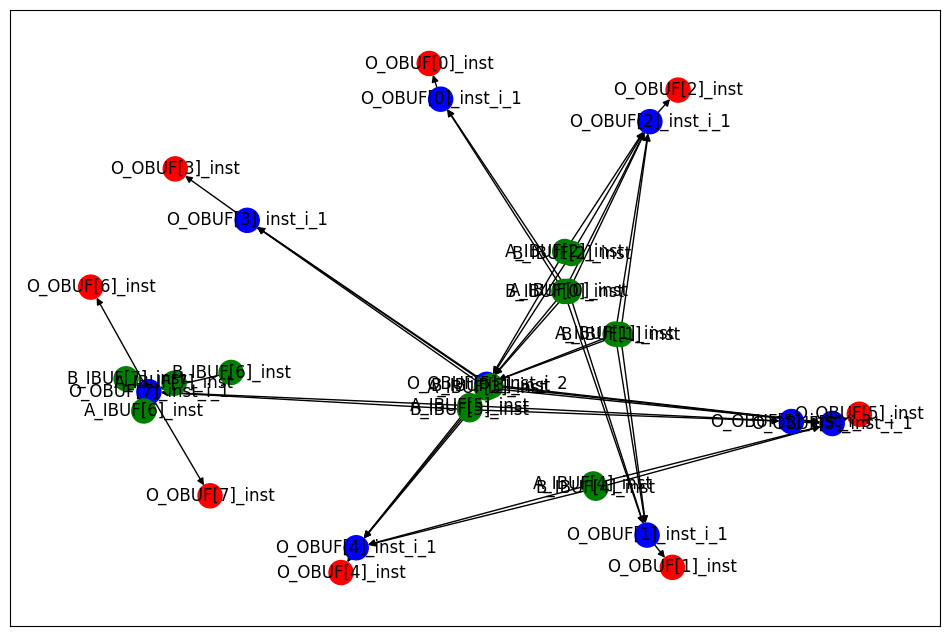

Archivo CSV generado: data/raw/add8s_83N_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output':

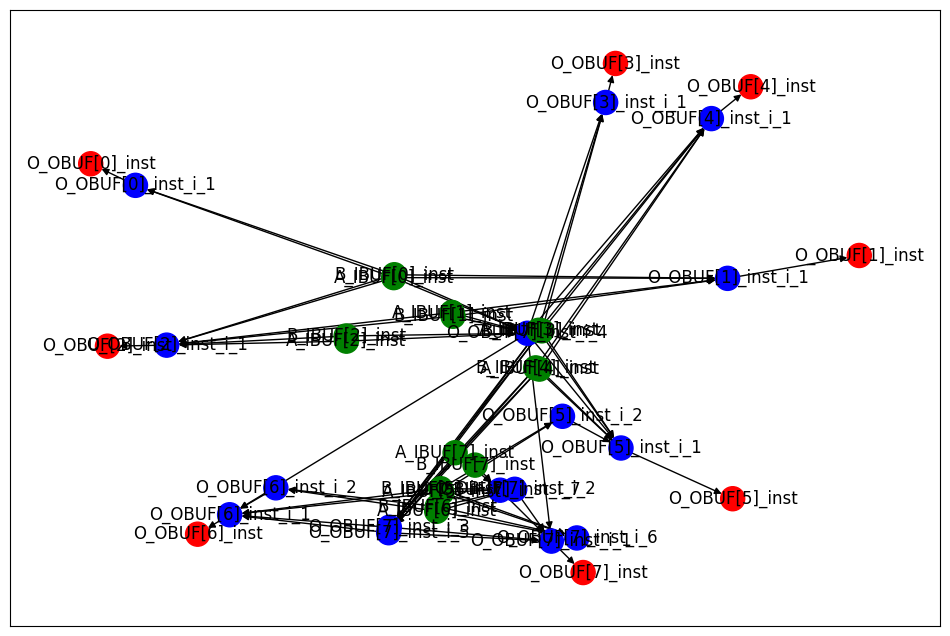

Archivo CSV generado: data/raw/add9se_0DX_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[0]_inst', 'node_input': ['B[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output'

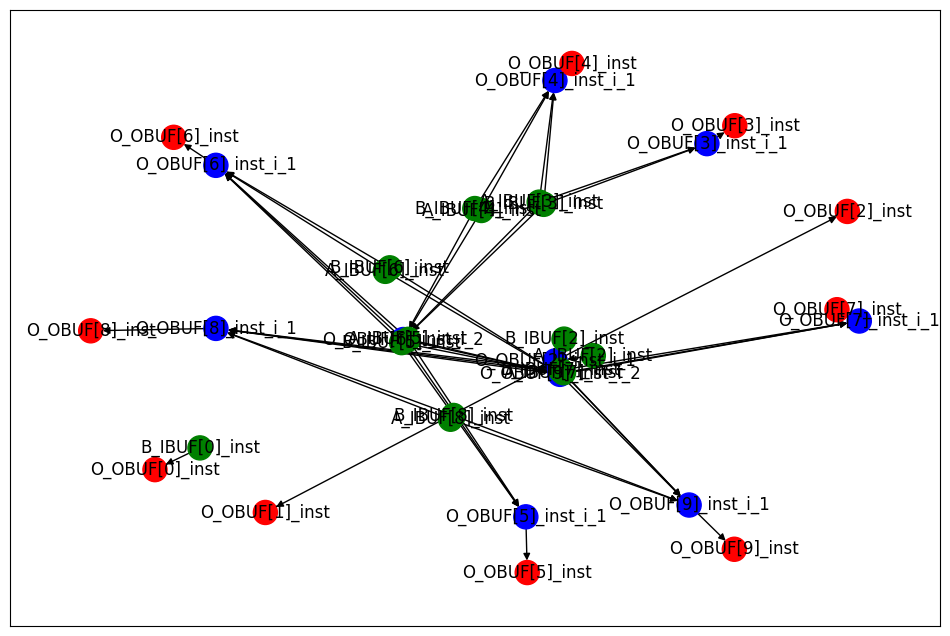

Archivo CSV generado: data/raw/add16se_2AS_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[

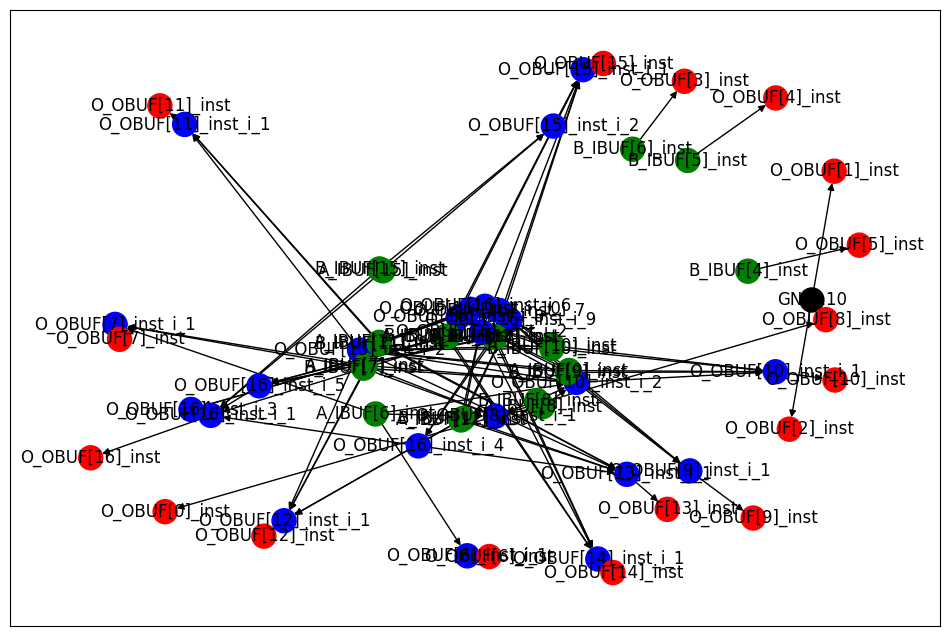

Archivo CSV generado: data/raw/add8se_8UT_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output': ['B_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['B_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output'

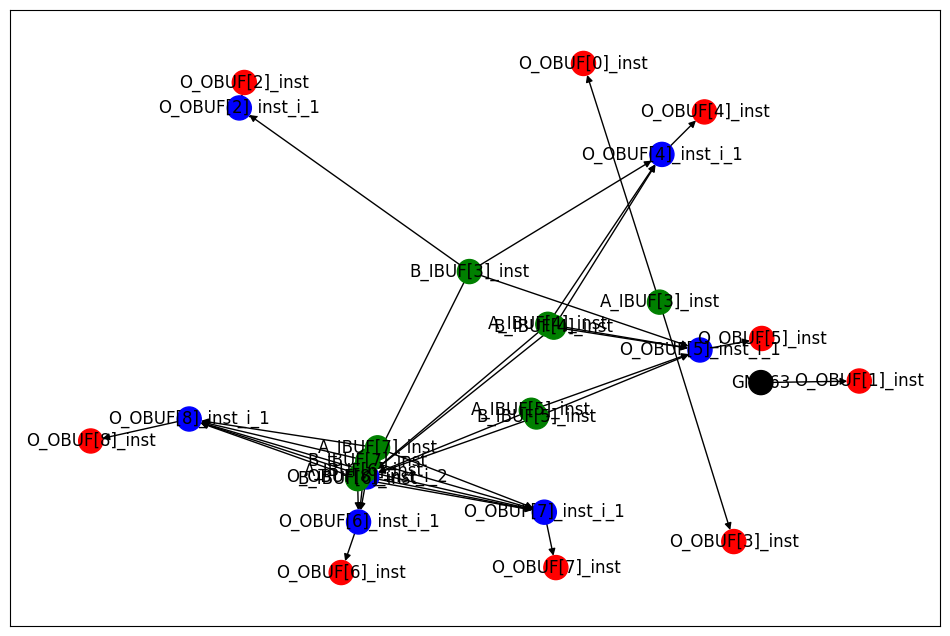

Archivo CSV generado: data/raw/add8u_5LT_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

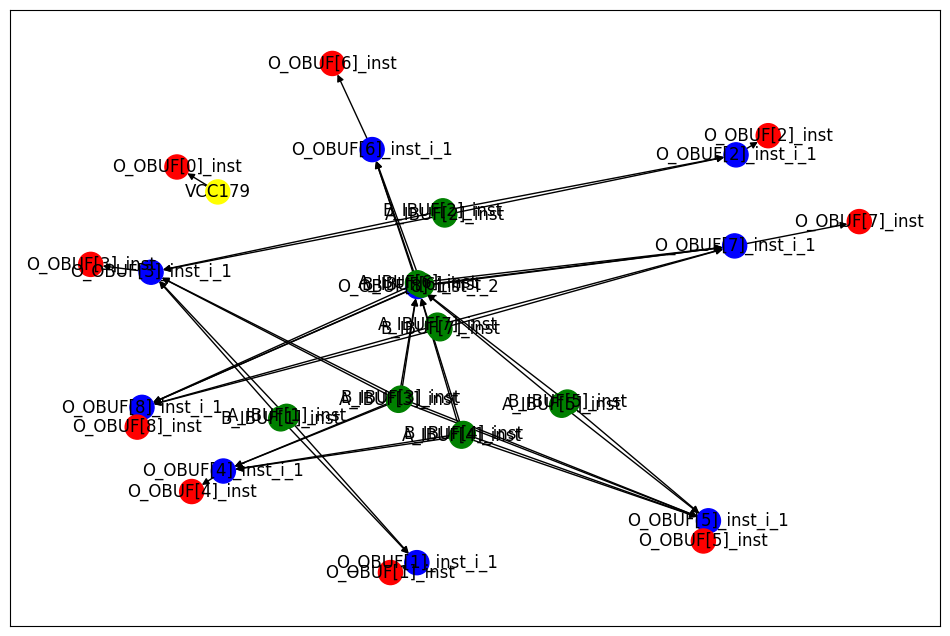

Archivo CSV generado: data/raw/add12u_4M3_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'node_output': ['O_OBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[11]_inst', 'node_input': ['B[11]'], 'node_output': ['B_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'n

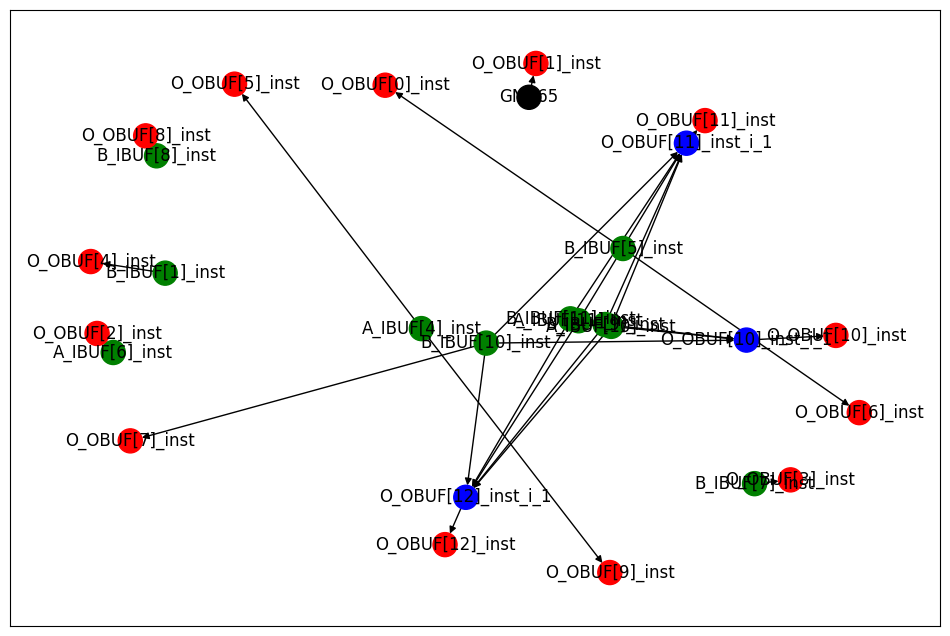

Archivo CSV generado: data/raw/add9se_0BB_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['O_OBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output': ['B_IBUF[8]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_output': ['O[0]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[1]_inst', 'node_input': ['O_OBUF[0]'], 'node_ou

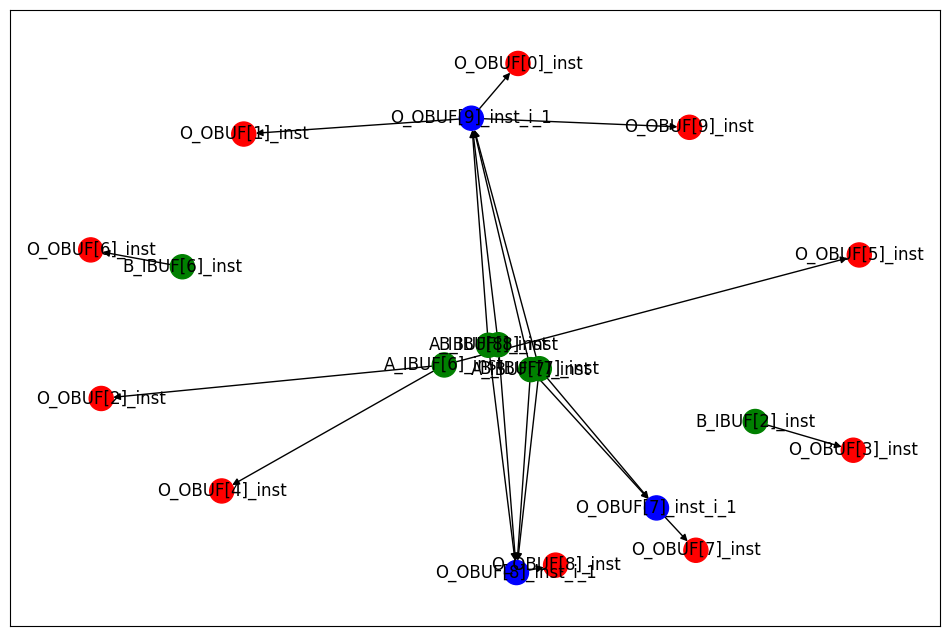

Archivo CSV generado: data/raw/add8s_6PM_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

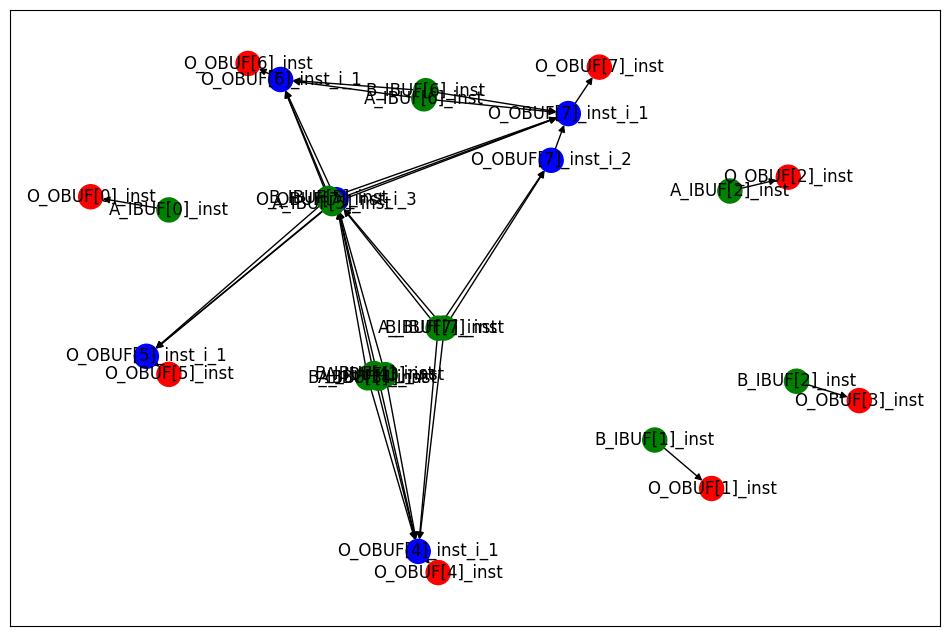

Archivo CSV generado: data/raw/add8u_5HQ_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output': ['B_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[4]_inst', 'node_input': ['B[4]'], 'node_output':

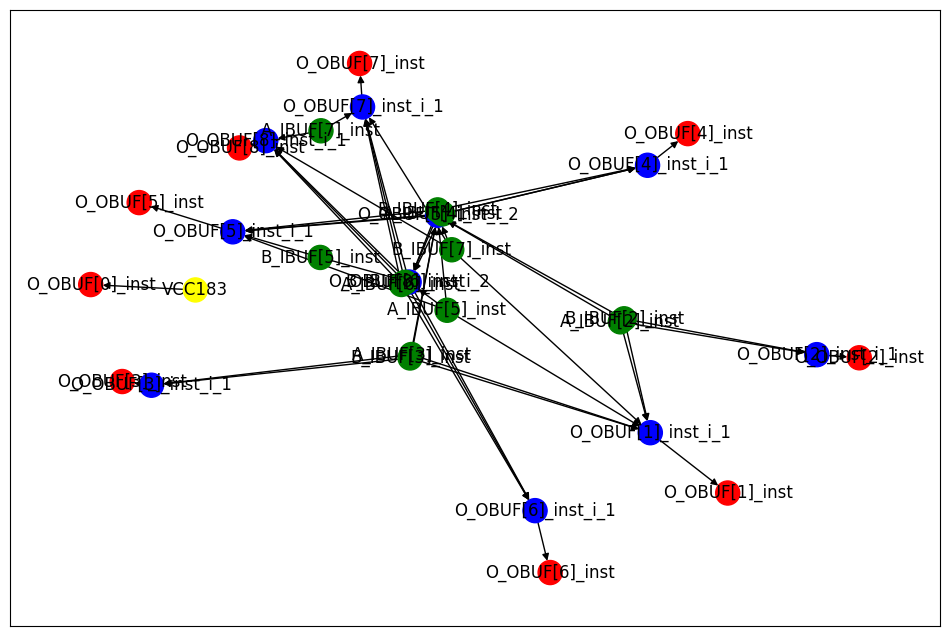

Archivo CSV generado: data/raw/add16u_073_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['O_OBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]

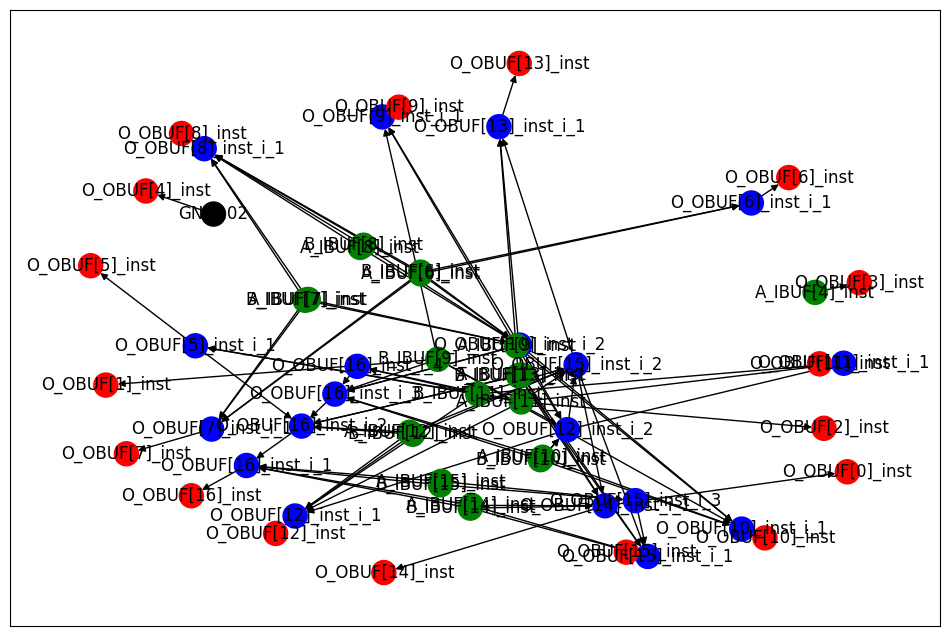

Archivo CSV generado: data/raw/add12se_5DG_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[9]_inst', 'node_input': ['A[9]'], 'node_output': ['A_IBUF[9]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[10]_inst', 'node_input': ['B[10]'], 'nod

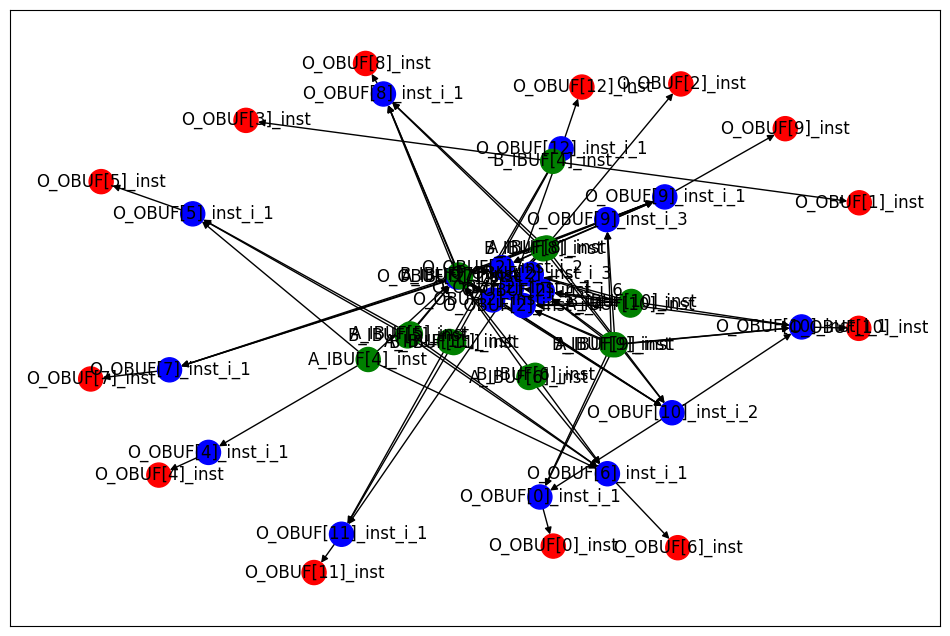

Archivo CSV generado: data/raw/add16se_2GE_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['O_OBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[

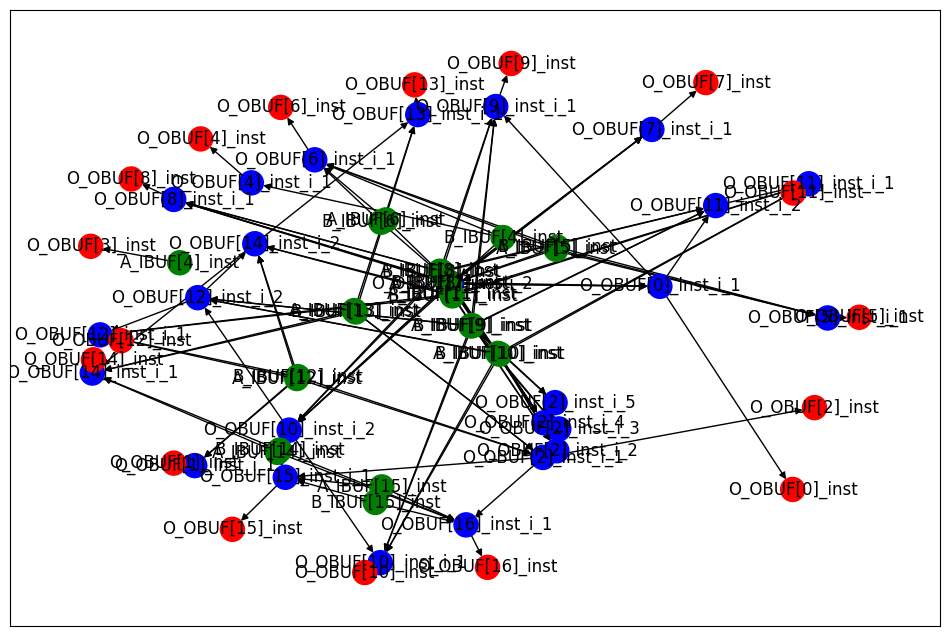

Archivo CSV generado: data/raw/add8u_01R_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['O_OBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output': ['B_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[3]_inst', 'node_input': ['B[3]'], 'node_output':

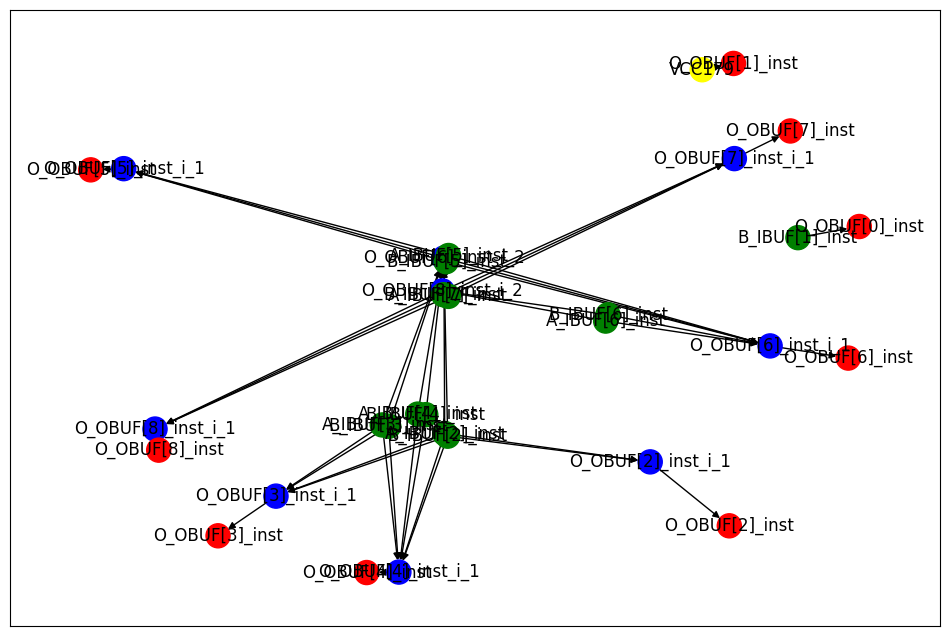

Archivo CSV generado: data/raw/add16se_259_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[

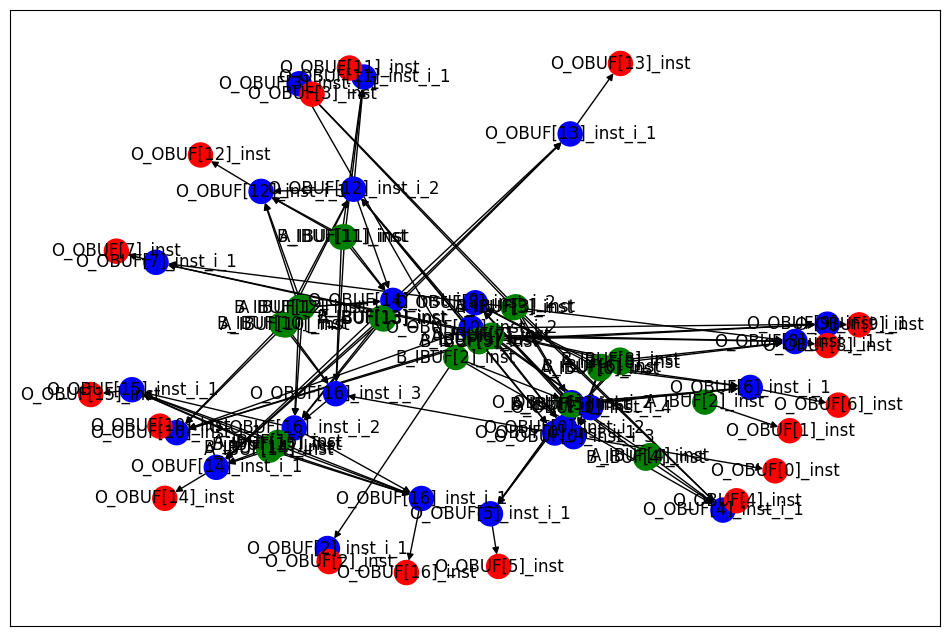

Archivo CSV generado: data/raw/add12u_1QE_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_o

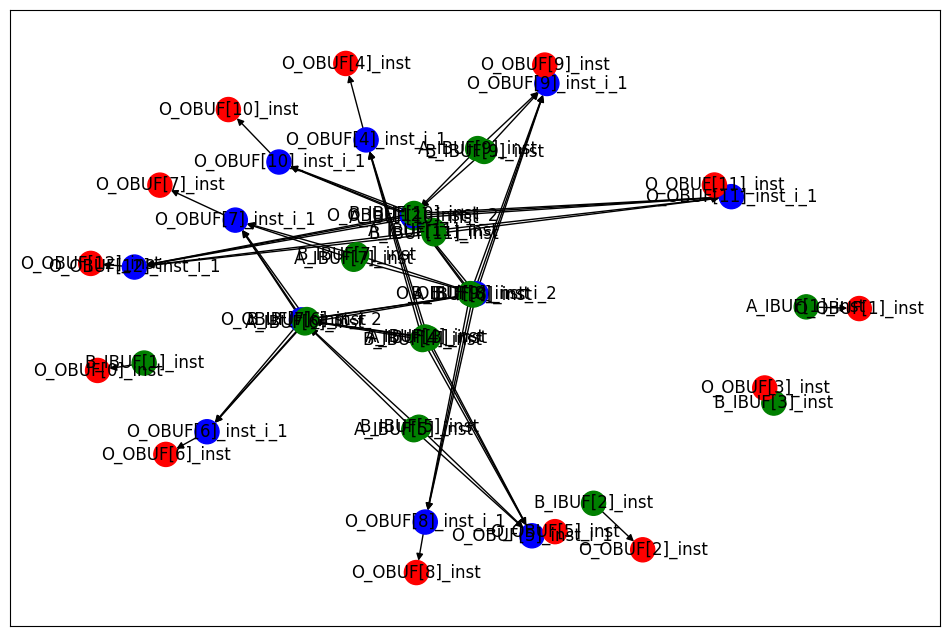

Archivo CSV generado: data/raw/add16u_05T_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7

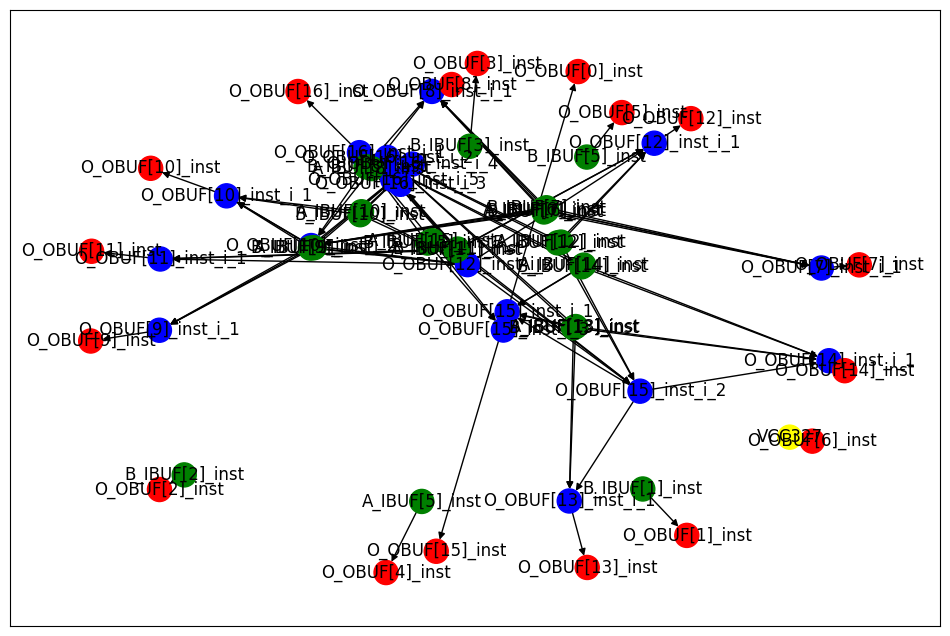

Archivo CSV generado: data/raw/add9se_079_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output'

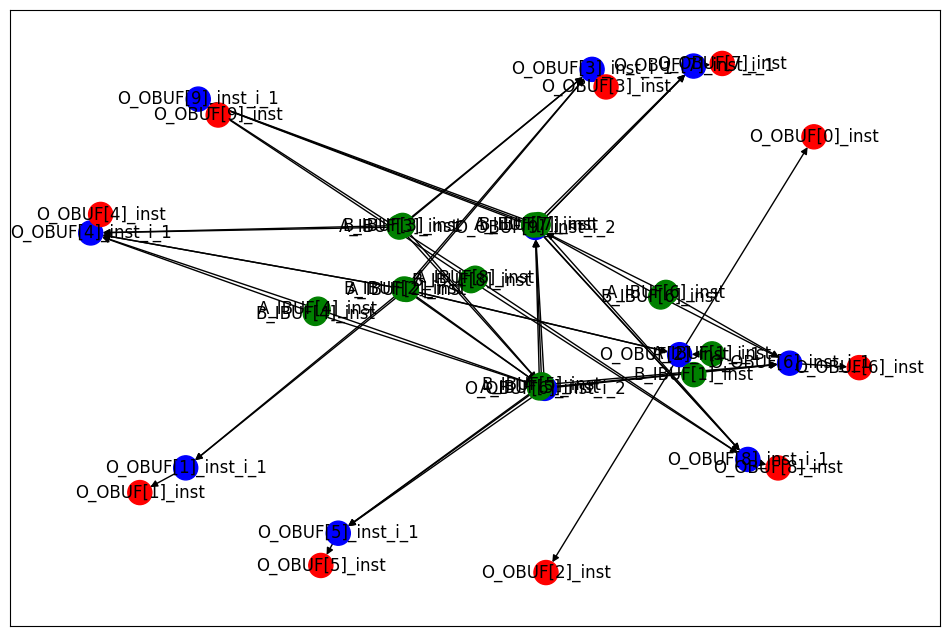

Archivo CSV generado: data/raw/add8s_6XL_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[1]_inst', 'node_input': ['B[1]'], 'node_output': ['B_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[2]_inst', 'node_input': ['B[2]'], 'node_output':

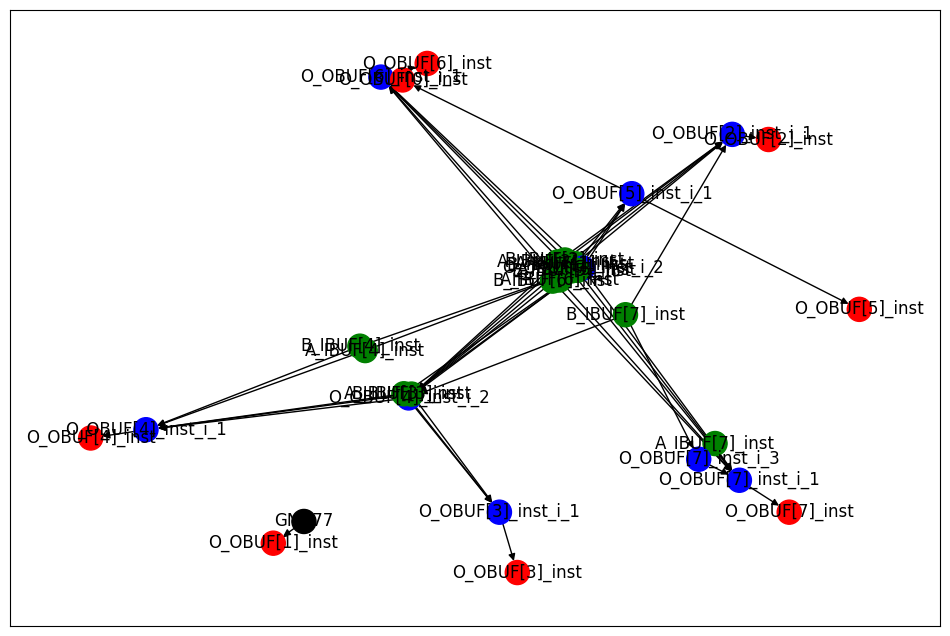

Archivo CSV generado: data/raw/add12u_4RF_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[0]_inst', 'node_input': ['A[0]'], 'node_output': ['A_IBUF[0]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[3]'], 'node_output': ['A_IBUF[3]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[4]_inst', 'node_input': ['A[4]'], 'node_output': ['A_IBUF[4]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['A_IBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_o

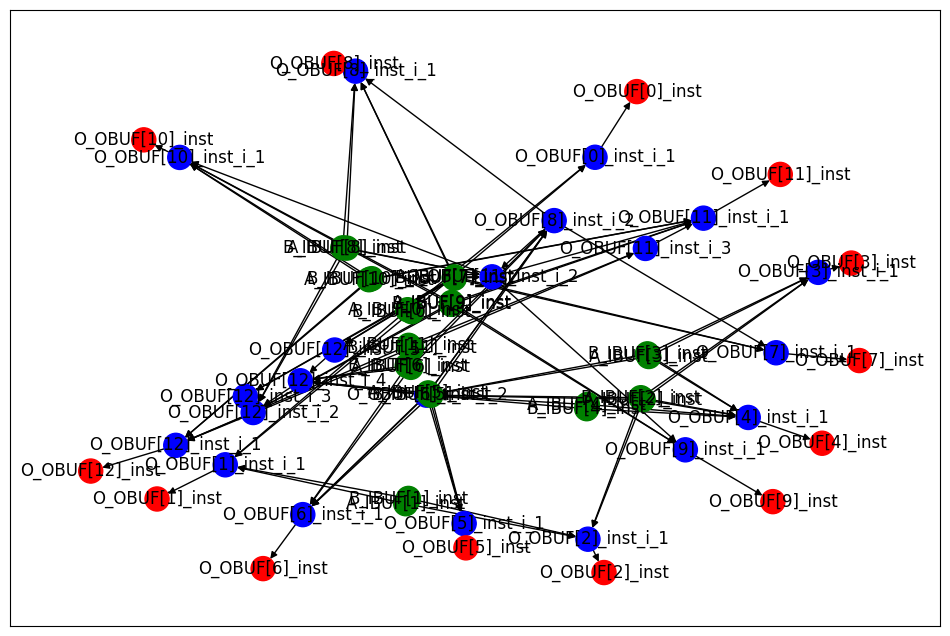

Archivo CSV generado: data/raw/add9se_07G_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[5]_inst', 'node_input': ['A[5]'], 'node_output': ['O_OBUF[5]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[6]_inst', 'node_input': ['A[6]'], 'node_output': ['A_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[7]_inst', 'node_input': ['A[7]'], 'node_output': ['A_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[8]_inst', 'node_input': ['A[8]'], 'node_output': ['A_IBUF[8]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[5]_inst', 'node_input': ['B[5]'], 'node_output': ['O_OBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[6]_inst', 'node_input': ['B[6]'], 'node_output': ['B_IBUF[6]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[7]_inst', 'node_input': ['B[7]'], 'node_output': ['B_IBUF[7]']}
{'node_type': 'IBUF', 'node_name': 'B_IBUF[8]_inst', 'node_input': ['B[8]'], 'node_output': ['B_IBUF[8]']}
{'node_type': 'OBUF', 'node_name': 'O_OBUF[0]_inst', 'node_input': ['O_OBUF[0]'], 'node_ou

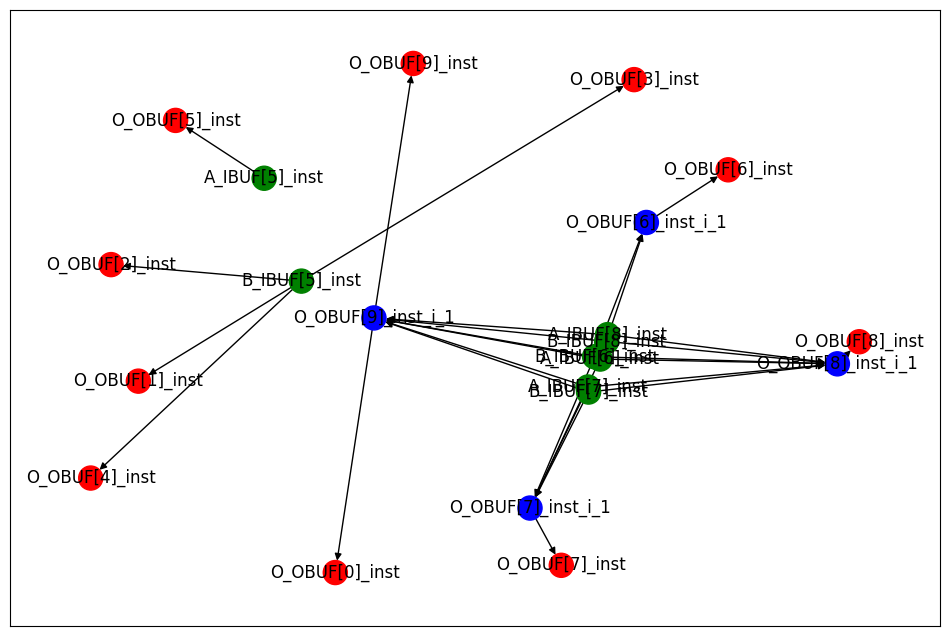

Archivo CSV generado: data/raw/add16se_2KV_netlist.csv
{'node_type': 'IBUF', 'node_name': 'A_IBUF[10]_inst', 'node_input': ['A[10]'], 'node_output': ['A_IBUF[10]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[11]_inst', 'node_input': ['A[11]'], 'node_output': ['A_IBUF[11]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[12]_inst', 'node_input': ['A[12]'], 'node_output': ['A_IBUF[12]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[13]_inst', 'node_input': ['A[13]'], 'node_output': ['A_IBUF[13]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[14]_inst', 'node_input': ['A[14]'], 'node_output': ['A_IBUF[14]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[15]_inst', 'node_input': ['A[15]'], 'node_output': ['A_IBUF[15]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[1]_inst', 'node_input': ['A[1]'], 'node_output': ['A_IBUF[1]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[2]_inst', 'node_input': ['A[2]'], 'node_output': ['A_IBUF[2]']}
{'node_type': 'IBUF', 'node_name': 'A_IBUF[3]_inst', 'node_input': ['A[

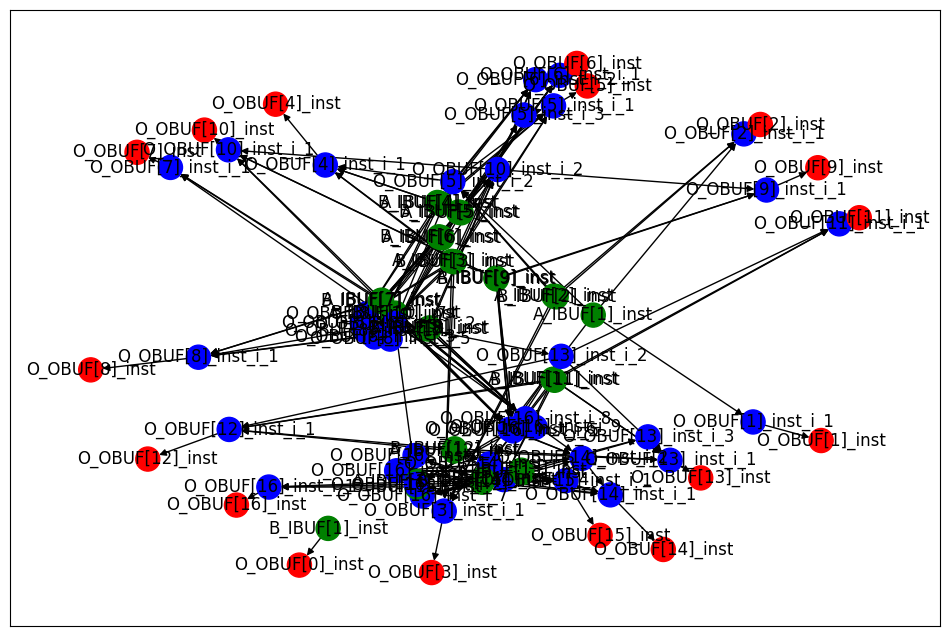

In [ ]:
netlist_dir_path = '/content/drive/My Drive/TEC/TFG_GCNAPPROX/Graphs/all_netlists'

#leemos los grafos del drive y los generamos los datos procesados
for subdir, dirs, files in os.walk(netlist_dir_path):
    for file in files:
      if file.endswith(".v"):
        file_path = os.path.join(subdir, file)
        with open(file_path, 'r') as f:
          netlist_parser(file_path)

In [ ]:
class GraphDataset(Dataset):
  def __init__(self,root, test=False, transform=None, pre_transform=None):
    self.test = test
    super(GraphDataset, self).__init__(root, transform, pre_transform)

  @property
  def raw_file_names(self):
    return os.listdir(self.raw_dir)

  @property
  def processed_file_names(self):
    #Si estos archivos se encuentran en raw_dir, se omite su procesamiento
    processed_files = []
    for raw_file in self.raw_file_names:
      processed_file_name = os.path.basename(raw_file).replace('.csv', '.pt')
      if self.test:
        processed_file_name = f'data_test_{processed_file_name}'
      else:
        processed_file_name = f'data_{processed_file_name}'
      processed_files.append(processed_file_name)
    return processed_files

  def download(self):
    pass

  def process(self):
    for raw_path in self.raw_paths:
      data = pd.read_csv(raw_path,
                         header=0,
                         names=['source_node', 'target_node', 'source_node_type', 'target_node_type'])
      graph_obj = self._create_graph_object(data)
      torch.save(graph_obj, os.path.join(self.processed_dir, os.path.basename(raw_path).replace('.csv', '.pt')))

  def _create_graph_object(self,data):
    G = nx.DiGraph()
    seen_target_nodes = []
    seen_nodes = []
    node_mapping = {}
    next_node_id = 0
    for _, row in data.iterrows():
      source_node, target_node, source_node_type, target_node_type = row[0], row[1], row[2], row[3]

      if source_node not in node_mapping:
        node_mapping[source_node] = next_node_id
        G.add_node(next_node_id, node_type=source_node_type)
        next_node_id += 1
      if target_node not in node_mapping:
        node_mapping[target_node] = next_node_id
        G.add_node(next_node_id, node_type=target_node_type)
        next_node_id += 1

    for _, row in data.iterrows():
        source_node, target_node = row['source_node'], row['target_node']
        source_index = node_mapping[source_node]
        target_index = node_mapping[target_node]
        G.add_edge(source_index, target_index)

    # print(G.edges())
    label = self._get_labels(G)
    node_feats = self._get_node_features(G)
    edge_index = self._get_adjacency_info(G)
    label = self._get_labels(G)
    graph_obj = Data(x=node_feats, edge_index=edge_index, y=label)
    return graph_obj

  def _get_embeddings(self, G):
    node_list = sorted(G.nodes())
    emb = Node2Vec(walk_length=10, walk_number=10,window_size=20, dimensions=20, p=1.0, q=0.5)
    emb.fit(G)
    embeddings = emb.get_embedding()
    ordered_embeddings = embeddings[[node_list.index(i) for i in range(len(G.nodes()))]]
    return embeddings

  def _get_node_features(self, G):
    degrees = np.array([val for (node, val) in G.degree()])
    print(degrees)
    closeness = np.array([nx.closeness_centrality(G, u=node) for node in G.nodes()])
    embeddings = self._get_embeddings(G)
    node_feats = np.column_stack((degrees,closeness,embeddings))
    # node_feats = torch.tensor(degrees, dtype=torch.float).view(-1,1)
    return torch.tensor(node_feats, dtype=torch.float)
    # return node_feats

  def _get_adjacency_info(self, G):
    node_mapping = {node: i for i, node in enumerate(G.nodes())}
    edge_index = torch.tensor([(node_mapping[source], node_mapping[target]) for source, target in G.edges()],dtype=torch.long).t().contiguous()
    return edge_index

  def _get_labels(self, G):
      label_dict = {'IBUF': 0, 'OBUF': 1, 'LUT': 2, 'GND': 3, 'VCC': 4}
      labels = []
      for node, attrs in G.nodes(data=True):
          node_type = attrs.get('node_type')
          label = label_dict.get(node_type, -1)
          labels.append(label)
      return torch.tensor(labels, dtype=torch.long)

  def len(self):
    return len(self.processed_file_names)

  def get(self, idx):
    file_name = self.processed_file_names[idx]
    if file_name.startswith("data_"):
      file_name = file_name[5:]
    data_path = os.path.join(self.processed_dir, file_name)
    data = torch.load(data_path)
    return data

In [ ]:
##Definición de la función para dividir el conjunto de datos en entrenamiento, validación y prueba
def split_dataset(dataset):
    train_list, val_list, test_list = [], [], []    #Inicialización de listas vacías para almacenar los datos de entrenamiento, validación y prueba

    #Creación de un objeto RandomLinkSplit para dividir los enlaces del grafo
    #is_undirected=True indica que el grafo es no dirigido
    transform = RandomLinkSplit(is_undirected=True, num_val=0.1, num_test=0.2)  #num_val=0.1 y num_test=0.2 establecen las proporciones para los conjuntos de validación y prueba

    #Iteración sobre cada grafo en el conjunto de datos
    for data in dataset:
        train_data, val_data, test_data = transform(data)  # Aplicación de la transformación para dividir cada grafo en subconjuntos de entrenamiento, validación y prueba

        #Agregación de los grafos divididos a las listas correspondientes
        train_list.append(train_data)
        val_list.append(val_data)
        test_list.append(test_data)

    # Retorno de las tres listas conteniendo los grafos divididos.
    return train_list, val_list, test_list


root_path = 'data/' #Ruta al directorio donde se almacenan los datos raw del grafo
dataset = GraphDataset(root=root_path)


batch_size = 32 #Tamaño del lote para el entrenamiento y la evaluación.
train_list, val_list, test_list = split_dataset(dataset)  #División del conjunto de datos en entrenamiento, validación y prueba

train_loader = torch_geometric.loader.DataLoader(train_list, batch_size=batch_size, shuffle=True)  #shuffle=True para mezclar los datos y mejorar el aprendizaje.
val_loader = DataLoader(val_list, batch_size=batch_size, shuffle=False) #shuffle=False porque el orden no afecta la validación
test_loader = DataLoader(test_list, batch_size=batch_size, shuffle=False)

Processing...


[8 1 1 1 1 1 1 1 1]
[1 4 3 4 6 7 6 6 7 6 5 5 5 3 4 6 5 3 3 3 4 6 6 2 4 3 6 5 3 3 3 2 1 1 1 1 1
 1 9 1 1 1 1]


[ 3  5  7 11  3  2  7  5  6  7  5  5  7  7  6  4  3  7  2  3  7  1  3  3
  3  2  7  6  4  2  1  1  1  1  1  1  1  1  1]


[1 1 1 1 2 7 9 2 3 4 6 7 2 3 3 1 1 1 1 2 2 3 2 3 1 1 1 1]


[1 1 3 6 7 1 3 4 4 1 1 1 1 1 3 4 3 2 2 1 1 1 1 2 1 1 3 1 1 1 1]


[ 1  1  3  6  3  5  5  4  6  7  6  6  4  5  3  7  6  7  7  4  3  2  7  7
  1  1  1  1  3  4  6 10  3  2  6  6  5  5  4  6  7  5  4  3  4  3  5  4
  5  4  2  1  1  3  2  6  5  4  1  1  1  1  1  1  1  1 12  1  1  1  1  1]


[2 3 7 2 3 4 5 7 9 3 2 3 4 6 6 2 2 2 4 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[3 6 7 6 2 3 1 1 3 4 6 9 3 2 4 7 4 6 8 3 5 8 3 3 4 6 3 7 4 4 3 2 2 1 1 3 2
 4 3 5 3 4 1 1 1 1 1 1 1 1 1 1]


[ 3  3  7  7  2  6  6  1  1  5  3  3  5  7  8  3  4 11  6  2  6  5  6  6
  4  6  7  5  4  7  3  3  2  5  3  4  2  6  5  4  1  1  1  1  1  1  1  1
  1  1  1  1]


[3 4 6 8 3 2 3 4 6 9 2 5 4 6 7 3 5 4 3 2 3 7 3 2 3 2 5 4 2 1 1 1 1 1 1 1 1
 1 1]


[ 4  3  5  7 10  3  2  4  4  6  9  7  3  5  4  6  7  6  6  4  3  3  7  7
  2  3  4  3  2  4  3  5  4  3  2  1  1  1  1  1  1  1  1  1  1]


[4 3 5 7 9 3 2 3 4 6 7 2 2 4 4 1 1 4 3 2 3 2 2 1 1 1 1 1 1 1 1 1]


[ 3  6  8  7  4  4  6  8  3  6  4  4  6  7  3  6  2  3  1  1  3  5  7 10
  3  2  4  8  7  4  6  4  1  5  3  3  4  1  1  3  4  3  4  3  2  3  3  2
  4  3  5  1  1  1  1  1  1  1  1  1  1  1  1  2  1  1]


[3 4 6 6 2 1 1 3 4 6 8 3 2 3 4 6 8 2 3 8 4 6 2 3 2 1 1 1 1 1 1 3 2 3 2 3 2
 1 1 1 1 1 1 1 1 1]


[1 3 1 3 4 3 5 7 9 3 2 3 4 6 6 2 1 1 4 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[1 1 3 2 5 5 2 3 1 1 1 2 1 1 1 1 1]


[1 1 1 1 5 1 1 4 6 7 2 2 4 4 1 1 3 3 2 2 1 1 1 1]


[ 1  3  3  5  7 11  2  5  4  6  7  6  6  4  4  3  7  5  5  3  3  4  3  1
  3  2  5  4  4  3  4  1  1  1  1  1  1  1  7  1]


[1 1 1 1 1 1 2 1 1 1 1 1 1 2 1 1]


[1 1 2 1 1 4 3 6 7 8 3 2 2 4 4 1 1 4 3 2 2 1 1 1 1 1 1]


[3 7 3 9 3 3 3 4 6 8 4 3 4 6 6 2 3 3 3 2 3 4 1 1 1 1 1 1 1 1 1 1]


[2 1 1 1 1 2 7 5 2 2 2 1 1 1 1 1 1]


[ 1  3  4  3  7  7  6  2  7  7  3  4  6  6  3  5  9  3  5  6  4  3  4  4
  6  7  7  3  6  6  6  4  6  6  6  5  5  7  3  1  4  2  1  1  3  5  4  4
  3  6  5  5  1  7  1  1 10  1  1  1  1  1  1  1  1  1]


[ 4  6  3  5  5  2  4  4  4  2  4  6 10  3  2  6  7  5  5  4  6  7  5  5
  4  3  4  2  2  1  1  3  2  6  5  5  1  1  1  1  9  1  1  1  1  1  1  1]


[1 1 4 6 7 3 5 2 3 7 4 2 4 6 9 3 2 5 5 5 4 6 8 4 5 5 3 4 6 7 4 3 4 4 4 2 1
 1 3 2 5 4 5 4 4 1 1 1 9 1 1 1 1 1 1 1 1]


[1 4 4 3 5 7 9 3 2 3 4 6 6 2 1 3 2 4 3 2 3 2 1 1 1 1 1 1 1 1 1]


[ 4  6  8  5  5  5  4  6  7  3  5  4  3  4  6  7  4  5  4  3  2  3  7  2
  1  1  3 10  5  7  3  2  5  5  4  5  4  4  4  2  1  1  1  1  1  1  3  3
  2  5  1  1  1  9  1  1  1  1  1  1  1  1  1  1]


[4 3 5 7 8 3 2 3 5 6 6 3 3 1 3 2 3 3 1 1 1 1 1 1 1 1 1 1]


[4 3 5 7 5 3 2 6 1 3 4 6 7 2 2 4 6 4 4 3 2 1 3 2 2 1 1 1 1 1 1 1 1 1]


[ 3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  4  4  3  4  6
  7  3  6  6  7  6  5  5  5  4  3  6  5  5  4  3  5  7  5  5  4  6  4  4
  4  3  5  4  4  4  2  1  1  3  6  5  4  4  5  4  4  1  1  1  1  1  1  6
  1  6  1  1  8  1  1  1  1 12  1  1  1  1]


[2 3 5 1 2 3 5 2 5 2 5 4 5 7 7 3 2 2 1 2 2 2 4 3 2 1 1 1 1 1 1 1 1 1]


[1 1 5 3 5 7 9 9 4 3 4 5 7 7 8 3 3 5 7 6 2 5 4 3 4 3 3 2 1 1 1 1 1 1 1 1]


[3 5 7 6 3 1 1 1 6 1 3 5 7 9 9 4 3 4 7 8 5 7 3 3 2 1 1 5 4 3 4 3 1 1 1 1 1
 1 1 1 1 1]


[4 6 9 7 5 6 4 6 7 7 5 6 5 4 3 6 6 5 4 8 2 4 4 3 5 7 9 3 2 3 8 4 6 5 7 6 5
 4 6 4 5 4 4 6 5 4 4 2 1 1 3 3 2 3 5 4 5 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[ 2  7 10  3  1  5  6  5  8  5  7  6  3  2  6  6  1  1  2  2  5  5  3  2
  1  1  1  1  1  2  1  1]


[3 4 7 6 2 1 1 2 1 1 1 1 3 2 1 1 1 1 4 1 1 1 1 1 1 1 1 1]


[2 1 1 3 4 6 6 3 3 1 1 1 1 1 1 1 3 2 1 1 1]


[2 3 5 2 5 5 2 1 1 5 1 1 3 4 3 5 7 8 3 2 2 4 6 1 2 2 2 1 1 1 1 4 3 2 2 1 2
 1 1 1 1 1 1 1 1 1 1 1 1 1]


[3 6 8 6 4 4 6 7 3 7 3 4 6 3 6 6 2 3 4 6 9 3 2 4 7 4 6 8 3 5 8 3 3 4 6 3 7
 4 4 1 1 3 4 3 3 3 2 1 1 1 1 3 2 4 3 5 3 4 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[2 6 7 2 4 4 1 3 4 9 3 5 7 4 1 2 3 4 2 2 1 4 4 1 2 3 3 1 1 1 1 1 1 1 1 1 1
 1]


[2 3 5 2 5 1 4 3 5 7 9 3 2 3 4 6 6 2 2 2 1 4 3 2 3 2 1 1 1 1 1 1 1 1 1]


[3 6 7 7 2 3 2 1 1 1 1 3 4 6 9 2 4 8 7 4 6 3 5 3 3 4 3 2 1 1 1 1 3 3 2 4 3
 5 1 1 1 1 1 1 1 1]


[2 1 1 1 1 1 4 1 5 1 1 1 1 1 1 1 2 1 1 1 1]


[3 4 6 8 2 3 5 6 8 3 3 3 4 6 6 2 1 1 1 1 1 1 4 1 2 3 3 4 1 2 1 1 1 1 3 1 1
 1 1 1 1 1 1 1 1 1]


[4 3 5 7 8 3 2 2 4 6 1 3 5 7 8 3 2 2 4 4 4 3 2 2 1 3 3 2 2 1 1 1 1 1 1 1 1
 1 1 1]


[3 3 5 8 2 2 3 3 4 6 8 2 3 4 6 8 2 3 4 6 6 2 2 2 2 3 2 3 2 3 2 1 1 1 1 1 1
 1 1 1 1]


[ 4  3  5  7 11  3  2  5  4  6  7  6  6  4  4  3  7  5  5  3  3  1  3  4
  3  2  5  4  4  3  1  1  1  1  1  1  1  1  7  1]


[4 3 5 7 5 3 2 7 4 5 7 9 3 2 3 4 6 7 2 2 4 4 4 3 2 4 3 2 3 3 2 1 1 1 1 1 1
 1 1 1 1]


[ 3  3  5  7  3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  4
  4  4  7  8  3  6  6  7  6  5  5  5  4  3  6  5  5  4  3  5  7  5  5  4
  6  4  4  4  3  3  5  4  4  4  2  4  3  6  5  4  4  5  4  4  1  1  1  1
  1  6  1  6  1  1  8  1  1  1  1  1 12  1  1  1  1]


[ 3  6  8  7  6  4  6  8  3  1  4  3  7  4  4  7  7  3  6  2  3  1  1  4
 10  3  5  7  3  2  4  4  3  5  3  4  3  2  4  3  2  5  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1]


[3 5 7 9 2 3 4 6 8 2 4 4 6 6 1 2 1 1 1 1 1 1 3 3 2 5 1 1 2 3 2 1 1 1 1 1 1
 3 1 1 1 1 1 1 1 1 1]


[4 5 7 8 8 3 4 5 7 7 8 3 3 5 7 6 2 1 1 5 3 5 7 9 9 4 3 4 5 7 8 8 3 4 8 8 5
 7 3 4 3 4 3 3 2 5 4 3 4 3 4 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1]


[ 1  1  5  3  3  5  7 10  3  2  5  4  6  7  5  3  4  3  2  3  7  5  3  2
  5  4  2  1  1  1  1  1  1  1  1]


[ 3  6  8  7  5  4  6  8  3  3  3  7  4  4  6  8  3  6  2  3  1  1  3 10
  5  7  3  2  4  4  3  5  3  4  3  2  1  1  1  1  1  1  1  1  3  3  2  4
  1  1  1  1  1  1  1  1  1  1  1  1  1]


[2 1 1 3 4 6 8 2 3 4 6 6 2 4 2 3 2 3 2 1 1 1 1 1 1 1 1]


[ 1  1  2  7 10  6  6  8  6  6  4  4  3  8  5  5  3  3  3  3  2  6  4  4
  3  3  1  1  1  1  1  1  7  1]


[ 2  3  5  3  6  8  6  4  4  6  7  3  7  3  4  6  3  6  6  2  1  4  3  5
  7 10  3  2  4  7  4  6  8  3  5  8  3  3  4  6  3  7  4  4  2  3  4  3
  3  3  2  1  4  3  2  4  3  5  3  4  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1]


[2 1 1 1 3 3 1 1 1 2 1 1 1 1]


[3 4 6 8 2 3 4 6 8 2 3 4 6 6 2 1 1 5 1 3 5 8 9 3 2 3 8 4 7 2 3 2 3 2 3 2 1
 1 4 3 2 3 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[3 3 7 9 2 2 3 4 6 8 2 3 4 6 8 2 1 3 3 2 2 3 2 3 2 1 1 1 1 1 1 1 1 1]


[2 1 4 3 5 8 7 2 3 1 3 2 3 1 1 1 1 1 1 1 1]


[1 1 1 4 4 3 5 8 8 3 2 2 4 4 1 4 3 2 2 1 1 1 1 1 1 1 1]


[1 1 1 1 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1]


[1 1 4 3 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 1 4 3 2 3 2 3 2 1 1 1 1 1 1 1 1]


[1 3 1 3 1 3 2 3 5 3 5 5 2 1 1 1 2 3 2 1 1 1 1 1 1 1 2 1 1]


[1 1 1 1 3 5 8 8 2 3 1 1 3 2 3 1 1 1 1 1]


[3 4 6 8 2 3 4 6 8 2 3 4 6 6 2 1 1 3 8 4 6 3 3 3 3 2 4 1 2 3 2 2 1 1 2 1 1
 4 1 3 1 1 1 1 1 1 1 1 1 1]


[3 4 6 6 2 1 1 1 1 1 1 3 4 6 8 2 3 8 4 6 2 3 2 1 1 2 1 1 3 3 2 3 2 1 1 1 1
 1 1 1]


[2 3 3 3 4 6 8 2 3 4 6 8 2 3 4 6 6 2 1 4 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1]


[1 1 2 1 1 4 4 6 7 6 4 3 2 3 4 1 1 1 1 4 3 2 1 1 1 1]


[1 1 1 3 4 3 5 7 8 3 2 2 4 4 1 4 3 2 2 1 1 1 1 1 1 2 1 1]


[4 4 6 8 8 4 3 4 5 7 7 8 3 3 5 7 6 2 1 1 4 3 4 3 3 2 1 1 1 1 1 1 1 1 1]


[4 3 5 7 9 3 2 3 4 6 7 3 5 1 4 3 2 3 3 1 1 1 1 1 1 1 2 1 1]


[1 1 4 3 5 8 9 3 2 3 4 6 6 2 2 1 1 4 3 2 3 2 1 1 1 1 1 1 1]


[1 1 1 1 3 4 6 9 2 4 4 6 6 7 4 3 2 1 1 3 4 1 3 1 4 4 1 1 1 1 1 1 1 1 1 1 1
 1 1 1]


[3 7 6 8 6 7 7 7 4 5 4 3 3 4 7 3 6 4 4 1 1 1 1 1 1 1 1 1 1]


[ 3  4  6 10  3  3  7  7  2  6  6  3  2  5  4  6  7  6  6  4  4  5  5  3
  7  4  3  3  5  6  6  4  6  7  4  4  7  3  3  2  3  2  5  4  4  4  5  4
  4  1  1  1  1  1 12  1  1  1  1  1  1  1  1  1]


[2 6 7 2 4 4 1 1 3 8 5 6 3 2 3 5 2 2 1 1 1 1 3 2 4 1 1 1 1 1 1 1 1 1 1 1]


[1 1 4 3 3 5 6 3 1 4 3 1 1 1 1 1 1 1 1]


[2 7 9 2 2 3 4 7 8 2 3 4 6 7 2 3 3 2 2 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[ 4  3  5  7  9  3  6  8  7  5  4  6  8  3  3  3  7  4  4  6  7  3  6  2
  3  3  2  3  4  6  4  2  6  1  4 10  3  5  7  3  2  4  4  4  3  5  3  4
  3  2  3  2  3  2  1  4  3  2  4  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1]


[2 6 8 2 3 4 6 8 2 3 5 6 7 2 1 3 2 2 3 2 3 2 3 1 1 1 1 1 1 1 1 1]


[1 3 2 3 5 5 5 7 8 8 5 6 4 4 4 6 6 6 3 2 7 7 1 2 5 5 4 4 3 2 1 1 1 1 1 1 1
 1 1]


[3 3 4 6 3 4 3 5 7 9 3 2 3 4 6 6 2 2 1 4 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[1 1 1 1 4 3 5 7 8 3 4 6 8 3 6 3 6 6 2 1 1 4 3 4 3 3 2 1 1 1 1 1 1 1]


[3 5 7 6 2 5 3 5 7 9 9 4 3 4 5 7 8 8 3 4 5 7 8 8 3 4 7 8 5 7 3 3 2 5 4 3 4
 3 4 3 4 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[1 1 1 1 3 5 6 6 2 2 1 1 4 2 3 2 1 1 1 1 1]


[5 3 5 7 9 9 4 3 4 5 7 7 8 3 3 5 7 7 2 5 4 3 4 3 3 2 1 1 1 1 1 1 1 1 1]


[4 4 6 6 1 2 1 1 4 9 3 5 7 3 2 3 2 1 1 1 1 4 3 2 1 1 1 1 1 1 3 1 1 1]


[4 6 7 3 5 2 3 7 1 1 3 4 6 9 3 2 5 5 5 4 6 8 4 5 5 3 4 6 7 4 3 4 4 4 2 1 1
 3 2 5 4 5 4 4 1 1 1 1 1 9 1 1 1 1 1 1 1]


[1 3 1 3 1 3 4 3 5 7 7 3 2 1 1 1 1 1 4 3 2 1 1 1 1 1 1 1 1 1]


[2 1 1 3 4 6 8 2 3 4 6 6 2 4 2 3 2 3 2 1 1 1 1 1 1 1 1]


[2 1 1 4 3 5 7 7 3 2 1 4 1 1 1 4 3 2 1 1 1 1 1 1 1 1]


[ 3  3  5  7  3  6  8  6  4  4  6  7  3  7  3  4  6  3  6  6  2  2  4  5
  7 10  3  2  4  7  4  6  8  3  5  8  3  3  4  6  3  7  4  4  3  3  4  3
  3  3  2  2  4  3  2  4  3  5  3  4  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1]


[ 2  7 10  4  4  4  4  3  1  3  6  1  3  3  5  3  2  4  1  1  1  5  3  1
  1  1  1  1  1  1  1  1  1  1  1]


[ 2  3  5  3  6  7  7  2  3  1  1  3  2  3  5  4  5  7 10  3  2  4  8  7
  4  6  3  5  3  3  4  2  3  2  1  1  2  4  3  2  4  3  5  1  1  1  1  1
  1  1  1  1  1  1  1  1]


[ 4  3  5  7 11  3  2  7  4  6  7  5  5  7  7  6  4  3  7  2  3  7  1  3
  4  3  2  7  6  4  2  1  1  1  1  1  1  1  1  1]


[2 1 1 3 5 7 9 5 6 7 3 3 7 3 4 6 2 6 4 3 5 3 3 2 4 1 1 1 1 1 1]


[5 3 5 7 6 9 4 4 7 6 5 4 7 7 4 3 7 4 7 4 5 3 4 2 3 7 5 4 4 5 4 4 3 2 1 1 1
 1 1 1 1 1 1]


[1 4 3 4 6 8 2 3 4 6 7 2 2 5 4 4 3 2 3 2 2 1 1 1 1 1 1 1 1 1 1 1]


[ 2  3  5  2  7 10  4  4  6  8  7  3  5  4  6  7  3  3  3  7  2  3  4  5
  7  9  3  2  3  4  6  4  2  6  1  2  3  5  4  5  3  2  2  4  3  5  3  2
  4  3  2  3  2  1  2  4  3  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1]


[3 6 9 8 3 2 3 3 2 3 1 1 1 1 1 1 1 1 1 1]


[ 3  3  7  7  2  4  3  5  7 11  3  2  7  5  5  7  7  4  6  7  6  4  8  3
  5  7  8  6  4  6  4  3  3  2  4  3  2  7  6  4  5  4  2  1  1  1  1  1
  1  1  1  1  1  1  1  1]


[1 1 4 3 5 8 9 3 2 3 4 7 7 2 2 4 4 4 3 2 3 2 2 1 1 1 1 1 1 1 1 1]


[1 4 1 3 5 6 8 2 3 4 6 8 2 1 3 1 3 2 3 2 4 1 1 1 1 1 1 1 1]


[4 3 5 7 9 3 2 3 4 6 9 2 5 4 6 7 3 5 4 3 2 3 7 4 3 2 3 2 5 4 2 1 1 1 1 1 1
 1 1 1]


[1 1 3 4 6 8 3 2 3 4 6 7 2 1 1 1 1 3 2 3 2 1 1 1 1 1 1]


[2 6 7 2 4 4 1 1 1 1 1 1 1 1 3 4 1 1 2 2 1 1 1 1 1 1 1 1 3 3 1 1 1 1]


[3 4 6 9 2 3 4 6 8 3 1 3 4 7 6 2 1 1 3 8 4 6 2 3 3 1 3 3 1 3 2 1 1 3 3 2 1
 1 1 1 1 1 1 1 1 1 1 1 1]


[1 1 2 1 1 1 1 2 1 1 1 1 1 1 1 1]


[3 1 1 1 3 3 5 7 2 1 1 1 1 3 2 1 1 1 1 1]


[1 1 1 1 1 1 2 1 1 1 1 2 4 4 2 2 1 1 1 1]


[1 1 1 1 1 1 2 7 8 2 2 4 6 3 1 1 2 2 2 3 1 1 1 1 1]


[1 1 2 3 3 1 1 1 1 2 1 1 4 1 1 1 1]


[3 1 1 1 3 3 7 8 2 2 4 6 3 1 1 3 2 2 3 1 1 1 1]


[1 3 2 7 6 2 4 4 4 6 7 3 2 2 4 4 3 3 5 7 2 1 3 5 7 5 3 2 6 1 3 5 5 3 1 2 1
 1 3 2 2 3 2 1 3 3 2 1 3 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[4 5 7 8 8 3 4 5 7 8 8 3 4 5 7 6 4 2 1 1 4 4 6 8 8 3 4 6 7 8 8 3 4 8 8 5 7
 3 4 3 4 3 4 2 4 4 3 4 3 4 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[ 1  3  1  3  4  3  5  7 10  3  2  5  4  6  7  5  3  4  3  2  3  7  1  1
  4  3  2  5  4  2  1  1  1  1  1  1  1  1  1]


[2 7 8 5 6 7 6 6 4 4 3 7 5 5 3 3 3 3 1 1 1 1 2 5 4 4 3 3 1 1 1 1 1 1 7 1]


[1 1 1 1 3 4 6 8 3 2 3 4 6 6 2 1 1 3 2 3 2 1 1 1 1 1 1 1]


[ 3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  4  4  4  2  4
  6  7  3  6  6  7  6  5  5  5  4  3  6  5  5  4  3  5  7  5  5  4  6  4
  4  4  3  5  4  4  4  2  1  1  3  6  5  4  4  5  4  4  1  1  1  1  6  1
  6  1  1  8  1  1  1  1  1 12  1  1  1  1]


[ 3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  5  4  5  4  6
  7  6  6  6  5  5  3  3  6 12  2  5  7  5  5  4  6  4  4  4  3  5  4  4
  4  2  6  5  3  2  5  4  4  2  1  1  1  1  1  1  6  1  6  1  1  1  8  1
  1  1  1  1  1  1]


[1 7 2 6 6 3 1 2 3 1 1 1 1 1 1 1 1 1]


[3 4 6 8 3 3 3 3 4 6 7 2 3 4 5 1 1 1 1 1 4 1 5 1 1 4 1 2 3 1 1 1 1 1 1 1 1
 1 1 1]


[1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1]


[ 1  1  2  7 10  5  6  7  6  5  4  7  3  4  8  6  3  3  5  1  1  2  5  5
  3  3  3  1  1  1  1  1  1]


[1 1 1 1 1 1 4 4 6 7 3 2 3 3 1 1 1 4 2 2 1 1 2 1 1 1 1 1 1 1 2 1 1]


[4 3 5 7 9 2 6 7 2 4 4 3 2 3 4 6 4 2 6 1 4 9 3 5 7 3 2 3 4 4 2 2 3 2 3 2 1
 4 3 2 3 1 1 1 1 1 1 1 1 1 1 1 1 1]


[4 5 7 7 1 2 1 1 3 4 6 9 3 2 4 9 4 6 4 4 7 3 6 3 3 2 1 1 1 1 1 1 3 2 4 4 3
 1 1 1 1 1 1 1 1]


[3 4 6 6 2 2 1 1 1 1 4 1 2 1 1 2 1 1 1 1 1 1 3 1 1 1 1 1]


[ 3  6  8  8  4  4  6 10  3  6  5  6  4  6  7  4  6  2  3  3  4  6  9  3
  2  4  8  7  4  6  3  5  3  3  4  3  4  3  5  4  2  1  1  1  1  3  2  4
  3  5  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1]


[2 6 7 2 4 4 1 1 1 1 1 1 1 1 3 8 4 6 2 3 4 2 2 1 1 1 1 1 1 3 3 2 3 1 1 1 1
 1 1]


[3 6 8 6 4 4 6 7 3 7 3 4 6 3 6 6 2 1 1 3 4 6 9 3 2 4 7 4 6 8 3 5 8 3 3 4 6
 3 7 4 4 3 4 3 3 3 2 1 1 1 1 3 2 4 3 5 3 4 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[ 3  3  7  6  2  7  7  3  4  6  7  3  6  7  5  6  7  6  5  4  5  4  6  3
  3  5  6  7  4  6  7  4  4  7  3  3  2  1  1  3  6  5  4  3  5  4  4  1
  1  1  1  1 12  1  1  1  1  1  1  1  1]


[1 4 3 3 5 7 2 3 4 6 8 2 3 4 6 6 2 1 1 1 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1]


[3 4 6 8 2 3 4 6 8 2 3 4 6 6 3 3 1 3 4 3 5 7 9 3 3 3 3 9 4 6 2 3 2 3 2 3 3
 2 3 1 4 3 3 3 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[3 4 4 4 3 1 1 2 1 1 1 1 3 1 1 1 2 1 1 1 1 3 1 1 2 1 1 1 1 1 1 1]


[ 3  3  7 11  2  5  4  7  7  6  6  4  4  3  7  5  5  3  3  3  3  3  2  5
  4  4  3  3  1  1  1  1  1  1  1  7  1]


[1 1 1 1 2 1 1 3 4 6 6 2 4 2 3 2 1 1 1 1 1 1]


[1 1 1 1 4 4 4 6 5 3 6 6 2 1 1 5 2 4 3 2 1 1 1 1 1 1]


[ 4  6  7  3  5  2  3  7  1  1  2  1  1  3 10  4  6  2  6  4  3  4  4  2
  1  1  4  2  3  2  6  1  1  1  1  1  1  1  1  1  1]


[ 2  3  5  3  6  7  7  2  3  2  5  3  5  7  2  4  5  7 10  3  2  4  8  7
  4  6  3  5  3  3  4  2  3  2  2  3  2  4  3  2  4  3  5  1  1  1  1  1
  1  1  1  1  1  1  1  1]


[4 6 8 5 5 5 4 6 7 3 5 4 3 4 6 7 4 5 4 3 2 3 7 4 9 2 4 7 3 2 5 4 4 5 4 4 4
 2 1 1 1 1 1 1 3 2 5 2 1 1 1 9 1 1 1 1 1 1 1 1 1 1 1]


[1 1 1 1 1 1 3 4 6 7 2 2 4 4 1 1 4 2 3 2 2 1 1 1 1 1]


[1 3 3 5 6 8 2 3 4 6 7 2 2 4 6 4 1 3 2 3 2 2 1 1 1 1 1 1 1 1 1]


[ 2  3  5  4  5  7 10  3  2  4  4  6  8  7  3  5  4  6  7  3  3  3  7  2
  3  2  4  3  2  4  3  5  3  2  1  1  1  1  1  1  1  1  1  1]


[2 3 5 1 1 3 1 3 4 3 5 7 7 3 2 2 1 1 1 4 3 2 1 1 1 1 1 1 1 1 1 1]


[ 3  6  7  9  4  4  6  8  3  6  4  4  6  7  3  6  2  3  1  1  3  5  7 10
  3  2  4  8  7  4  7  3  5  3  3  4  3  4  3  4  4  1  2  3  3  2  4  3
  5  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1]


[1 1 1 1 1 1 3 4 6 8 2 3 4 6 7 2 2 4 4 3 3 2 3 2 2 1 1 1 1 1 1]


[4 6 8 3 5 2 3 7 1 1 1 1 1 1 3 9 4 6 2 5 3 4 4 2 3 3 2 5 3 1 1 1 1 1 1 1 1
 1 1]


[ 3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  4  4  1  3  5
  3  5  7  8  7  5  5  4  3  4  6 12  2  5  7  5  5  5  6  4  4  4  3  5
  4  4  4  2  1  5  5  4  3  2  5  4  4  1  1  1  1  6  1  6  1  1  8  1
  1  1  1  1  1  1  1  1  1]


[1 1 3 5 7 9 3 2 3 5 8 6 2 1 3 1 3 3 2 3 2 1 1 1 1 1 1 1 1 1]


[4 3 5 7 9 3 2 3 4 6 7 2 2 3 8 1 1 4 3 2 3 2 2 1 1 1 1 1 1 1 1 1 1]


[4 5 7 8 8 3 4 5 7 7 9 3 4 4 5 7 6 2 5 3 5 7 9 9 4 3 4 5 7 8 8 3 4 5 7 8 8
 3 4 8 8 5 7 3 4 3 4 3 4 2 5 4 3 4 3 4 3 4 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]


[2 8 8 3 5 1 2 3 3 1 1 1 1 1 1 1 1 1]


[1 1 1 1 1 1 2 4 4 1 1 2 2 1 1 1 1 2 1 1]


[1 1 3 5 7 8 3 2 2 4 4 1 1 1 1 4 1 5 1 1 2 2 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1
 1]


[1 1 3 4 6 8 5 1 3 2 3 4 6 7 2 2 4 4 1 1 4 2 3 3 1 2 1 1 1 1 4 1 1 1 1 1 1
 1 1 1 1 1]


[3 5 4 8 2 1 2 1 1 1 1 1 1 1 1 1 1 1]


[2 3 5 3 5 5 1 1 4 3 5 7 9 3 2 3 4 6 6 2 2 3 1 1 4 3 2 3 2 1 1 1 1 1 1 1 1
 1 1]


[ 4  3  5  7 11  3  3  7  7  2  6  6  3  2  6  5  4  6  7  6  6  5  4  5
  5  3  7  4  3  5  6  6  4  6  7  4  4  7  3  4  3  2  3  2  6  5  4  4
  5  4  4  1  1  1  1 12  1  1  1  1  1  1  1  1  1]


[2 4 5 1 4 3 5 7 8 3 4 6 7 2 2 4 3 4 2 1 1 1 1 1 1 1 1 1 1]


[5 3 3 5 7 9 3 2 3 4 6 7 2 2 4 4 1 1 5 3 2 3 2 2 1 1 1 1 1 1 1 1]


[1 3 4 3 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 4 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1]


[3 4 6 6 2 4 3 5 7 9 3 2 3 4 6 8 2 3 4 6 8 2 3 8 4 6 2 4 3 2 1 1 3 2 3 2 3
 2 3 2 1 1 1 1 1 1 1 1 1 1 1 1]


[1 3 1 1 1 3 1 5 3 3 5 5 2 1 3 1 3 2 1 1 1 1 1 1 1 1]


[ 4  3  5  7 10  3  2  4  4  6  8  7  3  5  4  6  7  3  3  3  8  2  3  4
  3  2  4  3  5  3  2  1  1  1  1  1  1  1  1  1  1]


[4 3 5 7 9 2 6 7 2 4 4 3 2 3 4 6 4 2 6 2 5 4 9 5 7 3 2 3 4 4 2 2 3 2 3 2 2
 4 3 2 3 1 1 1 1 1 1 1 1 1 1 1 1 1]


[4 4 8 6 3 2 1 1 3 4 6 8 2 3 8 4 6 2 4 2 5 1 2 3 2 3 2 1 1 1 1 1 1 1 1 1 1
 1]


[2 3 5 2 6 7 2 4 4 3 5 7 2 2 4 1 1 3 4 9 3 5 7 3 2 3 4 2 2 2 3 2 1 1 1 4 3
 2 3 1 1 1 1 1 1 1 1 1 1 1 1 1]


[ 3  3  7 11  3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2  4
  4  3  3  2  6  4  6  7  6  5  5  5  4  3  6  5  5  4  3  5  7  5  5  4
  6  4  4  4  3  3  5  4  4  4  2  3  2  6  5  4  4  5  4  4  1  1  1  1
  1  6  1  6  1  1  8  1  1  1  1  1 12  1  1  1  1]


[3 4 6 9 3 6 8 6 4 4 6 7 3 7 3 4 6 3 6 6 2 3 2 4 7 4 6 8 3 5 3 3 4 6 8 3 7
 4 8 4 6 3 6 4 4 3 4 3 3 3 2 3 2 4 3 5 3 4 3 4 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1]


[3 4 6 6 3 3 1 1 3 4 6 8 2 3 4 6 8 2 3 8 4 6 2 3 3 1 1 4 2 3 2 3 2 3 2 1 1
 1 1 1 1 1 1 1 1 1]


[ 1 11  2  3  1  2  1  1  1  1  1  1  1  1  1  1]
[3 5 6 7 2 2 5 8 1 3 2 2 4 1 1 1 1 1 1 1 1]


[3 2 2 2 2 1 1 2 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1]


[4 6 7 5 3 2 3 7 1 1 3 4 6 9 3 2 4 9 6 4 6 3 5 3 4 4 2 1 1 1 1 3 2 4 4 1 5
 1 1 1 1 1 1 1 1 1]


[1 1 3 5 7 6 2 1 1 4 4 6 8 8 4 3 4 5 7 8 8 3 4 7 8 5 7 3 3 2 1 1 4 3 4 3 4
 3 1 1 1 1 1 1 1 1 1 1 1]


[1 1 1 1 3 4 6 6 3 2 1 1 2 1 1 1 1 3 2 1 1 1]


[5 5 8 7 5 4 4 3 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 5 4 2 1 1 1 1 1 1 1 1 1]


[ 3  3  6  6  2  3  7  4  2  4  6  7  3  5  6  6  6  8  4  6  3  5  6  4
  6  7  5  3  5  7  7  3  6  7  4  4  7  3  3  2  1  3  3  5  4  6  5  6
  4  4  1  1  7  1  7 10  1  1  1  1  1  1  1  1  1  1]


[3 4 6 8 2 3 4 6 8 2 3 4 6 8 2 3 4 6 6 2 3 3 2 3 2 3 2 3 2 1 1 1 1 1 1 1 1
 1 1 1]


[3 4 7 8 2 3 4 6 8 2 3 5 6 6 2 1 1 1 1 1 3 3 2 3 2 3 2 1 4 1 3 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1]


[3 5 7 6 2 1 1 5 2 4 6 8 8 4 3 4 5 7 8 8 3 4 7 8 5 7 3 1 1 3 2 1 1 4 3 4 3
 4 3 1 1 1 1 1 1 1 1 1 1]


[ 4  6  6  7  7  4  6  7  4  3  8  3  4  6  3  6  6  2  1  1  3  4  6 10
  2  5  6  7  7  4  6  5  6  6  6  3  3  4  4  4  3  3  2  4  2  3  2  5
  5  6  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1]


[3 6 8 6 4 4 6 7 3 7 3 4 6 3 6 6 2 1 1 3 4 6 9 2 4 7 4 6 8 3 5 3 3 8 4 6 3
 8 4 4 3 4 3 3 3 2 4 2 3 2 4 3 5 3 4 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[ 5  6  8  7  3  1  5  4  6  8  3  3  3  7  4  4  6  7  3  6  2  3  1  1
  4 10  3  5  7  3  2  4  4  4  5  3  4  3  3  1  1  1  4  3  2  4  1  1
  1  1  1  1  1  1  1  1  1  1  1  1]


[1 1 2 3 3 1 1 2 1 1 2 1 1 1 1 2 1 1]


[2 1 1 4 3 5 7 7 3 2 1 1 4 3 2 2 1 1 1 1 1 1]


[1 7 2 1 4 3 5 7 7 3 2 2 1 4 3 2 1 1 1 1 1 1 1 1]


[4 6 7 8 8 3 4 5 7 7 8 3 3 5 7 6 2 1 1 5 3 5 7 9 9 4 3 4 5 7 8 8 3 4 8 8 5
 7 3 4 3 4 3 3 2 5 4 3 4 3 4 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


[1 6 5 3 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 5 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[1 3 4 3 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 4 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1]


[4 4 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 3 1 4 3 2 3 2 3 2 1 1 1 1 1 1 1 1 1 1]


[1 3 1 1 4 3 5 7 9 3 2 3 4 6 7 2 2 4 4 1 4 3 2 3 2 2 1 1 1 1 1 1 1 1]


[ 2  3  5  3  6  7  6  2  3  2  5  4  5  7 10  3  2  4  7  4  6  8  3  5
  8  3  3  4  6  3  7  4  4  2  3  2  2  4  3  2  4  3  5  3  4  1  1  1
  1  1  1  1  1  1  1  1  1  1]


[ 3  6  8  7  4  4  6  8  3  6  4  5  6  7  3  6  2  3  1  1  4  3  5  7
 10  3  2  4  8  7  4  6  3  5  3  3  4  3  4  3  4  3  3  1  4  3  2  4
  3  5  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1]


[ 4  3  5  7 11  3  3  7  7  2  6  6  3  2  6  5  4  6  7  6  6  5  4  5
  5  3  7  4  3  5  6  6  4  6  7  4  4  7  3  4  3  2  3  2  6  5  4  4
  5  4  4  1  1  1  1 12  1  1  1  1  1  1  1  1  1]


[1 1 4 3 5 7 8 3 2 2 4 4 1 1 4 3 2 2 1 1 1 1 1 2 1 1]


[1 1 3 5 7 8 2 2 4 7 4 1 1 3 2 2 4 1 1 1 1 1 1 1]


[4 6 7 3 5 2 3 7 1 1 5 3 3 5 7 9 3 2 3 9 4 6 3 1 5 3 4 1 1 4 2 5 3 2 3 2 5
 1 1 1 1 1 1 1 1 1 1]


[ 4  3  5  7 11  3  6  8  8  5  4  6  7  6  6  4  4  3  6  6  6  4  3  2
  4  4  3  2  6  4  6  7  6  5  5  5  4  3  6  5  5  4  3  5  7  5  5  4
  6  4  4  4  4  3  5  4  4  4  2  3  2  6  5  4  4  5  4  4  1  1  1  1
  1  6  1  6  1  1  8  1  1  1  1  1 12  1  1  1  1]


[1 4 4 5 6 8 6 4 7 2 3 5 4 4 2 1 1 1 1 1 1 1 1 1 1 1]


[1 3 1 3 2 3 5 2 5 4 5 7 8 3 2 2 4 4 1 1 2 2 4 3 2 2 1 1 1 1 1 1 1 1 1]


[1 1 4 3 5 7 8 3 2 4 1 1 1 1 4 3 2 1 1 1 1 1]


[1 1 1 1 3 5 7 9 3 2 3 4 6 8 2 3 4 6 6 2 1 1 3 3 2 3 2 3 2 1 1 1 1 1 1 1]


[1 1 3 1 1 1 2 4 4 2 1 1 3 2 2 1 1 1]


[1 1 4 3 5 7 9 3 2 3 4 6 6 2 1 1 4 3 2 3 2 1 1 1 1 1 1 1 1]


[3 7 7 6 2 6 6 4 4 6 8 7 5 6 3 6 7 5 6 8 7 4 3 2 1 1 5 6 5 4 1 1 1 1 1 1 1
 1 1 1 1 1]


[ 2  3  5  4  4  6  8  8  4  6  7  5  4  6  7  5  7  3  3  3  3  7  2  3
  3  5  7  2  4  5  7 10  3  2  4  7  4  6  8  3  5  8  3  3  4  6  3  2
  4  4  5  5  3  2  3  2  4  3  2  4  3  5  3  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1]


Done!


In [ ]:
print(dataset[0])

Data(x=[76, 22], edge_index=[2, 76], y=[76])


In [ ]:
print(type(train_loader))

<class 'torch_geometric.loader.dataloader.DataLoader'>


# Visualizar los objetos dados por la clase Graphdataset

In [ ]:
# import random
# def visualize_graph_data(graph_dataset, title="Graph Data"):
#     print(f"Visualizando {title}:")
#     for i, data in enumerate(graph_dataset):
#         print(f"\nGráfico {i+1}:")
#         print(f"Número de nodos: {data.num_nodes}")
#         print(f"Número de bordes: {data.num_edges}")

#         # Seleccionar 5 nodos y aristas al azar
#         random_nodes = random.sample(range(data.num_nodes), min(5, data.num_nodes))
#         random_edges = random.sample(range(data.num_edges), min(5, data.num_edges))

#         print("Nodos aleatorios:")
#         for node in random_nodes:
#             print(f"Características del nodo {node}: {data.x[node]}")
#             print(f"Etiqueta del nodo {node}: {data.y[node]}")

#         print("Aristas aleatorias:")
#         for edge in random_edges:
#             edge_nodes = data.edge_index[:, edge]
#             print(f"Índices de los nodos de la arista {edge}: {edge_nodes}")
#             print(f"Atributos de la arista {edge}: {data.edge_attr[edge] if data.edge_attr is not None else 'N/A'}")

#         # Limitar la visualización a los primeros 3 gráficos para evitar una salida demasiado larga
#         if i == 2:
#             break

# # Asegúrate de definir total_size, train_size, val_size y batch_size antes de ejecutar este código
# total_size = len(train_dataset) + len(val_dataset) + len(test_dataset)  # Asumiendo que ya tienes los datasets definidos
# train_size = int(0.8 * total_size)  # Ejemplo: 80% para entrenamiento
# val_size = int(0.1 * total_size)  # Ejemplo: 10% para validación
# batch_size = 4  # Ejemplo: tamaño del lote

# # Visualizar los datos
# visualize_graph_data(train_dataset, "Conjunto de Entrenamiento")
# visualize_graph_data(val_dataset, "Conjunto de Validación")
# visualize_graph_data(test_dataset, "Conjunto de Prueba")
# #label_dict = {'Pi': 0, 'Po': 1, 'AIG': 2}

NameError: name 'train_dataset' is not defined

#Definir la GCN

In [ ]:
class Net(torch.nn.Module):
  #definimos la estructura de la GCN
  def __init__(self, in_channels, hidden_channels1, out_channels):
    super().__init__()
    self.conv1 = GCNConv(in_channels, hidden_channels1)
    self.conv2 = GCNConv(hidden_channels1, out_channels)
    #self.conv3 = GCNConv(hidden_channels2, out_channels)
    #self.conv4 = GCNConv(hidden_channels3, out_channels)
    # self.readout = GlobalPooling()

  #realizamos el paso de encode, es decir hacemos el message passing
  def encode(self, x, edge_index):
    x = self.conv1(x, edge_index).relu()
    return self.conv2(x, edge_index)
    #return self.conv3(x, edge_index)
    # return self.conv4(x, edge_index)

    #Despues de tener la matriz de vectores del message passing, se realiza el producto punto
	  #Entre los nodos que estemos viendo
  def decode(self, z, edge_label_index):
    return(z[edge_label_index[0]] * z[edge_label_index[1]]).sum(dim=-1)

    #Lo hacemos para todos los distintos edges
  def decode_all(self, z):
    prob_adj = z @ z.t()    #matrix multiplication in numpy
    return (prob_adj > 0).nonzero(as_tuple=False).t()

  def forward(self, x, edge_index, edge_label_index=None):
    z = self.encode(x, edge_index)

    if edge_label_index is not None:
      return self.decode(z, edge_label_index)
    else:
      return self.decode_all(z)

In [ ]:
def train():
    model.train() #Pone el modelo en modo de entrenamiento, lo que afecta a ciertos modulos como Dropout o BatchNorm
    optimizer.zero_grad() # Reinicia los gradientes del optimizador a cero para evitar acumulaciones indeseadas
    # Itera sobre cada lote de datos del train_loader
    for data in train_loader:
        #Codifica los datos del grafo (nodos y aristas) en un espacio latente
        #z es un tensor que representa las características latentes de los nodos
        z = model.encode(data.x, data.edge_index)

        #Realiza muestreo negativo para generar índices de aristas negativas
        #Permite a la red predecir si existia una conexion entre dos nodos
        neg_edge_index = negative_sampling(
            edge_index=data.edge_index, num_nodes=data.num_nodes,
            num_neg_samples=data.edge_label_index.size(1), method='sparse')

        #Concatena los indices de las aristas positivas y negativas
        #edge_label_index es un tensor que contiene los índices de todas las aristas consideradas
        edge_label_index = torch.cat(
            [data.edge_label_index, neg_edge_index],
            dim=-1)

        #Crea etiquetas para las aristas, donde las aristas positivas tienen etiqueta 1 y las negativas 0
        #edge_label es un tensor de etiquetas para las aristas
        edge_label = torch.cat([
            data.edge_label,
            data.edge_label.new_zeros(neg_edge_index.size(1))
            ], dim=0)

    #Decodifica las características latentes de los nodos para predecir las aristas
    #out es un tensor que contiene las predicciones de existencia de aristas
    out = model.decode(z, edge_label_index).view(-1)

    #Calcula la perdida comparando las predicciones con las etiquetas reales
    #loss es un tensor que representa el valor de la perdida
    loss = criterion(out, edge_label)

    #Propaga la perdida hacia atrás para calcular los gradientes
    loss.backward()

    #Actualiza los parametros del modelo basándose en los gradientes calculados
    optimizer.step()

    #Retorna el valor de la perdida
    return loss


#Funcion test

In [ ]:
@torch.no_grad()  #Decorador para desactivar el cálculo de gradientes, lo que ahorra memoria y acelera la inferencia
def test(loader, model, device):
    model.eval()  #Pone el modelo en modo de evaluacion, afectando módulos como Dropout y BatchNorm.

    # Listas para acumular las predicciones y las etiquetas verdaderas
    all_preds = []
    all_labels = []

    for data in loader:
        data = data.to(device)
        z = model.encode(data.x, data.edge_index) # Codifica los datos del grafo (nodos y aristas) en un espacio latente

        #Decodifica las características latentes para predecir la existencia de aristas y aplica la función sigmoide
        #La función sigmoide convierte las salidas en probabilidades
        out = model.decode(z, data.edge_label_index).view(-1).sigmoid()

        #Acumula las predicciones y las etiquetas verdaderas en las listas correspondientes
        #.cpu().numpy() mueve los tensores a la CPU y los convierte a arrays de NumPy para su posterior procesamiento
        all_preds.append(out.cpu().numpy())
        all_labels.append(data.edge_label.cpu().numpy())

    #Concatena todas las predicciones y etiquetas verdaderas
    all_preds = np.concatenate(all_preds, axis=0)
    all_labels = np.concatenate(all_labels, axis=0)

    #Calcula el ROC AUC score usando todas las predicciones y etiquetas verdaderas.
    #ROC AUC es una métrica de rendimiento para clasificación binaria
    roc_auc = roc_auc_score(all_labels, all_preds)

    return roc_auc

#Definimos las dimensiones del modelo
## definimos el optimizador y criterio


In [ ]:
def GCNset():
  in_channels=dataset.num_features
  model = Net(in_channels, 64, 8).to(device)#Crea una instancia del modelo Net con las dimensiones especificadas y lo mueve al dispositivo (GPU o CPU)

  #Crea un optimizador Adam que ajustara los parametros del modelo
  #'lr=0.01' especifica la tasa de aprendizaje para el optimizador
  optimizer = torch.optim.Adam(params=model.parameters(), lr=0.01)

  #Define la funcion de perdida como binary cross entropy con logits
  #Esta función de perdida es comunmente usada en problemas de clasificación binaria
  criterion = torch.nn.BCEWithLogitsLoss()

  return model, optimizer, criterion

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model, optimizer, criterion = GCNset()

'''
torch.optim.Adam: Adam es un optimizador popular que combina las ventajas de dos extensiones del descenso de gradiente estocástico: AdaGrad y RMSProp.
Es particularmente efectivo en contextos con grandes datasets o parámetros de alta dimensionalidad.

torch.nn.BCEWithLogitsLoss: Esta función de pérdida calcula la entropía cruzada binaria entre las etiquetas verdaderas y las predicciones, que se espera
sean logits (valores antes de aplicar la función sigmoide). Es adecuada para problemas de clasificación binaria y proporciona una capa sigmoide integrada para la estabilidad numérica.
'''



'\ntorch.optim.Adam: Adam es un optimizador popular que combina las ventajas de dos extensiones del descenso de gradiente estocástico: AdaGrad y RMSProp.\nEs particularmente efectivo en contextos con grandes datasets o parámetros de alta dimensionalidad.\n\ntorch.nn.BCEWithLogitsLoss: Esta función de pérdida calcula la entropía cruzada binaria entre las etiquetas verdaderas y las predicciones, que se espera\nsean logits (valores antes de aplicar la función sigmoide). Es adecuada para problemas de clasificación binaria y proporciona una capa sigmoide integrada para la estabilidad numérica.\n'

# daleee

Epoch: 001, Loss: 0.9114), Val: 0.6068,Test: 0.5988
Final Test: 0.5988
Epoch: 002, Loss: 0.7256), Val: 0.5962,Test: 0.5849
Final Test: 0.5988
Epoch: 003, Loss: 0.7050), Val: 0.5962,Test: 0.5820
Final Test: 0.5988
Epoch: 004, Loss: 0.7804), Val: 0.5982,Test: 0.5845
Final Test: 0.5988
Epoch: 005, Loss: 0.7773), Val: 0.6011,Test: 0.5875
Final Test: 0.5988
Epoch: 006, Loss: 0.7684), Val: 0.6028,Test: 0.5890
Final Test: 0.5988
Epoch: 007, Loss: 0.7224), Val: 0.5984,Test: 0.5889
Final Test: 0.5988
Epoch: 008, Loss: 0.6973), Val: 0.5990,Test: 0.5943
Final Test: 0.5988
Epoch: 009, Loss: 0.6955), Val: 0.6024,Test: 0.6013
Final Test: 0.5988
Epoch: 010, Loss: 0.6980), Val: 0.6065,Test: 0.6048
Final Test: 0.5988
Epoch: 011, Loss: 0.6962), Val: 0.6076,Test: 0.6043
Final Test: 0.6043
Epoch: 012, Loss: 0.7024), Val: 0.6079,Test: 0.6032
Final Test: 0.6032
Epoch: 013, Loss: 0.7028), Val: 0.6088,Test: 0.6036
Final Test: 0.6036
Epoch: 014, Loss: 0.7129), Val: 0.6129,Test: 0.6070
Final Test: 0.6070
Epoch:

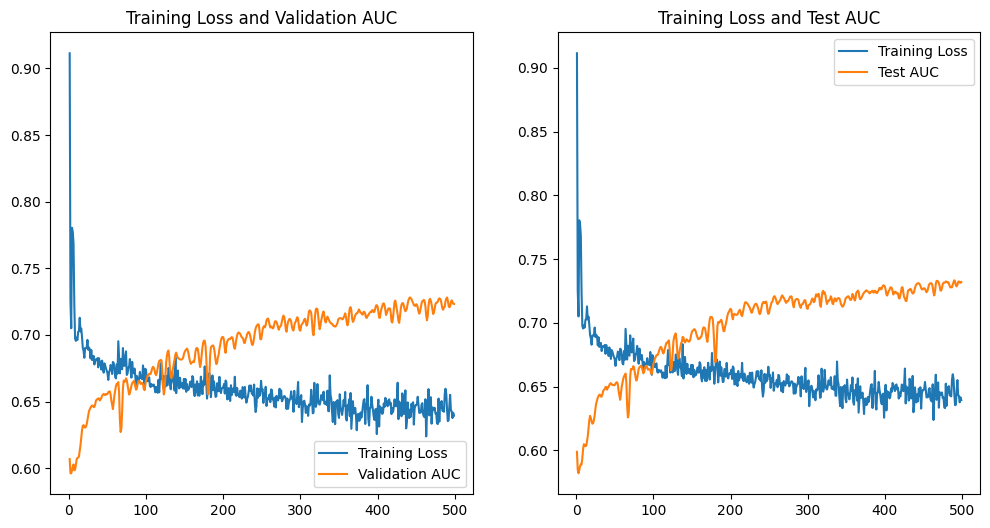

'\nloss.item(): Este método convierte un tensor de pérdida de PyTorch (que es un tensor de un solo elemento)\nen un valor de Python (float). Es útil para desacoplar el valor de pérdida del grafo de cálculo de PyTorch\ny para hacer operaciones o comparaciones en Python puro.\n'

In [ ]:
losses = []
val_aucs = []
test_aucs = []
best_val_auc = final_test_auc = 0
for epoch in range(1,500):
  epochs_range = range(1, epoch + 1)

  #Llama a la funcion de entrenamiento que realiza una epoca de entrenamiento y retorna la perdida
  #La función train no toma argumentos y retorna un tensor de perdida
  loss = train()

  #Evalua el modelo en el conjunto de validacion.
  #test toma un DataLoader, el modelo y el dispositivo, y retorna el AUC como un float
  val_auc = test(val_loader, model, device)

  #Evalua el modelo en el conjunto de prueba.
  #Similar a val_auc, test_auc es un float que representa el AUC obtenido en el conjunto de prueba.
  test_auc = test(test_loader, model, device)

  #Almacena la perdida de la epoca actual convirtiendo el tensor de perdida a un valor Python float
  losses.append(loss.item())

  #Almacenamos los valores obtenidos de validacion y testing
  val_aucs.append(val_auc)
  test_aucs.append(test_auc)

  #Actualizamos los mejores valores de AUC para validacion y para test
  if val_auc > best_val_auc:
    best_val_auc = val_auc
    final_test_auc = test_auc

  print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}), Val: {val_auc:.4f},'f'Test: {test_auc:.4f}')
  print(f'Final Test: {final_test_auc:.4f}')

epochs_range = range(1, 500)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, losses, label='Training Loss')
plt.plot(epochs_range, val_aucs, label='Validation AUC')
plt.legend(loc='lower right')
plt.title('Training Loss and Validation AUC')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, losses, label='Training Loss')
plt.plot(epochs_range, test_aucs, label='Test AUC')
plt.legend(loc='upper right')
plt.title('Training Loss and Test AUC')

plt.show()
"""
loss.item(): Este método convierte un tensor de pérdida de PyTorch (que es un tensor de un solo elemento)
en un valor de Python (float). Es útil para desacoplar el valor de pérdida del grafo de cálculo de PyTorch
y para hacer operaciones o comparaciones en Python puro.
"""

In [ ]:
torch.save(model,'./model_all_netlist.pth')

In [ ]:
def encode_and_decode(model, loader, device):
    model.eval()
    all_z = []
    all_final_edge_indices = []

    for data in loader:  #Iterar sobre cada lote de datos
        data = data.to(device)
        z = model.encode(data.x, data.edge_index)  #Codificar los datos del lote
        final_edge_index = model.decode_all(z)  #Decodificar para obtener índices de aristas
        all_z.append(z)
        all_final_edge_indices.append(final_edge_index)
    return all_z, all_final_edge_indices

#Llamada a la función con el DataLoader de prueba
z, final_edge_indices = encode_and_decode(model, test_loader, device)

torch.save(model.state_dict(), 'modelo_gcn_pesos.pth')
